# Master File

This notebook runs the GP backtest, NN-IV training and backtesting, SSVI backtesting and trinomial tree backtesting. Finally all results are compared.

#### Help on Importing files

If you run this notebook on google colab you need to upload python scripts on the left panel.
To that end click on the left "Files" (or "Fichiers" in French) and drag and drop :
- python scripts from the "code" folder of github repository.
- csv files or xls files from "data" folder.
- Tensorflow model (files with .data or .index extensions) in the "Results" folder if you want to use the neural network while avoiding the training step.
- csv files in "Results" folder if you want to load Results presented in our paper.


In [2]:
import sys
formerPath = sys.path
sys.path.append('./code/')
sys.path.append('./BS/')

In [24]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import sklearn as skl
import bootstrapping
import dataSetConstruction
import backtest
import BS
import loadData
import plotTools
import SSVI
import importlib
import neuralNetwork
from Bisect import bisect
from newton import newton
from BSImplVol import bsimpvol
%matplotlib inline

# Load data

In order to reproduce our paper experiments, execute cells from part "Load preformatted data". 

Each source of data produces the following objects : 
- bootstrap manages discounting and dividend.
- dataSet contains the training set.
- dataSetTest contains the testing set.
- $S0$ the spot value of the underlying 

In [4]:
importlib.reload(loadData)

<module 'loadData' from './code/loadData.py'>

In [5]:
pd.options.mode.chained_assignment = 'raise'

#### SPX Data

File required : 
- yieldCurve.dat.
- Option_SPX_18_Mai_2019Feuille2.xlsm

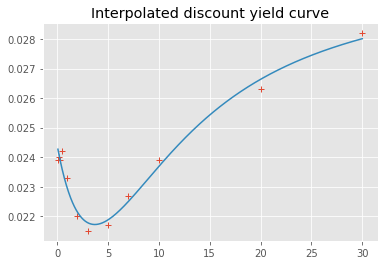

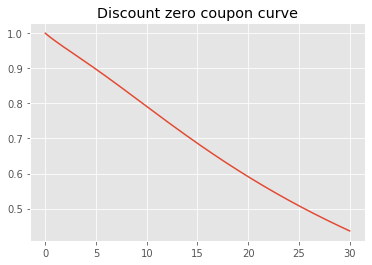

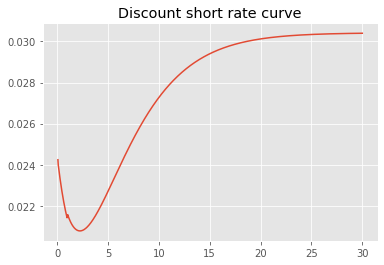

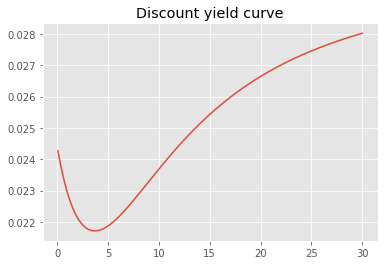

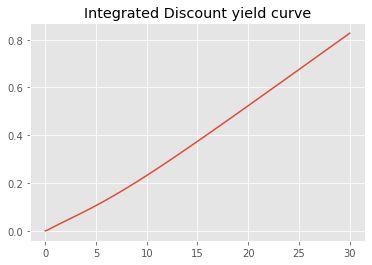

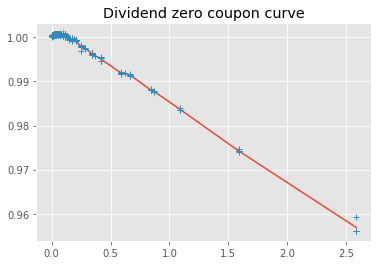

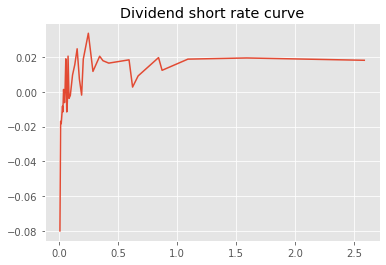

./code/bootstrapping.py:271: RuntimeWarning: invalid value encountered in double_scalars
  return (1 / x - 1) / float(t)


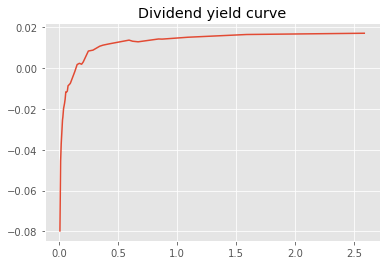

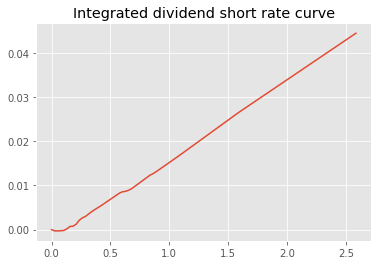

In [6]:
workingFolder = "./data/"
fileName = "Option_SPX_18_Mai_2019Feuille2.xlsm"
asOfDate = "2019-05-18"
trainingSet, testingSet, bootstrap, S0 = loadData.loadCBOTData(workingFolder, fileName, asOfDate)

In [6]:
importlib.reload(bootstrapping)

<module 'bootstrapping' from './code/bootstrapping.py'>

#### Load preformatted data

File required : 
- testingDataSet.csv
- trainingDataSet.csv
- dfCurve.csv

In [7]:
workingFolder = "./data/"
trainingSet, testingSet, bootstrap, S0 = loadData.loadFormattedData(workingFolder)

# Formatting data

### Boostsrapping Rate Curve

We assume a piecewise constant discount short rate $r$ and a piecewise constant dividend short rate $q$.

We estimate the "zero coupon dividend" $D(T) = e^{-\int_{0}^{T} q_s ds}$ by regressing it against maturity :
$$e^{-\int_{0}^{T} q_s ds} = \frac{C(T,K) - P(T,K) + K e^{-\int_{0}^{T} r_s ds}}{S_0}$$


Then we have $\hat{q}_t = - \frac{ \log{D(\overline{T})} - \log{D(\underline{T})} }{ \overline{T} - \underline{T} }$ with $\overline{T}$ the smallest discretized maturity greater than $T$ and $\underline{T}$ the grestest discretized maturity inferior than $T$.

bootstrap object has several members :
- **riskFreeIntegral** corresponds to $I_T = \int_{0}^{T} r_u du$.
- **riskFreeSpline**  corresponds to $r_u$ evaluated on a subgrid. Interpolated as step function from zero coupons
- **divSpreadIntegral** corresponds to $I_T = \int_{0}^{T} q_u du$, can be negative.
- **divSpline**  corresponds to $q_u$ evaluated on a subgrid, can be negative.

These curve should satisfy the call-put parity.

#### Change of variable

Neural network on modified prices with modified strike as input such that discounting and dividend don't intervene in Dupire formula calculation.


- In presence of dividend rate $d$ and risk free rate $r$ Dupire formula is :   $$\sigma^2(T,K) = 2 \frac{ \partial_T P(T,K) + (r-q) K \partial_K P(T,K) + qP(T,K)}{K² \partial_{K}^2 P(T,K)}$$ 
with Strike $K$, Maturity $T$, dividend rate $q$ and risk-free rate $r$, $P$ our pricing function. 
- We apply the following change of variable : $$ w(T,k) = \exp{(\int_{0}^{T} q_t dt)} P(T,K)$$ with $K = k \exp{(\int_{0}^{T} (r_t - q_t) dt)} $.
- Then Dupire equation becomes :  $\sigma^2(T,K) = 2 \frac{ \partial_T w(T,k)}{k² \partial_{k}^2 w(T,k)}$. 
- If we learn the mapping $v$ with a neural network then we obtain quickly by adjoint differentiation $\partial_T w$ and $\partial_{k²}^2 w$ and therefore $\sigma$.
- $k$ corresponds to "ChangedStrike" column.
- $\exp{(\int_{0}^{T} q_t dt)}$ corresponds to "DividendFactor" column.


In [8]:
dataSet = trainingSet #Training set
dataSetTest = testingSet #Testing set
dataSet.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance
Strike,Maturity,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013


In [9]:
dataSetTest.head()

Price     Delta        Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                            
1700.0 0.246      0.80 -0.004171   17.445534      0.009788     -0.000018   
2300.0 0.419     14.30 -0.069169  246.251489      0.132054      0.000036   
2350.0 0.093      1.20 -0.013019   29.227795      0.022052     -0.000041   
       0.112      1.85 -0.018041   42.445051      0.030966     -0.000041   
2400.0 0.419     20.55 -0.099289  323.155078      0.185544      0.000106   

                      Theta  ChangedStrike  DividendFactor  Strike  Maturity  \
Strike Maturity                                                                
1700.0 0.246      15.329284    1697.643924        0.997527  1700.0     0.246   
2300.0 0.419     140.724773    2294.306350        0.994628  2300.0     0.419   
2350.0 0.093      66.591651    2348.768497        1.000292  2350.0     0.093   
       0.112      82.136307    2348.122910        1.000111  2350.0     0.112   
2400.0 0.419     187.583551    2394.058800        0.994628  2400.0     0.419   

                 ImpliedVol     VegaRef  OptionType  logMoneyness  \
Strike Maturity                                                     
1700.0 0.246         0.4147    0.062925        -1.0     -0.521416   
2300.0 0.419         0.2424  261.160274        -1.0     -0.220227   
2350.0 0.093         0.2959   11.271760        -1.0     -0.196766   
       0.112         0.2875   21.589857        -1.0     -0.197041   
2400.0 0.419         0.2264  368.610408        -1.0     -0.177667   

                 impliedTotalVariance  
Strike Maturity                        
1700.0 0.246                 0.042306  
2300.0 0.419                 0.024620  
2350.0 0.093                 0.008143  
       0.112                 0.009257  
2400.0 0.419                 0.021477

In [10]:
dfCurve = dataSetConstruction.savingData(bootstrap, 
                                         dataSet, 
                                         dataSetTest, 
                                         workingFolder)

Saving bootstrapping under dfCurve.csv
Saving training set under trainingDataSet.csv
Saving bootstrapping under testingDataSet.csv


In [11]:
threshold = pd.concat([dataSet, dataSetTest])["Price"].sort_values().iloc[int(0.05 * pd.concat([dataSet, dataSetTest]).shape[0])]
threshold

2.05

In [15]:
dataSet.shape

(135, 15)

In [16]:
dataSetTest.shape

(144, 15)

In [17]:
S0

2859.53

In [12]:
def getCall(df):
    return df[df["OptionType"]==1]
def getPut(df):
    return df[df["OptionType"]==-1]

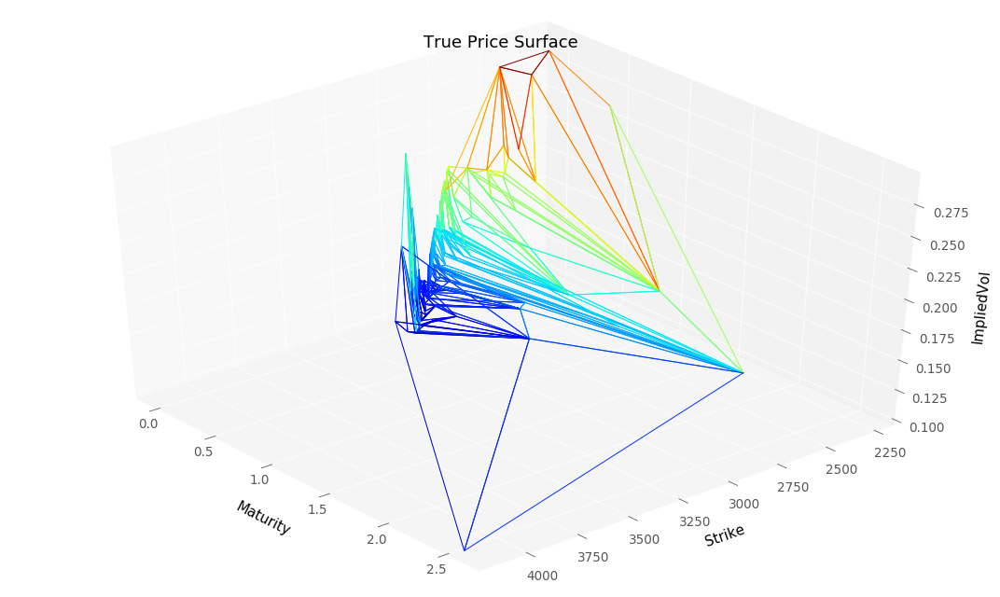

In [19]:
plotTools.plotSerie(getPut(trainingSet)["ImpliedVol"], 
                    yMin=0,
                    yMax=3*S0, 
                    Title = 'True Price Surface')

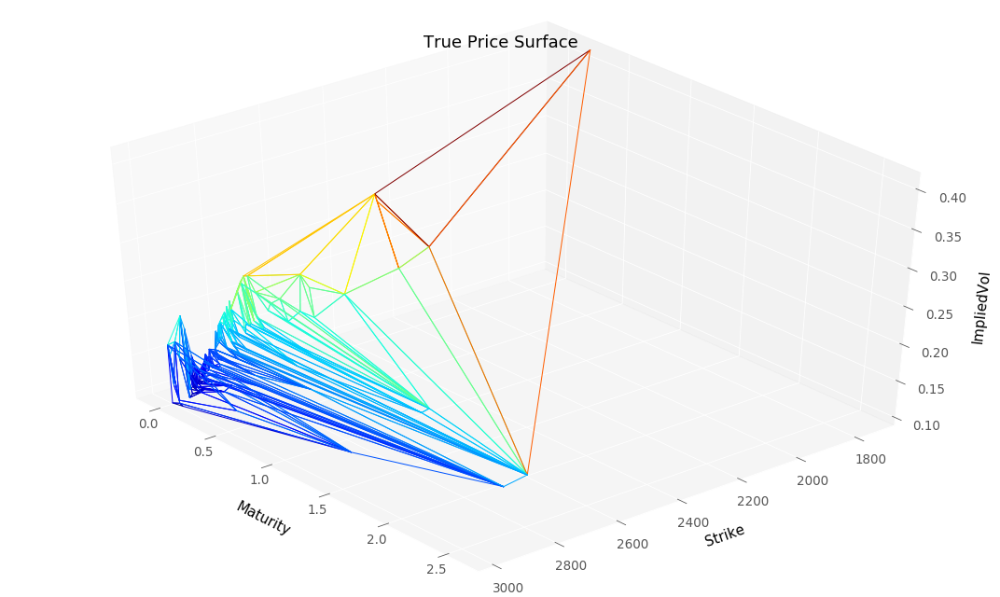

In [20]:
plotTools.plotSerie(getPut(testingSet)["ImpliedVol"], 
                    yMin=0,
                    yMax=3*S0, 
                    Title = 'True Price Surface')

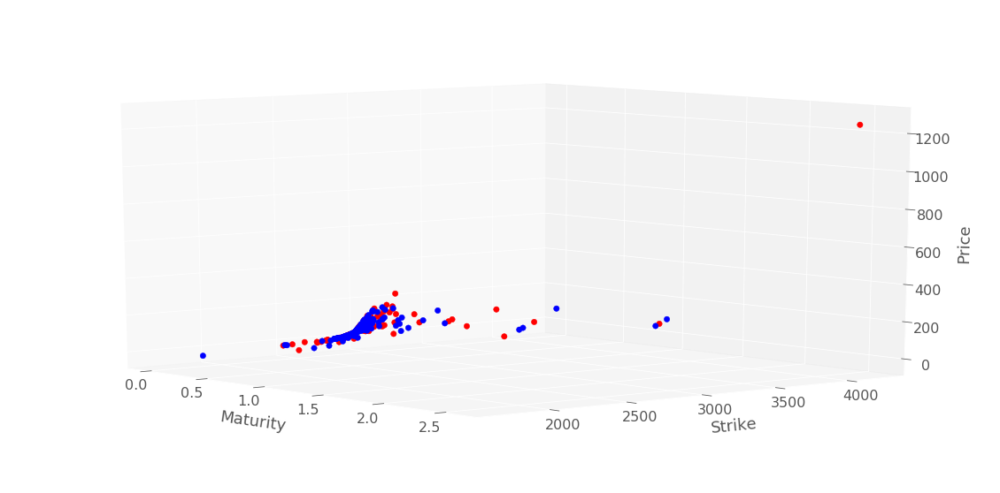

In [21]:
plotTools.plot2Series(getPut(testingSet)["Price"], 
                      getPut(trainingSet)["Price"], 
                      yMin=0,
                      yMax=3*S0, 
                      Title = 'True Price Surface')

## Scaling methods

Use min-max of scaling strike between 0 et 1 for improving stability of neural network training. 



In [13]:
activateScaling = False
transformCustom = dataSetConstruction.transformCustomMinMax if activateScaling else dataSetConstruction.transformCustomId
inverseTransform = dataSetConstruction.inverseTransformMinMax if activateScaling else dataSetConstruction.inverseTransformId
inverseTransformColumn = dataSetConstruction.inverseTransformColumnMinMax if activateScaling else dataSetConstruction.inverseTransformColumnId
inverseTransformColumnGreeks = dataSetConstruction.inverseTransformColumnGreeksMinMax if activateScaling else dataSetConstruction.inverseTransformColumnGreeksId

In [14]:
scaler = skl.preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler.fit(dataSet)
scaledDataSet = transformCustom(dataSet, scaler)
scaledDataSetTest = transformCustom(dataSetTest, scaler)

In [24]:
scaledDataSet.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance
Strike,Maturity,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013


In [15]:
#Search strike for ATM option
midS0 = dataSet[dataSet.index.get_level_values("Strike") >= S0].index.get_level_values("Strike").min()

In [17]:
KMin = 0
KMax = 2.0 * S0

## GP Backtesting
The purpose of this section is to load the GP local volatility surface and perform the Monte-Carlo backtest of the option prices uses the GP local volatility surface. Note that the GP local volatility is generated by running the Matlab code in the "code/GP" folder. See Section "GP Local Volatility Backtests" below for further details of the backtests.

### Load GP Results

This section loads result from the Matlab experiments.
See code/GP folder to access the matlab script.

In [28]:
pathFolder = "./data/"
fileName = "GP_output_Put_Price_testing_set.xlsx"
putTestingGP = pd.read_excel(pathFolder + fileName,
                             header=0,
                             sheet_name = "Sheet1")
putTestingGP["Strike"] = np.exp(+ bootstrap.discountIntegral(putTestingGP["T"])
                                - bootstrap.dividendIntegral(putTestingGP["T"])) * putTestingGP["K"]
putTestingGP["Maturity"] = putTestingGP["T"]
putTestingGP = putTestingGP.set_index(["Strike","Maturity"], drop=False)

putTestingGP = pd.DataFrame(putTestingGP.values, columns = putTestingGP.columns, index = dataSetTest.index)
putTestingGP["Strike"] = dataSetTest["Strike"]
putTestingGP["Maturity"] = dataSetTest["Maturity"]

putTestingGP.head()

K      T  GP_Modified_Put_price  GP_Put_price  \
Strike Maturity                                                            
1700.0 0.246     1697.643924  0.246               1.529623      1.526542   
2300.0 0.419     2294.306350  0.419              13.529379     13.456314   
2350.0 0.093     2348.768497  0.093               0.924816      0.925103   
       0.112     2348.122910  0.112               2.011405      2.011567   
2400.0 0.419     2394.058800  0.419              19.765341     19.658598   

                 Strike  Maturity  
Strike Maturity                    
1700.0 0.246     1700.0     0.246  
2300.0 0.419     2300.0     0.419  
2350.0 0.093     2350.0     0.093  
       0.112     2350.0     0.112  
2400.0 0.419     2400.0     0.419

In [29]:
putTestingGP.tail()

K      T  GP_Modified_Put_price  GP_Put_price  \
Strike Maturity                                                            
3000.0 1.588     2980.007887  1.588             275.267066    268.076154   
3005.0 0.016     3004.417707  0.016             142.432079    142.608428   
3015.0 0.112     3012.591733  0.112             154.114599    154.127043   
3025.0 0.074     3024.282210  0.074             163.303537    163.391511   
       0.170     3021.193962  0.170             165.823160    165.720704   

                 Strike  Maturity  
Strike Maturity                    
3000.0 1.588     3000.0     1.588  
3005.0 0.016     3005.0     0.016  
3015.0 0.112     3015.0     0.112  
3025.0 0.074     3025.0     0.074  
       0.170     3025.0     0.170

In [30]:
dataSet.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance
Strike,Maturity,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013


In [31]:
ImpVolPutTesting = BS.vectorizedImpliedVolatilityCalibration(S0, bootstrap, 
                                                             putTestingGP["T"], 
                                                             putTestingGP["Strike"], 
                                                             -1 * np.ones_like(putTestingGP["Strike"]), 
                                                             putTestingGP["GP_Put_price"],
                                                             removeNaN= False)
ImpVolPutTesting = pd.Series(ImpVolPutTesting, index = putTestingGP.set_index(["Strike","Maturity"], drop=False).index).sort_index()

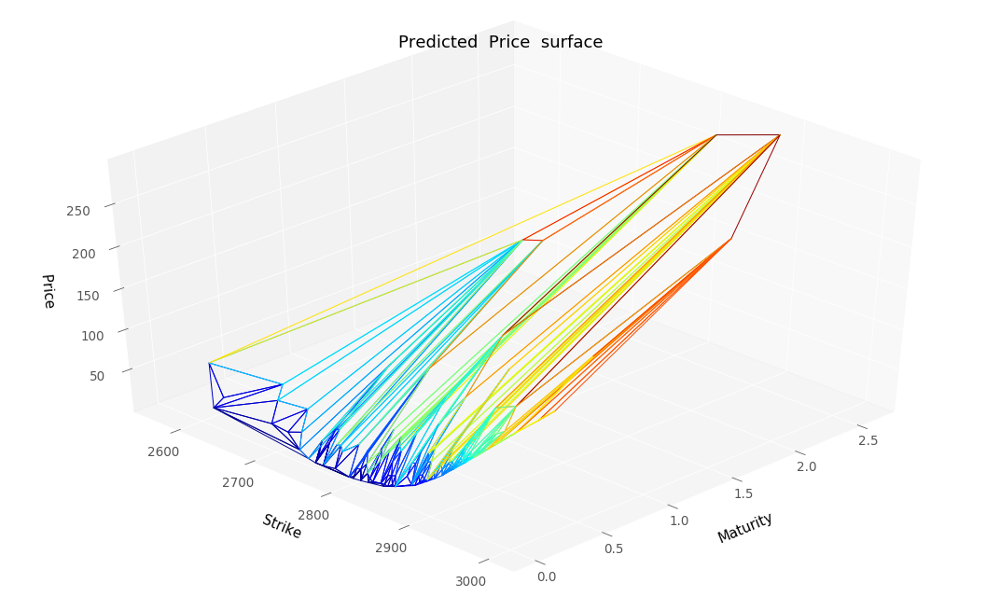

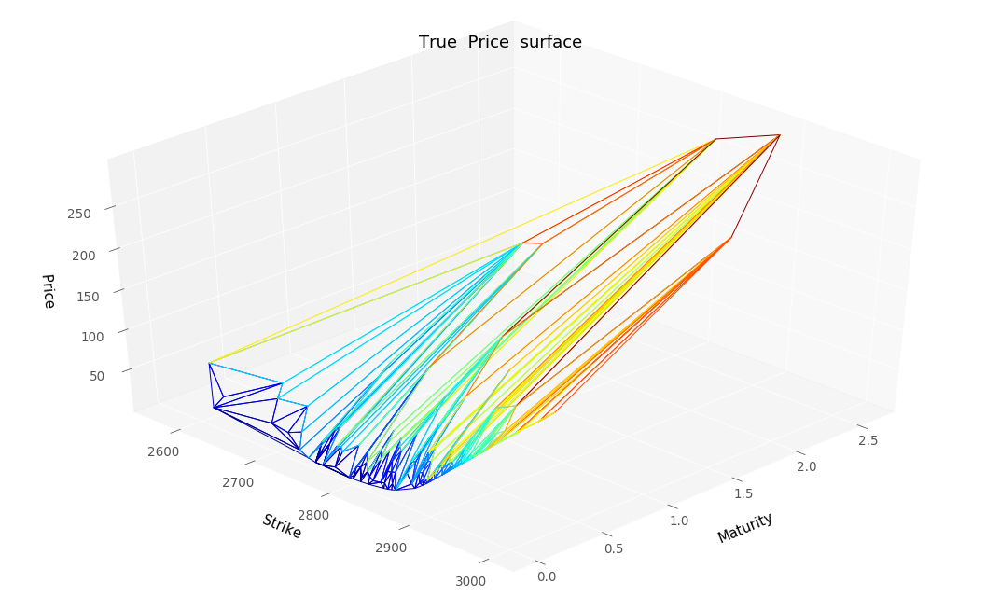

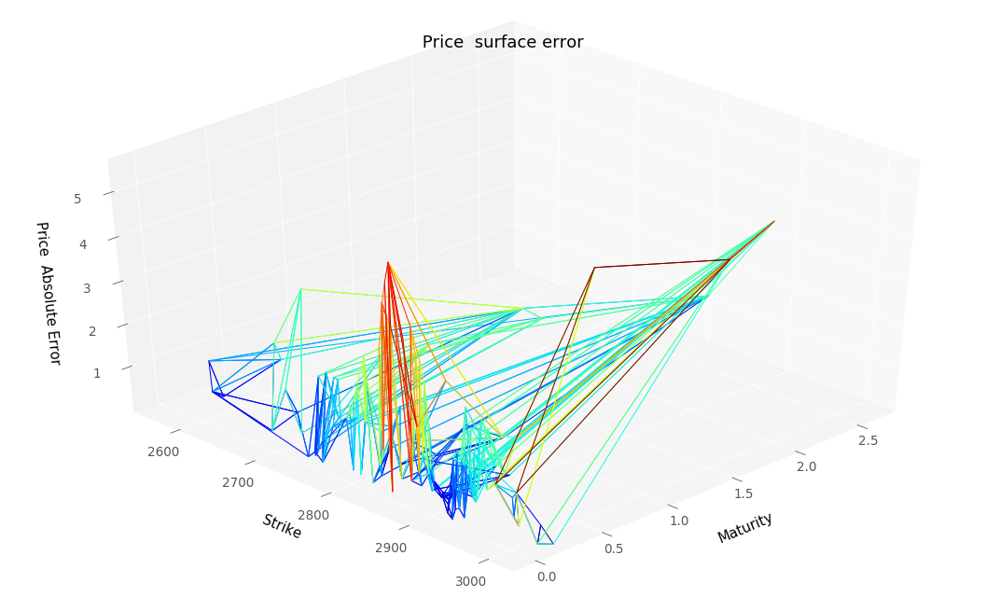

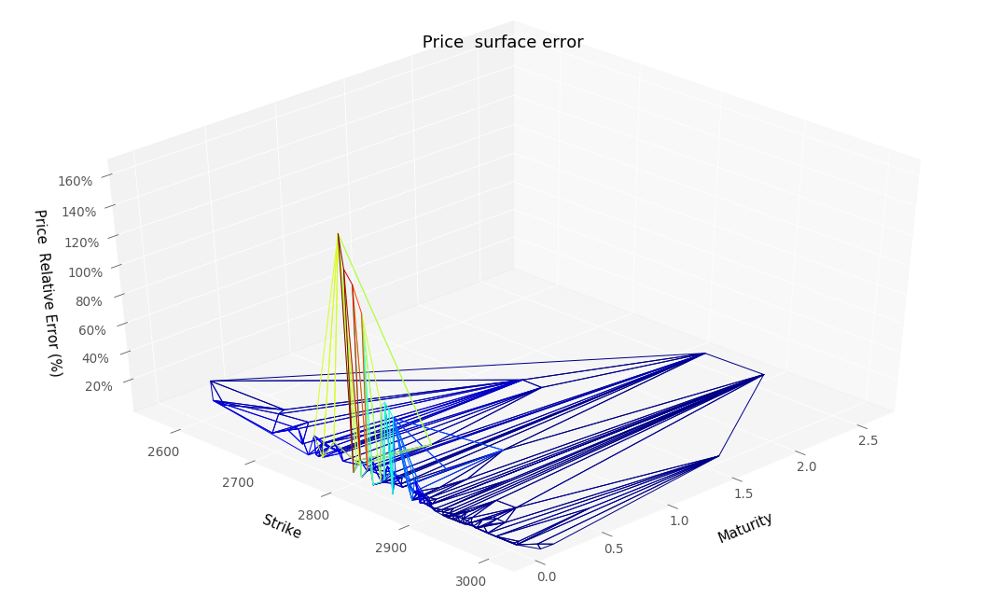

RMSE :  1.8457953164957646
RMSE Relative:  0.2767466327886194


In [32]:
plotTools.predictionDiagnosis(putTestingGP["GP_Put_price"], 
                              dataSetTest['Price'],#ImpVolPutTestingRef, #
                              " Price ", 
                              yMin=2400,
                              yMax=3600, 
                              az = 225,
                              threshold=None)

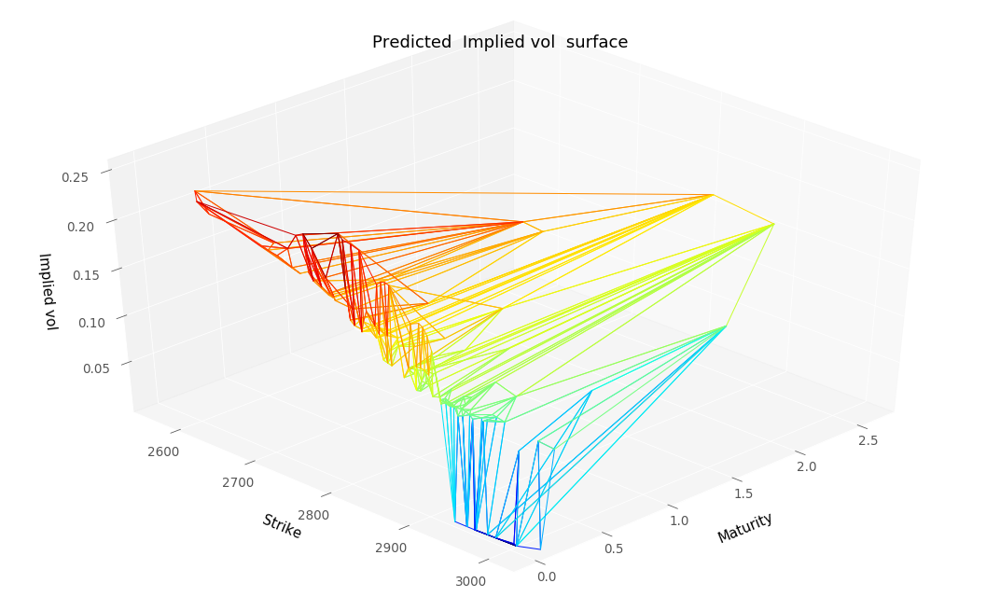

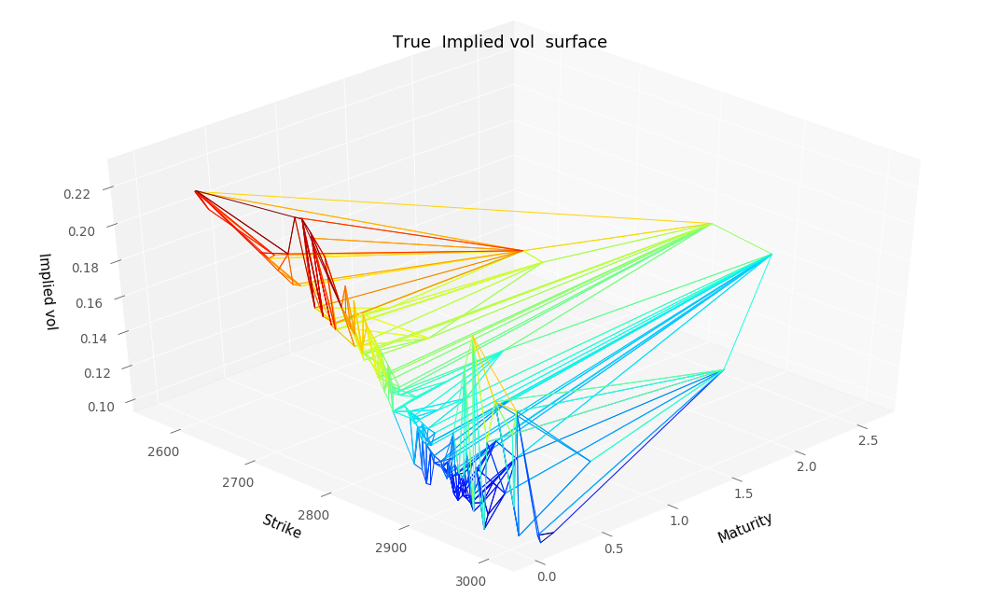

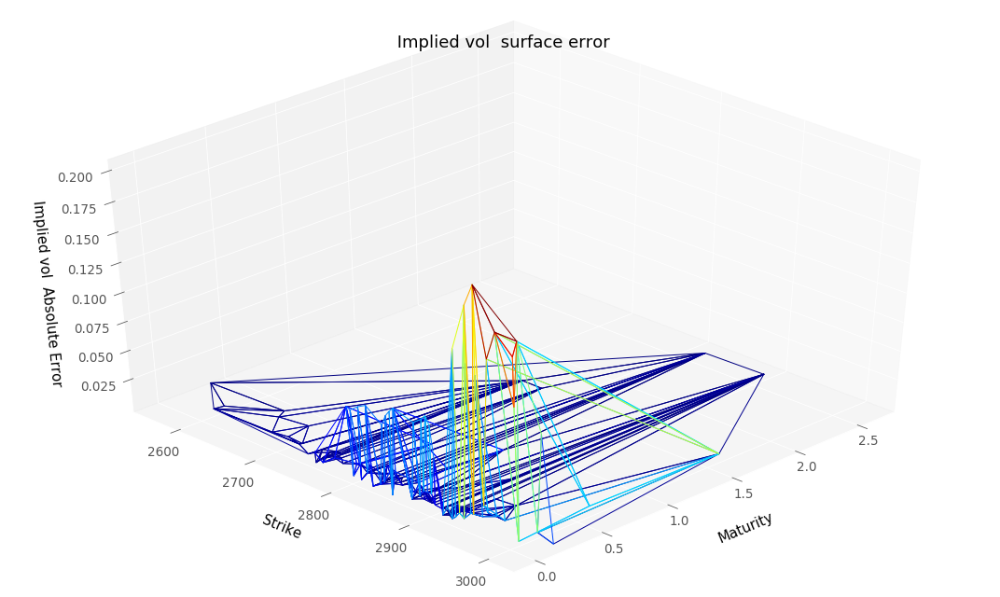

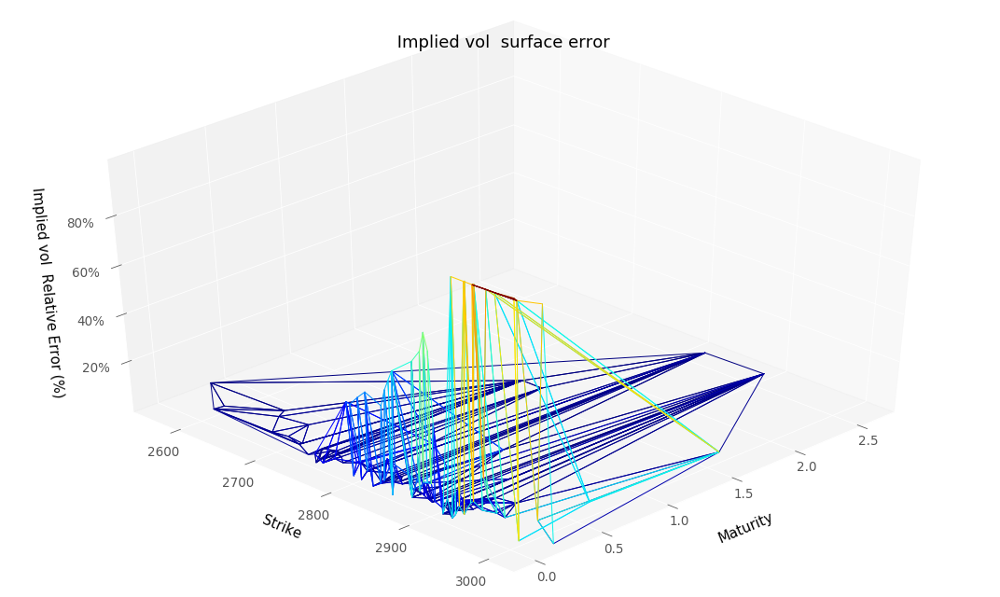

RMSE :  0.0485456689245387
RMSE Relative:  0.32059153408459634


In [33]:
keptPrices = ImpVolPutTesting.dropna().index
plotTools.predictionDiagnosis(plotTools.selectIndex(ImpVolPutTesting, keptPrices), 
                              plotTools.selectIndex(dataSetTest["ImpliedVol"], keptPrices), 
                              " Implied vol ", 
                              yMin=2400,
                              yMax=3600, 
                              az = 225)

In [34]:
pathFolder = "./data/"
fileName = "GP_output_Put_Price_training_set.xlsx"
putTrainingGP = pd.read_excel(pathFolder + fileName,
                              header=0,
                              sheet_name = "Sheet1")
putTrainingGP["Strike"] = np.exp(+ bootstrap.discountIntegral(putTrainingGP["T"])
                                 - bootstrap.dividendIntegral(putTrainingGP["T"])) * putTrainingGP["K"]
putTrainingGP["Maturity"] = putTrainingGP["T"]

putTrainingGP = putTrainingGP.set_index(["Strike","Maturity"], drop=False)

putTrainingGP = pd.DataFrame(putTrainingGP.values, columns = putTrainingGP.columns, index = dataSet.index)
putTrainingGP["StrikeGap"] = dataSet["Strike"] - putTrainingGP["Strike"]
putTrainingGP["Strike"] = dataSet["Strike"]
putTrainingGP["Maturity"] = dataSet["Maturity"]
putTrainingGP["OriginalPrice"] = putTrainingGP["GP_Put_price"] * np.exp(- bootstrap.dividendIntegral(putTrainingGP["T"]))

putTrainingGP.head()

,,K,T,GP_Modified_Put_price,GP_Put_price,Strike,Maturity,StrikeGap,OriginalPrice
Strike,Maturity,,,,,,,,
2200.0,0.419,2194.553900,0.419,10.000601,9.946592,2200.0,0.419,-0.796497,9.878549
2325.0,0.112,2323.142879,0.112,1.786899,1.787044,2325.0,0.112,-2.330992,1.785294
2400.0,0.093,2398.742294,0.093,1.244240,1.244625,2400.0,0.093,-0.243060,1.244906
2510.0,0.170,2506.841932,0.170,9.440721,9.434888,2510.0,0.170,-1.361214,9.425651
2525.0,0.036,2524.212274,0.036,1.141030,1.142168,2525.0,0.036,-0.791540,1.142425


In [35]:
ImpVolPutTraining = BS.vectorizedImpliedVolatilityCalibration(S0, bootstrap, 
                                                              putTrainingGP["T"], 
                                                              putTrainingGP["Strike"], 
                                                              -1 * np.ones_like(putTrainingGP["Strike"]), 
                                                              putTrainingGP["GP_Put_price"], 
                                                              removeNaN= False)
ImpVolPutTraining = pd.Series(ImpVolPutTraining, index = putTrainingGP.set_index(["Strike","Maturity"], drop=False).index).sort_index()

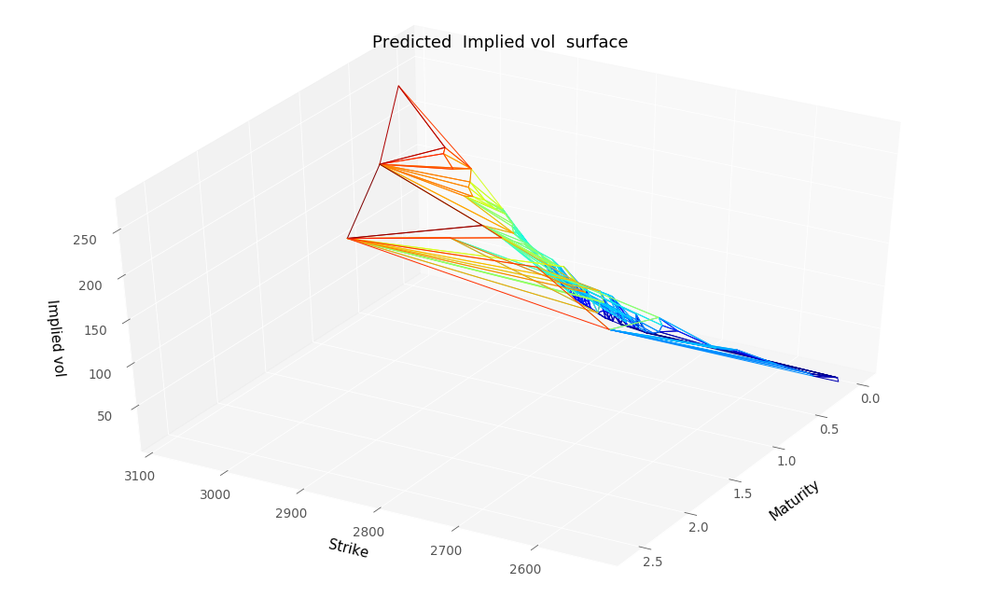

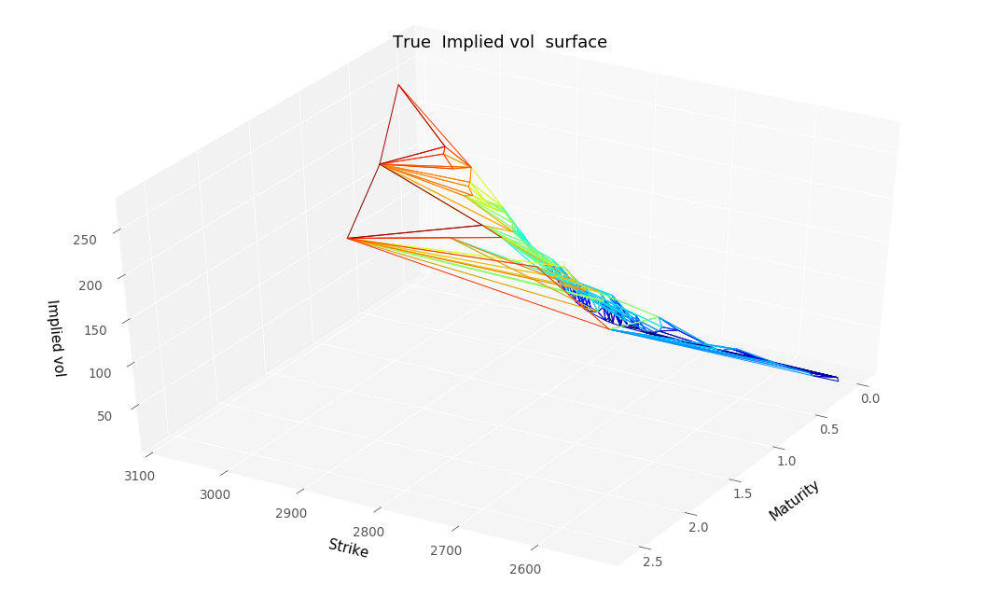

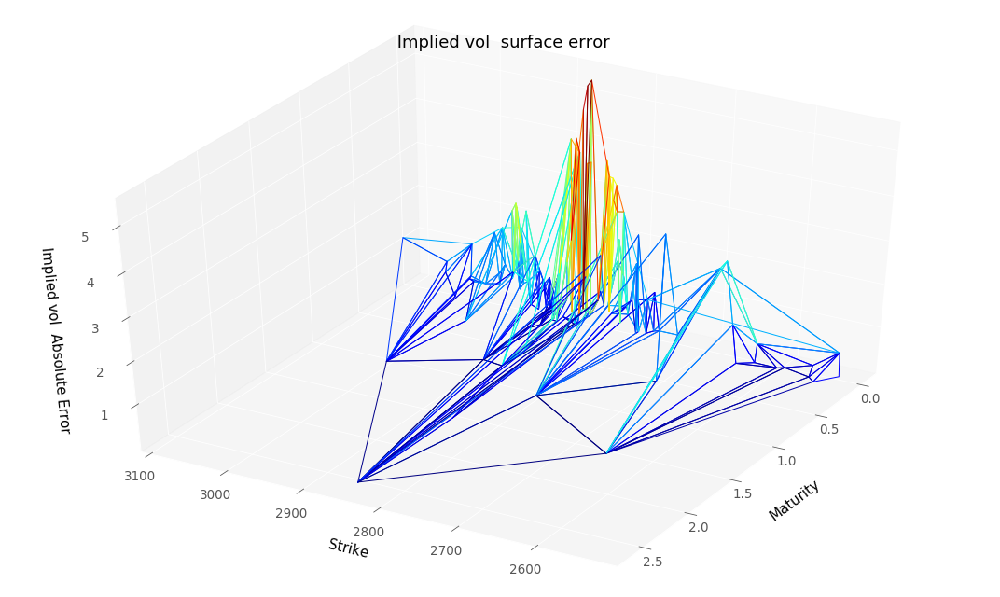

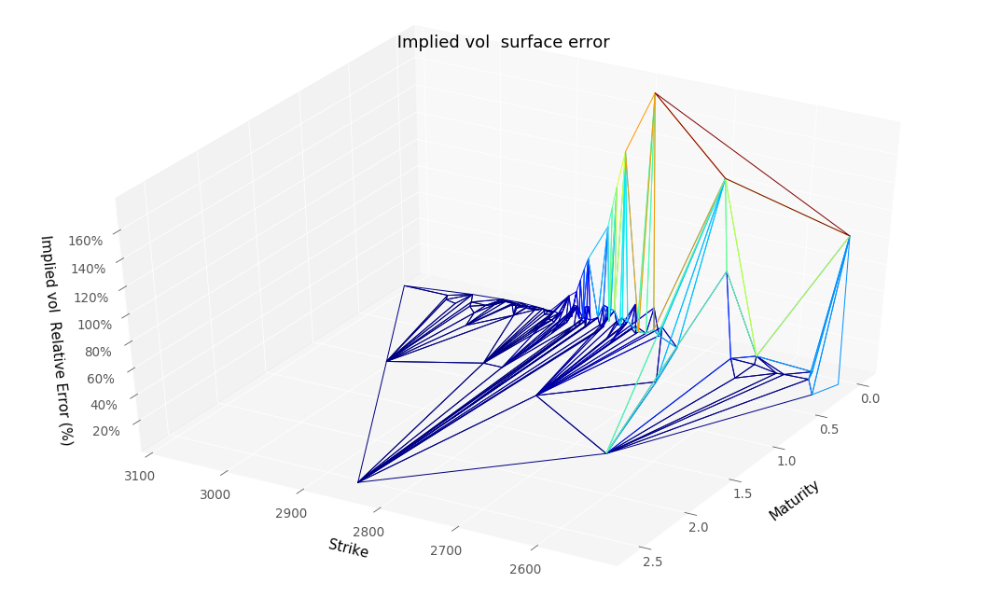

RMSE :  1.663108443188316
RMSE Relative:  0.29335941813084926


In [36]:
plotTools.predictionDiagnosis(putTrainingGP["GP_Put_price"], 
                              dataSet['Price'],
                              " Implied vol ", 
                              yMin=2400,
                              yMax=3600, 
                              az = 30,
                              threshold=None)

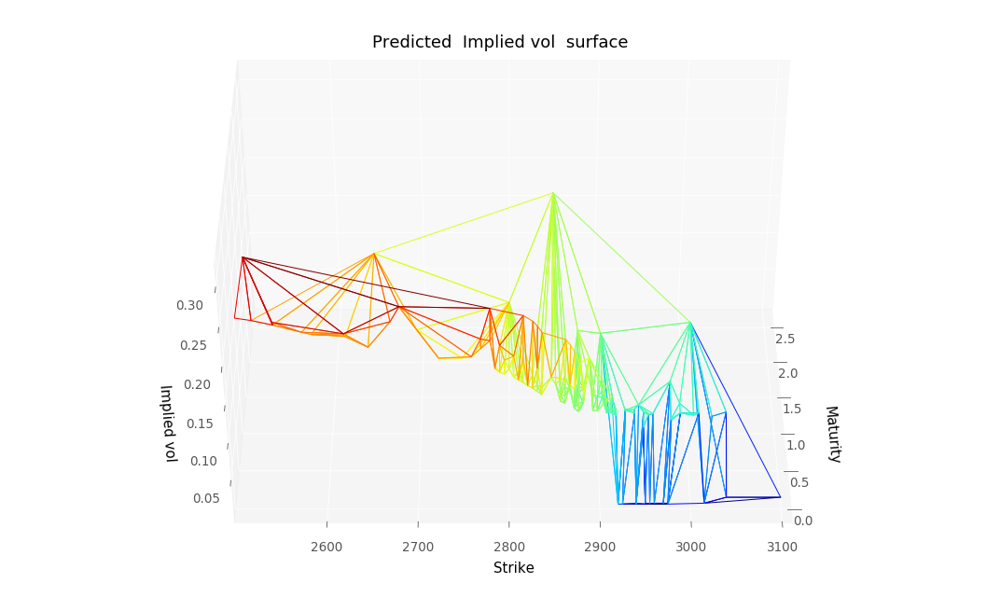

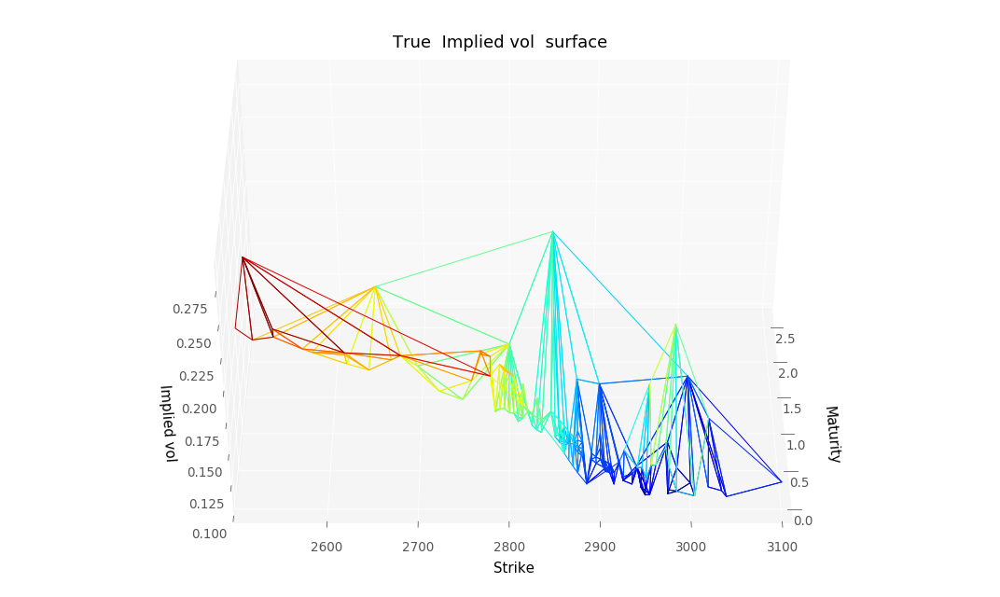

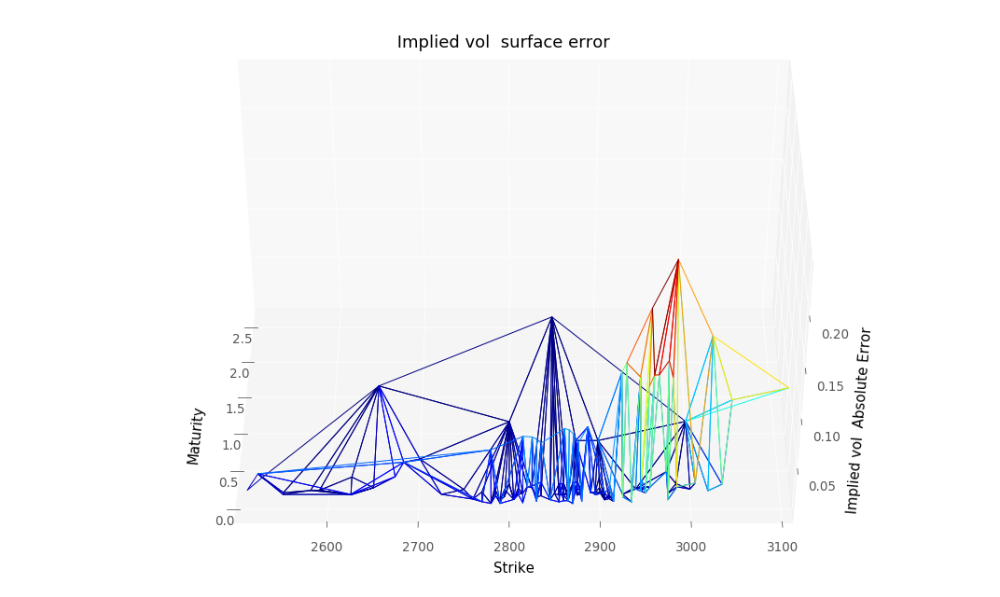

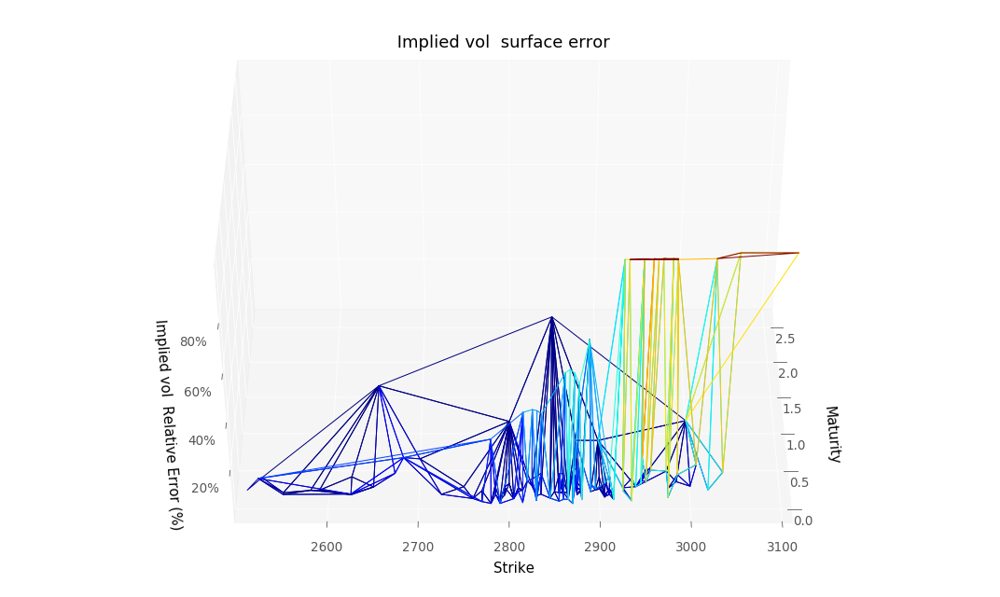

RMSE :  0.05065667104389011
RMSE Relative:  0.3416228686409698


In [37]:
keptPrices = ImpVolPutTraining.dropna().index
plotTools.predictionDiagnosis(plotTools.selectIndex(ImpVolPutTraining, keptPrices), 
                              plotTools.selectIndex(dataSet["ImpliedVol"], keptPrices), 
                              " Implied vol ", 
                              yMin=2400,
                              yMax=3600, 
                              az = 180)

#### Load GP local volatility

In [38]:
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)
volLocaleGridDf = pd.DataFrame(np.vstack((np.ravel(volLocaleGrid[0]), np.ravel(volLocaleGrid[1]))).T, 
                               columns = ["Strike", "Maturity"]).set_index(["Strike","Maturity"],drop=False)
volLocaleGridDf["ChangedStrike"] = bootstrap.changeOfVariable(volLocaleGridDf["Strike"], volLocaleGridDf["Maturity"])[0]
volLocaleGridDf["logMoneyness"] = np.log(volLocaleGridDf["ChangedStrike"] / S0)
volLocaleGridDf["OptionType"] = np.ones_like(volLocaleGridDf["logMoneyness"])

In [39]:
workingFolder = "./data/volLocaleAresky/"
#filename = "local_vol_nx_10_nt_27.xlsx" RMSE :  10.073967351737087
#filename = "local_vol_nx_12_nt_27.xlsx" RMSE :  7.758802111118254
#filename = "local_vol_nx_15_nt_27.xlsx" RMSE :  6.252799135416868
#filename = "local_vol_nx_18_nt_27.xlsx" RMSE :  5.083806059940602
#filename = "local_vol_nx_20_nt_27.xlsx" RMSE :  5.050554384554841
#filename = "local_vol_nx_25_nt_27.xlsx" RMSE :  5.499835852015688
filename = "local_vol_nx_20_nt_27.xlsx"

In [40]:
locVolGP = loadData.loadGPLocVol(workingFolder, filename, bootstrap, S0)

Loading local volatility from :  ./data/volLocaleAresky/local_vol_nx_20_nt_27.xlsx


In [41]:
locVolGP.head()

OptionType  logMoneyness  ChangedStrike    Strike  \
Strike   Maturity                                                      
1769.737 0.150           -1.0     -0.481628    1766.552158  1769.737   
         0.221           -1.0     -0.481716    1766.396569  1769.737   
         0.292           -1.0     -0.481716    1766.396569  1769.737   
         0.363           -1.0     -0.482181    1765.574211  1769.737   
         0.435           -1.0     -0.482667    1764.716939  1769.737   

                   Maturity            K         T  LocalVolatility  
Strike   Maturity                                                    
1769.737 0.150        0.150  1769.736842  0.150000         1.092109  
         0.221        0.221  1769.736842  0.221154         0.715490  
         0.292        0.292  1769.736842  0.292308         0.576198  
         0.363        0.363  1769.736842  0.363462         0.695485  
         0.435        0.435  1769.736842  0.434615         0.725714

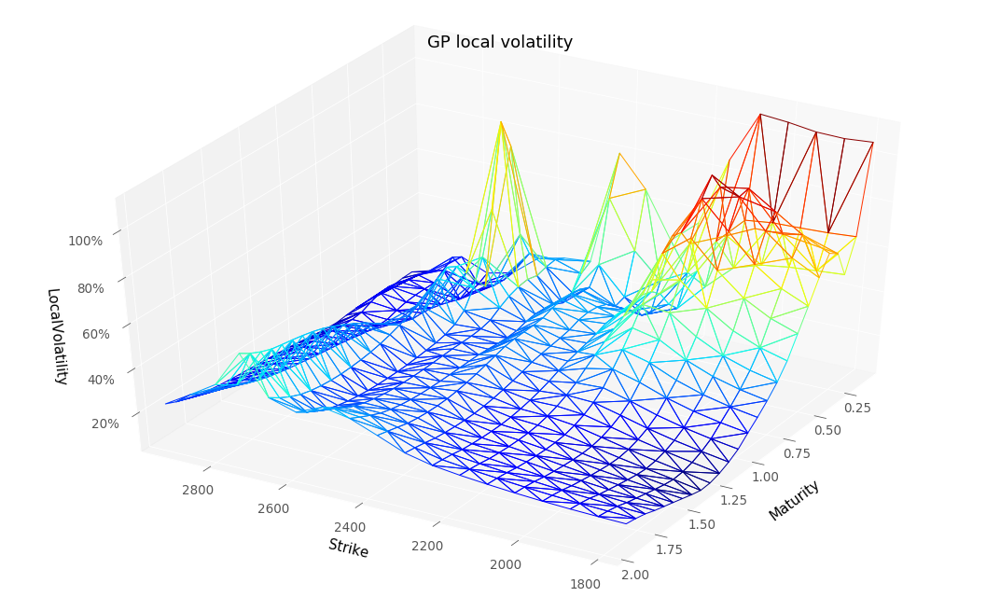

In [42]:
filterLocVol = locVolGP[(locVolGP["Maturity"] <= matUp) & (locVolGP["Maturity"] >= matLow)]
plotTools.plotSerie(filterLocVol["LocalVolatility"],
                    Title = 'GP local volatility',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

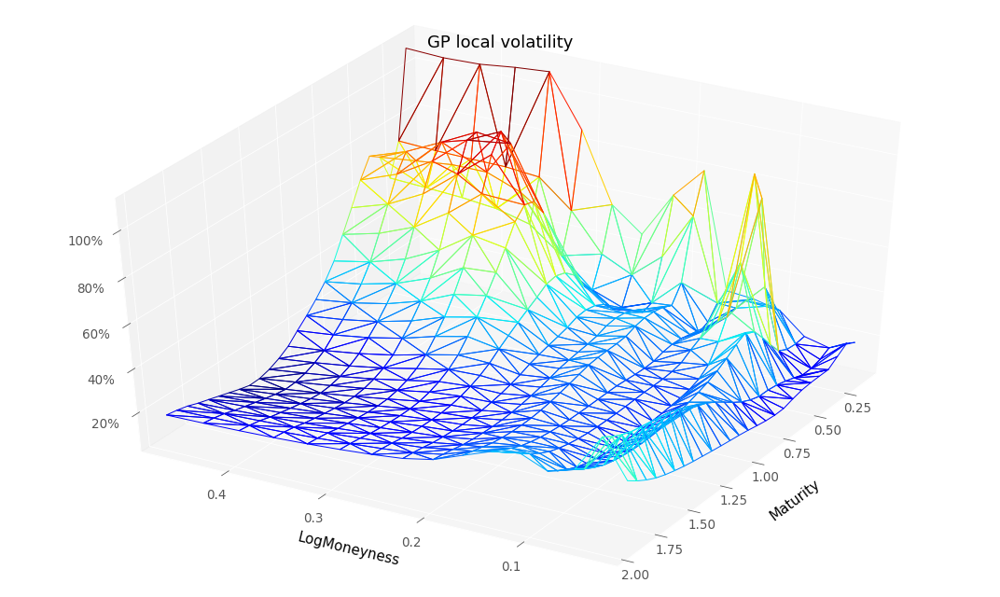

In [43]:
filterLocVol = locVolGP[(locVolGP["Maturity"] <= matUp) & (locVolGP["Maturity"] >= matLow)]
plotTools.plotSerie(plotTools.convertToLogMoneyness(filterLocVol["LocalVolatility"], S0),
                    Title = 'GP local volatility',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

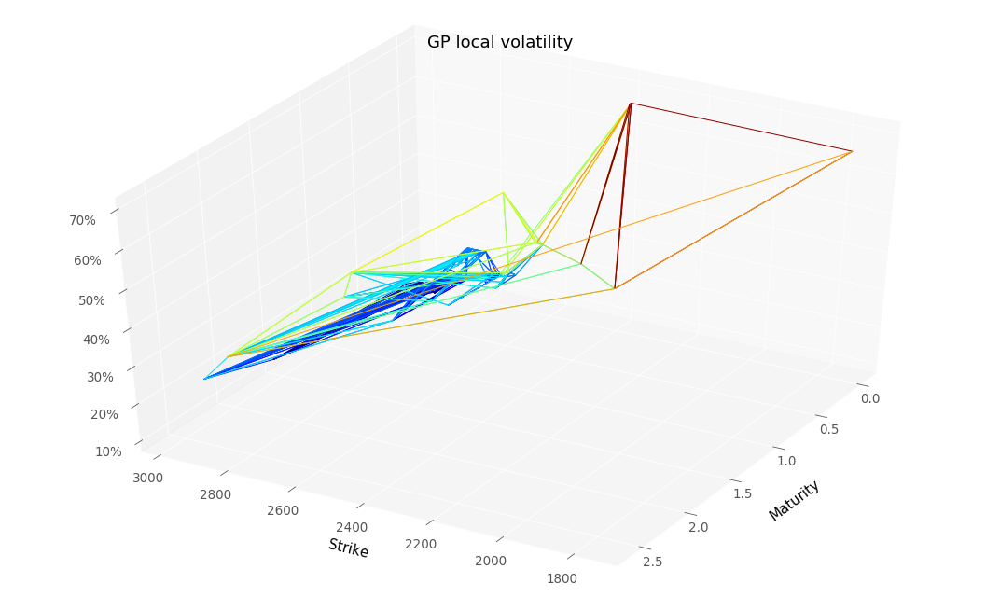

In [44]:
nnGP = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolGP["LocalVolatility"], x, y)
filterLocVol = locVolGP[(locVolGP["Maturity"] <= matUp) & (locVolGP["Maturity"] >= matLow)]

plotTools.plotSerie(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"]),
                    Title = 'GP local volatility',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

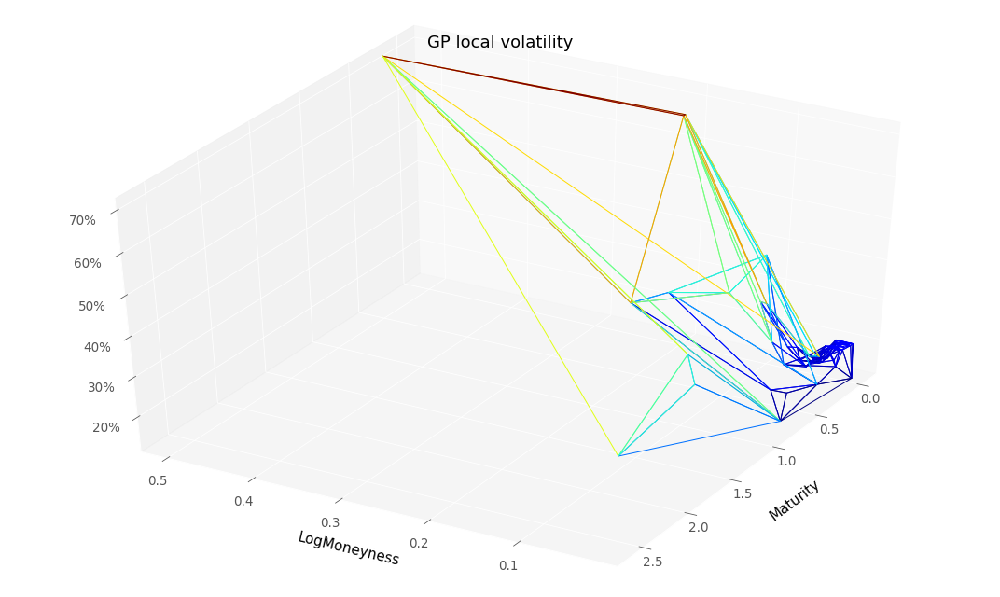

In [45]:
filterLocVol = locVolGP[(locVolGP["Maturity"] <= matUp) & (locVolGP["Maturity"] >= matLow)]

plotTools.plotSerie(plotTools.convertToLogMoneyness(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"]), S0),
                    Title = 'GP local volatility',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

/Users/matthewdixon/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


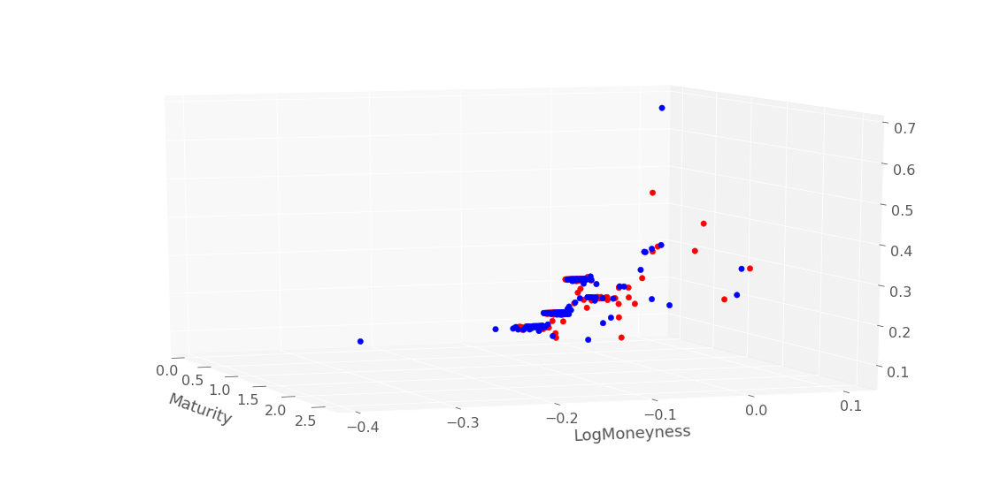

In [46]:
logMin = np.log(KMin/S0), 
logMax = 0.1 #np.log(KMax/S0), 
plotTools.plot2Series(plotTools.convertToLogMoneyness(nnGP(dataSet["Strike"], dataSet["Maturity"]), S0), 
                      plotTools.convertToLogMoneyness(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"]), S0), 
                      yMin=logMin,
                      yMax=logMax,
                      az = 340,
                      Title = 'True Implied Vol Surface')

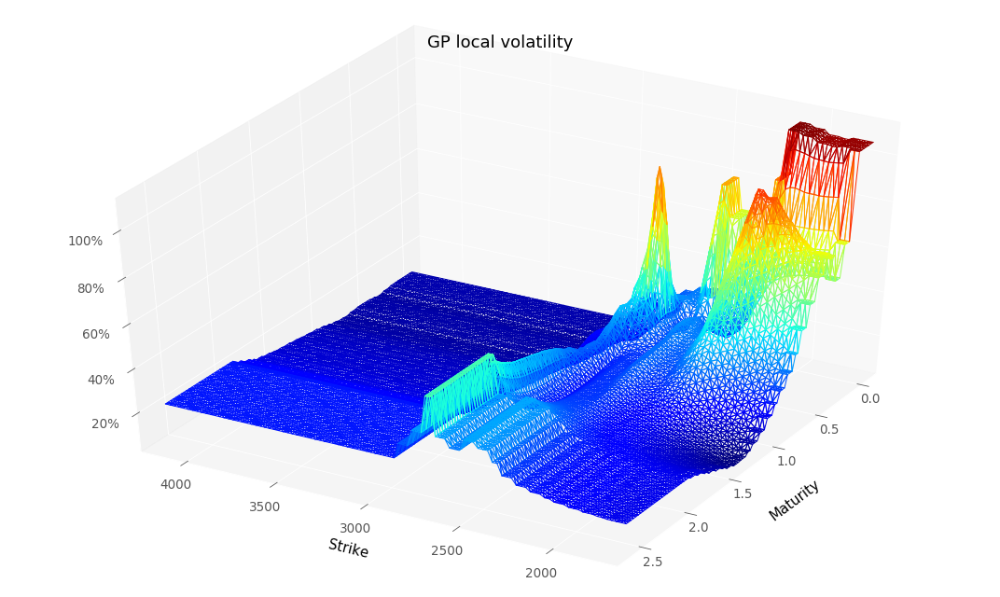

In [47]:
filterLocVol = locVolGP[(locVolGP["Maturity"] <= matUp) & (locVolGP["Maturity"] >= matLow)]
plotTools.plotSerie(nnGP(volLocaleGridDf["Strike"], volLocaleGridDf["Maturity"]),
                    Title = 'GP local volatility',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

In [77]:
plotTools.saveDataModel(plotTools.removeDuplicateIndex(putTrainingGP["GP_Put_price"]), 
                        plotTools.removeDuplicateIndex(nnGP(dataSet["Strike"], dataSet["Maturity"])), 
                        plotTools.removeDuplicateIndex(ImpVolPutTraining) , 
                        "./Results/GPTraining") 

In [78]:
plotTools.saveDataModel(plotTools.removeDuplicateIndex(putTestingGP["GP_Put_price"]), 
                        plotTools.removeDuplicateIndex(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"])), 
                        plotTools.removeDuplicateIndex(ImpVolPutTesting) , 
                        "./Results/GPTesting") 

#### GP Local Volatility Backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

In [75]:
nbTimeStep = 100
nbPaths = 100000

In [76]:
importlib.reload(backtest)

<module 'backtest' from './code/backtest.py'>

In [77]:
nnGP = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolGP["LocalVolatility"], x, y)

In [78]:
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)
volLocaleGridDf = pd.DataFrame(np.vstack((np.ravel(volLocaleGrid[0]), np.ravel(volLocaleGrid[1]))).T, 
                               columns = ["Strike", "Maturity"]).set_index(["Strike","Maturity"],drop=False)
volLocaleGridDf["ChangedStrike"] = bootstrap.changeOfVariable(volLocaleGridDf["Strike"], volLocaleGridDf["Maturity"])[0]
volLocaleGridDf["logMoneyness"] = np.log(volLocaleGridDf["ChangedStrike"] / S0)
volLocaleGridDf["OptionType"] = np.ones_like(volLocaleGridDf["logMoneyness"])

In [79]:
volLocaleGridDf.head()

,,Strike,Maturity,ChangedStrike,logMoneyness,OptionType
Strike,Maturity,,,,,
1700.000000,0.005,1700.000000,0.005,1698.937070,-0.520654,1.0
1725.252525,0.005,1725.252525,0.005,1724.173806,-0.505909,1.0
1750.505051,0.005,1750.505051,0.005,1749.410542,-0.491378,1.0
1775.757576,0.005,1775.757576,0.005,1774.647278,-0.477056,1.0
1801.010101,0.005,1801.010101,0.005,1799.884015,-0.462935,1.0


In [86]:
mcResGPTest = backtest.MonteCarloPricerVectorized(S0,
                                                  dataSetTest,
                                                  bootstrap,
                                                  nbPaths,
                                                  nbTimeStep,
                                                  nnGP)
mcResGPTest.head()

Price    stdPrice
Strike Maturity                       
1700.0 0.246      0.833726   18.403973
2300.0 0.419     13.380419   92.245855
2350.0 0.093      0.384814   10.245258
       0.112      0.994517   18.210803
2400.0 0.419     20.646870  110.514794

In [87]:
mcResGPTest.to_csv(workingFolder + "mcResGPTest.csv")

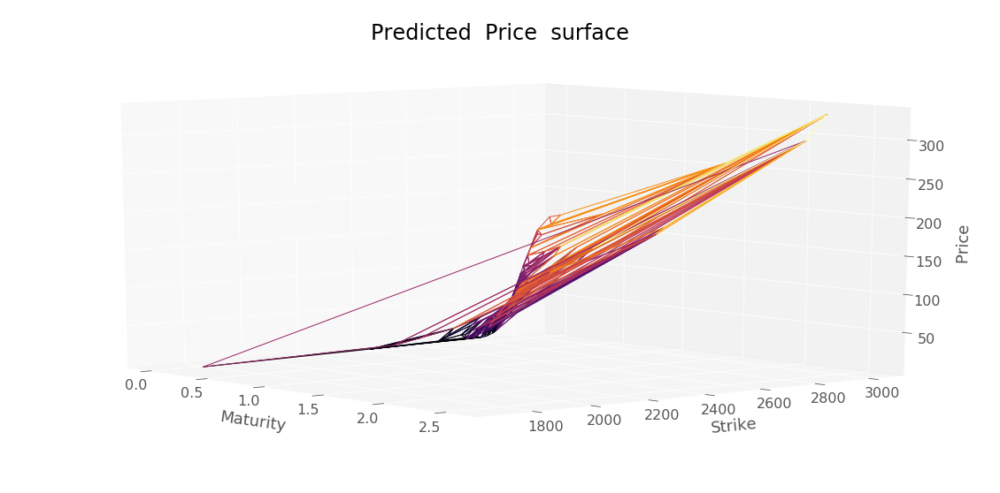

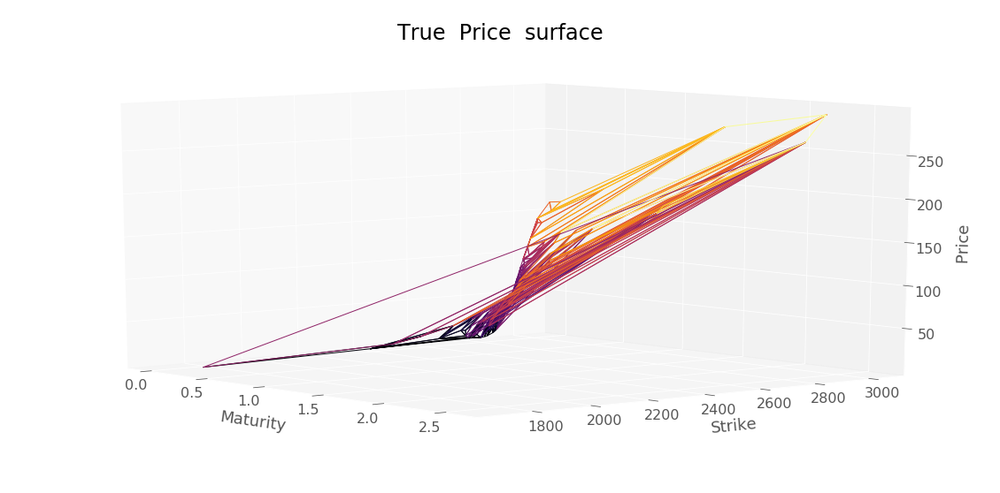

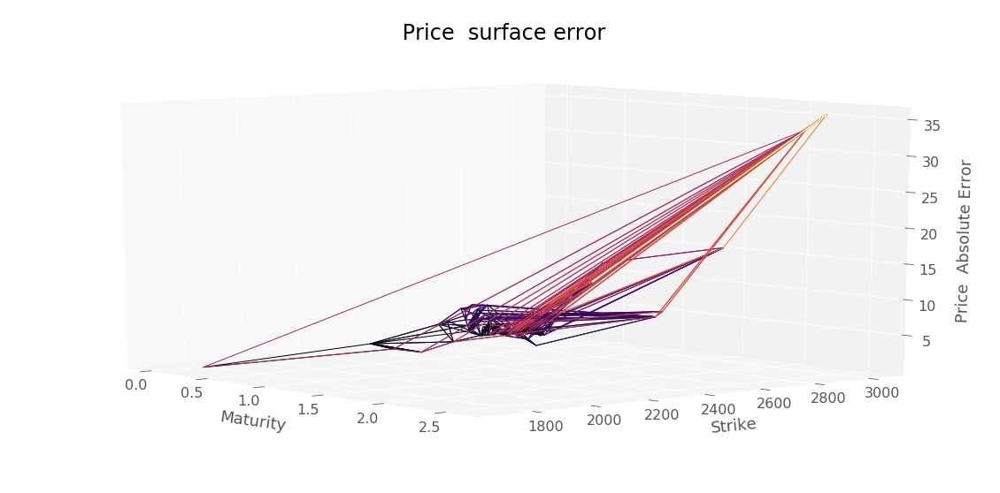

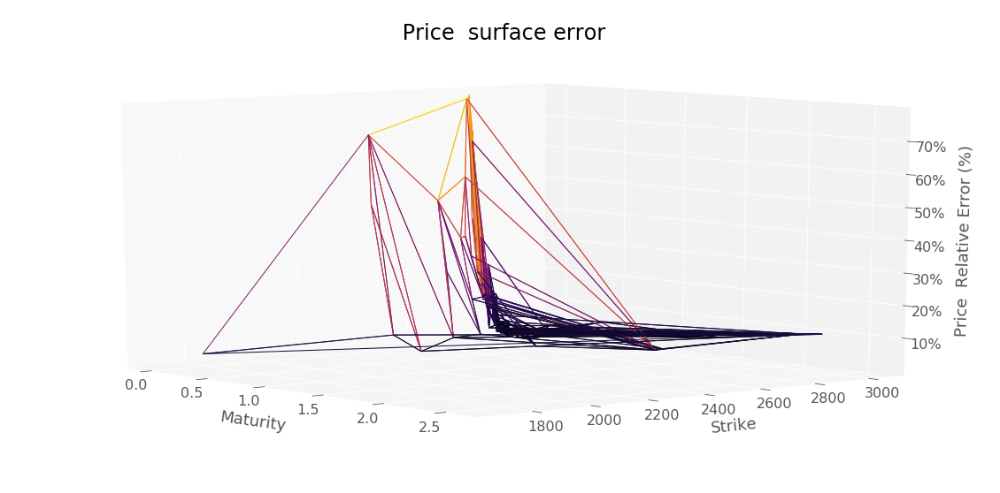

RMSE :  4.997789723328307


In [88]:
plotTools.predictionDiagnosis(mcResGPTest["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

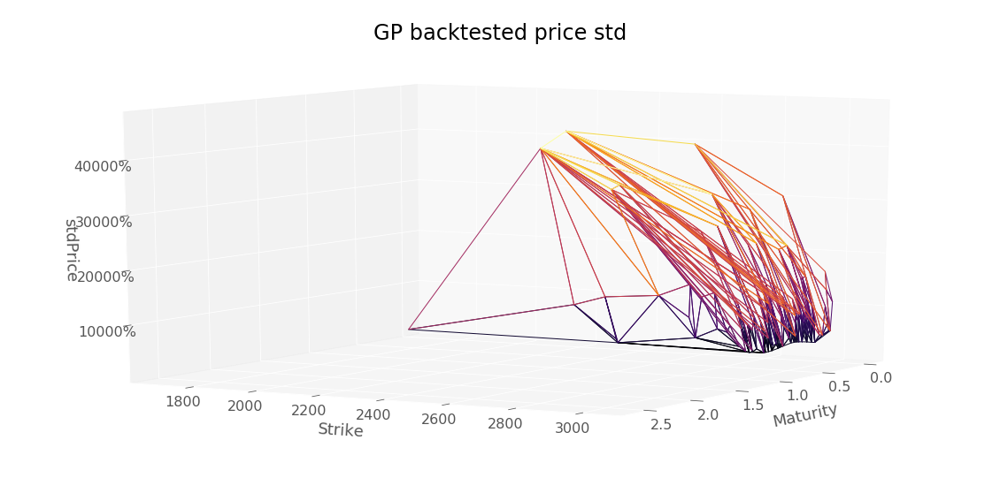

In [89]:
plotTools.plotSerie(mcResGPTest["stdPrice"],
                    Title = 'GP backtested price std',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

In [90]:
testingDataSetGP = dataSetConstruction.interpolatedLocalVolatility(locVolGP, 
                                                                   dataSetTest["Price"])

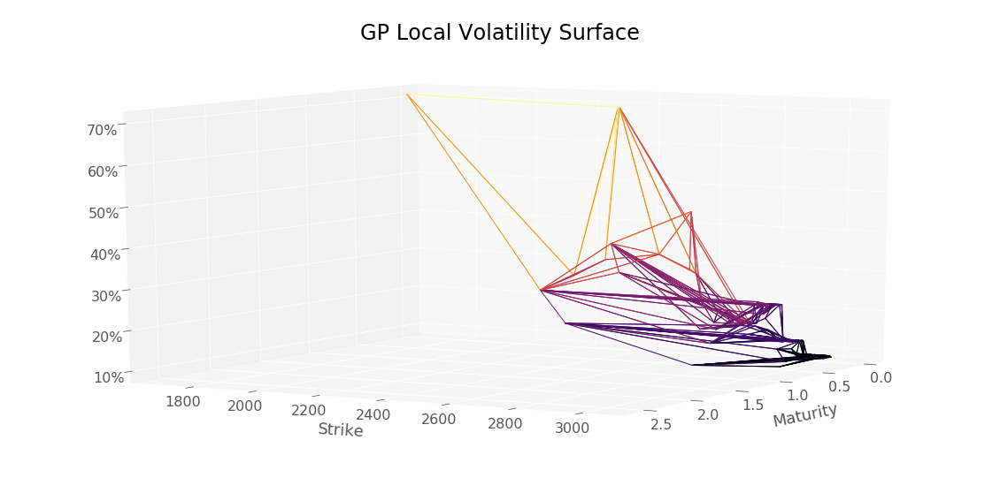

In [91]:
plotTools.plotSerie(testingDataSetGP,
                    Title = 'GP Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

In [92]:
pdeResSigmaGPTest = backtest.PDEPricerVectorized(dataSetTest, S0, nnGP, bootstrap)
pdeResSigmaGPTest.head()

Strike  Maturity
1700.0  0.246        0.594552
2300.0  0.419       10.923903
2350.0  0.093        0.756563
        0.112        1.130061
2400.0  0.419       19.264846
dtype: float64

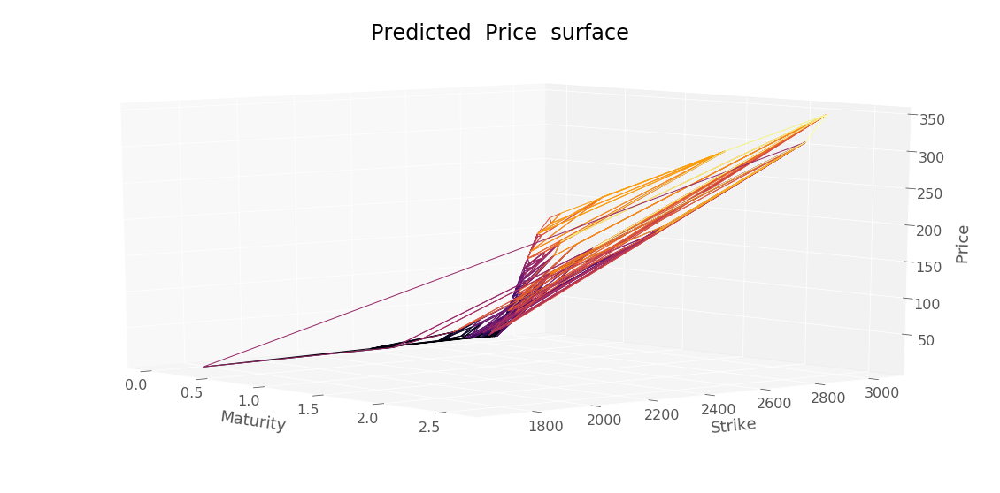

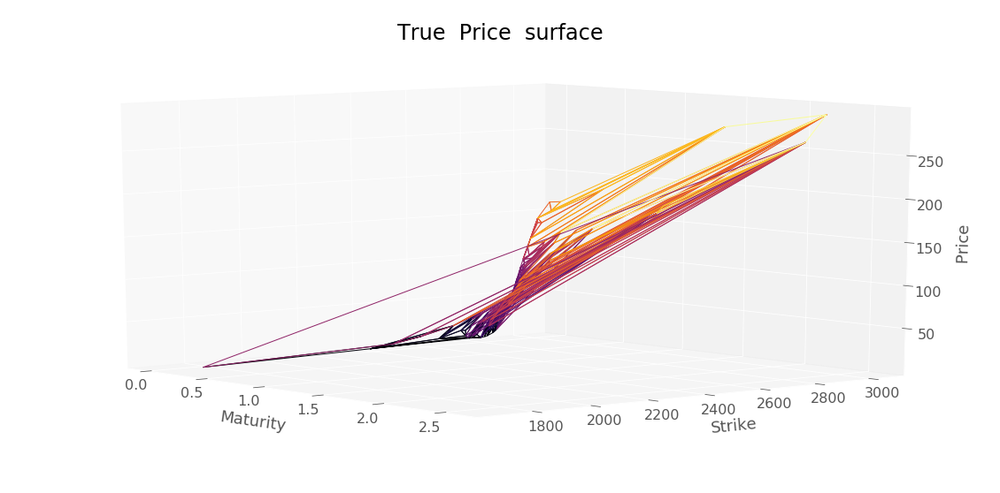

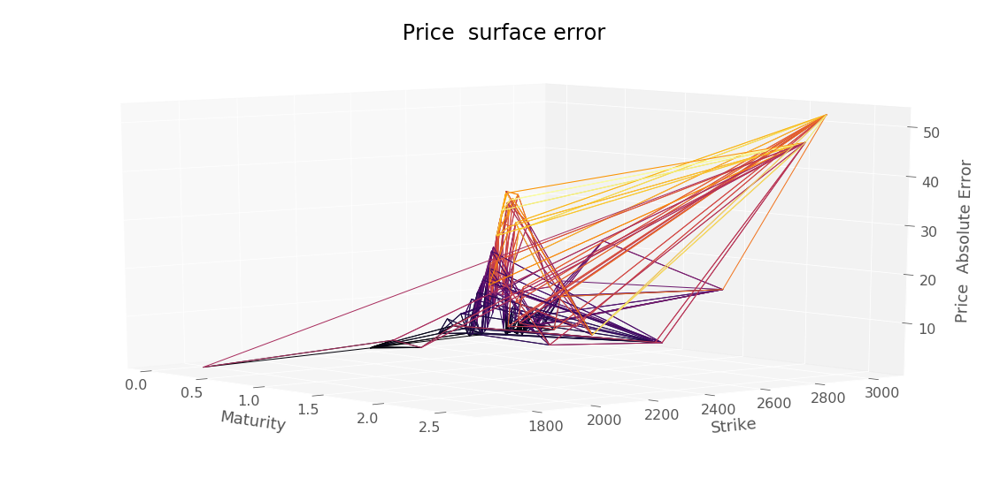

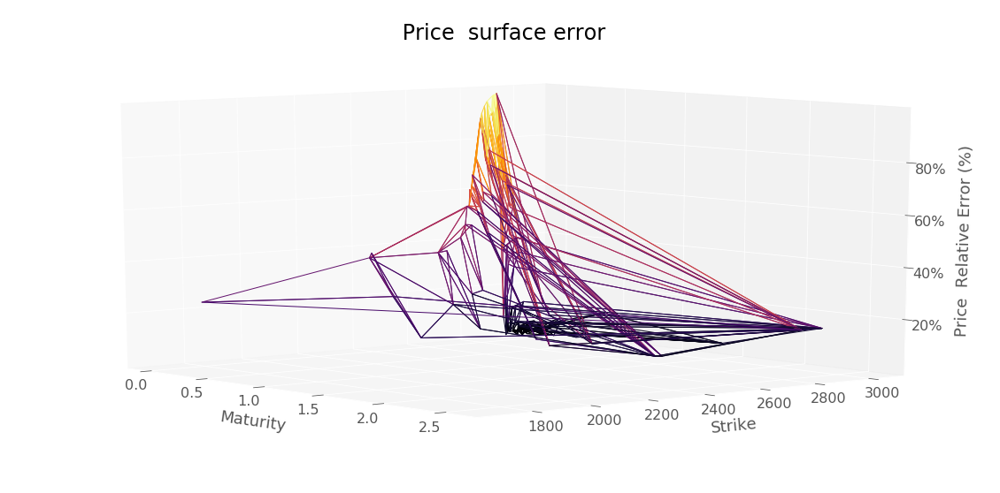

RMSE :  13.418144696130524


In [93]:
plotTools.predictionDiagnosis(pdeResSigmaGPTest, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [95]:
pdeResSigmaGPTest.to_csv(workingFolder + "pdeResSigmaGPTest.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


# Neural Network

In [25]:
importlib.reload(loadData)

<module 'loadData' from './code/loadData.py'>

# Learning Implied volatility
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [20]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 0.11#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 10#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.01
hyperparameters["lowerBoundGamma"] = 0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.1
hyperparameters["Patience"] = 100
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

In [21]:
importlib.reload(plotTools)

<module 'plotTools' from './code/plotTools.py'>

In [23]:
#Execute this cell if you want to fit neural network with implied volatilities
res = neuralNetwork.create_train_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                                scaledDataSet,
                                                True,
                                                hyperparameters,
                                                scaler,
                                                modelName = "convexSoftGatheralVolModel")
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

In [ ]:
plotTools.plotEpochLoss(lossSerie4G)
lossSerie4G.iloc[-1]

In [ ]:
y_pred4G.head()

Best loss (hidden nodes: 100, iterations: 0): -4.85
Best Penalization :  [0.0077710683, [2.0793073e-05, 0.0, 2.7372242e-05]]
Best Penalization (Refined Grid):  [[6.343362e-05, 0.0, 2.3141181e-05]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


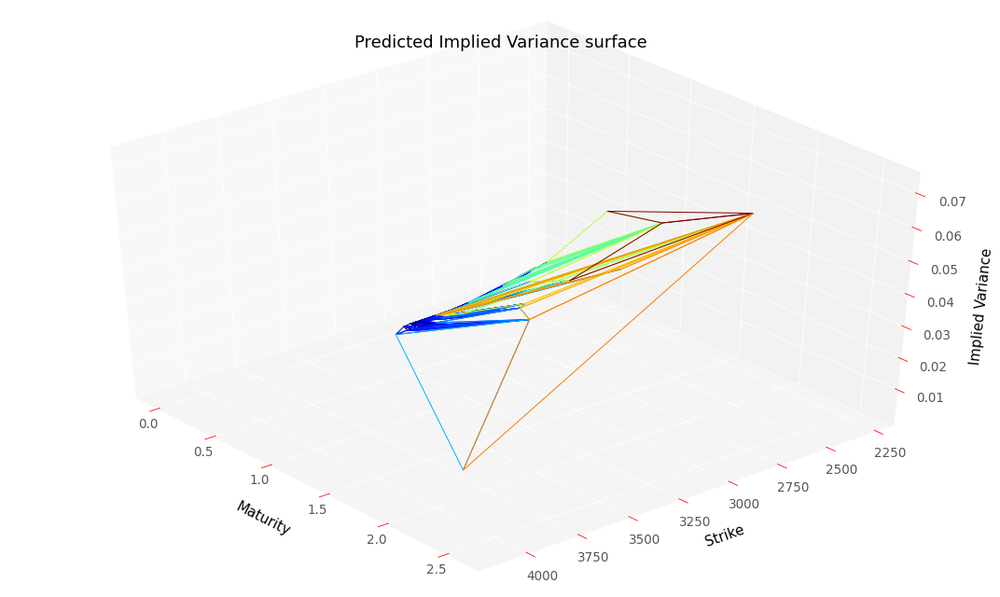

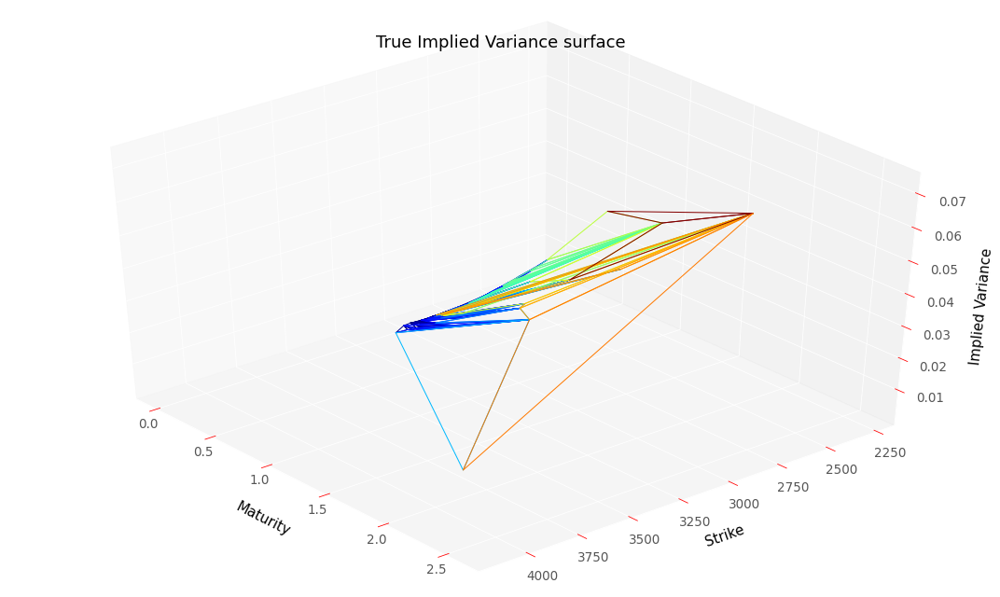

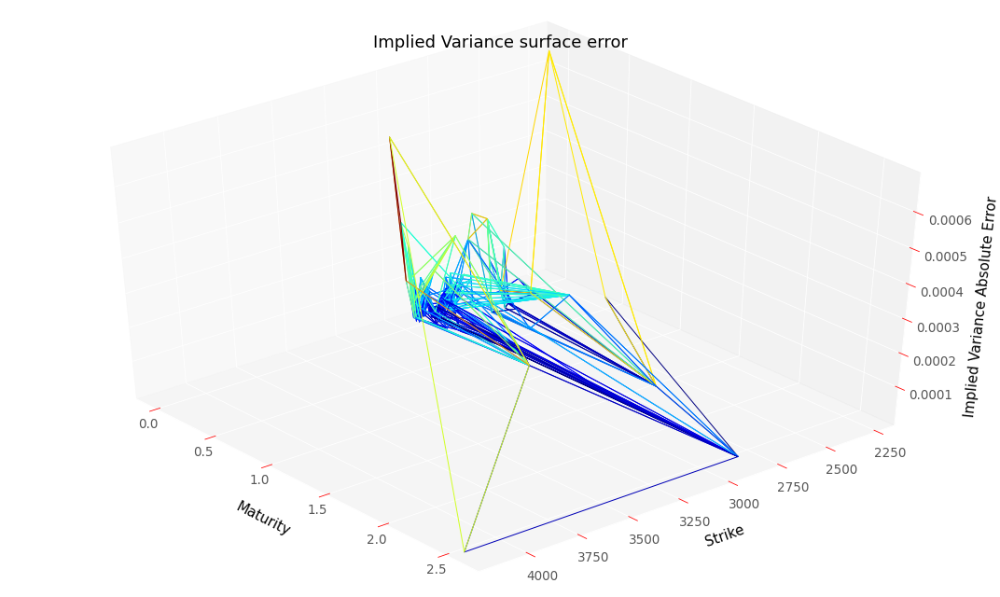

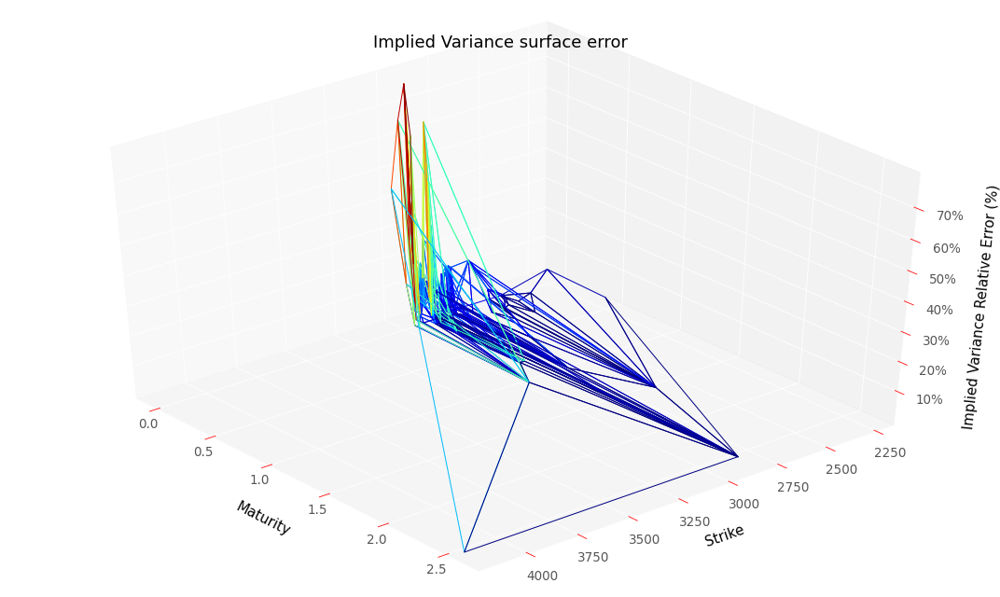

RMSE :  0.00011737072502775169
RMSE Relative:  0.17366689367316374


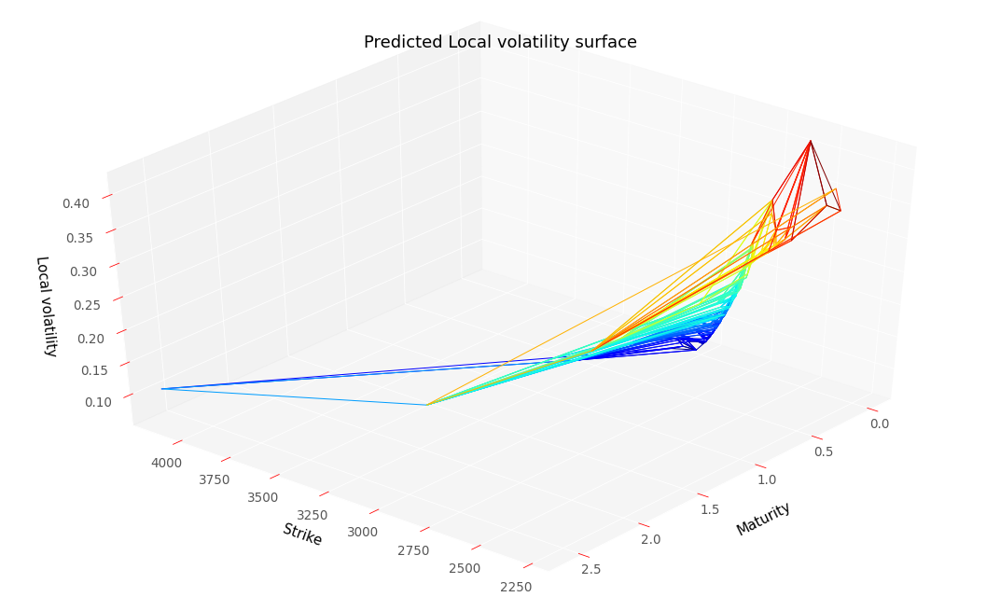

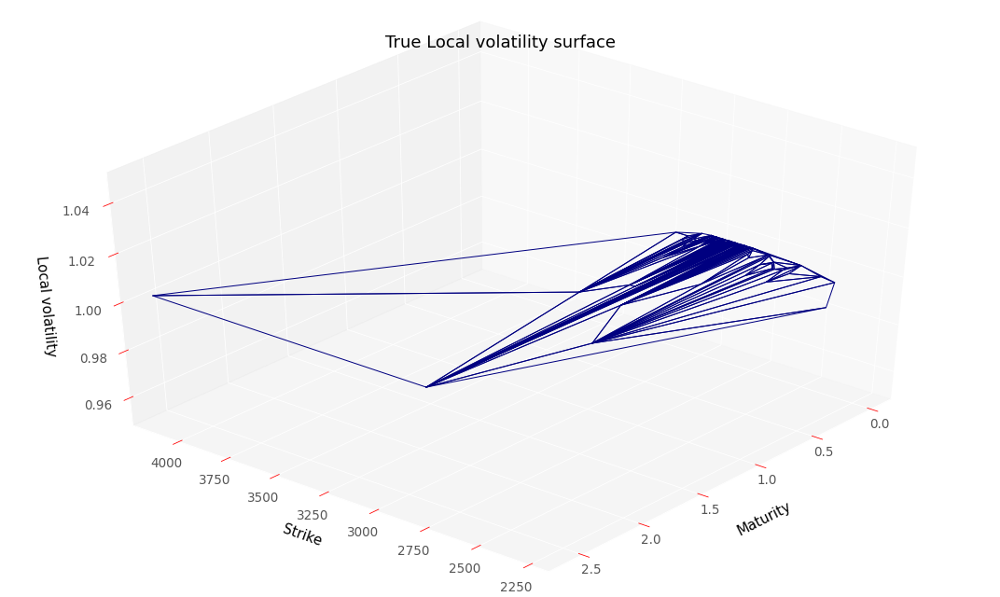

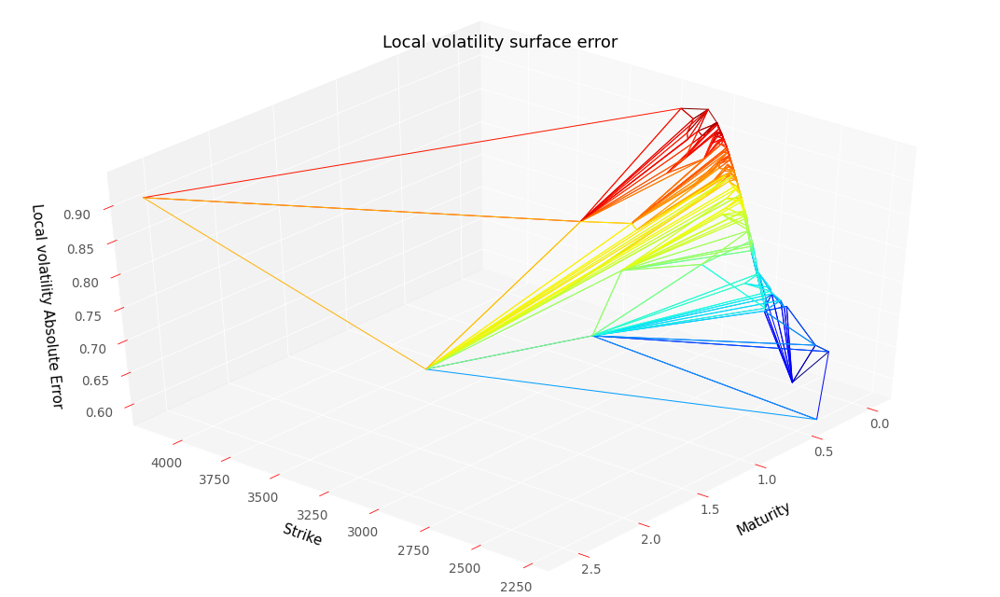

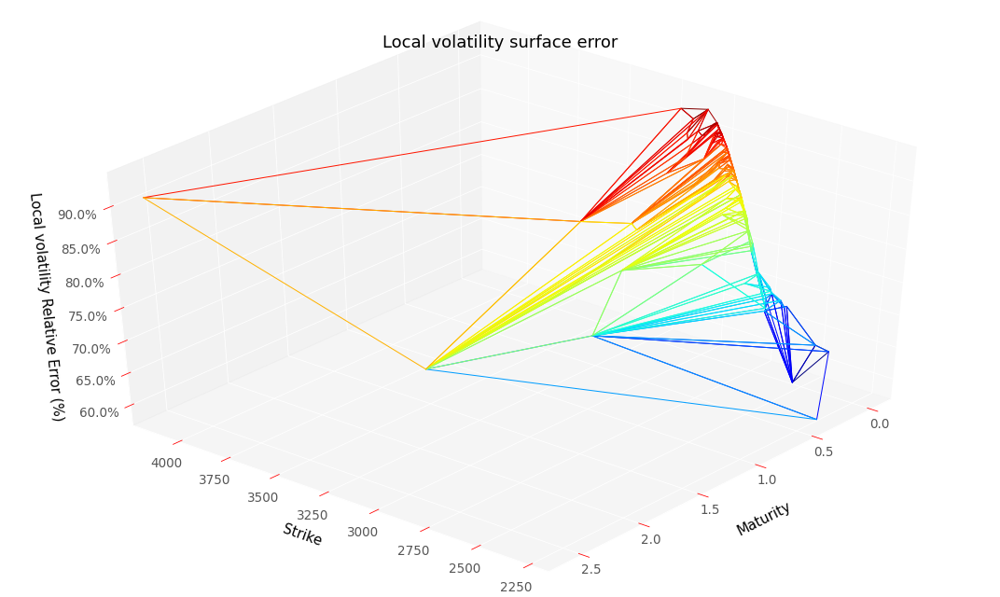

RMSE :  0.8422661937673223
RMSE Relative:  0.8422661937673223


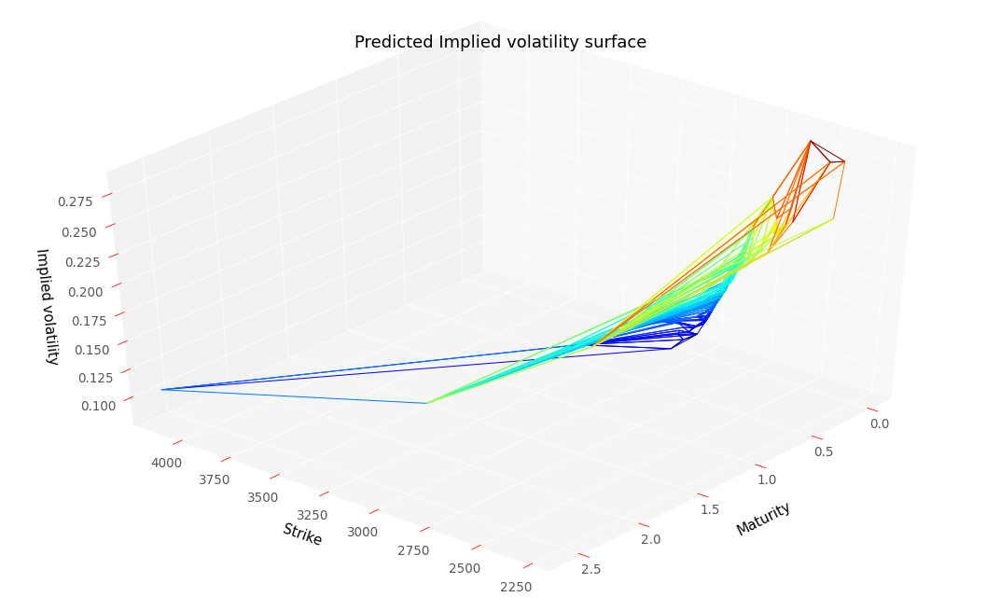

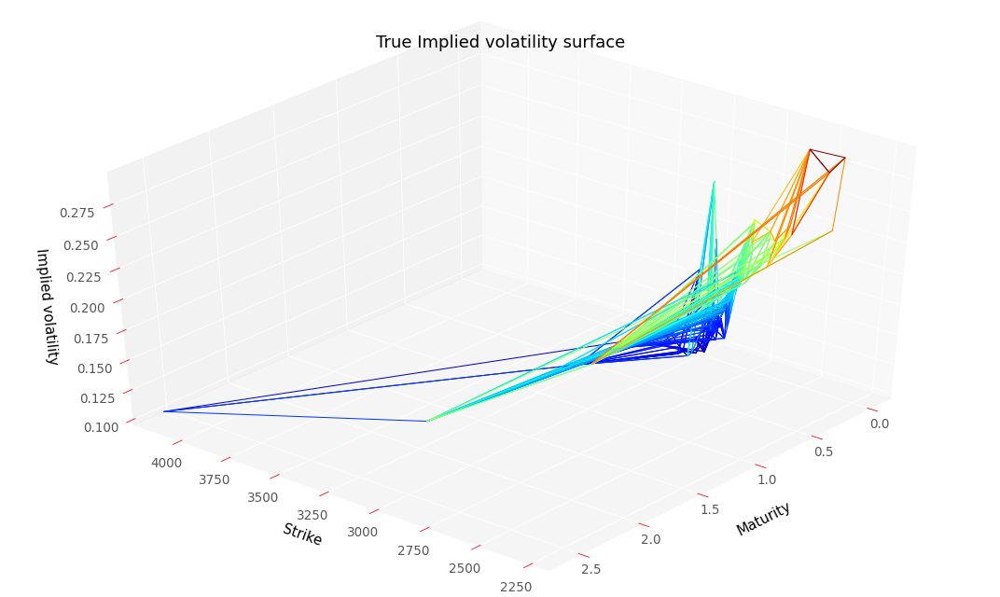

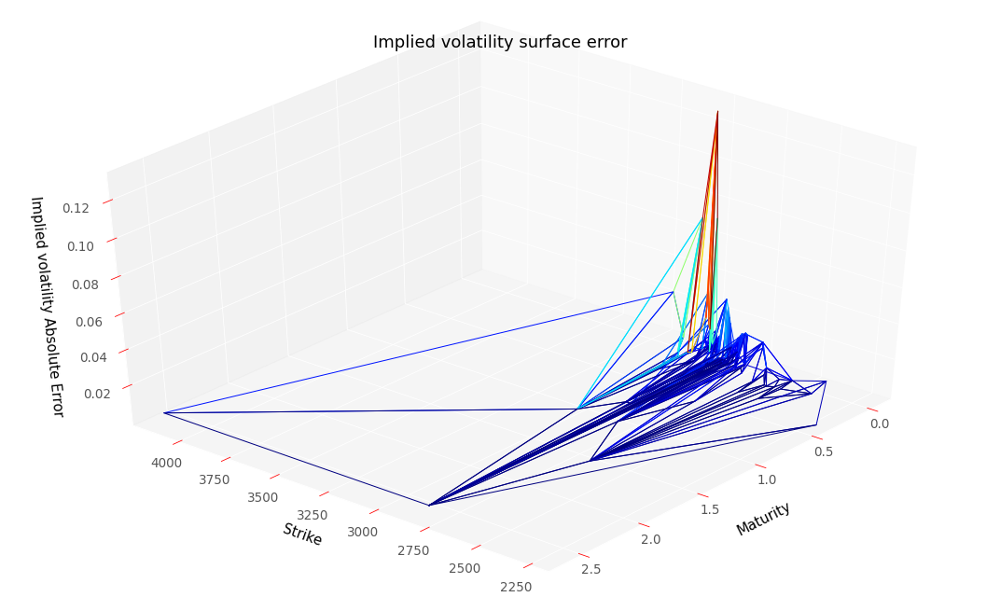

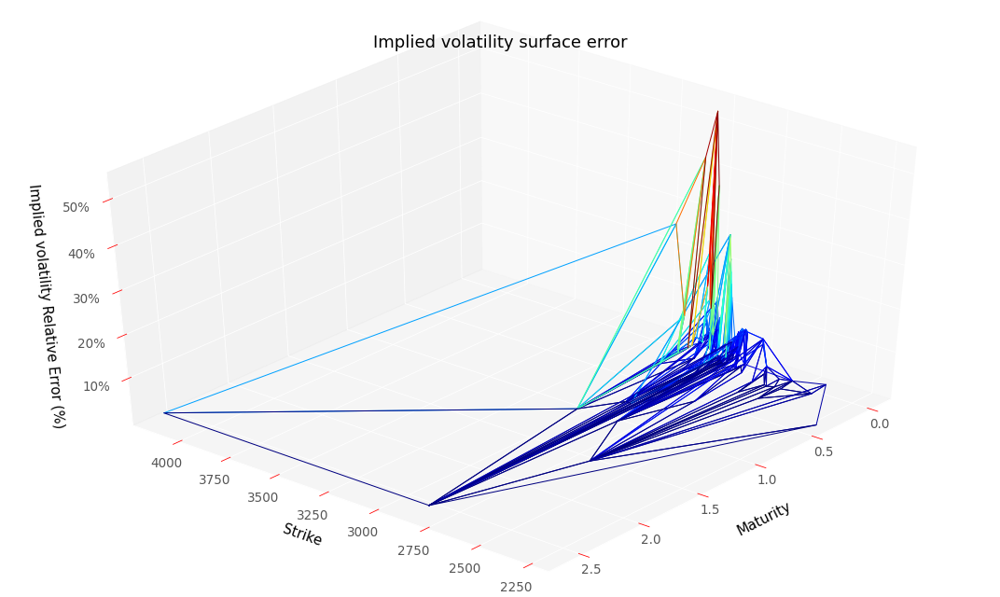

RMSE :  0.01729487649982604
RMSE Relative:  0.09700772649388352


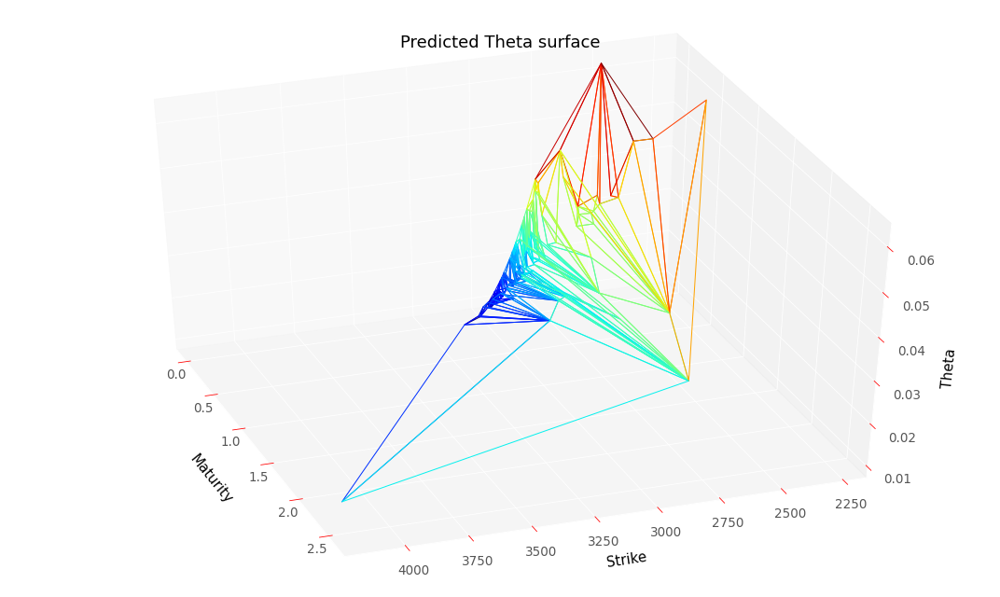

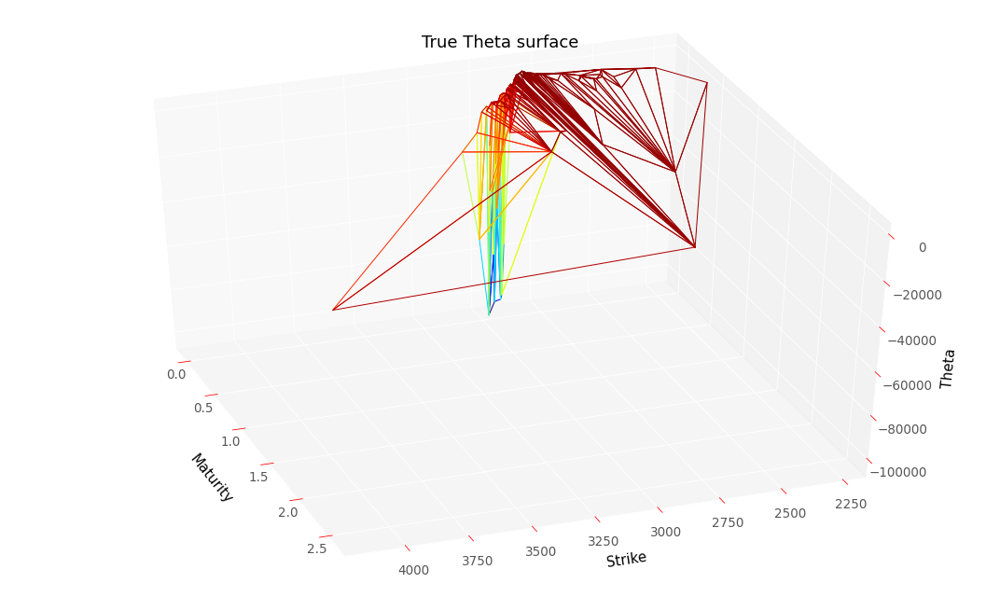

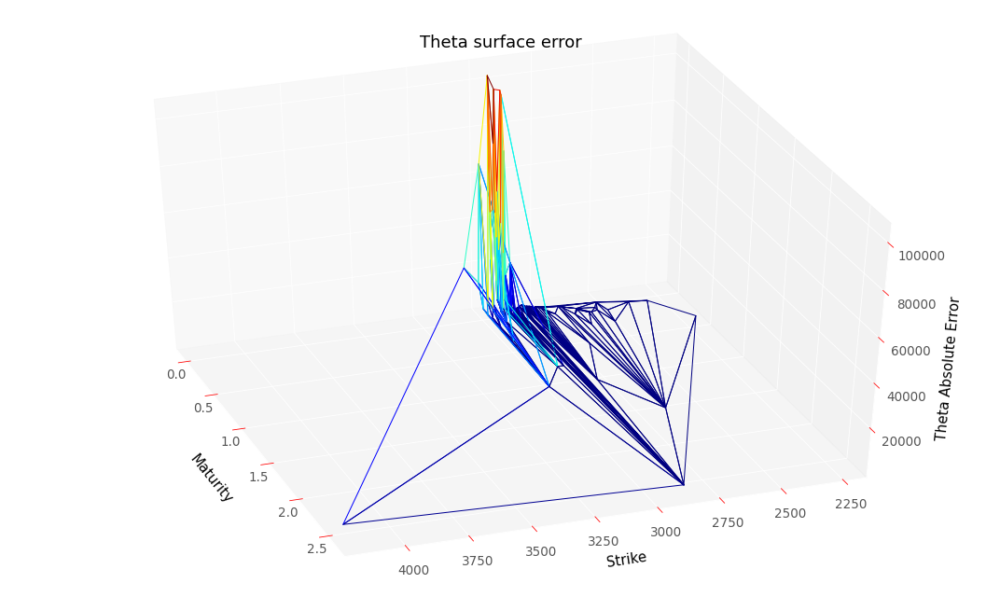

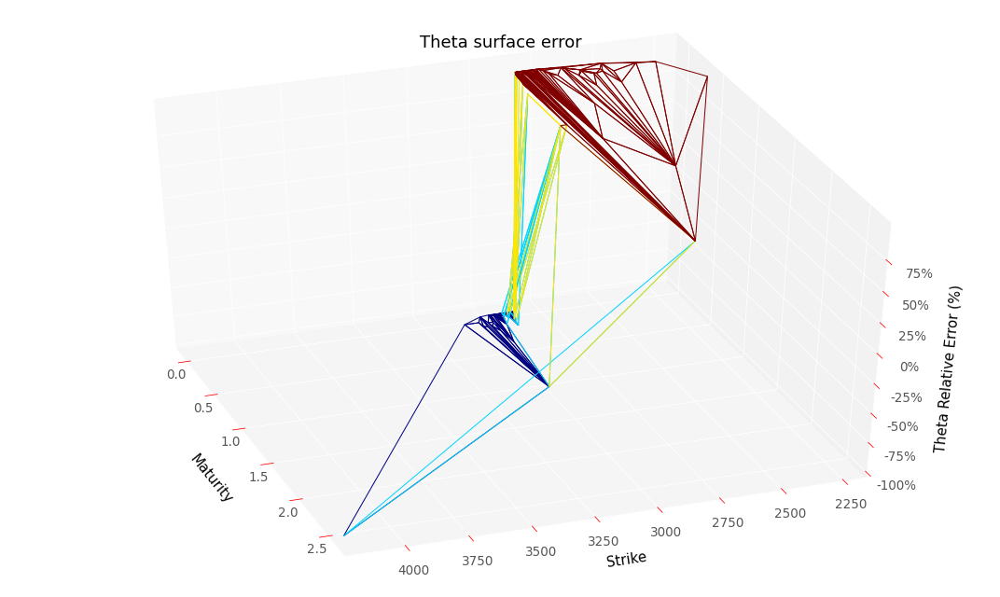

RMSE :  24400.9320965185
RMSE Relative:  0.9999502509702101


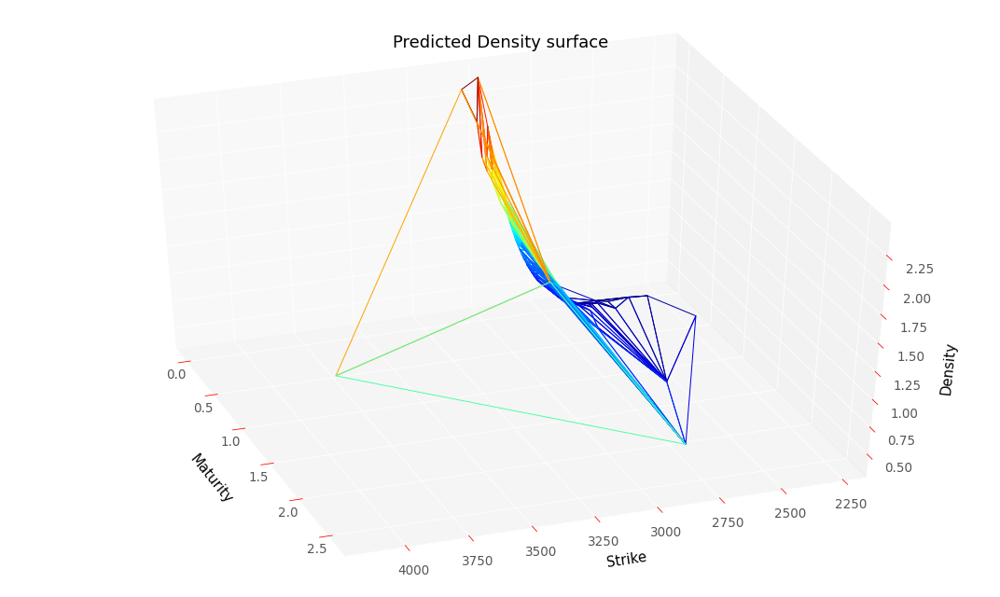

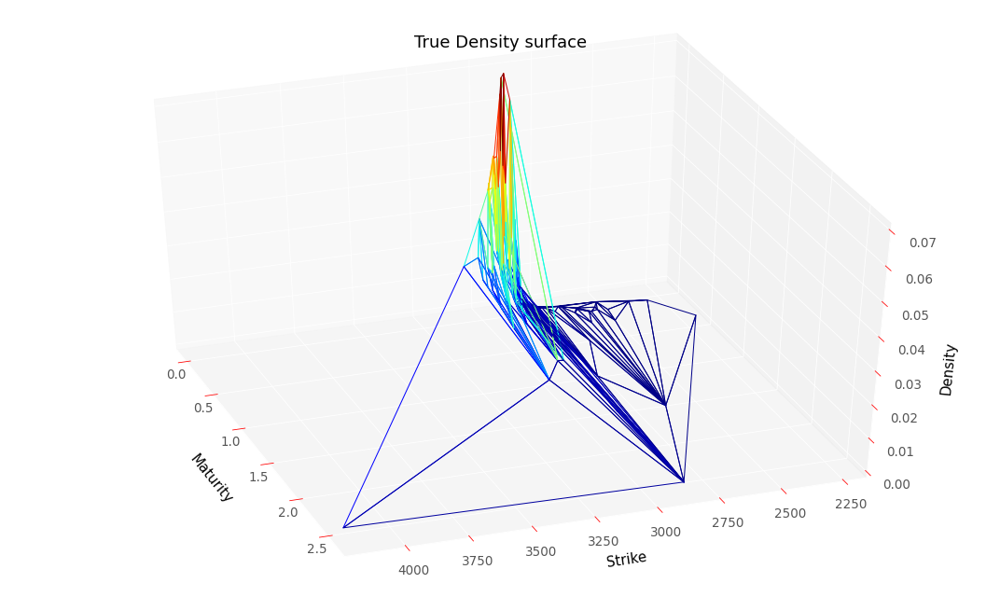

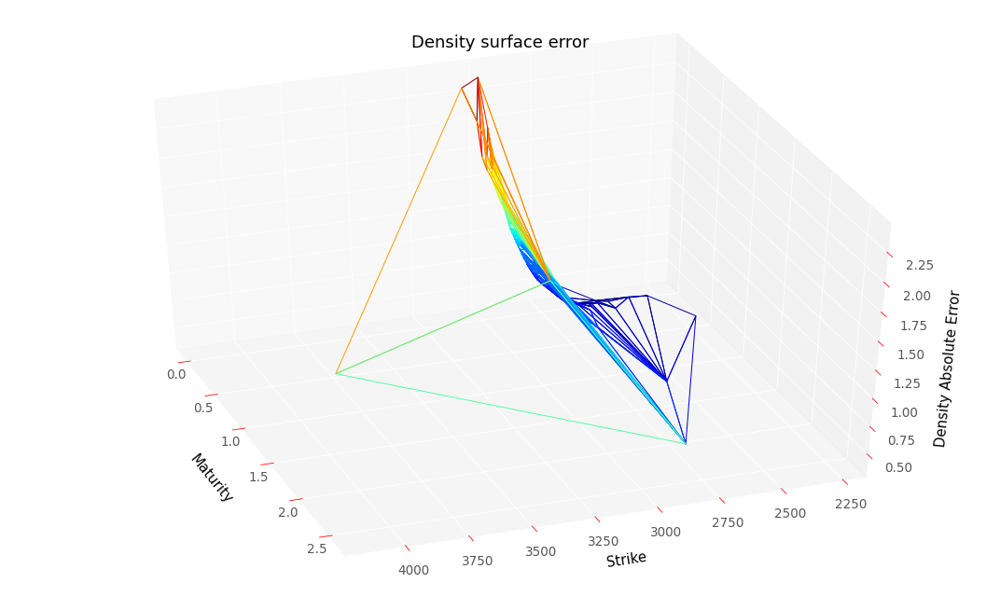

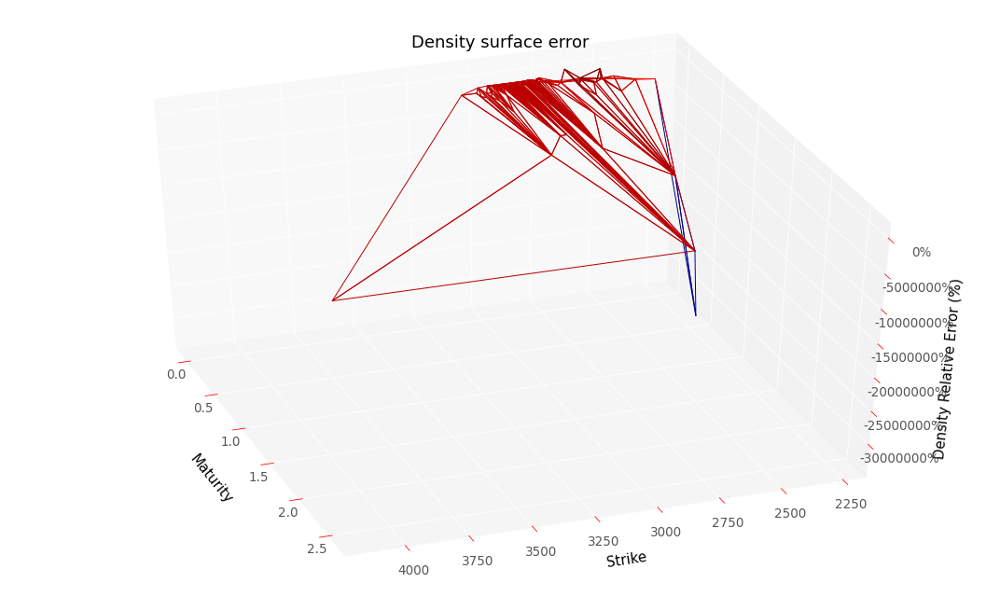

RMSE :  1.174163600695211
RMSE Relative:  29520.87755444783


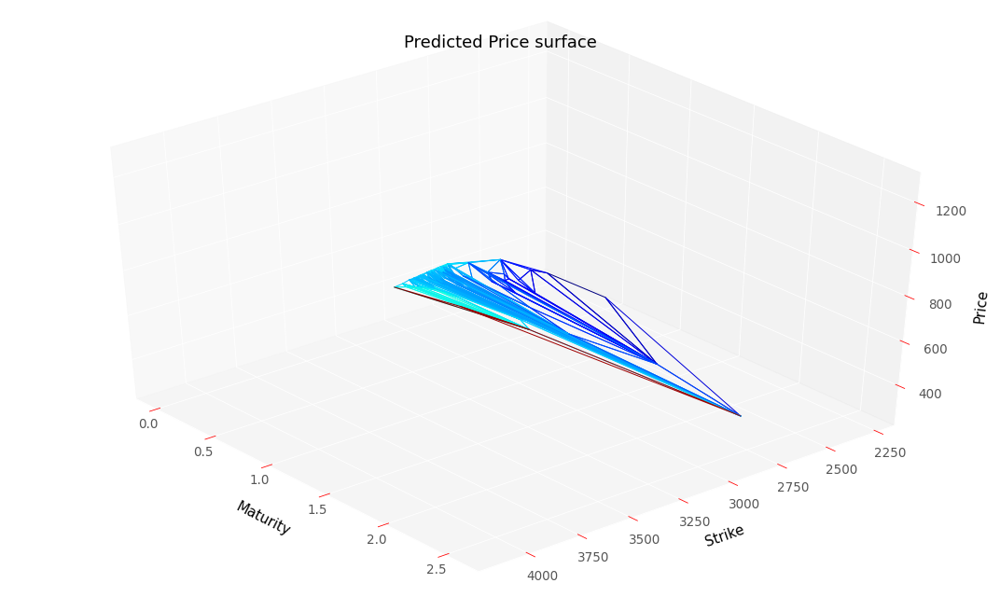

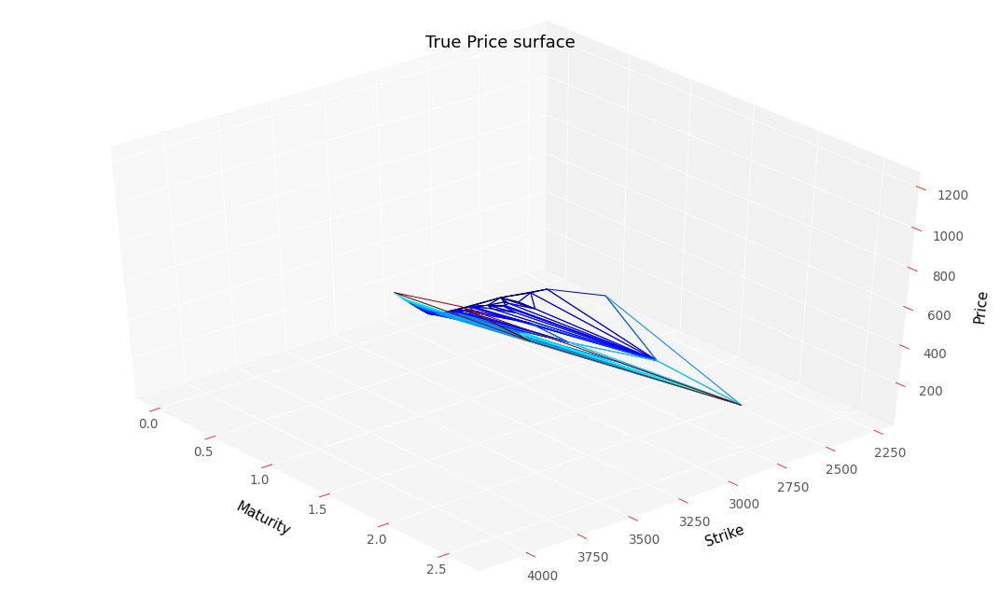

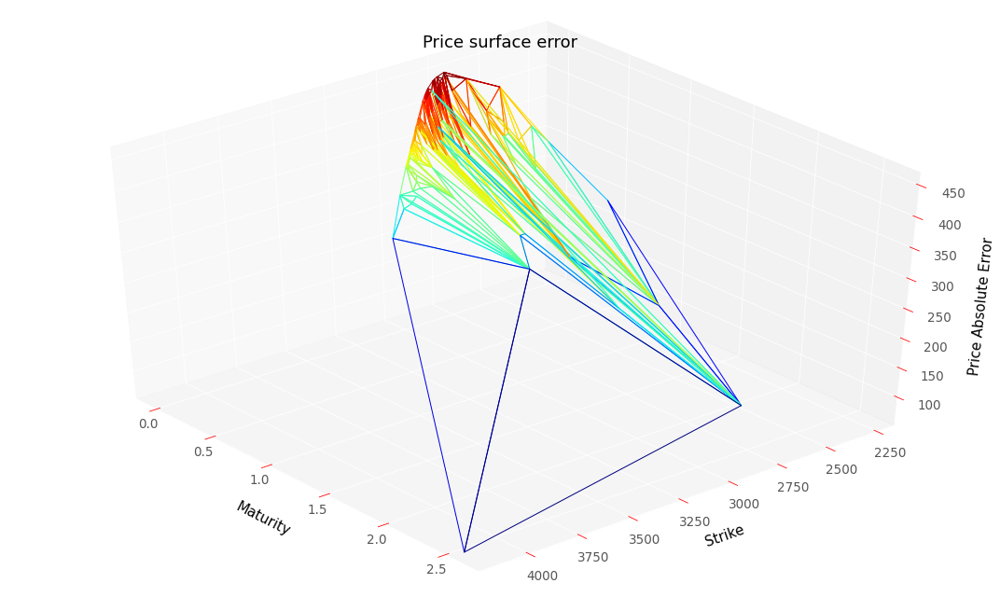

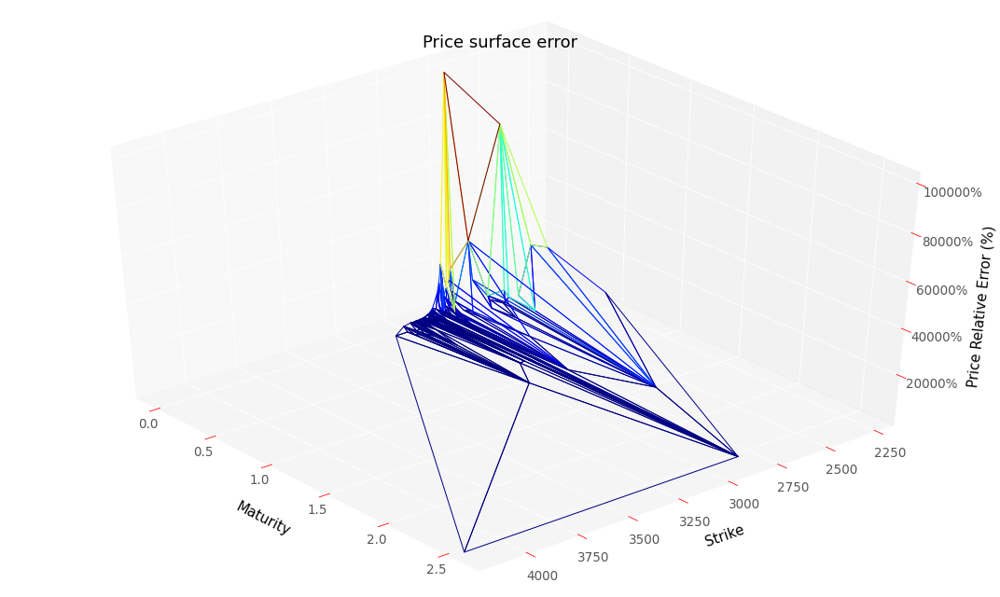

RMSE :  373.7916708622368
RMSE Relative:  122.61528875090404


In [43]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               scaledDataSet,
                                               True,
                                               hyperparameters,
                                               scaler,
                                               modelName = "convexSoftGatheralVolModel")
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

plotTools.modelSummaryGatheral(y_pred4G, 
                               volLocale4G, 
                               dNN_T4G, 
                               gNN_K4G, 
                               dataSet,
                               yMin = KMin,
                               yMax = KMax, 
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               savePath = "NeuralImpliedVolTrain")

In [32]:
volLocale4G.loc[(midS0,slice(None))]

Strike  Maturity
2860.0  0.005       0.158827
        0.011       0.154111
        0.036       0.140406
        0.074       0.133263
        0.112       0.135797
        0.285       0.149756
Name: Dupire, dtype: float32

Best loss (hidden nodes: 100, iterations: 0): -4.65
Best Penalization :  [0.0094402125, [1.466901e-05, 0.0, 0.0]]
Best Penalization (Refined Grid):  [[6.343362e-05, 0.0, 2.3141181e-05]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


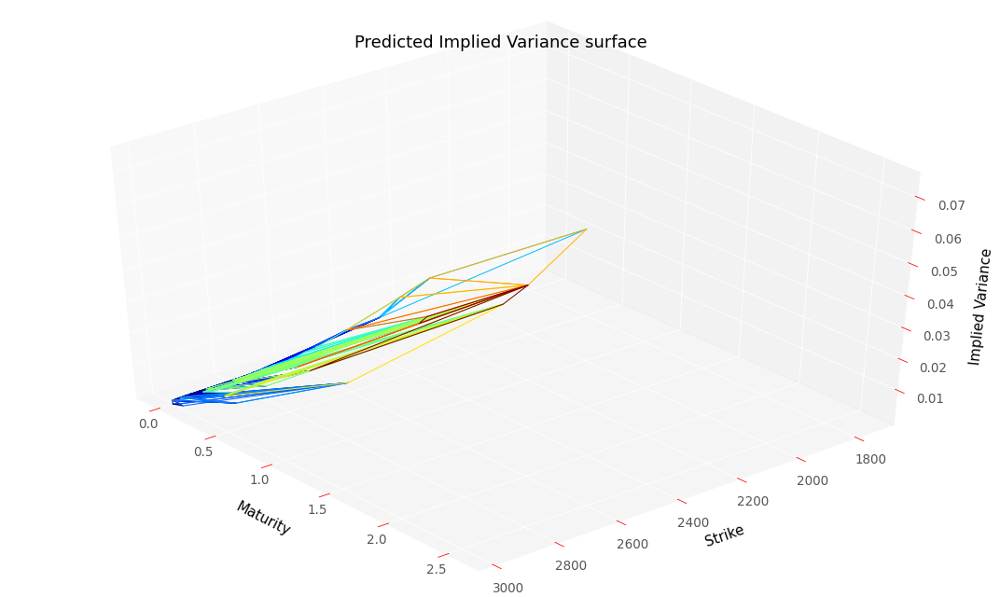

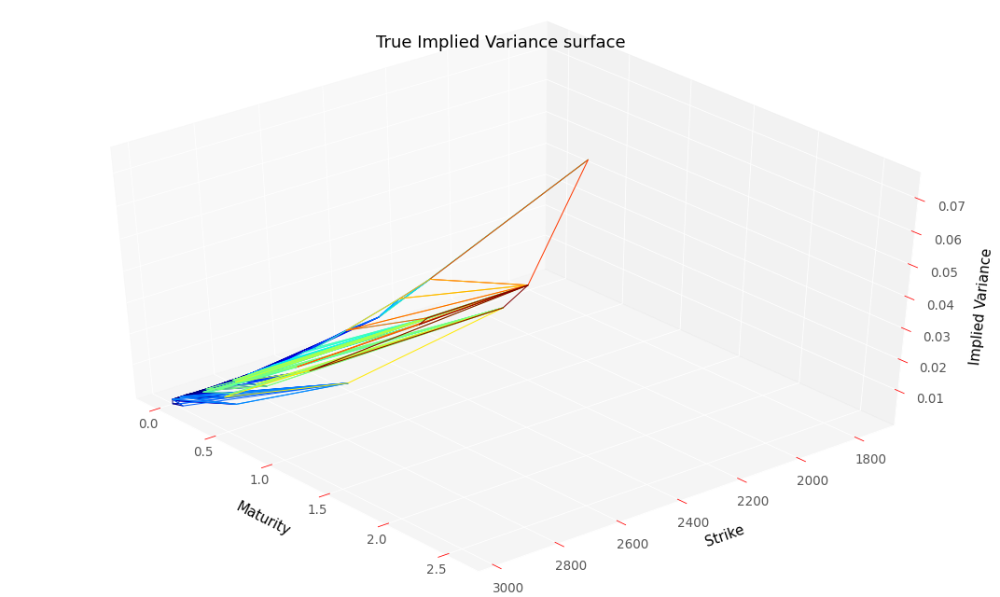

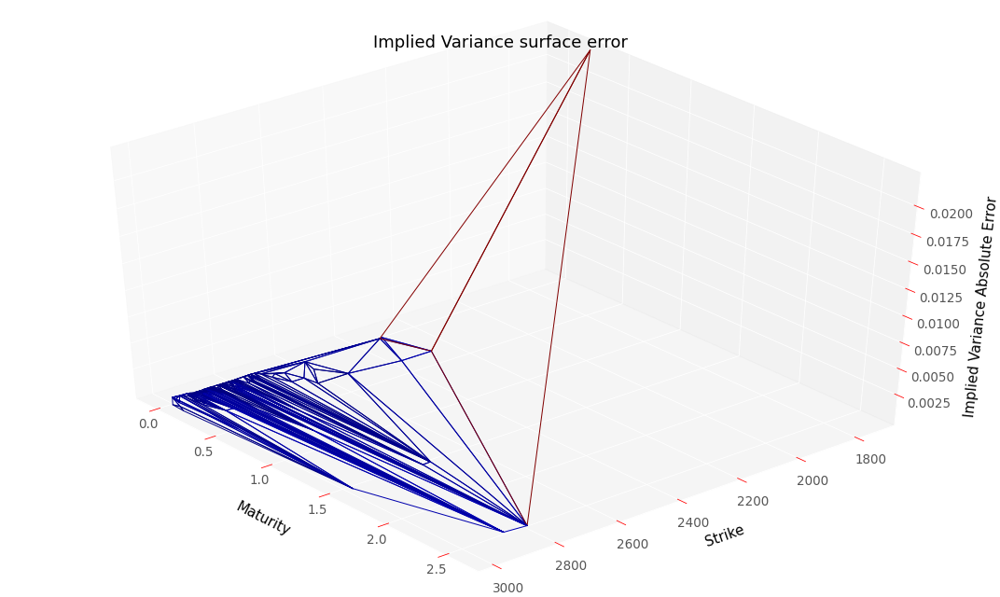

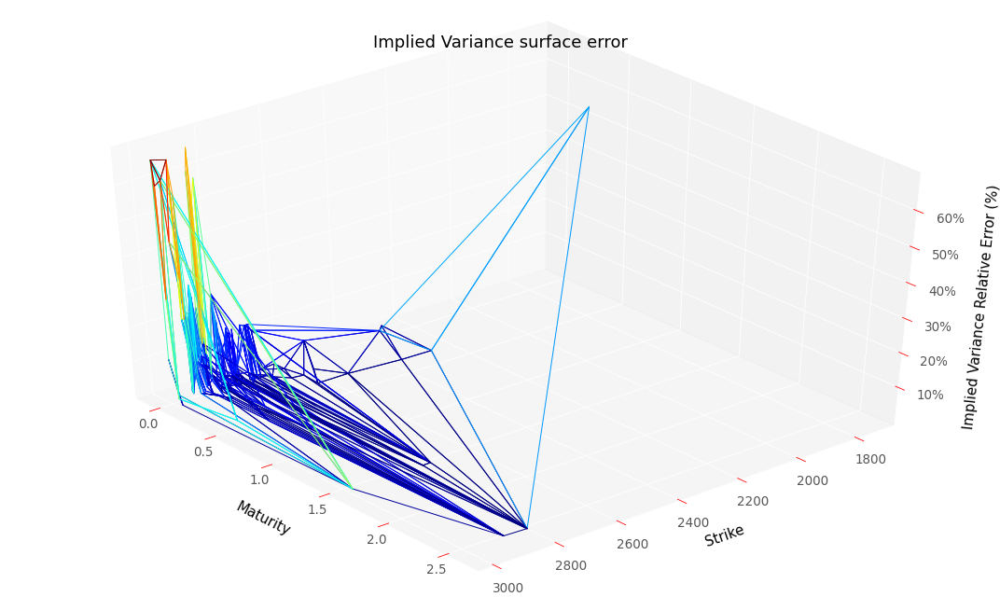

RMSE :  0.0018777898557249175
RMSE Relative:  0.19685517506903152


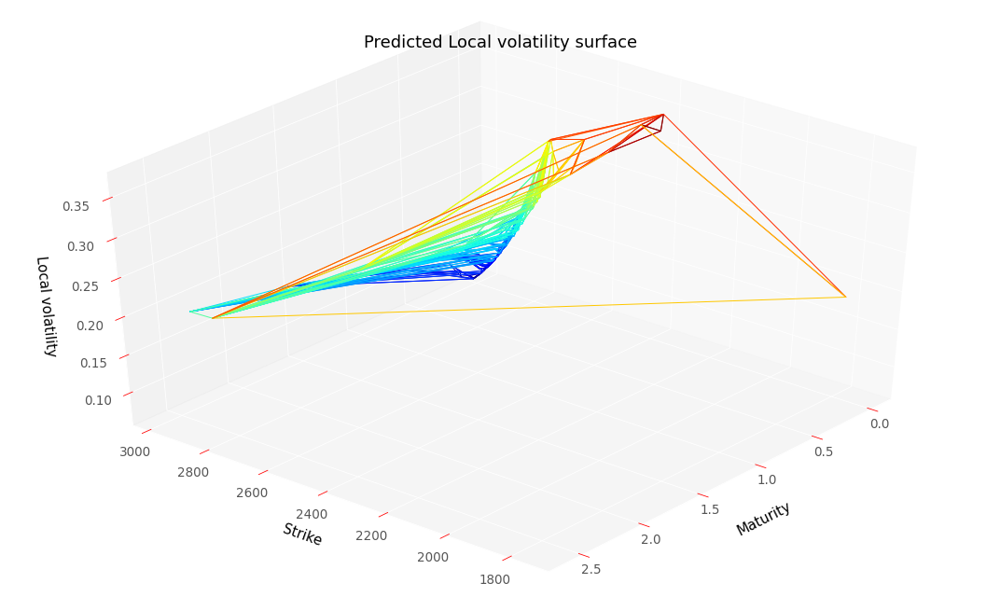

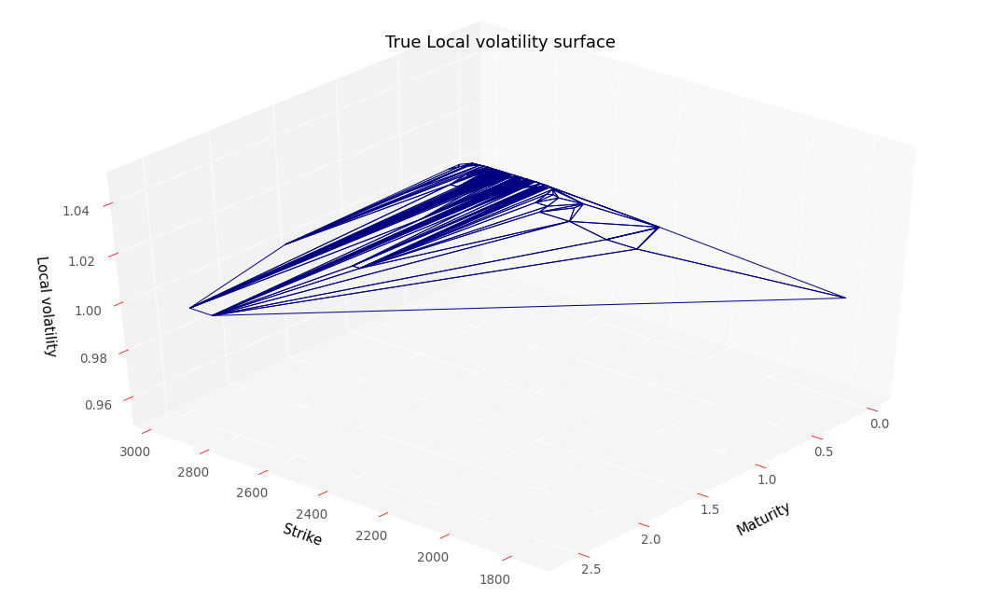

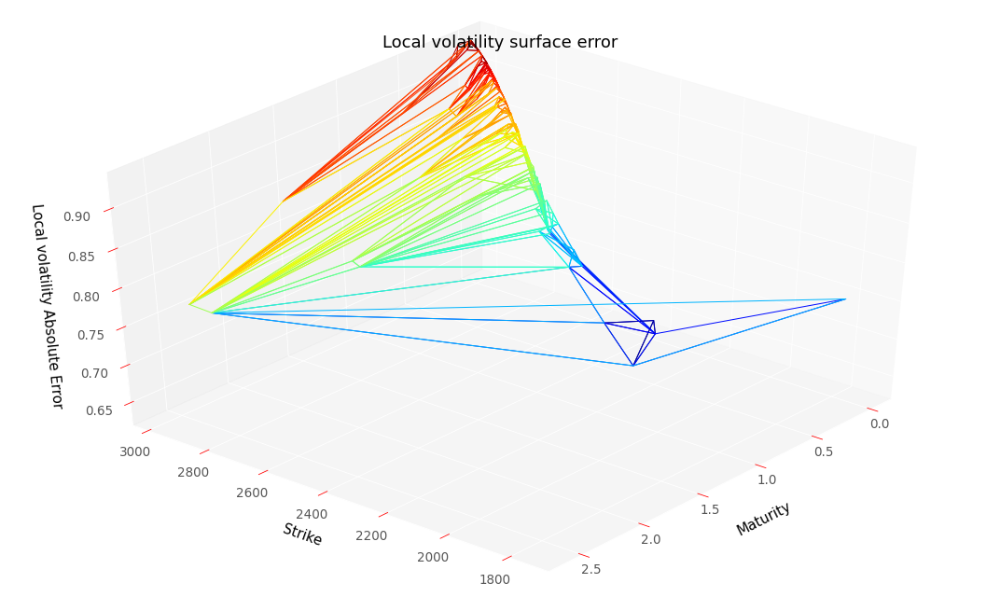

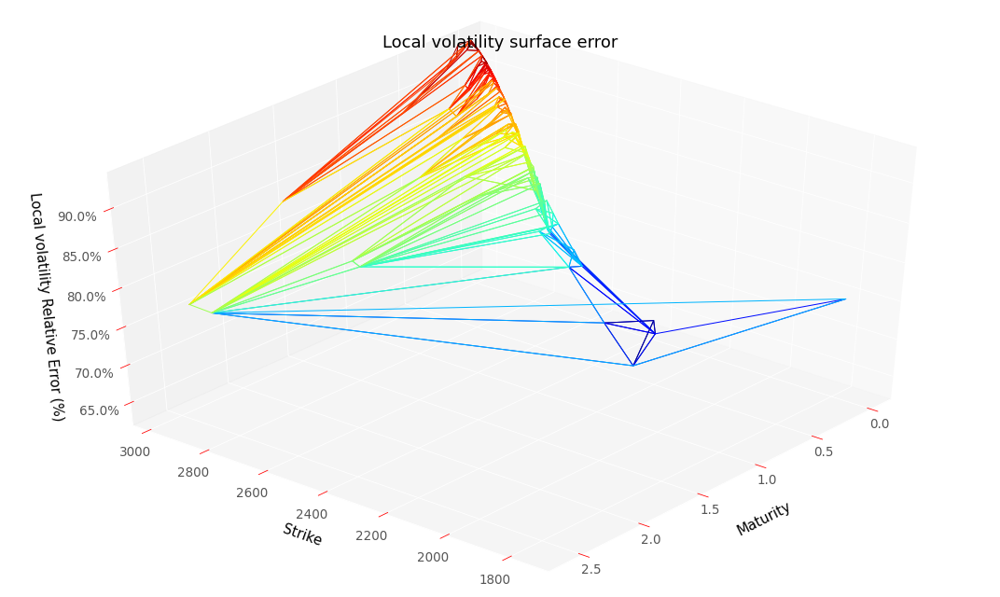

RMSE :  0.8441047102240293
RMSE Relative:  0.8441047102240293


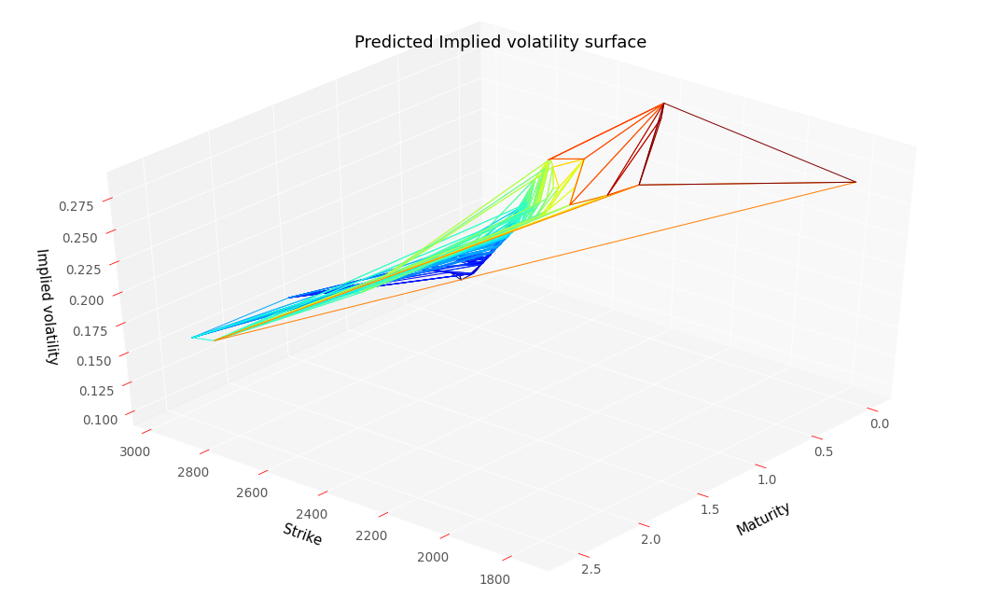

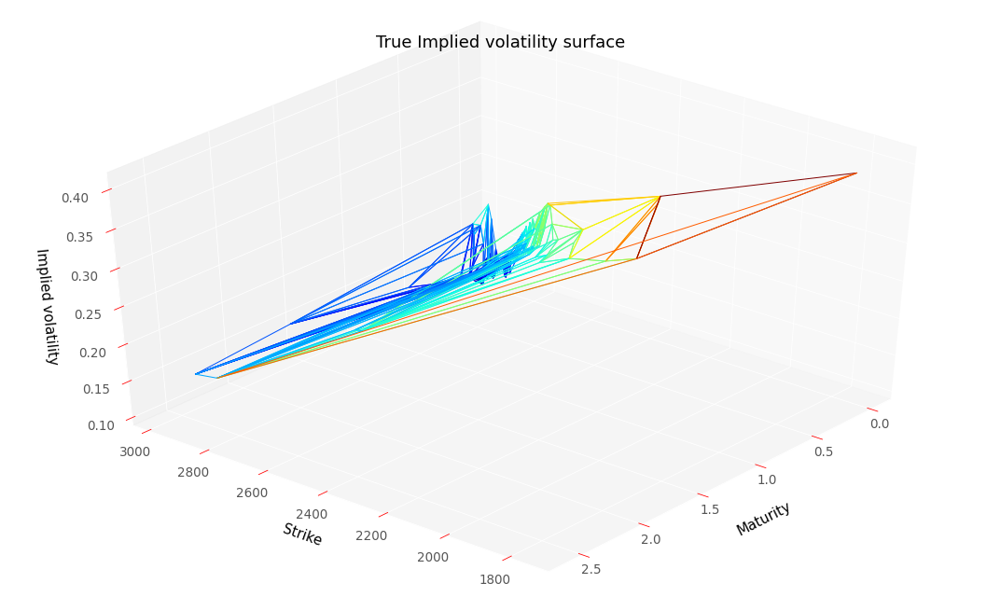

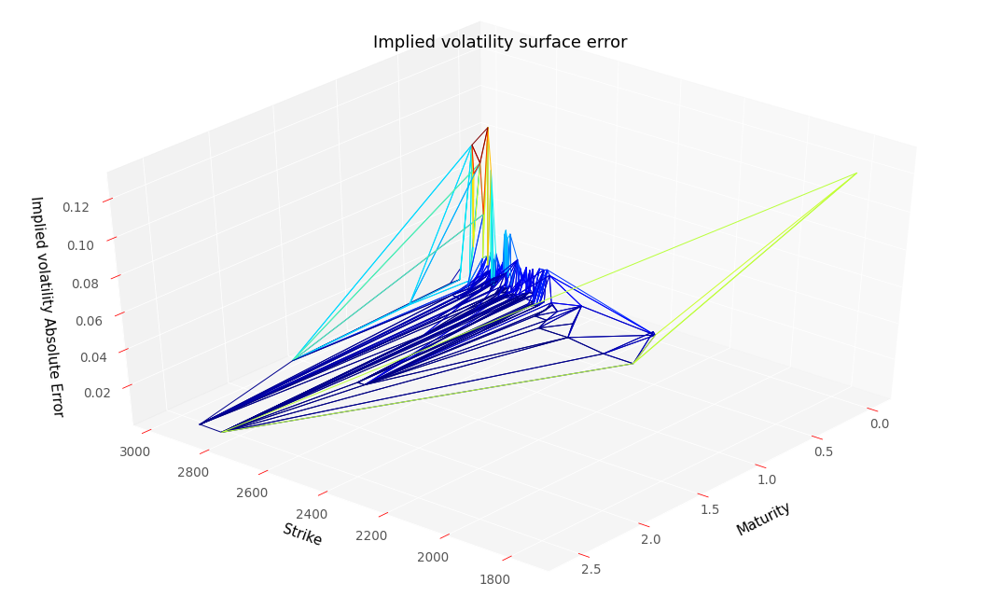

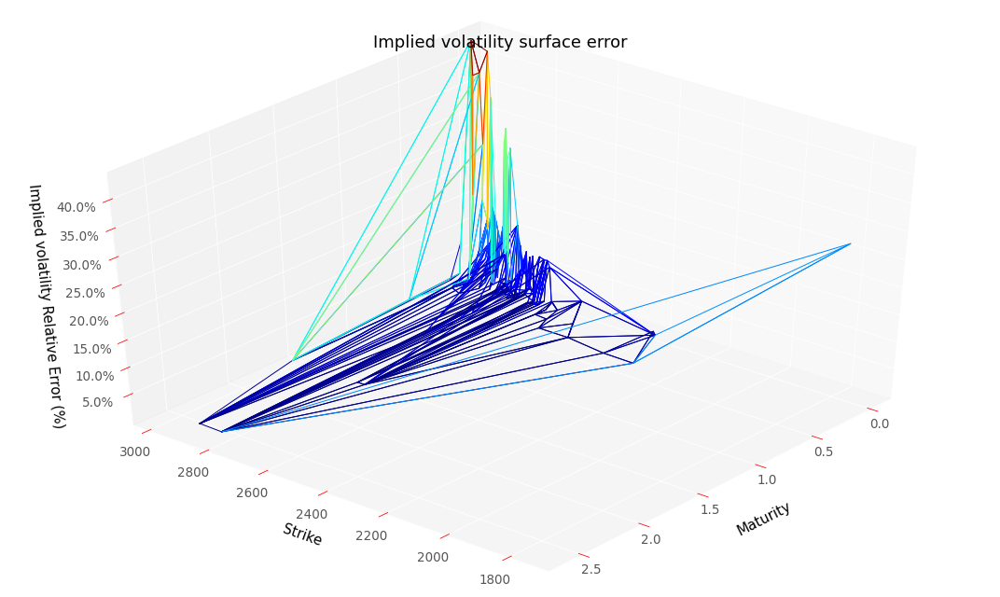

RMSE :  0.01970936139837763
RMSE Relative:  0.10624786459415692


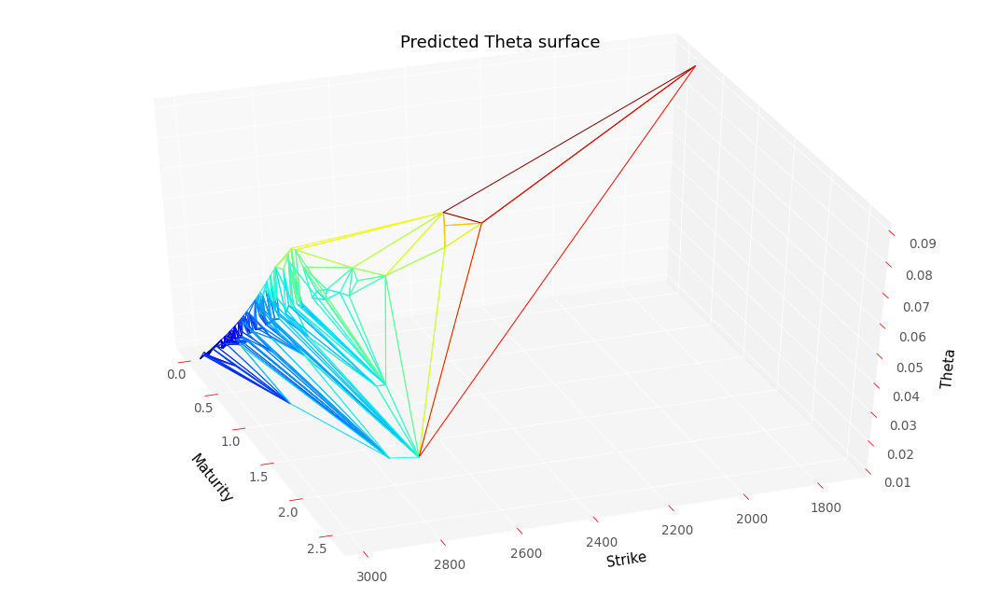

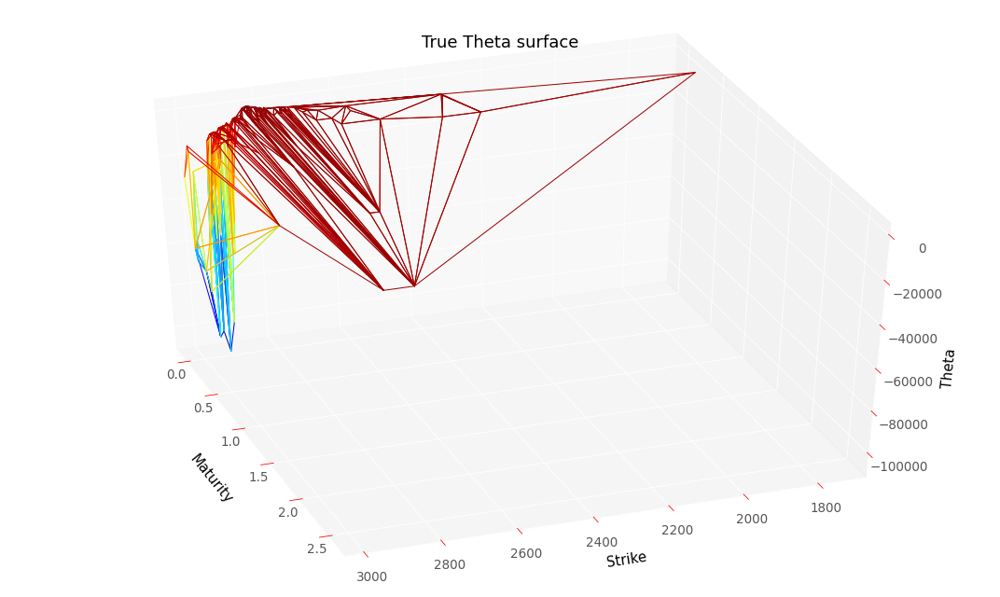

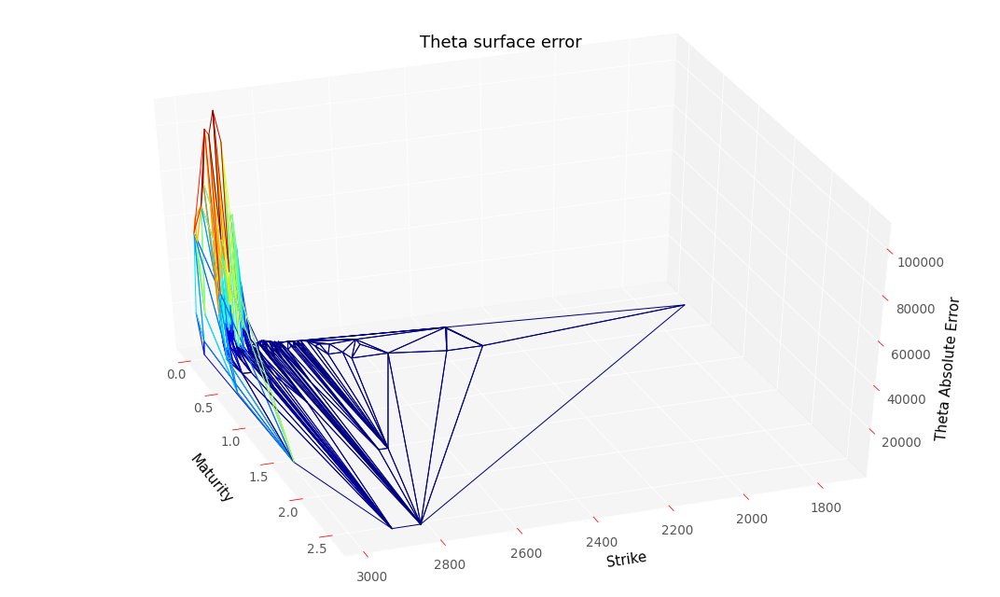

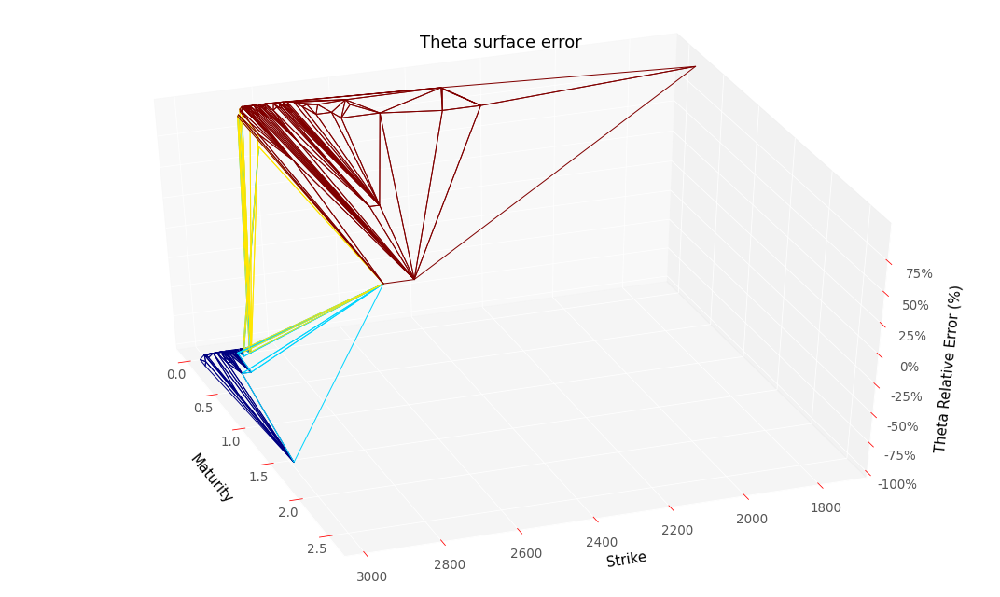

RMSE :  25030.370402205386
RMSE Relative:  0.999944742927822


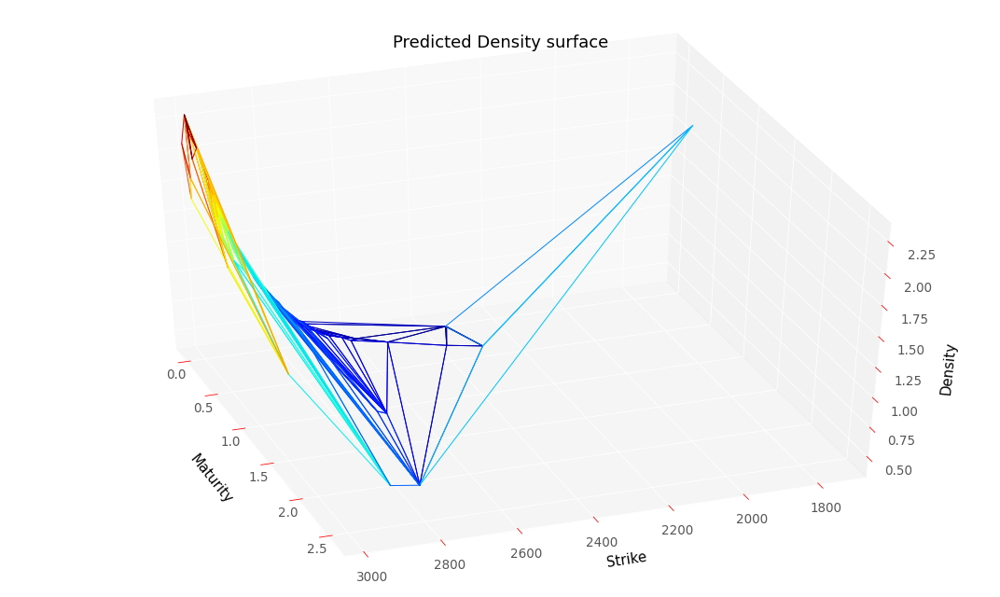

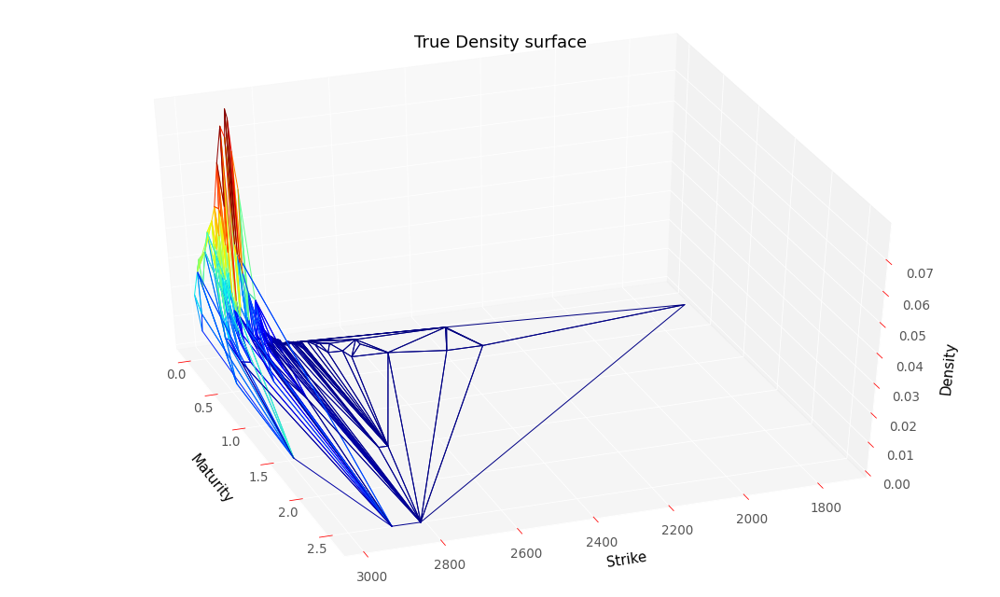

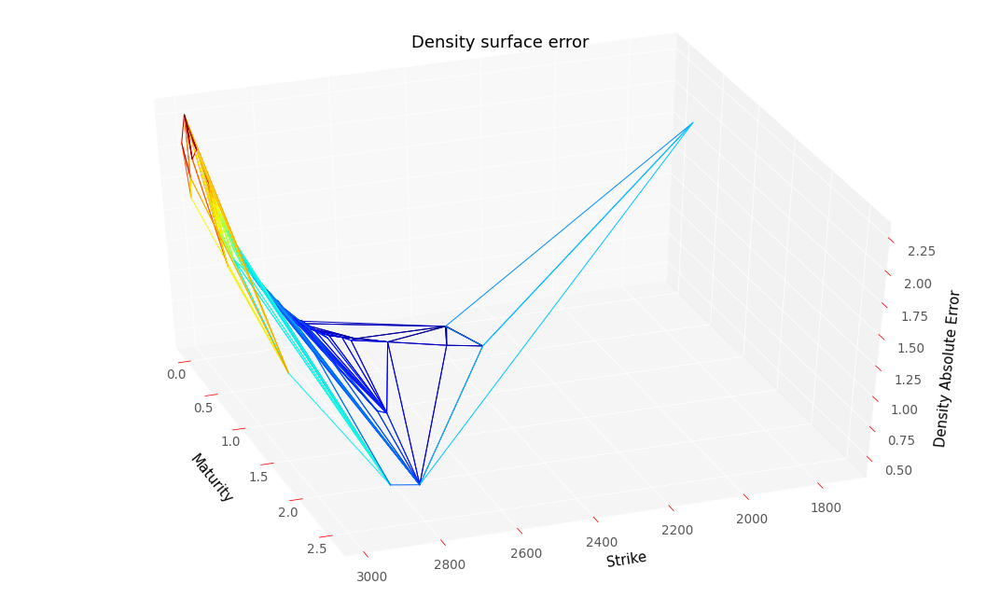

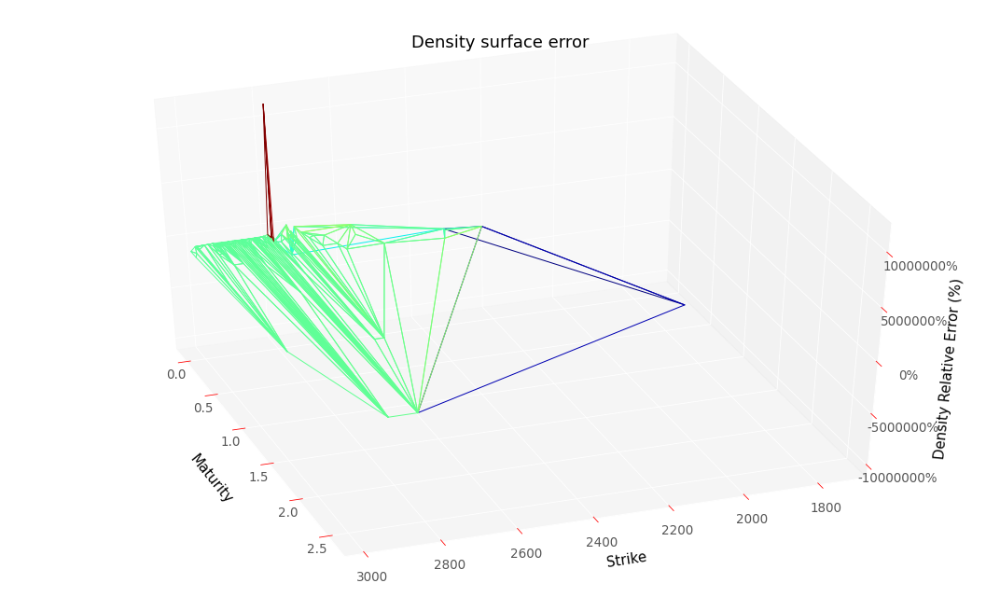

RMSE :  1.1704252110966398
RMSE Relative:  13748.909463740392


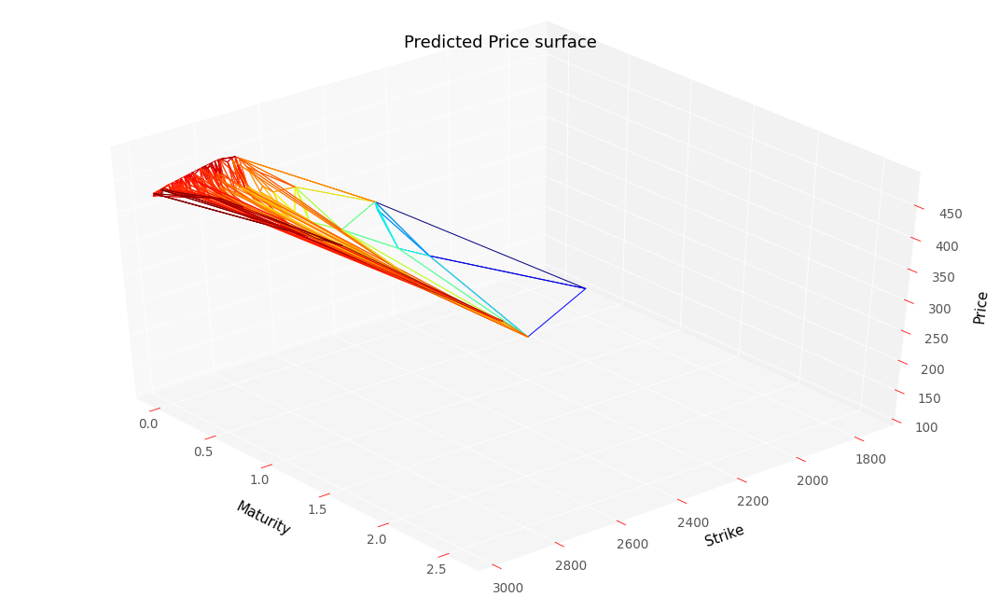

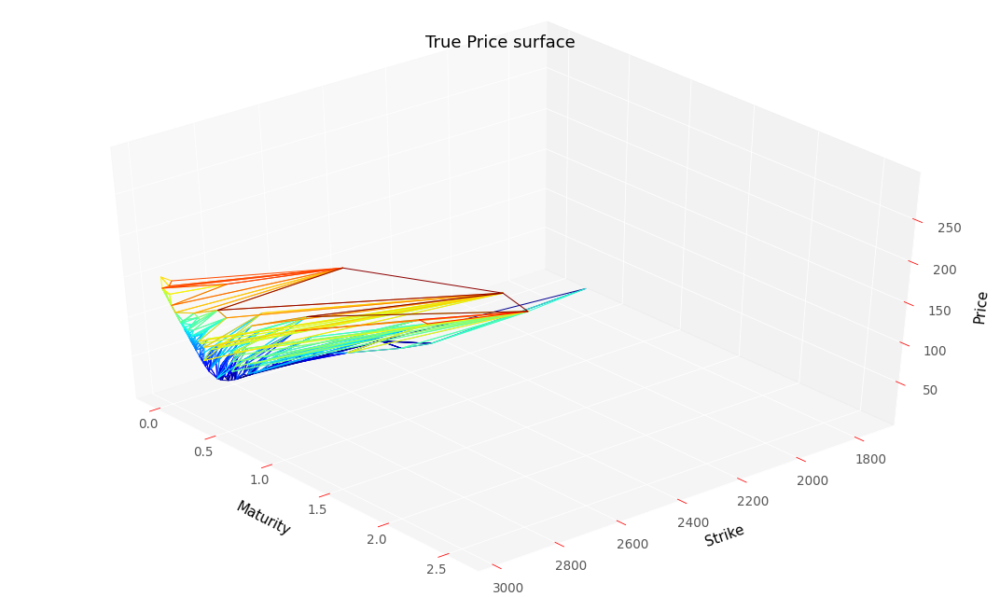

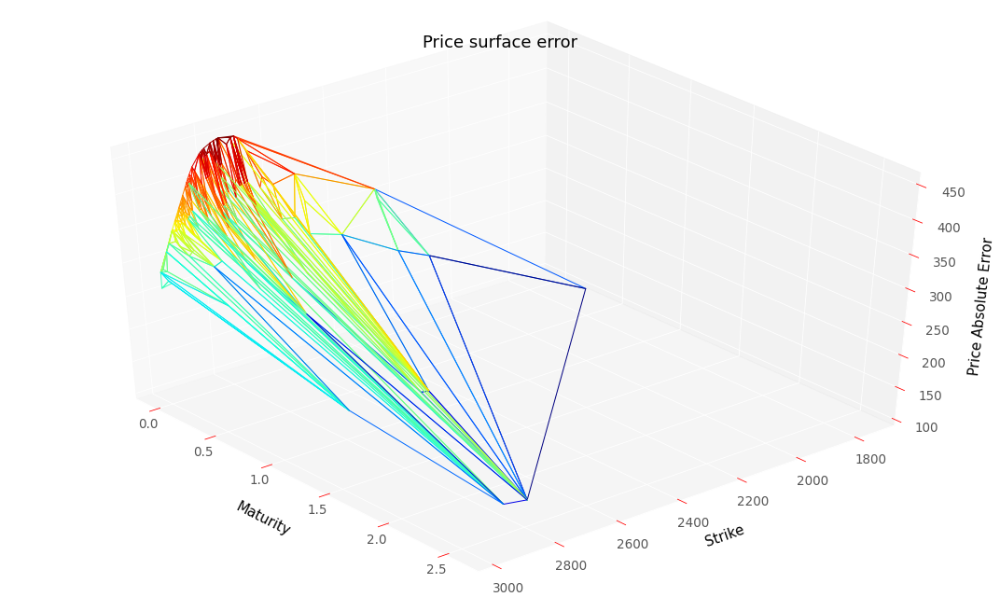

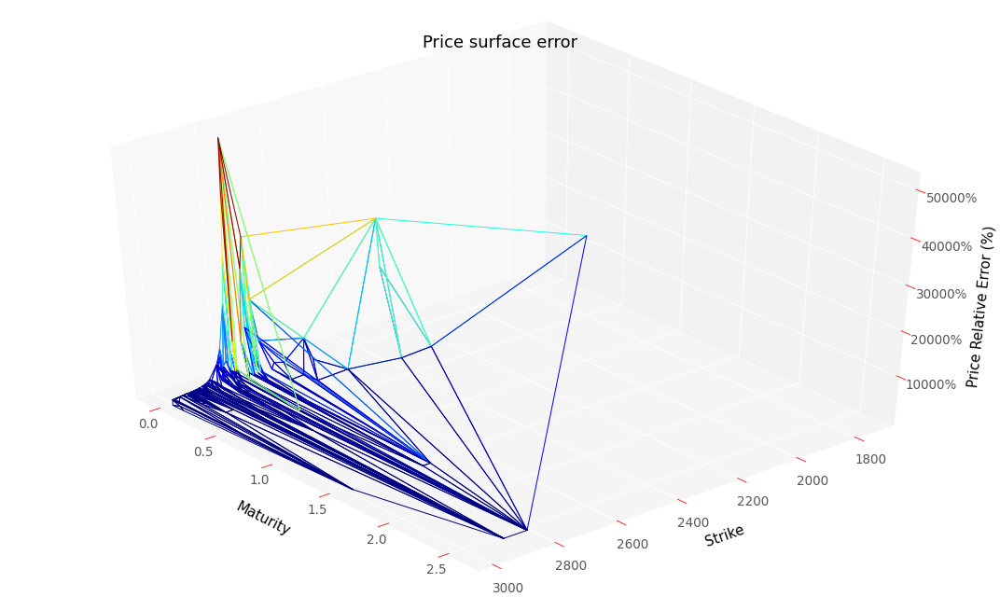

RMSE :  374.2737925365697
RMSE Relative:  81.9163904971431


In [44]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               scaledDataSetTest,
                                               True,
                                               hyperparameters,
                                               scaler,
                                               modelName = "convexSoftGatheralVolModel")
y_pred4TestG, volLocale4TestG, dNN_T4TestG, gNN_K4TestG, lossSerie4TestG = res

plotTools.modelSummaryGatheral(y_pred4TestG, 
                               volLocale4TestG, 
                               dNN_T4TestG, 
                               gNN_K4TestG, 
                               dataSetTest,
                               yMin = KMin,
                               yMax = KMax,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               savePath = "NeuralImpliedVolTest")

In [58]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


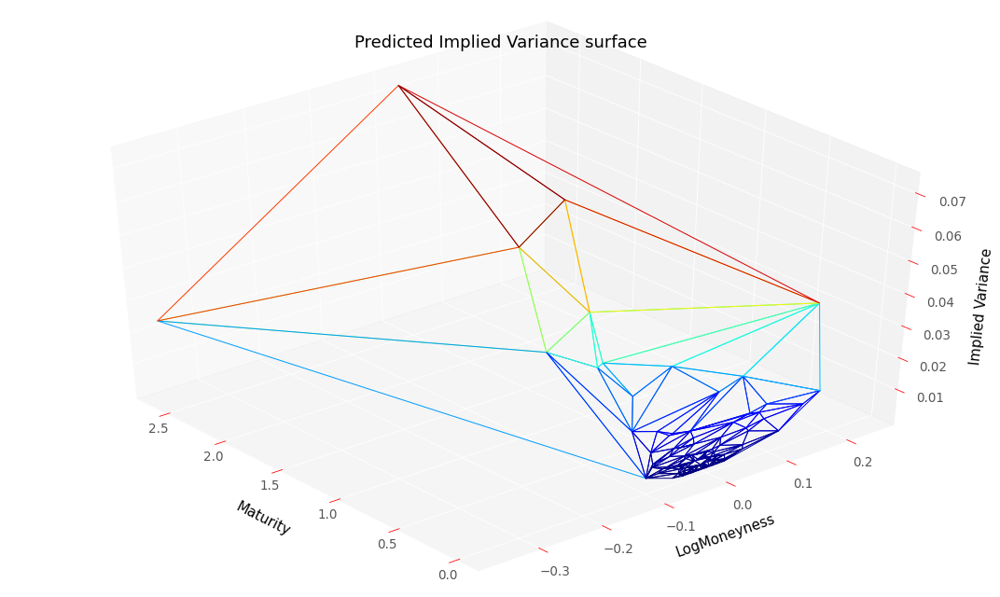

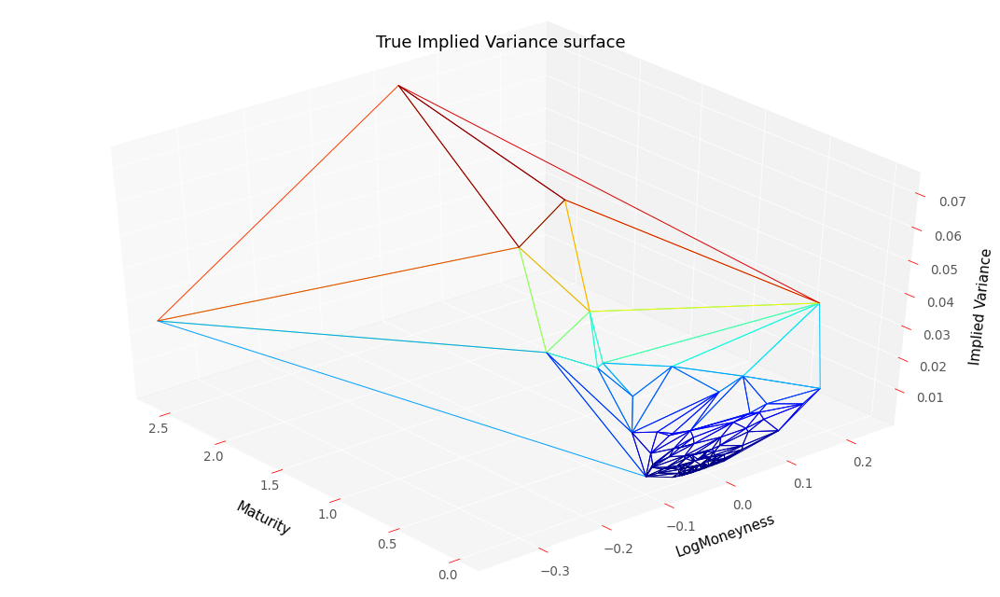

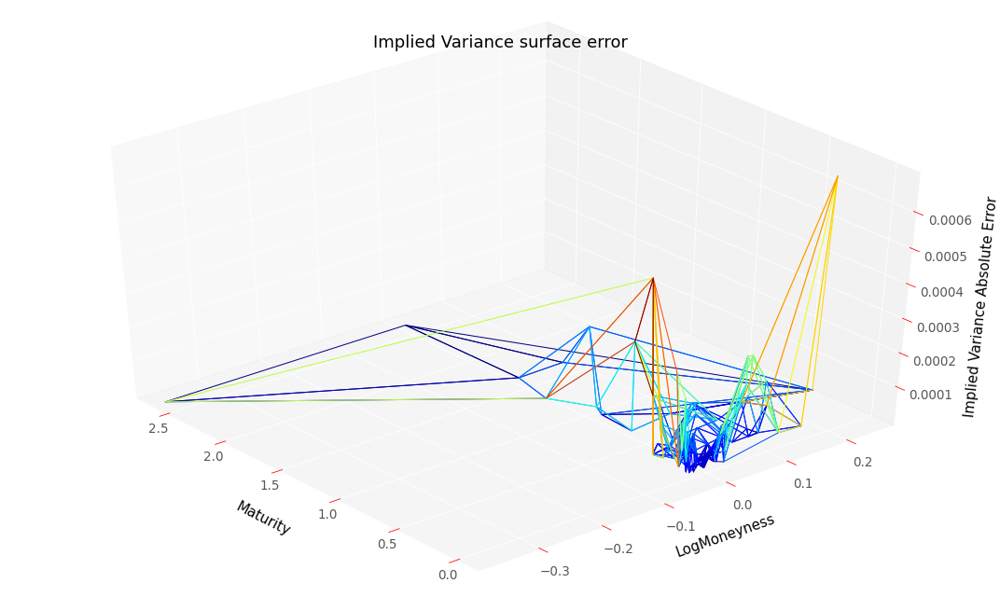

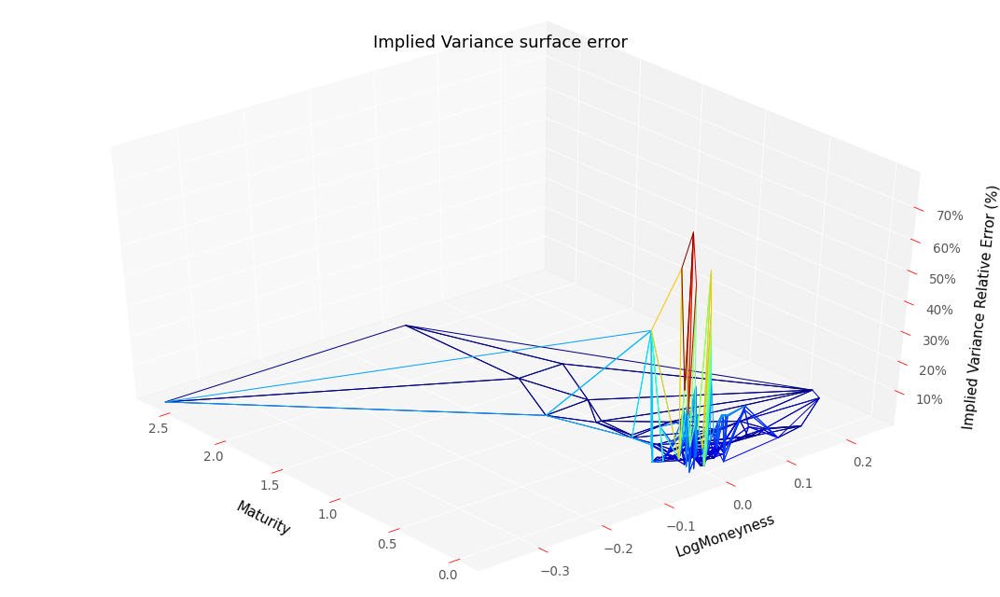

RMSE :  0.00011737072502775169
RMSE Relative:  0.17366689367316374


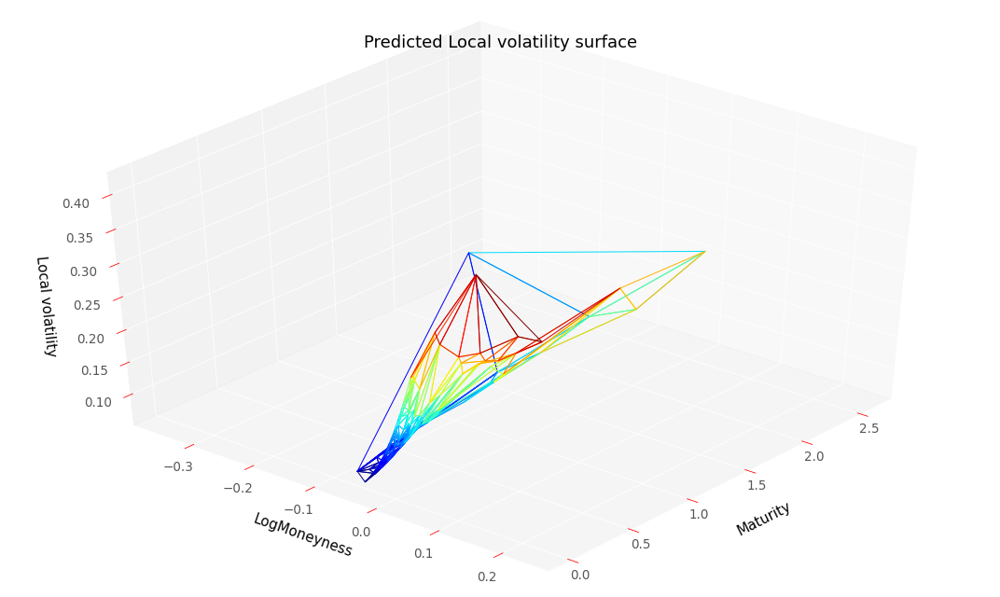

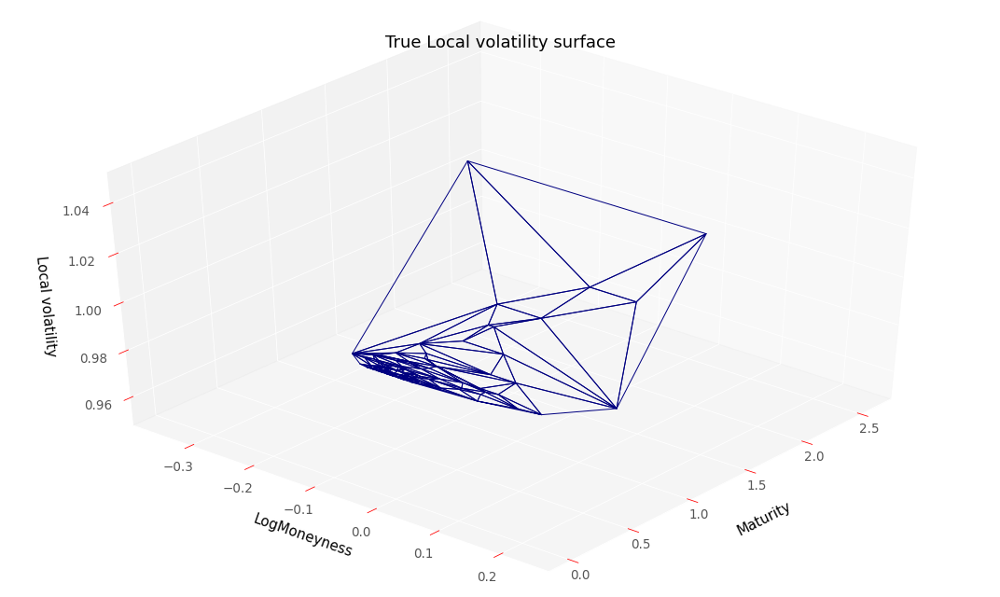

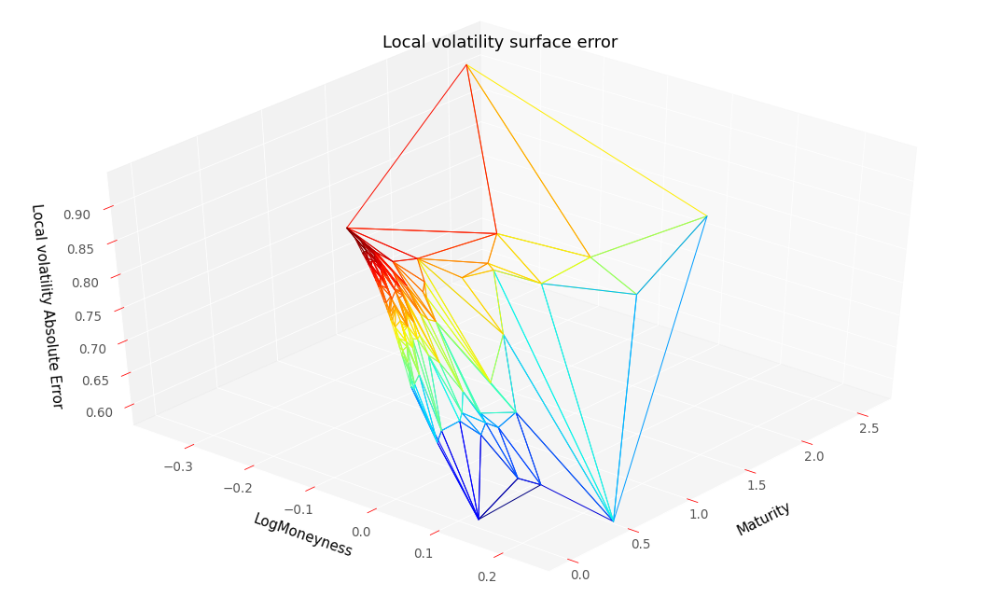

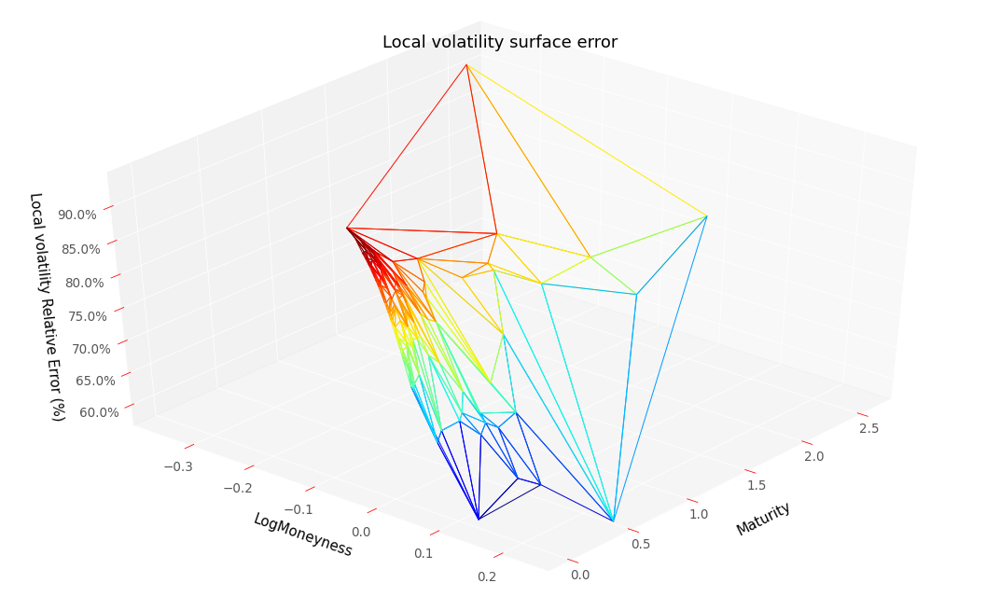

RMSE :  0.8422661937673223
RMSE Relative:  0.8422661937673223


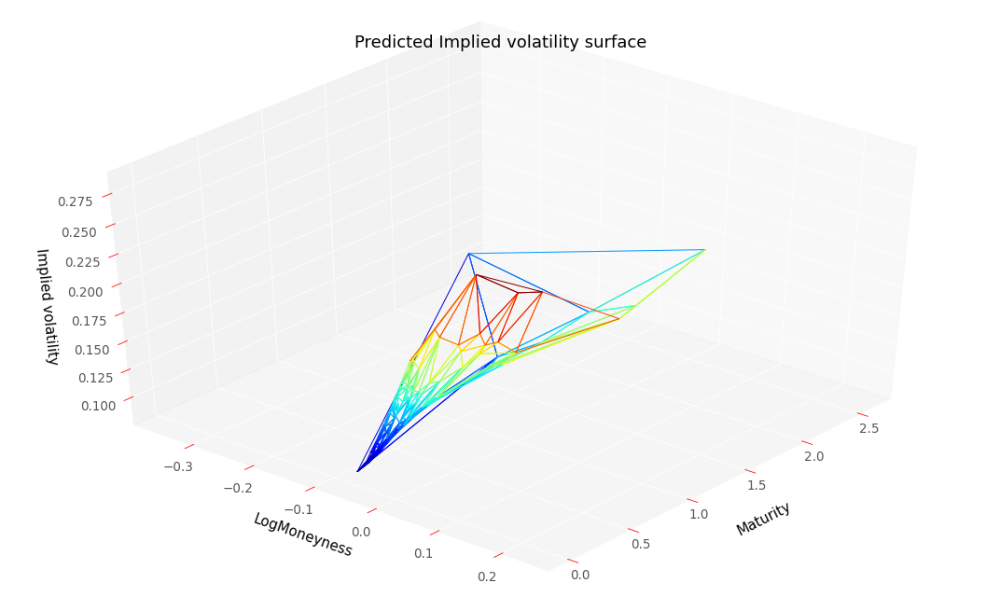

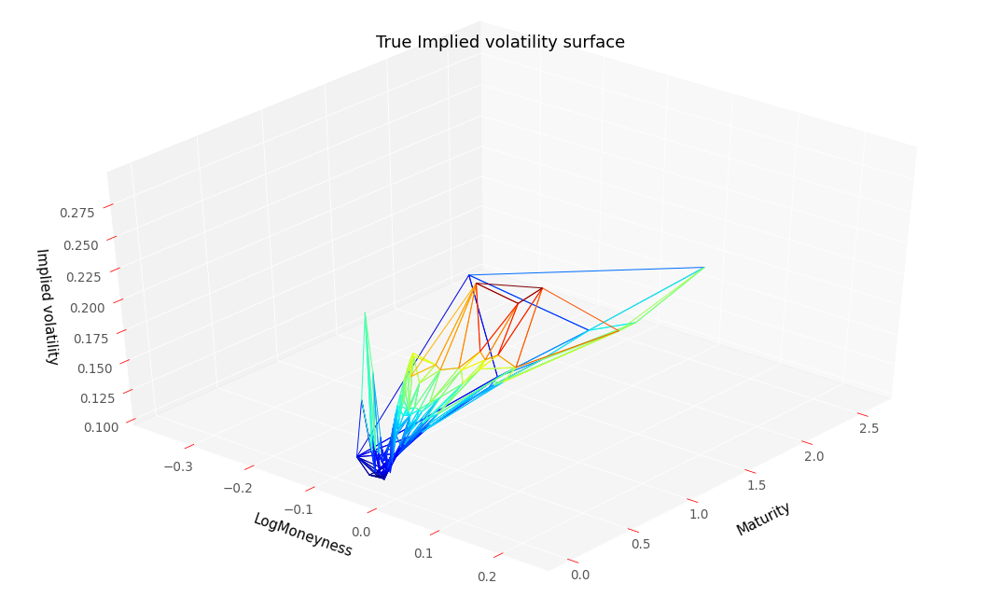

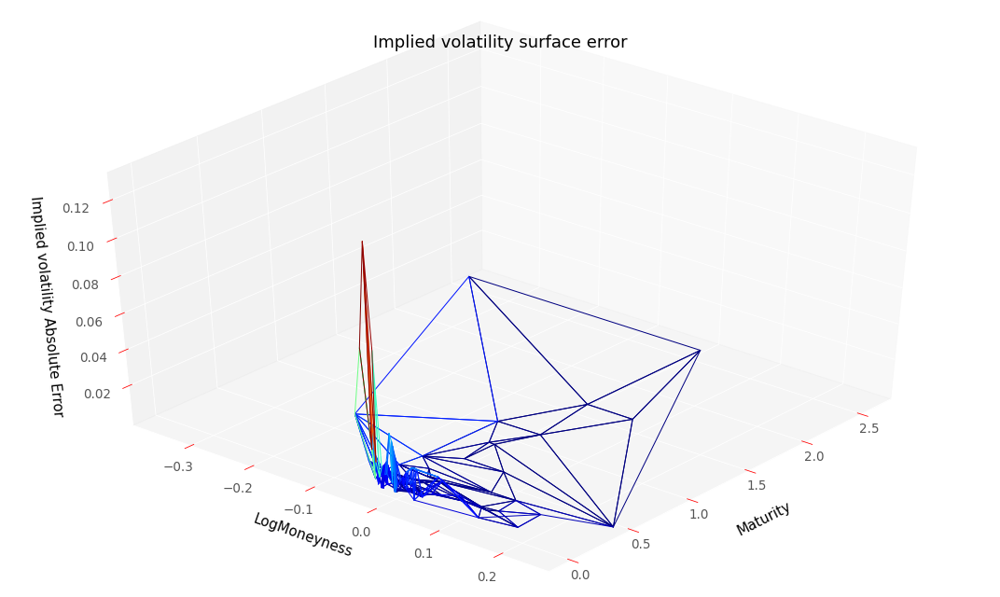

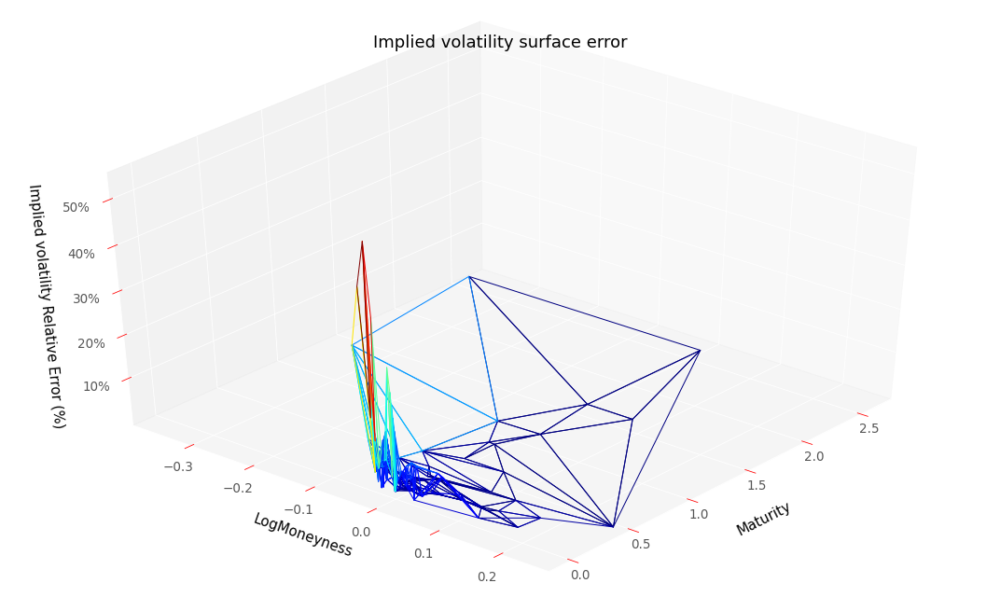

RMSE :  0.01729487649982604
RMSE Relative:  0.09700772649388352


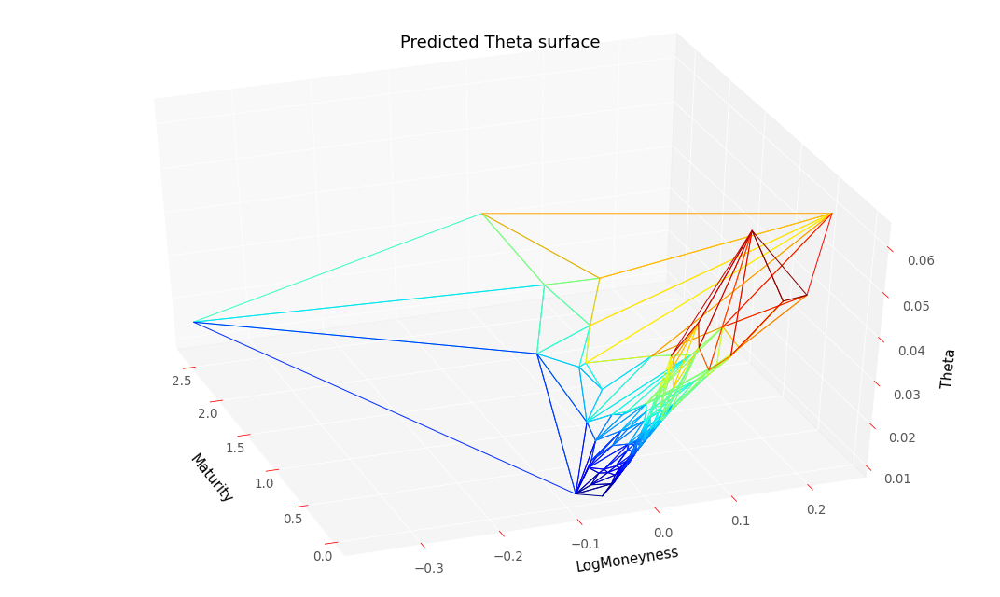

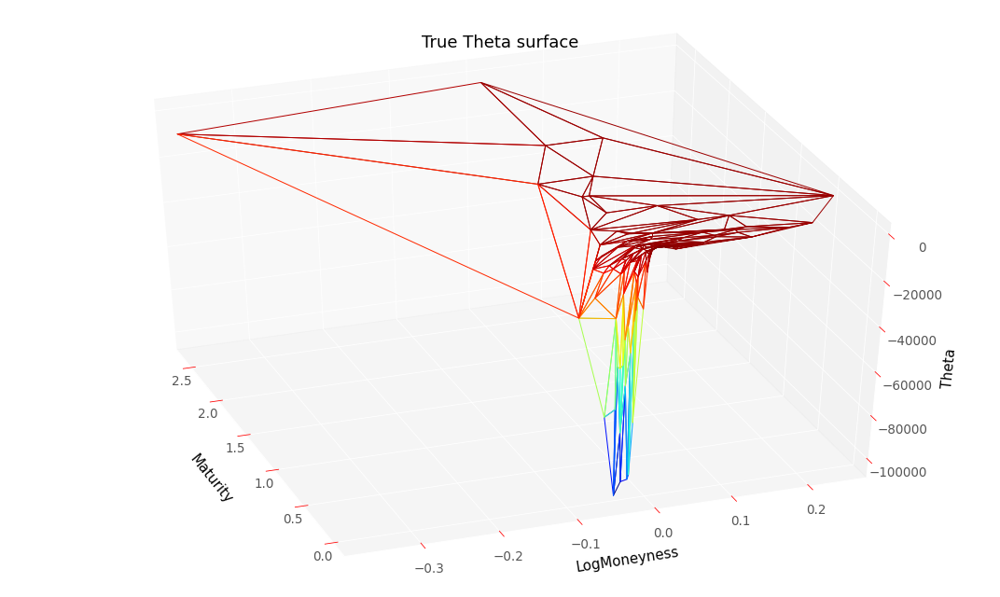

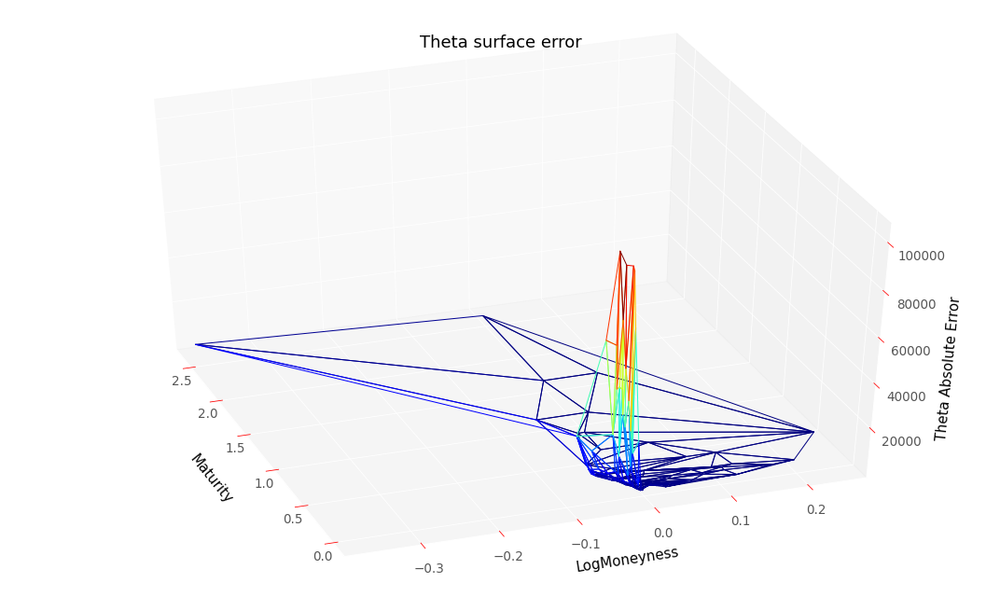

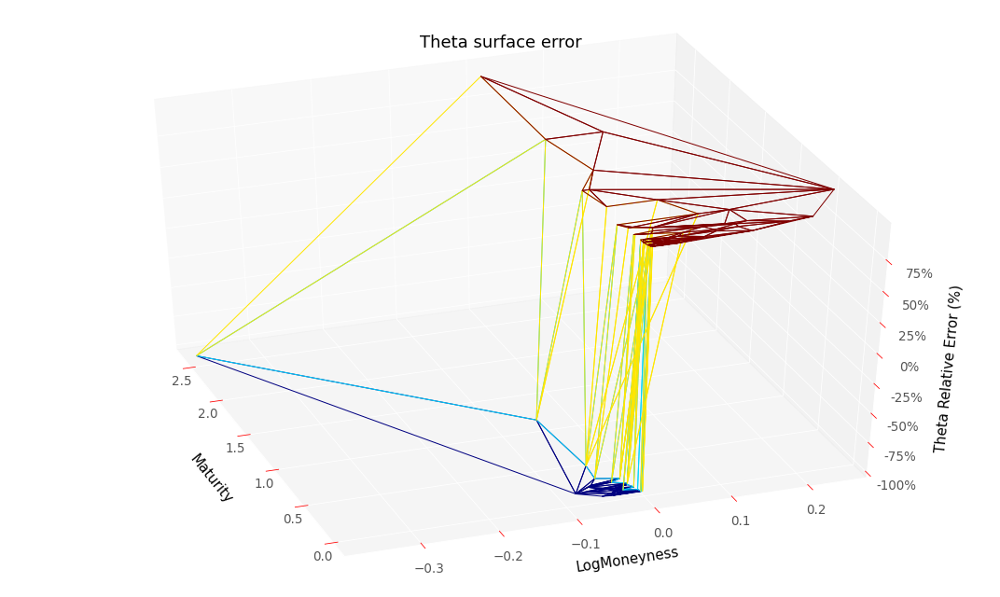

RMSE :  24400.9320965185
RMSE Relative:  0.9999502509702101


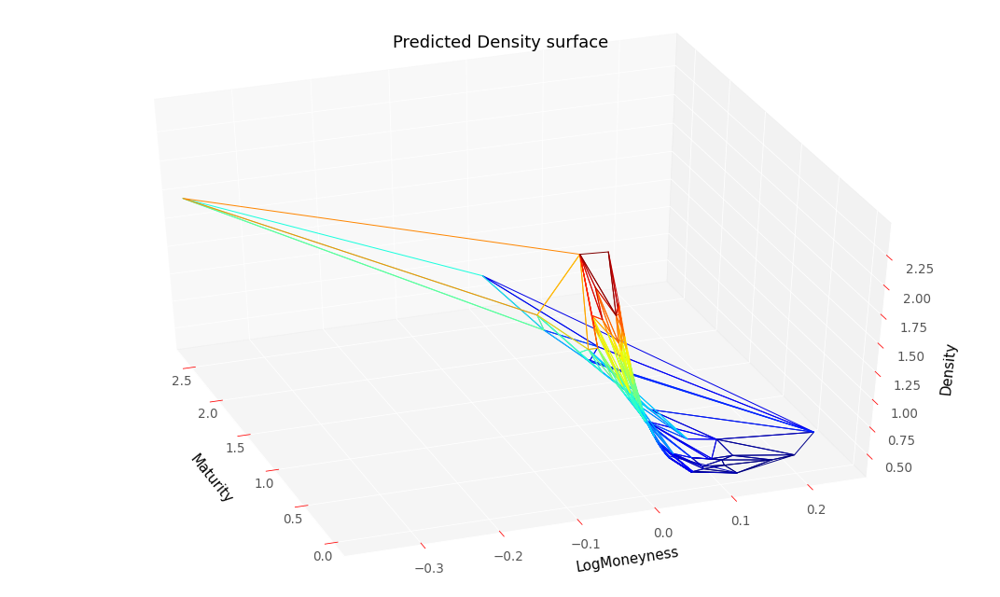

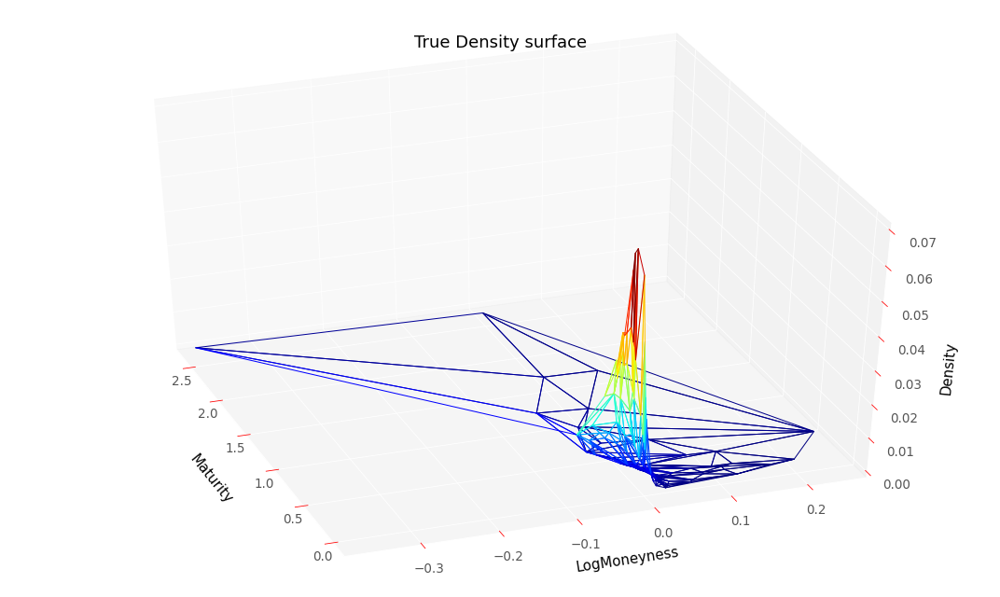

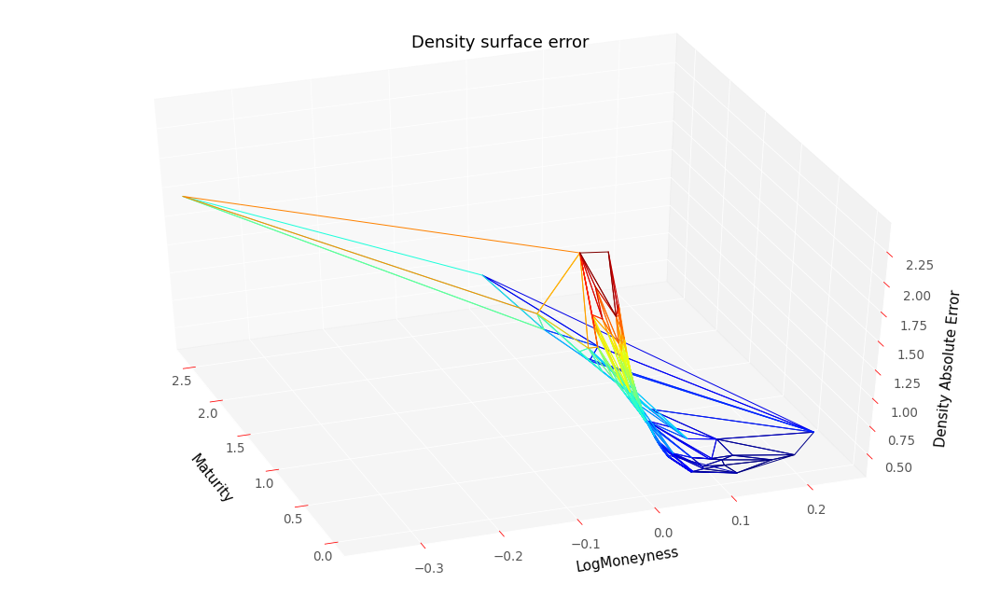

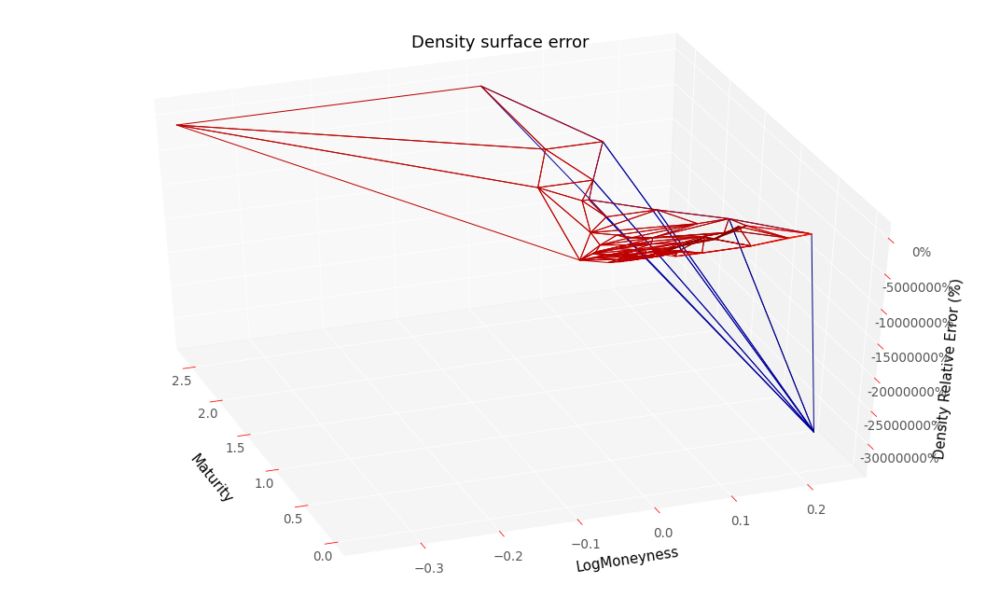

RMSE :  1.174163600695211
RMSE Relative:  29520.87755444783


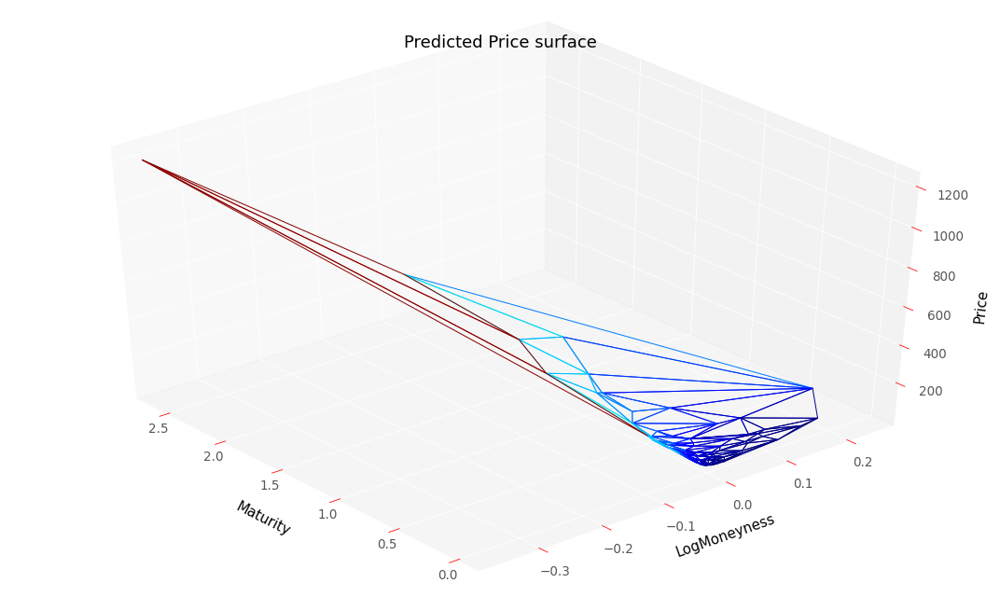

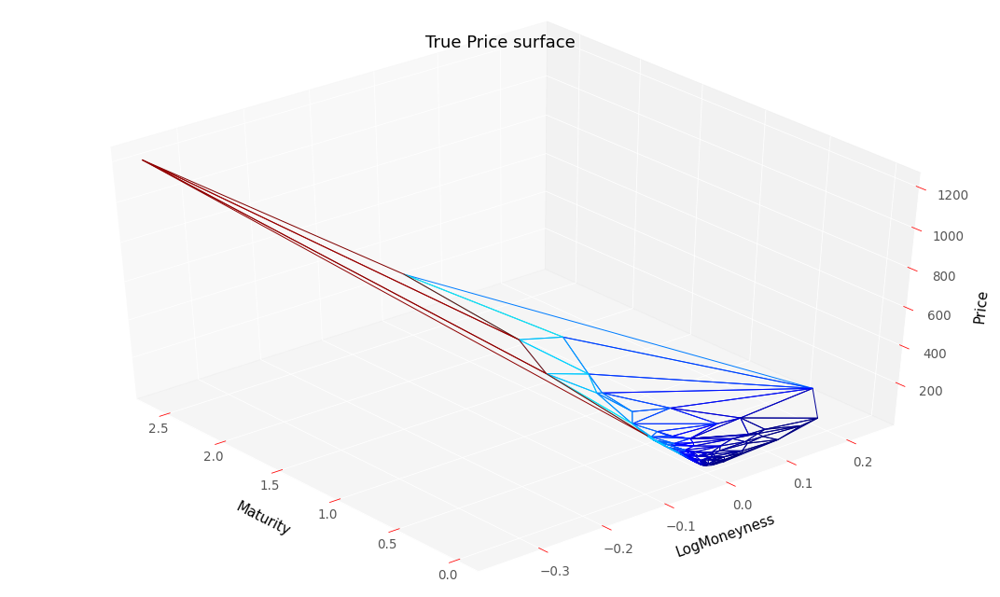

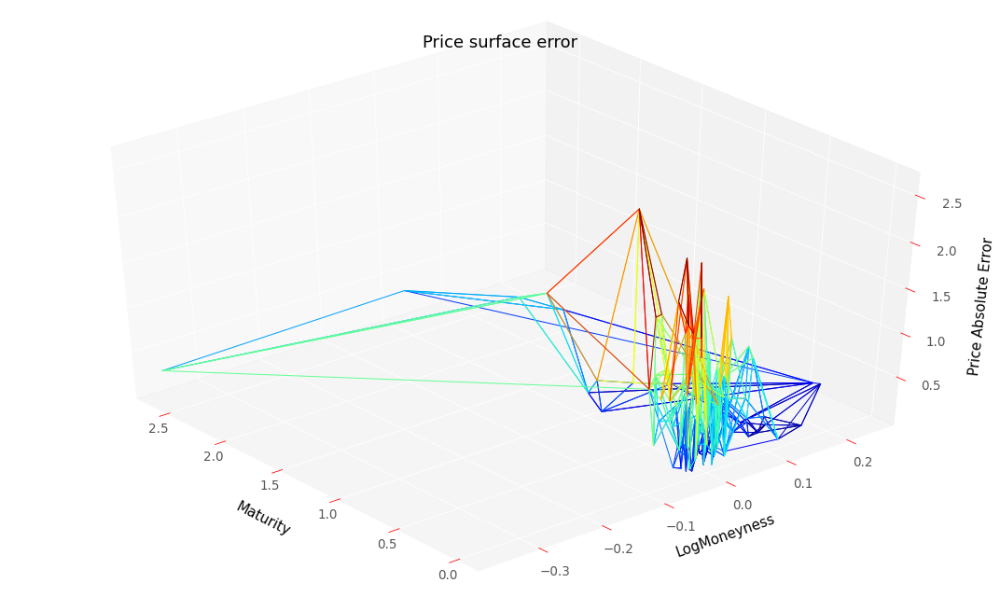

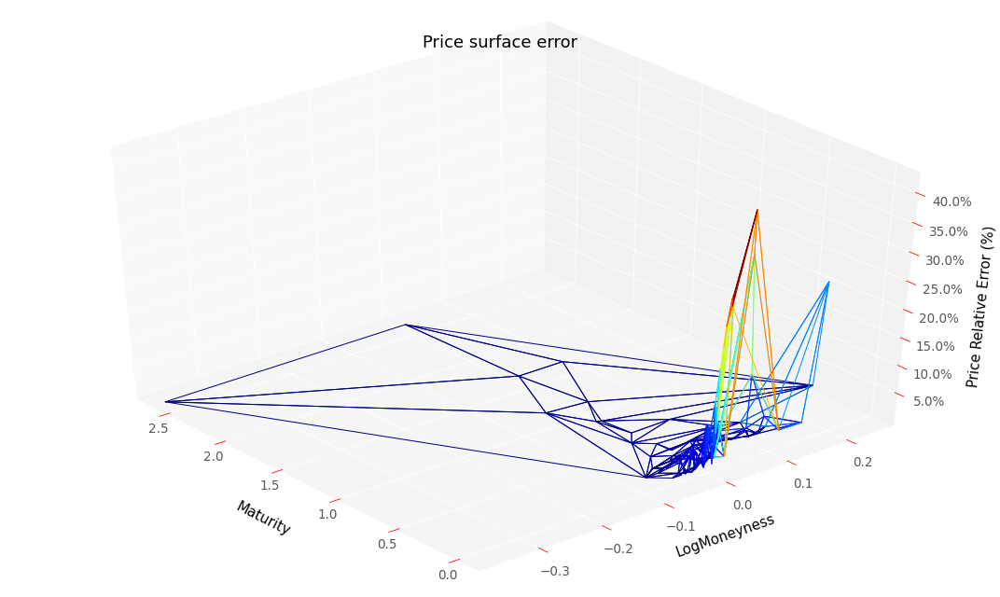

RMSE :  0.9073733582329564
RMSE Relative:  0.08660347543783938


In [59]:
#Diagnosis for training results
plotTools.modelSummaryGatheral(y_pred4G, 
                               volLocale4G, 
                               dNN_T4G, 
                               gNN_K4G, 
                               dataSet,
                               logMoneynessScale = True,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               yMin = KMin + 0.0001,
                               yMax = KMax)

/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


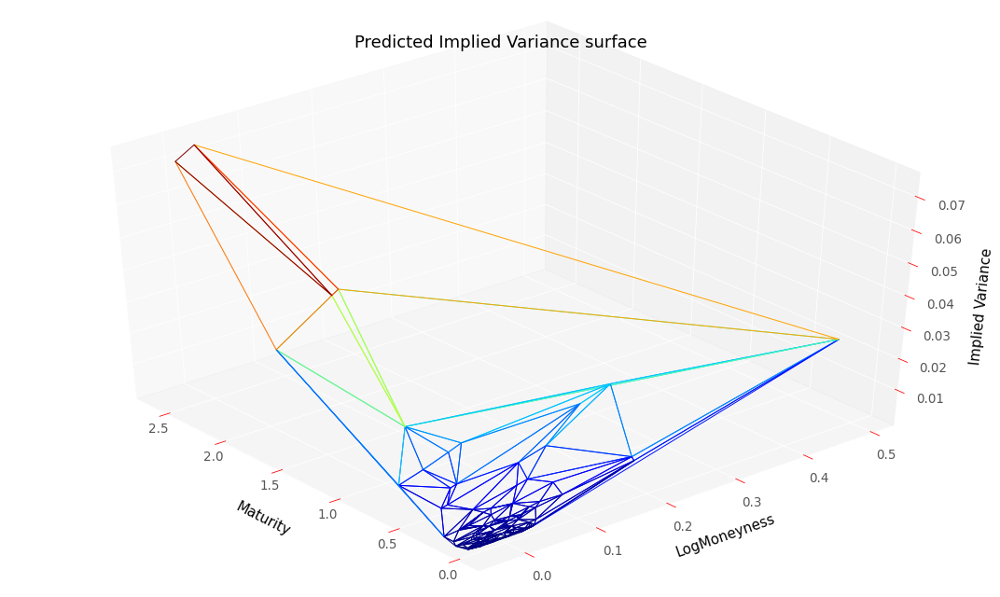

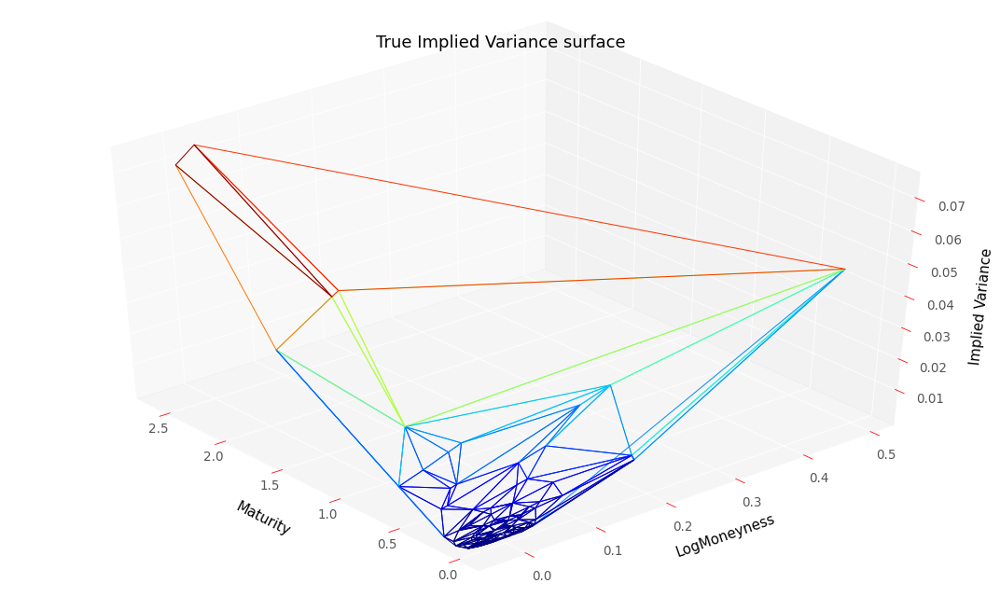

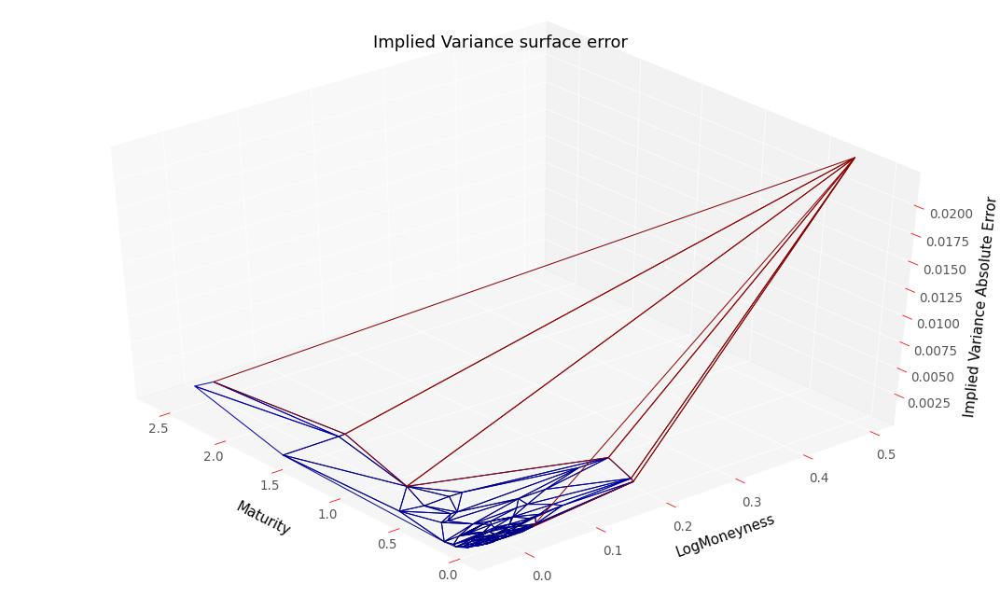

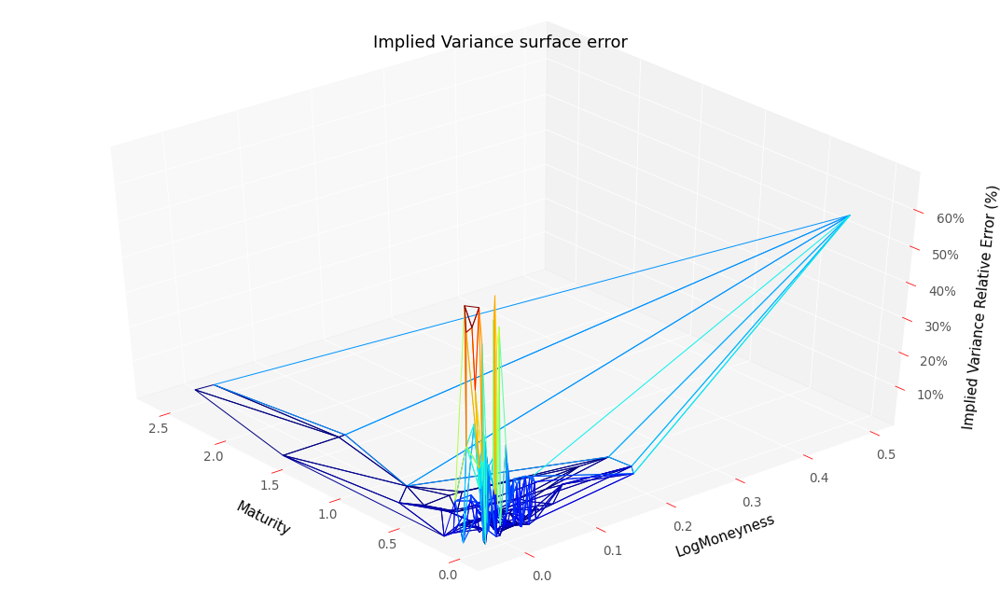

RMSE :  0.0018777898557249166
RMSE Relative:  0.1968551750690315


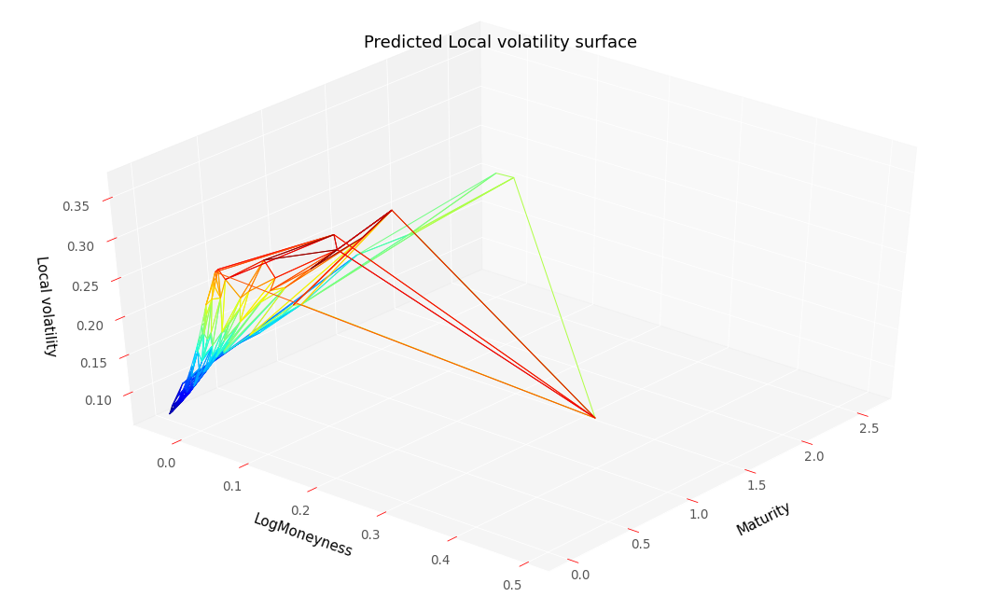

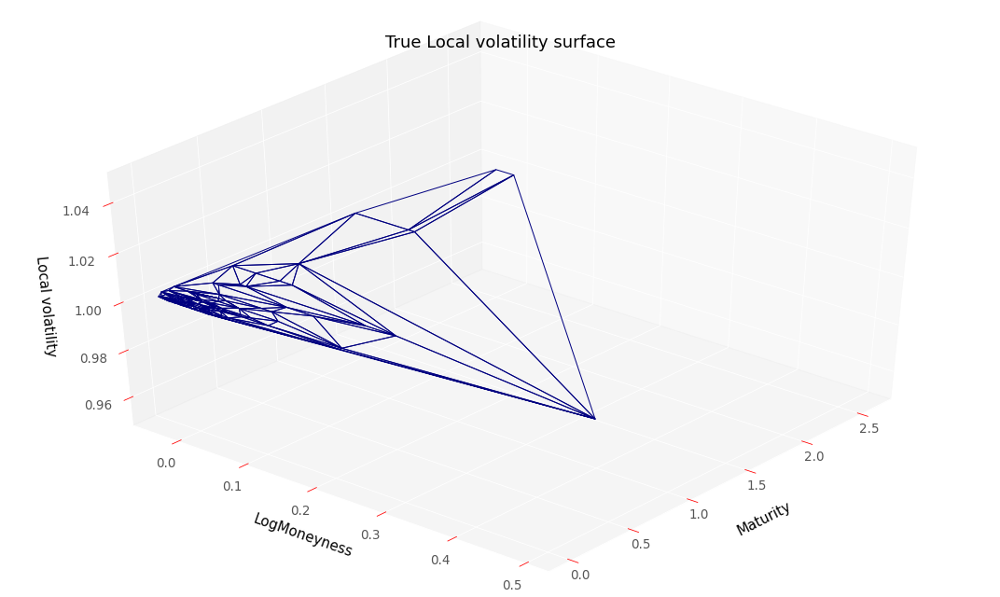

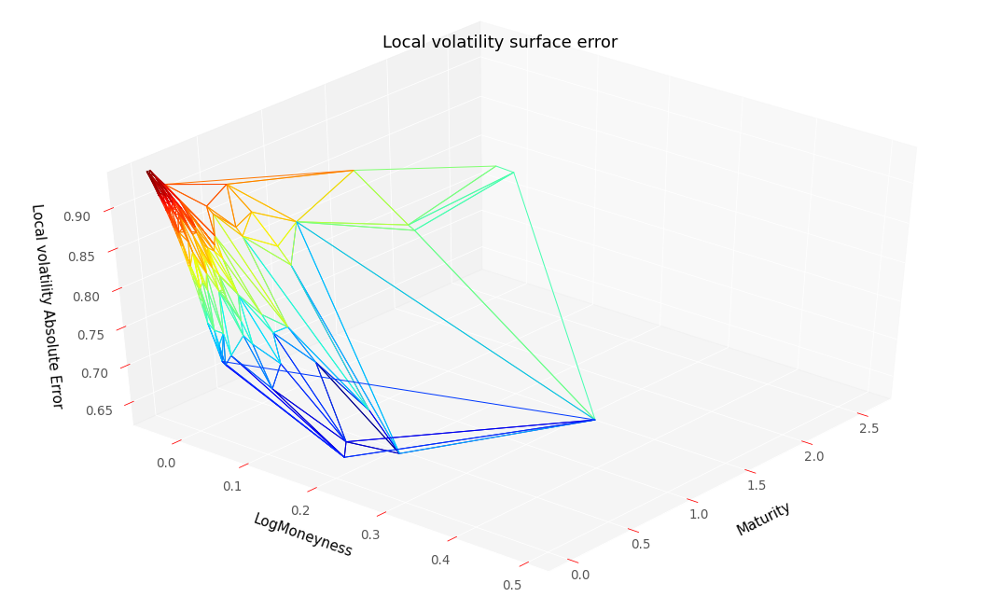

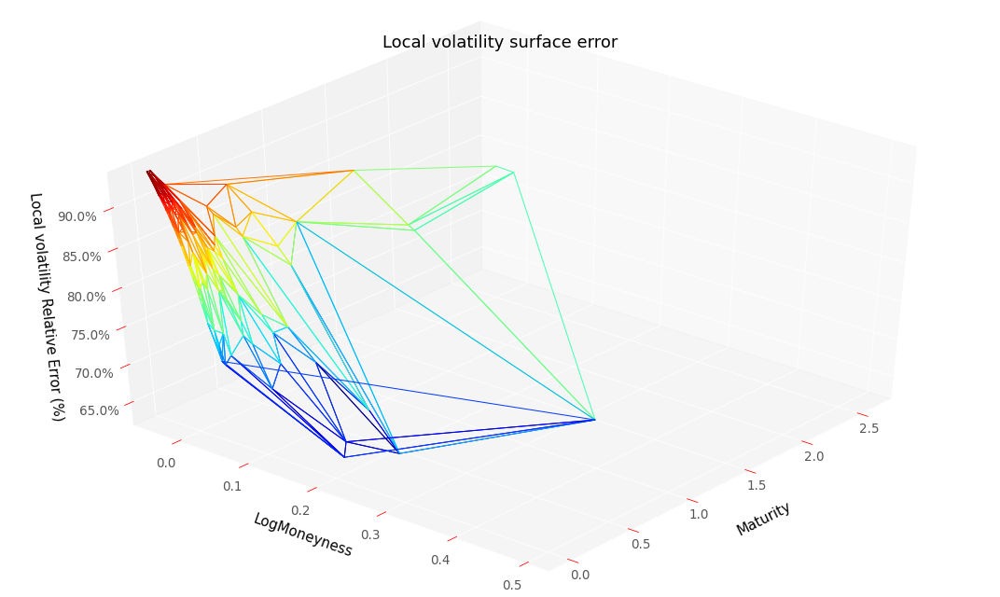

RMSE :  0.8441047102240292
RMSE Relative:  0.8441047102240292


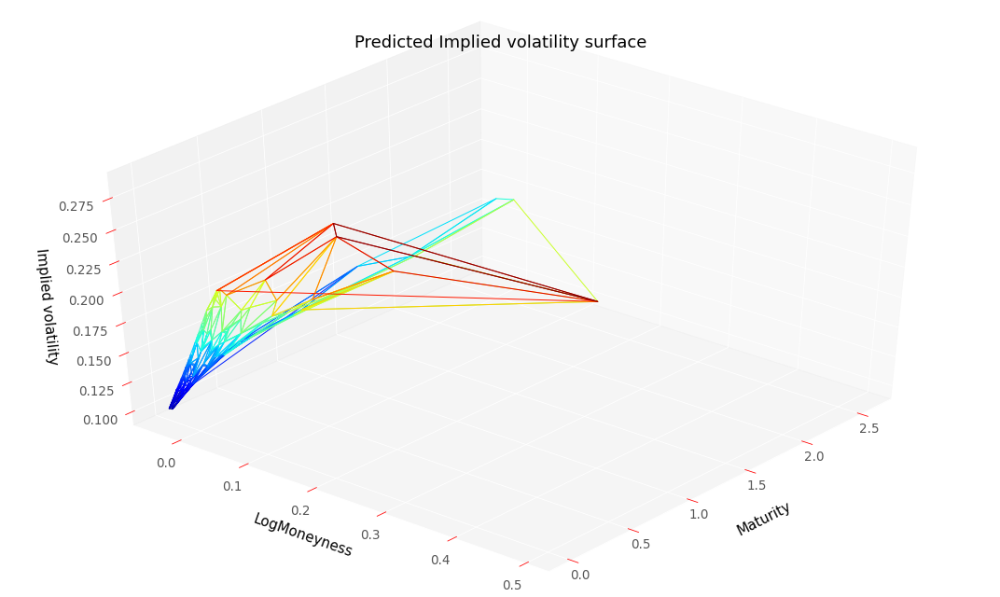

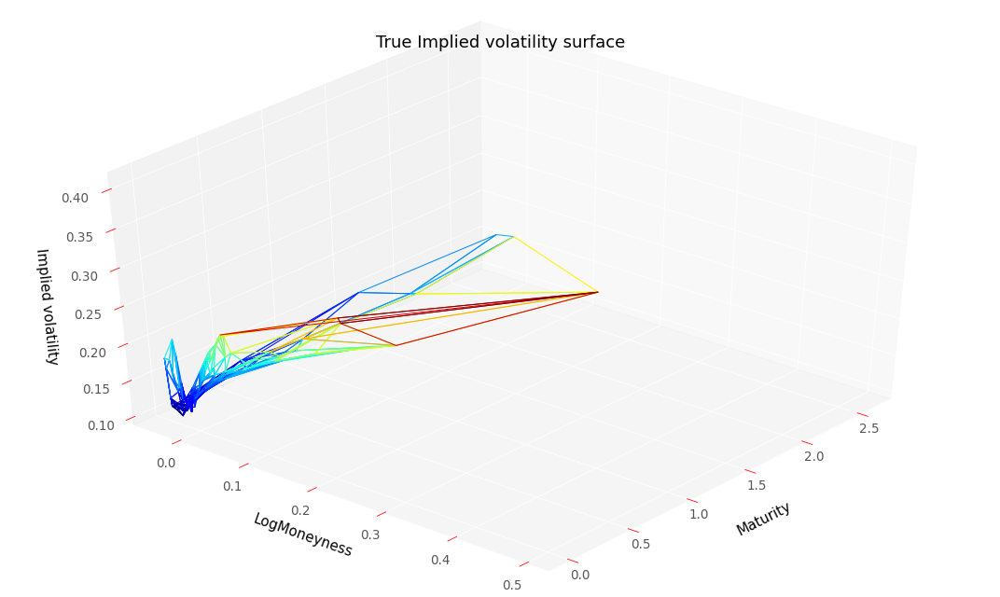

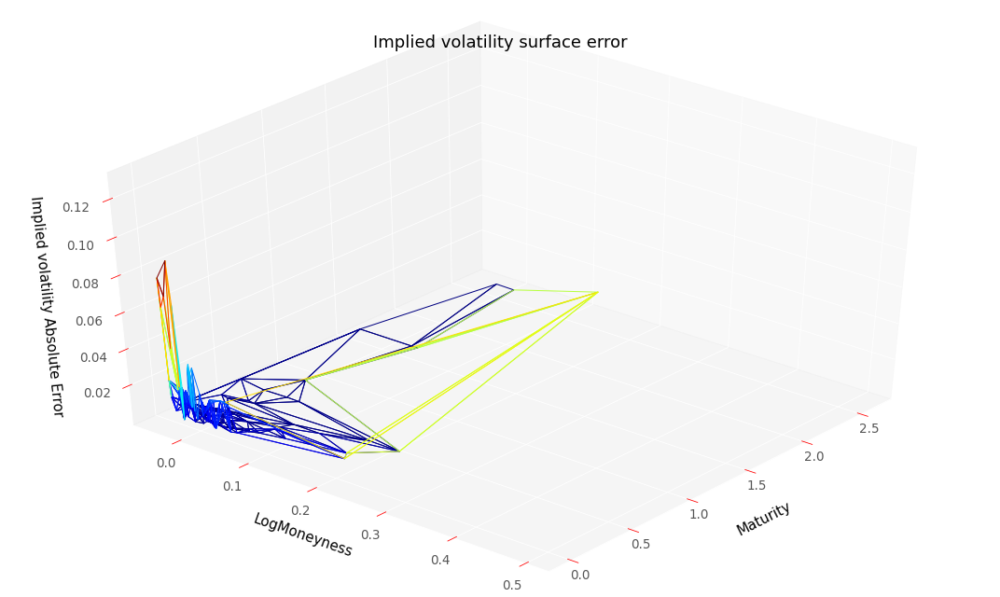

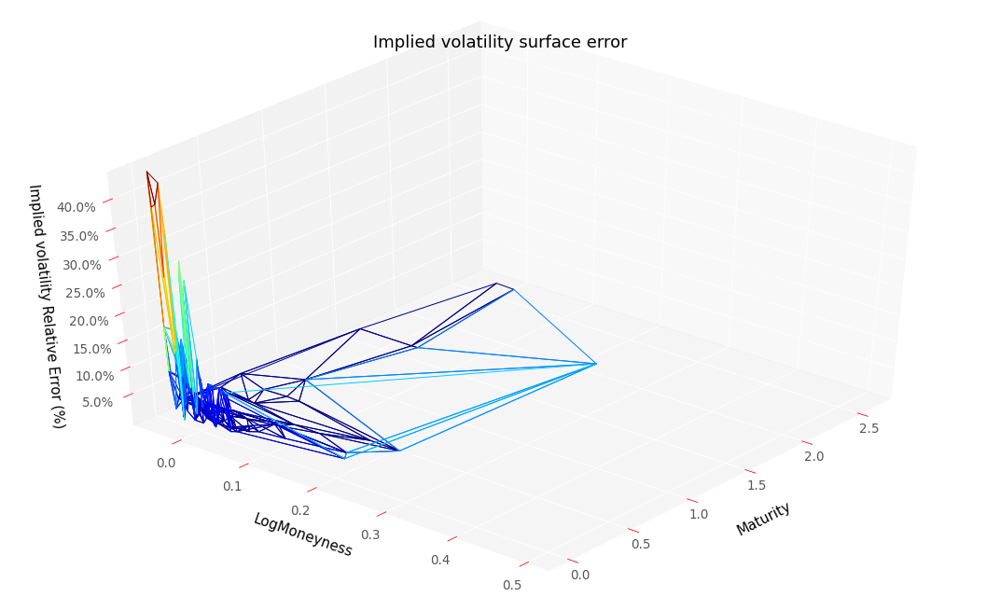

RMSE :  0.019709361398377635
RMSE Relative:  0.10624786459415687


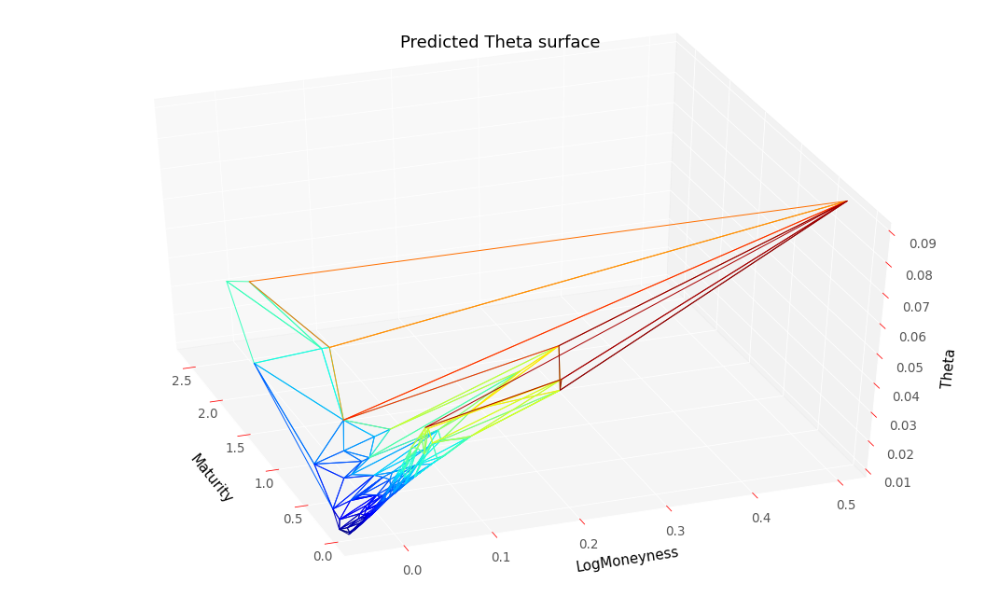

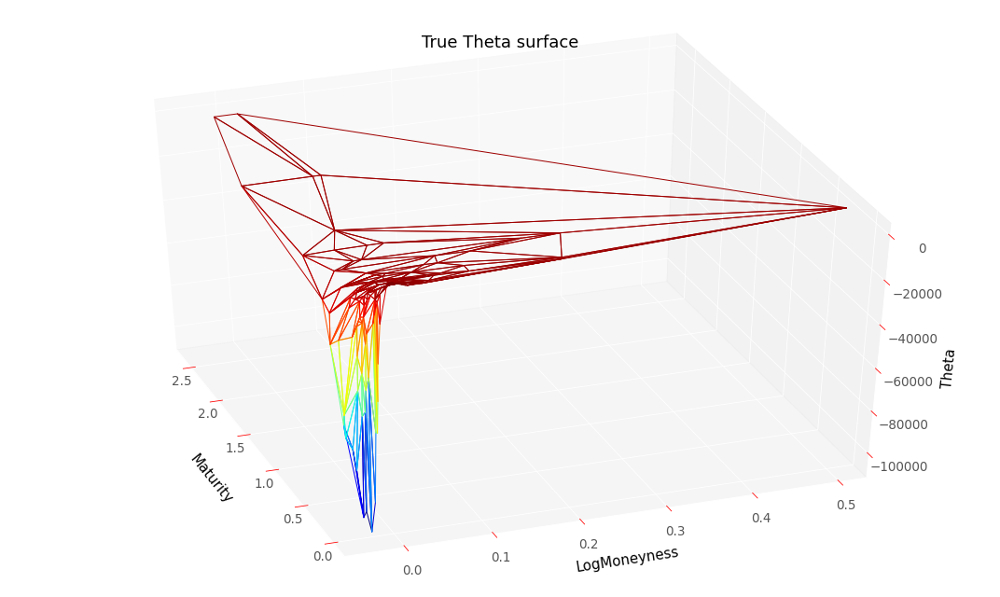

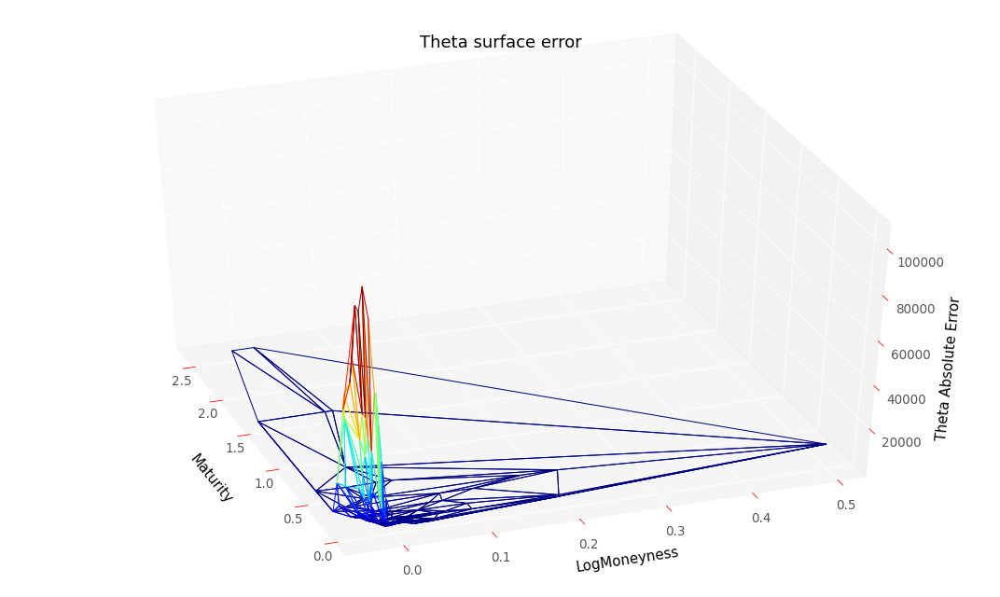

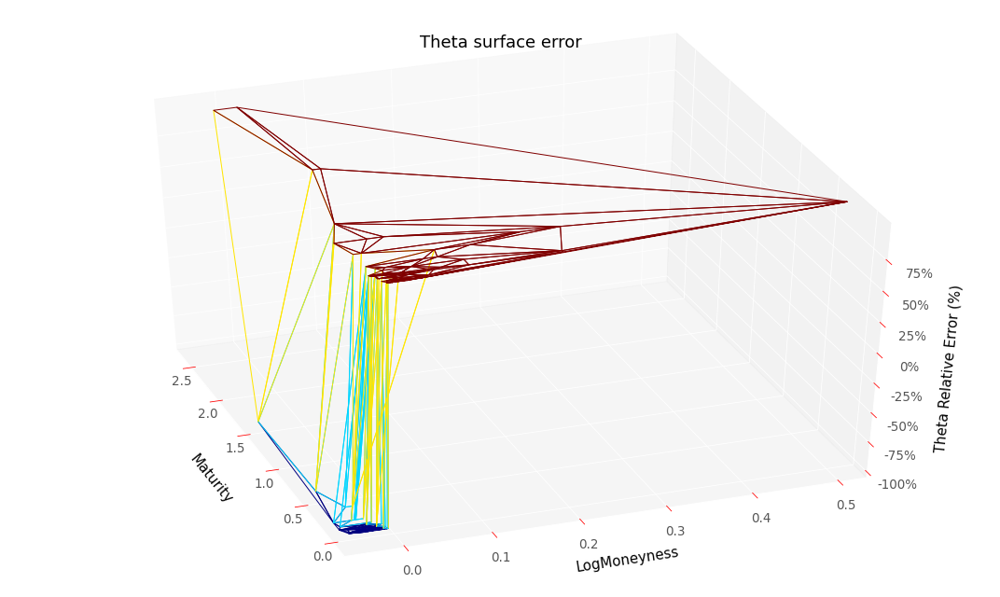

RMSE :  25030.370402205397
RMSE Relative:  0.9999447429278219


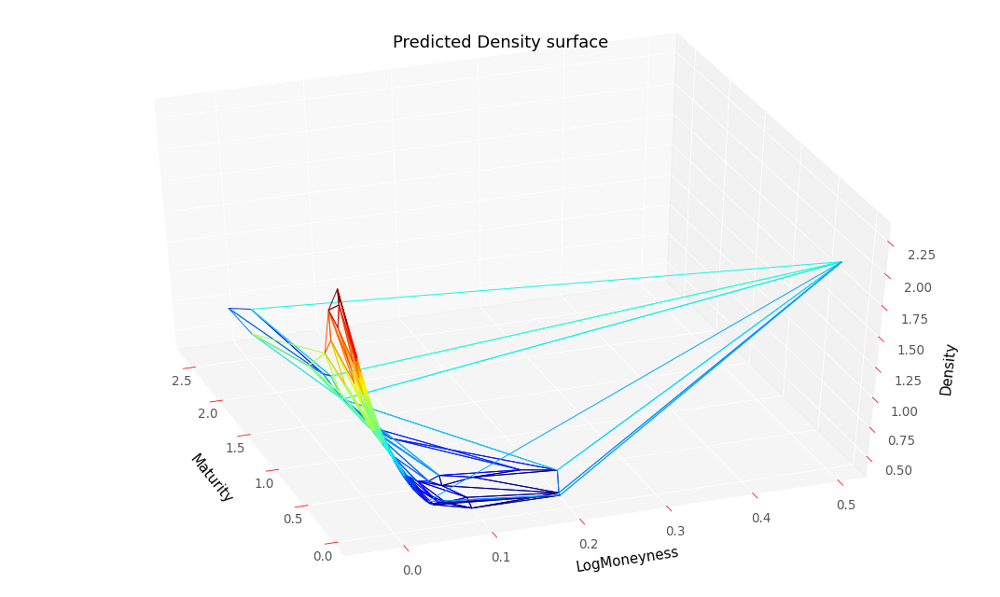

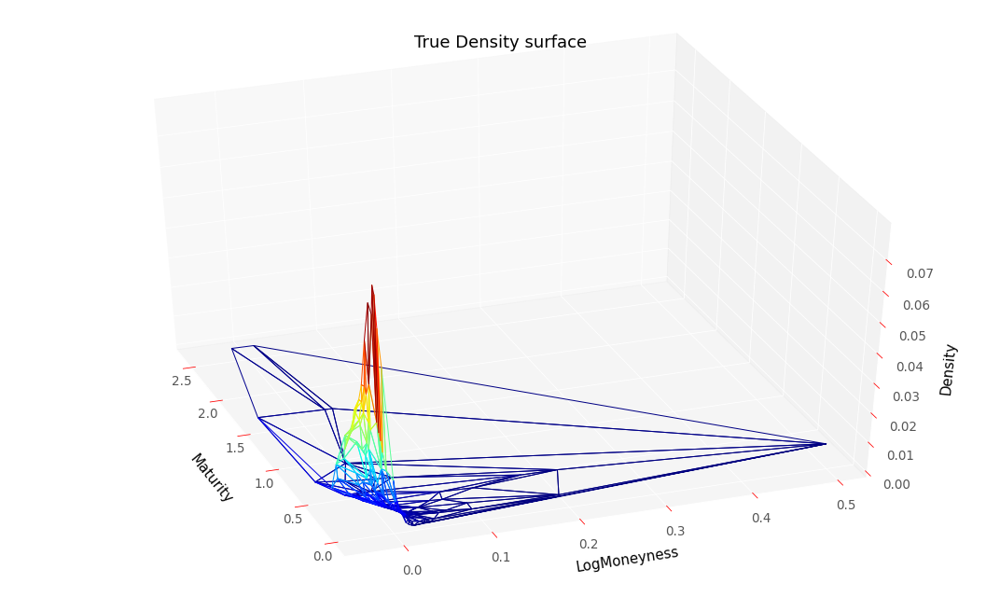

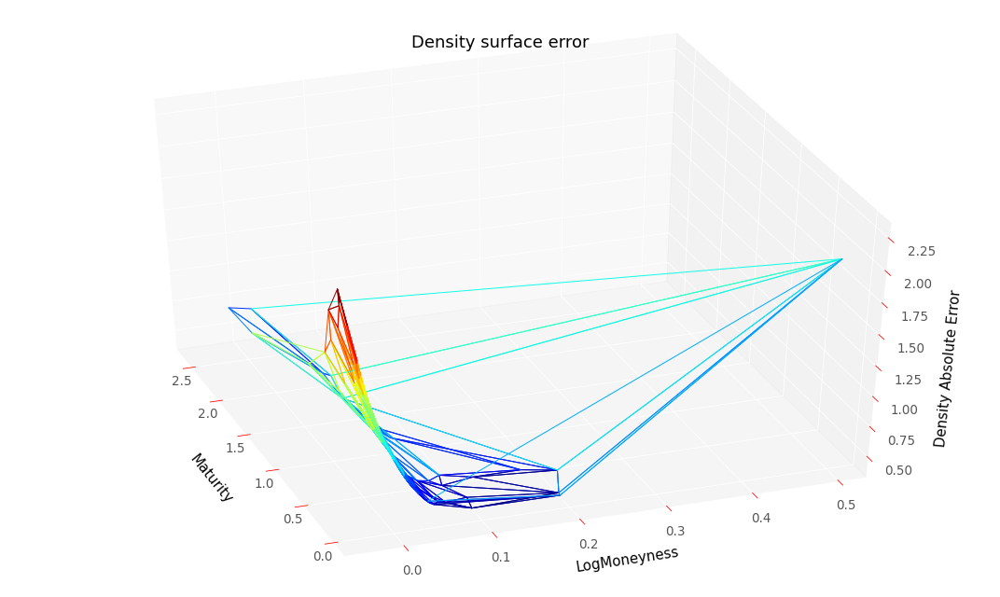

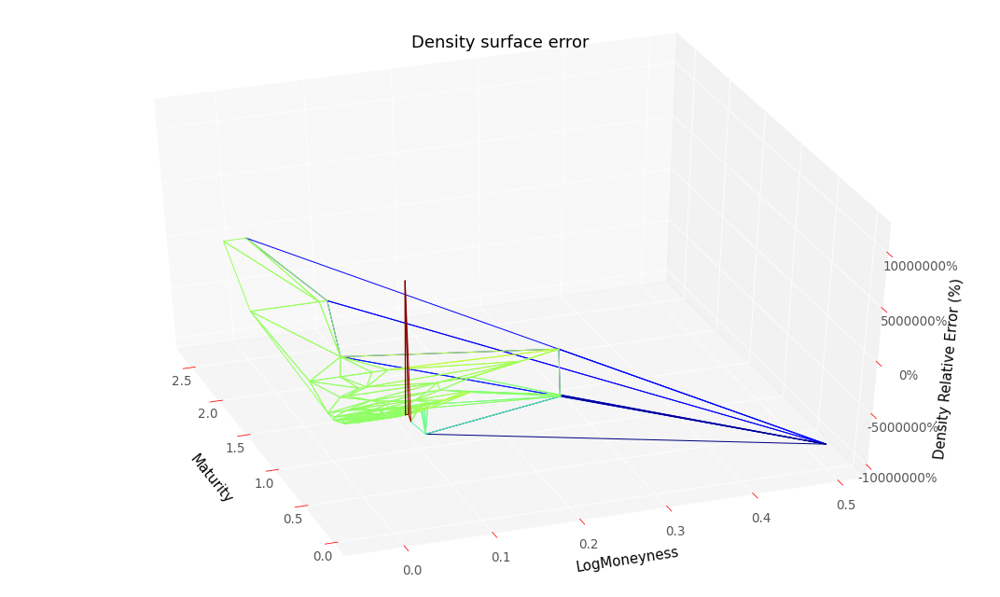

RMSE :  1.1704252110966396
RMSE Relative:  13748.909463740392


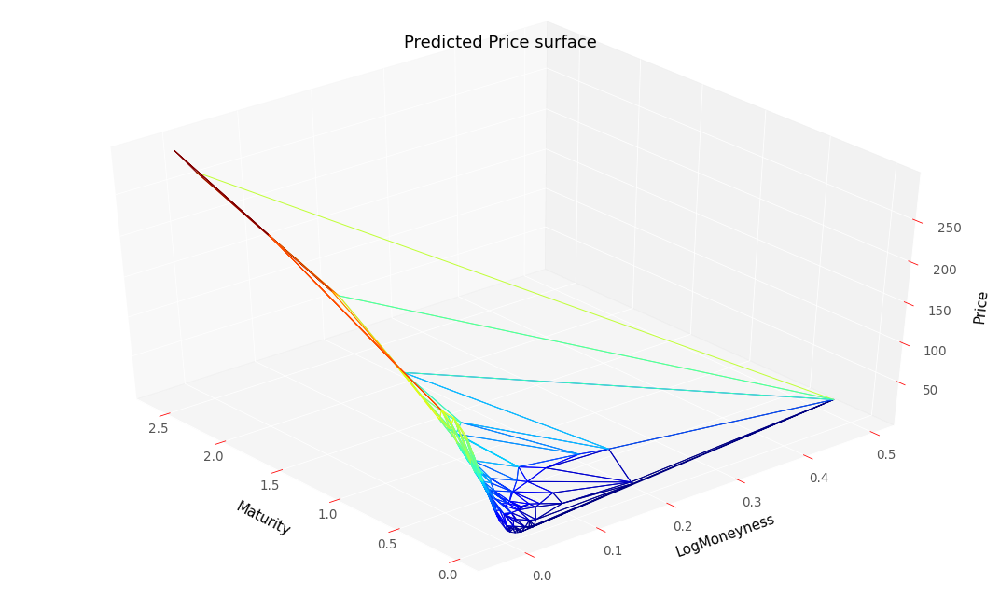

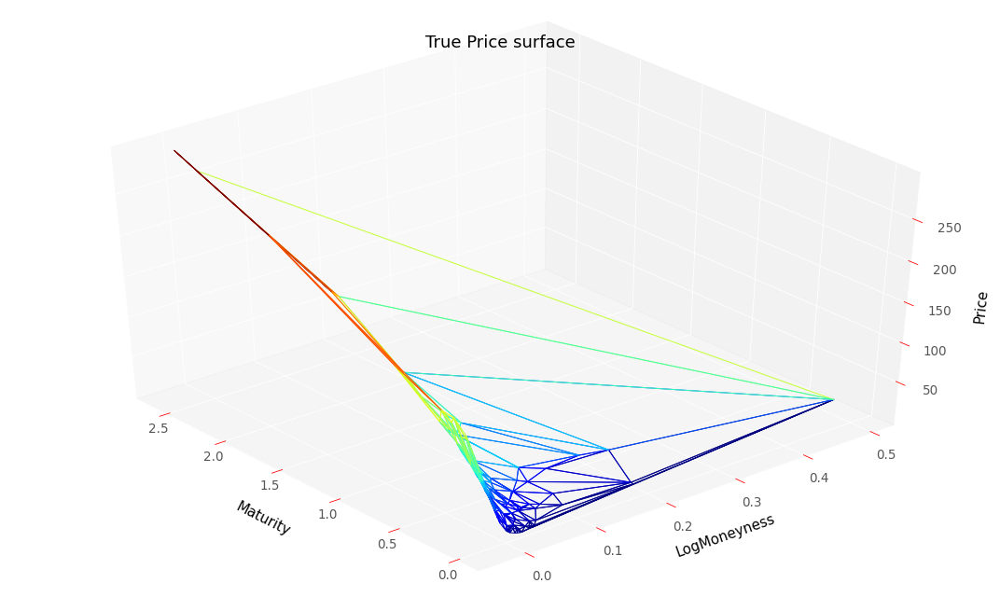

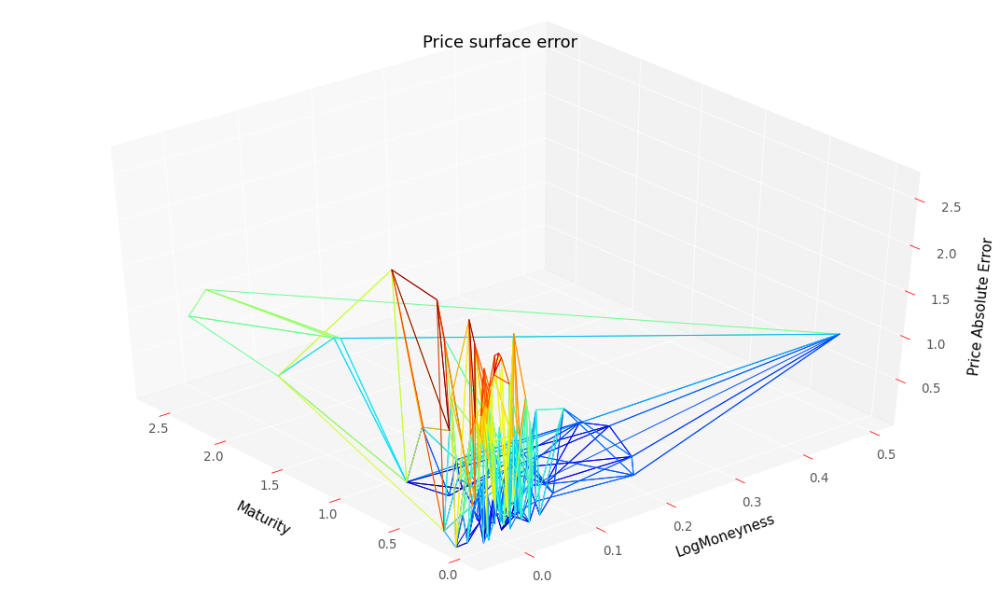

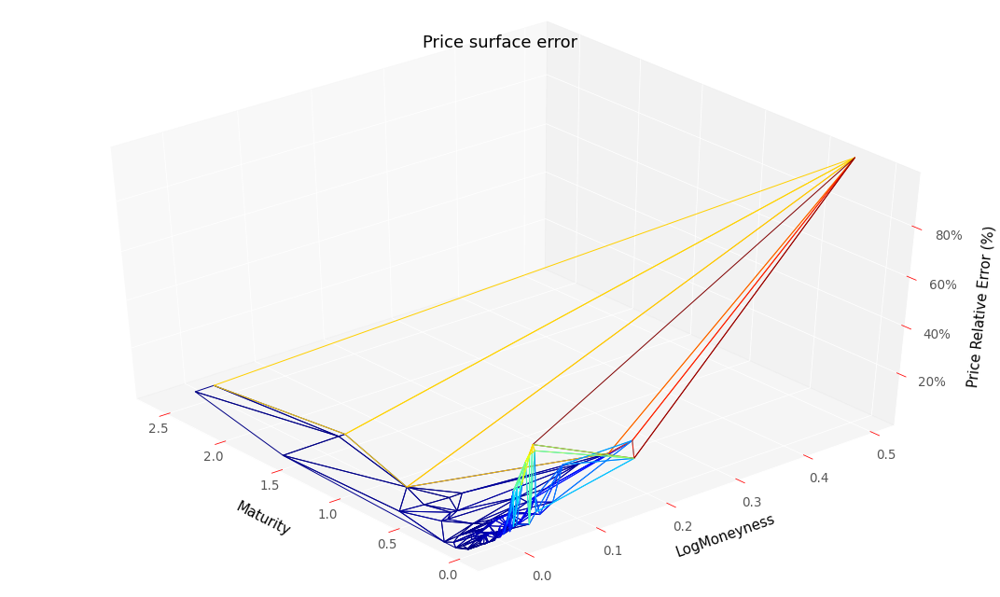

RMSE :  0.9938125604672529
RMSE Relative:  0.11791430294769802


In [60]:
#Diagnosis for testing results
plotTools.modelSummaryGatheral(y_pred4TestG, 
                               volLocale4TestG, 
                               dNN_T4TestG, 
                               gNN_K4TestG, 
                               dataSetTest,
                               logMoneynessScale = True,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               yMin = KMin + 0.0001,
                               yMax = KMax)

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [ ]:
# Function which evaluates neural local volatility when neural network is fitted on implied volatilities
def neuralVolLocaleGatheral(s,t):
    vLoc = neuralNetwork.evalVolLocaleGatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               s, t,
                                               dataSet,
                                               hyperparameters,
                                               scaler,
                                               bootstrap,
                                               S0,
                                               modelName = "convexSoftGatheralVolModel")
    return vLoc.dropna()

In [ ]:
#Artificial grid with 10000 points which aims to limit the impact of linear interpolation
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)

In [ ]:
volLocalInterp7 = neuralVolLocaleGatheral(volLocaleGrid[0].flatten(),
                                          volLocaleGrid[1].flatten())
volLocalInterp7.head()

In [ ]:
volLocalInterp8 = neuralVolLocaleGatheral(dataSetTest.index.get_level_values("Strike").values.flatten(),
                                          dataSetTest.index.get_level_values("Maturity").values.flatten())
volLocalInterp8.head()

In [ ]:
#Local volatility function for backtests
nnVolLocale7 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp7, x, y)

In [ ]:
#Local volatility function for backtests
nnVolLocale8 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp8, x, y)

In [ ]:
importlib.reload(plotTools)

In [ ]:
plotTools.plotSerie(volLocalInterp7,
                    Title = 'Local Volatility',
                    az=105,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=False)

In [ ]:
plotTools.plotSerie(volLocalInterp8,
                    Title = 'Local Volatility',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the 10000 points grid.
mcResVolLocale7 = backtest.MonteCarloPricerVectorized(S0,
                                                      dataSetTest,
                                                      bootstrap,
                                                      nbPaths,
                                                      nbTimeStep,
                                                      nnVolLocale7)
mcResVolLocale7.head()

In [ ]:
#Diagnose backtest results
plotTools.predictionDiagnosis(mcResVolLocale7["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocale7.to_csv("mcResVolLocale7.csv")

In [ ]:
importlib.reload(backtest)

In [ ]:
#PDE backtest with a cranck nicholson scheme
pdeResVolLocale7 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale7, bootstrap)
pdeResVolLocale7.head()

In [ ]:
#Backtest diagnosis
plotTools.predictionDiagnosis(pdeResVolLocale7, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale7.to_csv(workingFolder + "pdeResVolLocale7.csv")

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the testing grid.
mcResVolLocale8 = backtest.MonteCarloPricerVectorized(S0,
                                                      dataSetTest,
                                                      bootstrap,
                                                      nbPaths,
                                                      nbTimeStep,
                                                      nnVolLocale8)
mcResVolLocale8.head()

In [ ]:
plotTools.predictionDiagnosis(mcResVolLocale8["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocale8.to_csv("mcResVolLocale8.csv")

In [ ]:
pdeResVolLocale8 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale8, bootstrap)
pdeResVolLocale8.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResVolLocale8, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale8.to_csv(workingFolder + "pdeResVolLocale8.csv")

#### NN: Learning Price
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [61]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 10#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1000#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 10000000#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.01
hyperparameters["lowerBoundGamma"] = 0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.1
hyperparameters["Patience"] = 100
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

In [ ]:
importlib.reload(plotTools)

In [ ]:
#Execute this cell if you want to fit neural network with prices
res = neuralNetwork.create_train_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       scaledDataSet,
                                       True,
                                       hyperparameters,
                                       scaler,
                                       modelName = "convexSoftVolModel")
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

In [ ]:
plotTools.plotEpochLoss(lossSerie4)
lossSerie4.iloc[-1]

In [ ]:
importlib.reload(plotTools)

Best loss (hidden nodes: 100, iterations: 0): 0.15
Best Penalization :  [1.0873228, [0.0, 0.0, 0.079682626]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0150096845]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


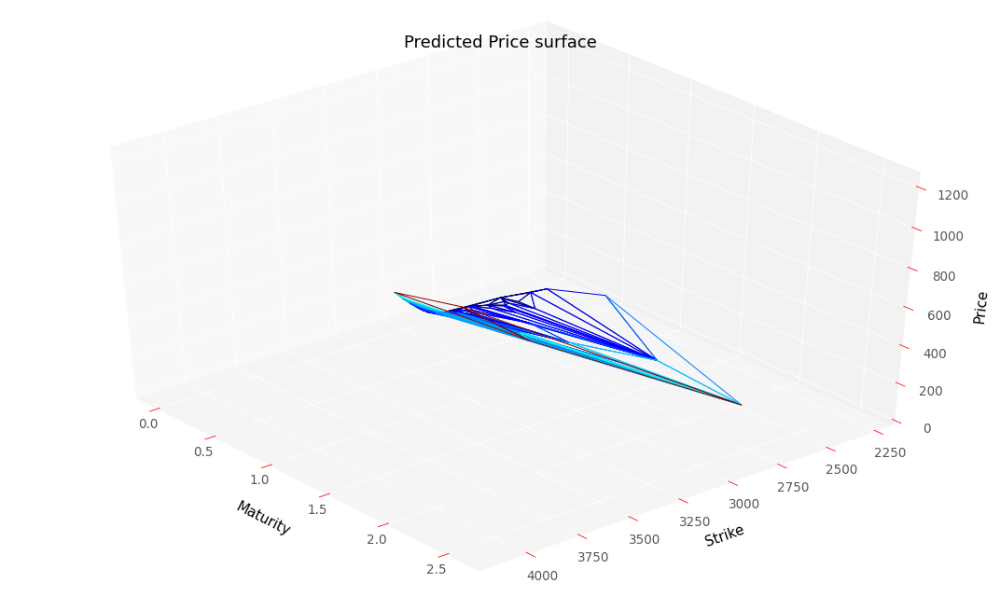

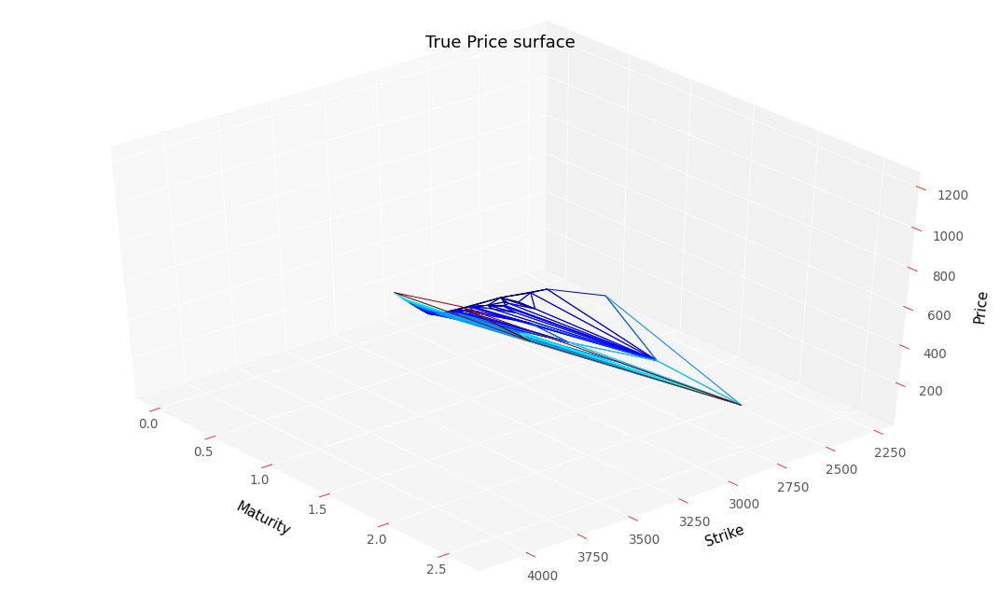

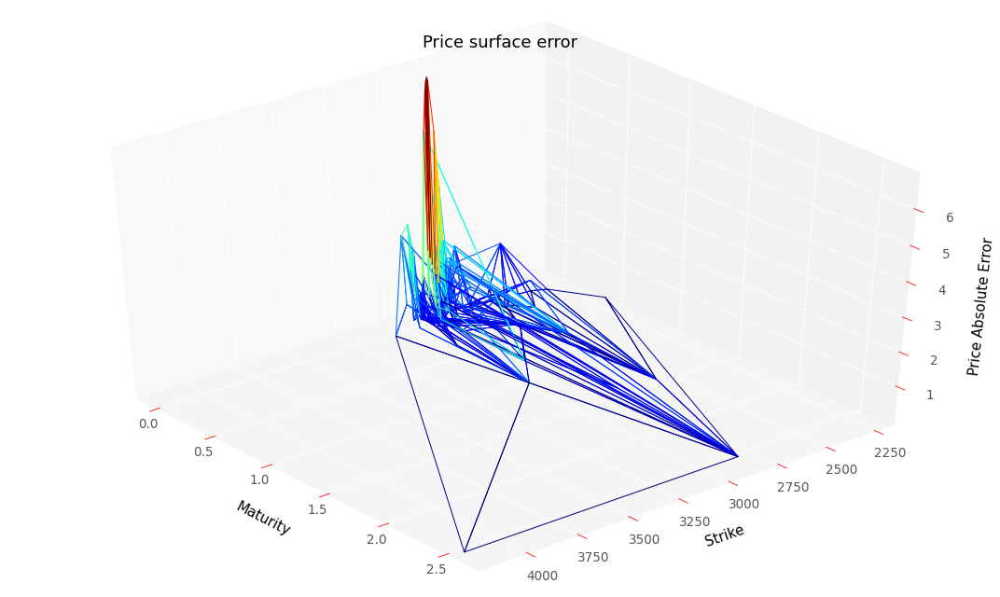

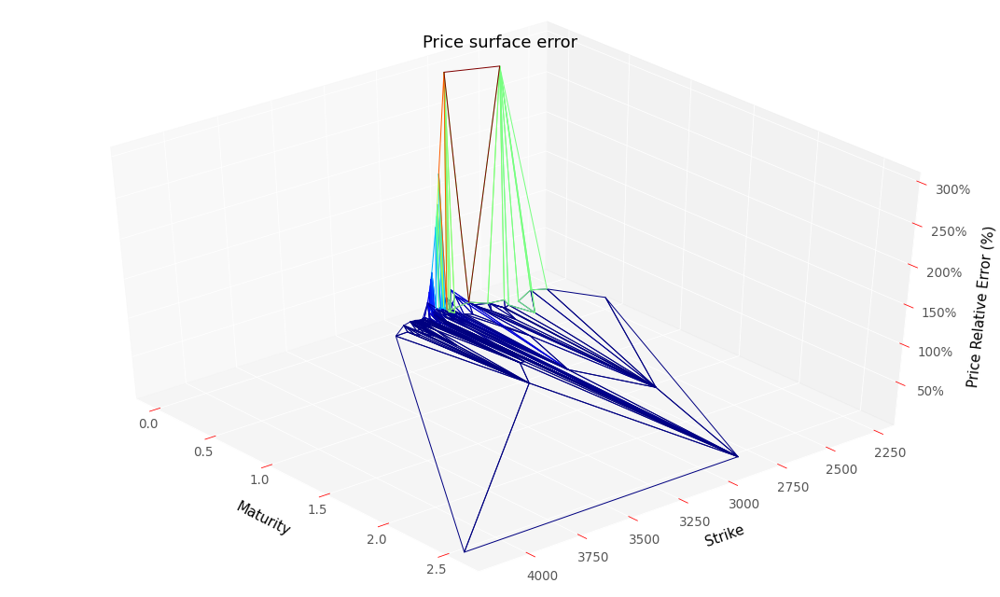

RMSE :  1.7959547062460604
RMSE Relative:  0.45367323643384


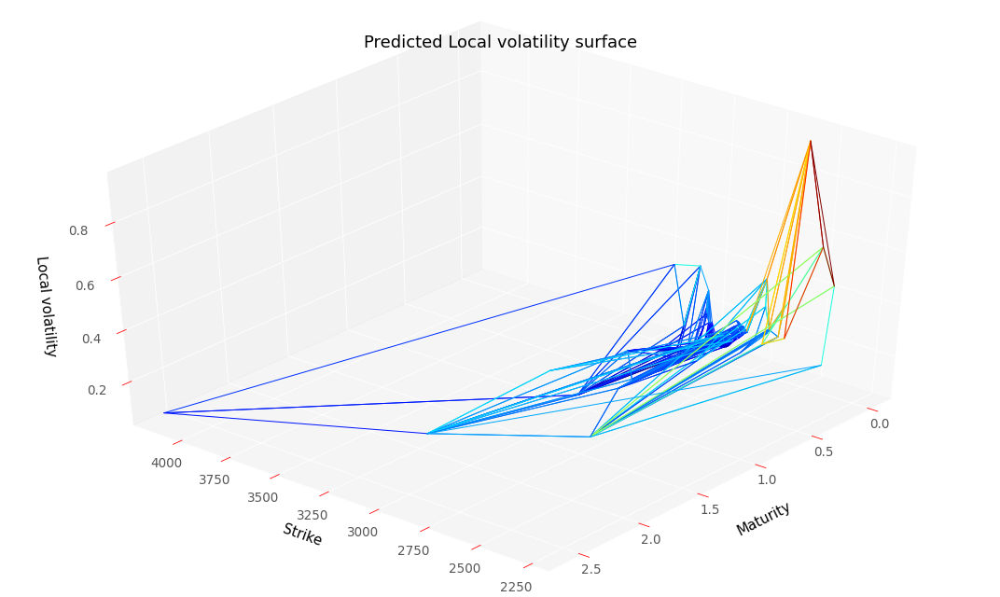

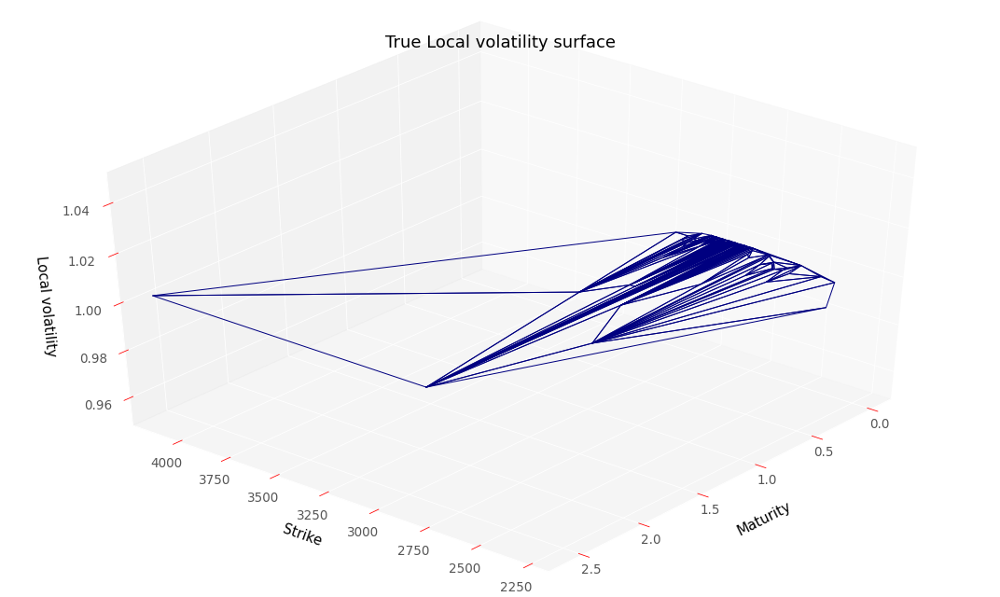

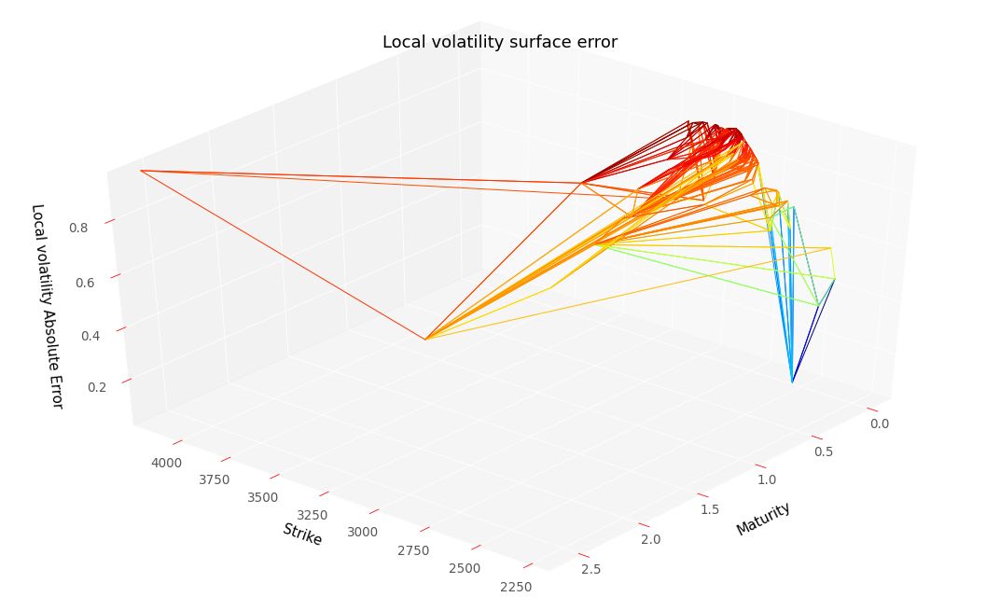

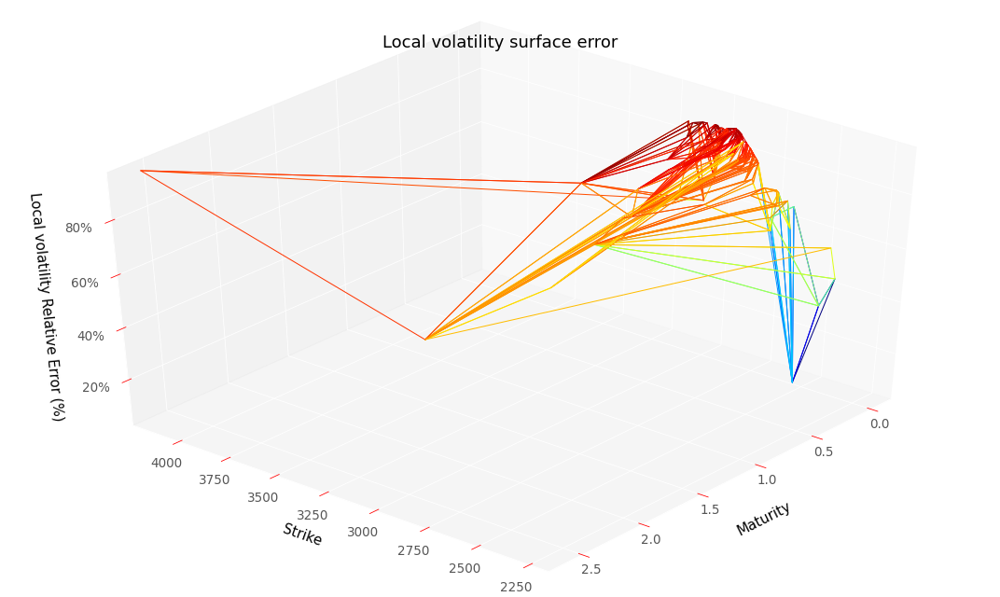

RMSE :  0.8351467723105762
RMSE Relative:  0.8351467723105762


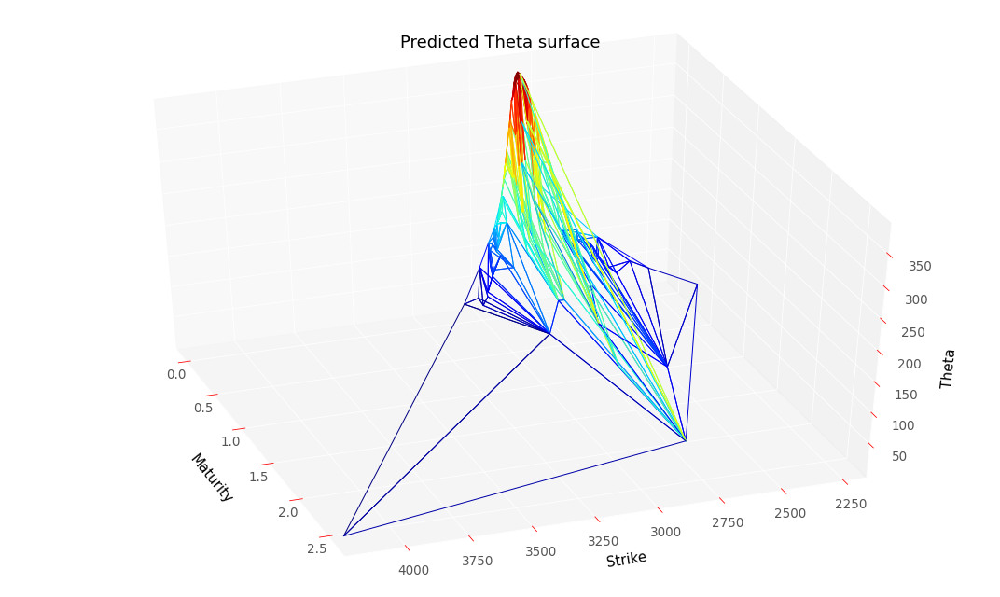

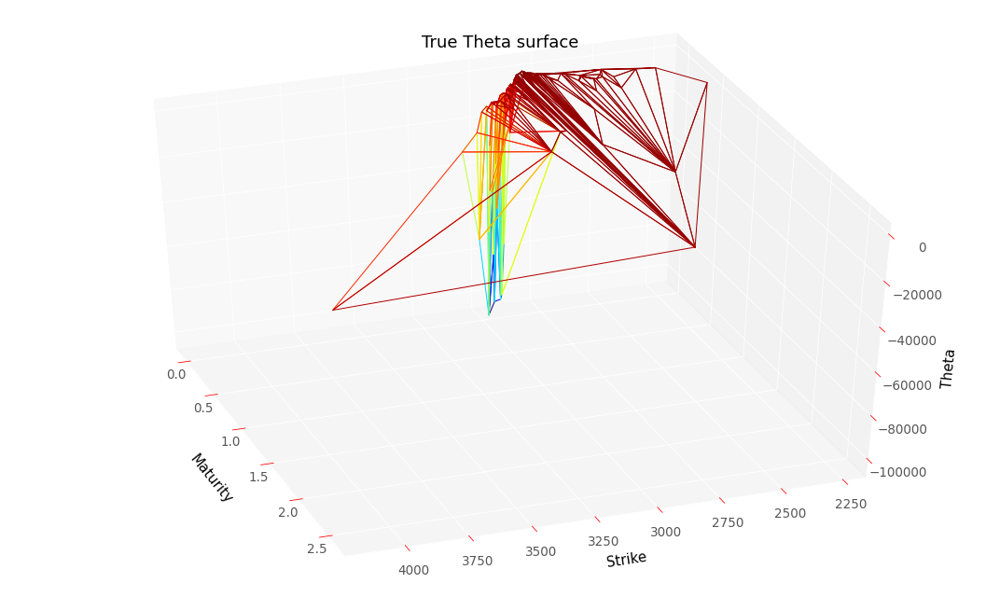

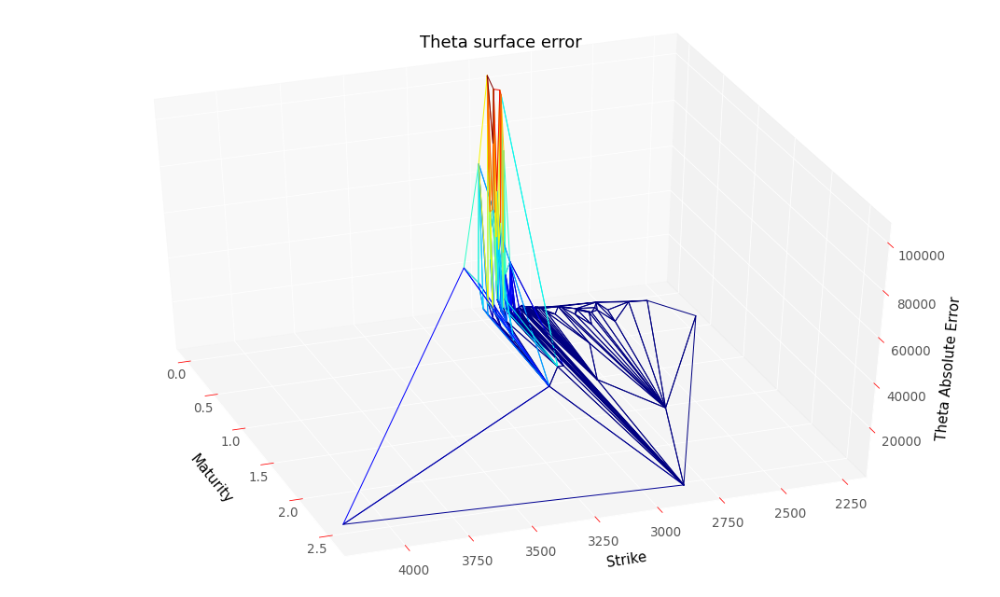

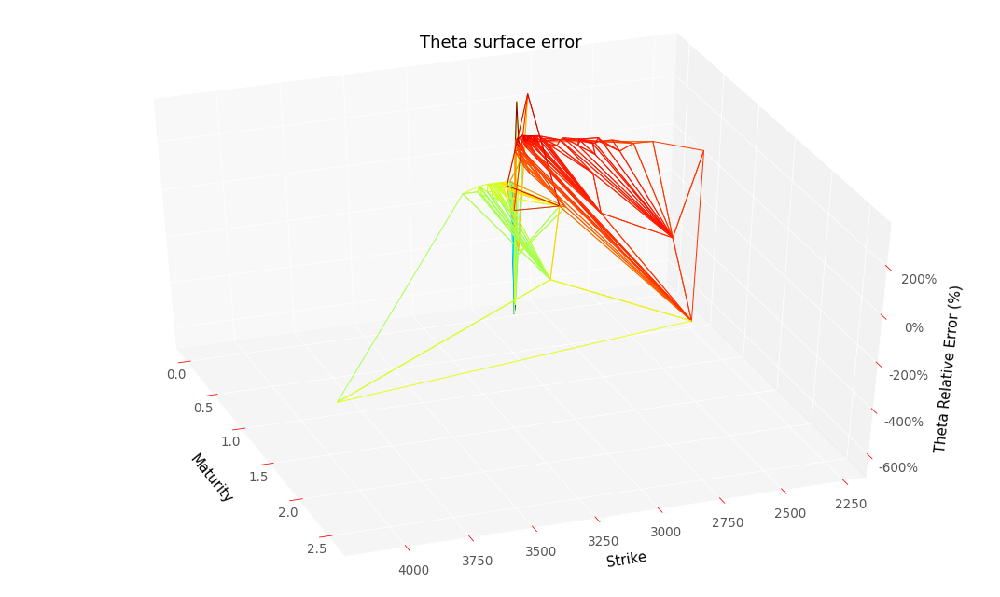

RMSE :  24457.9885565252
RMSE Relative:  1.307153546454654


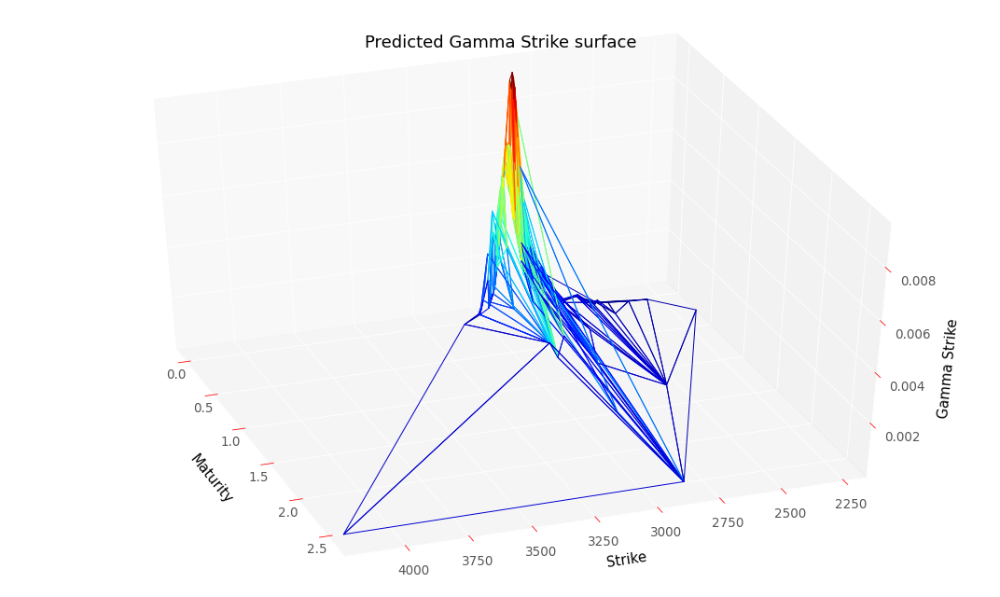

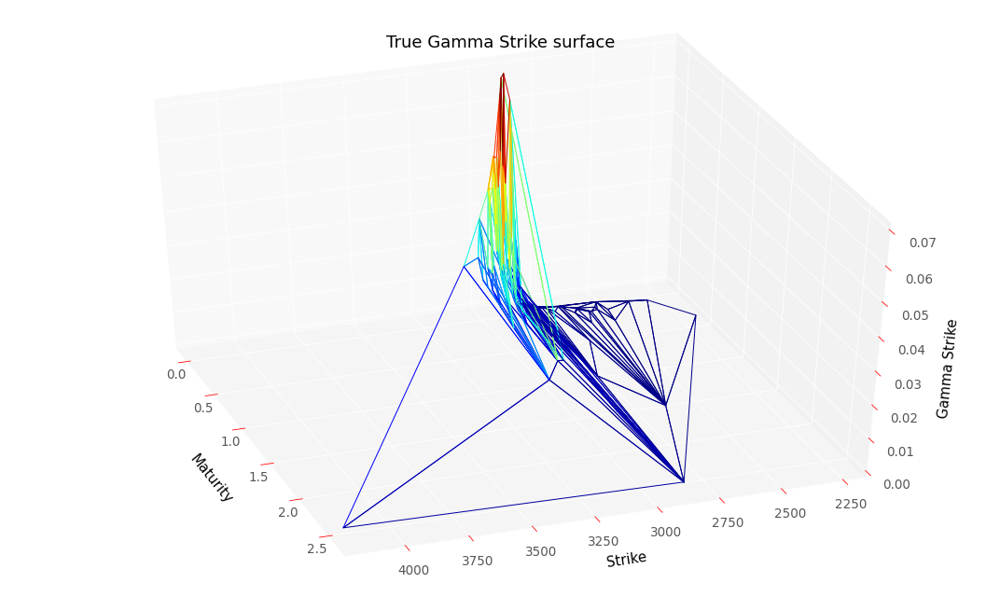

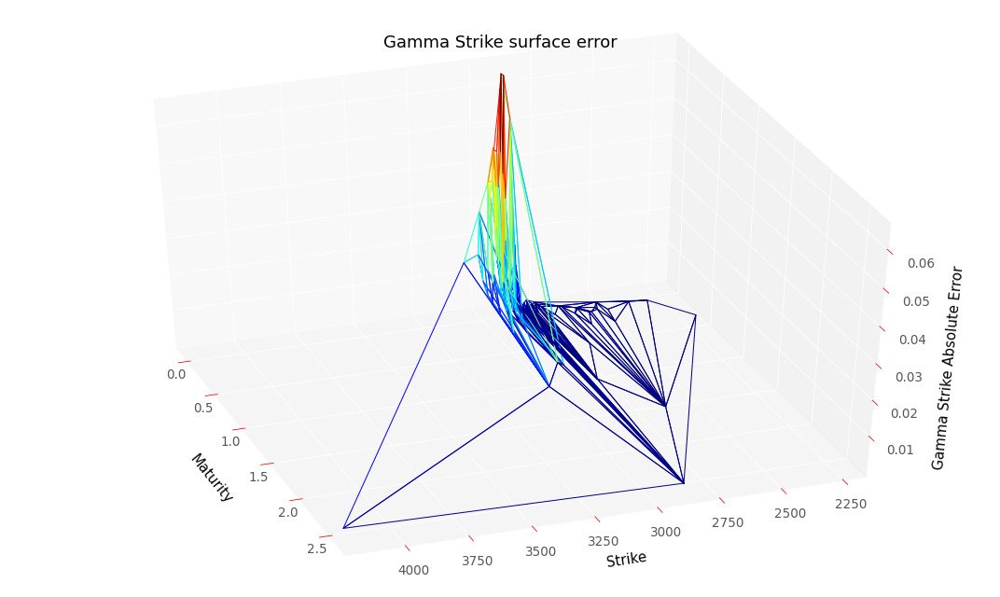

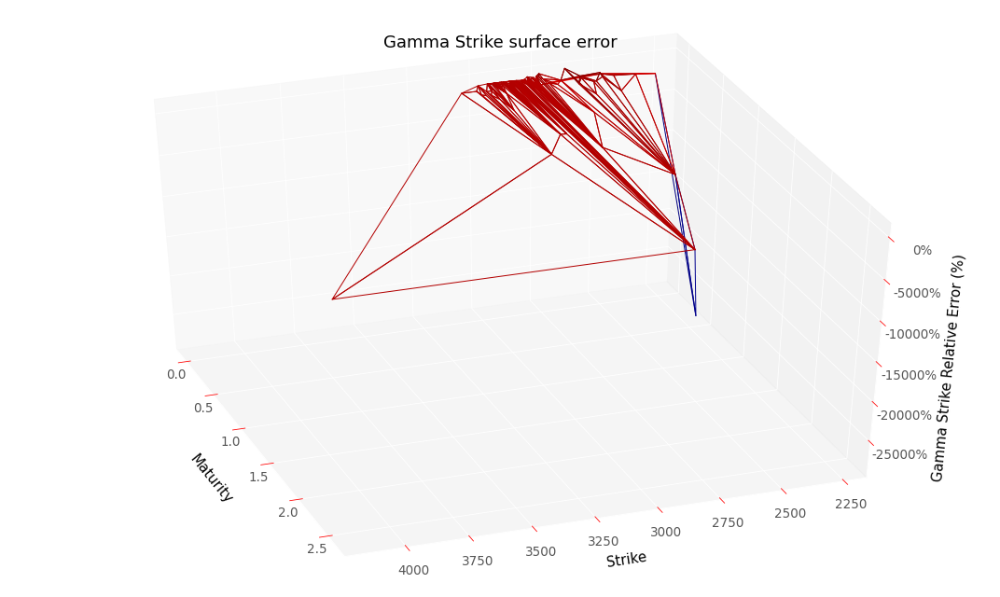

RMSE :  0.018615864736382565
RMSE Relative:  25.056724417555905


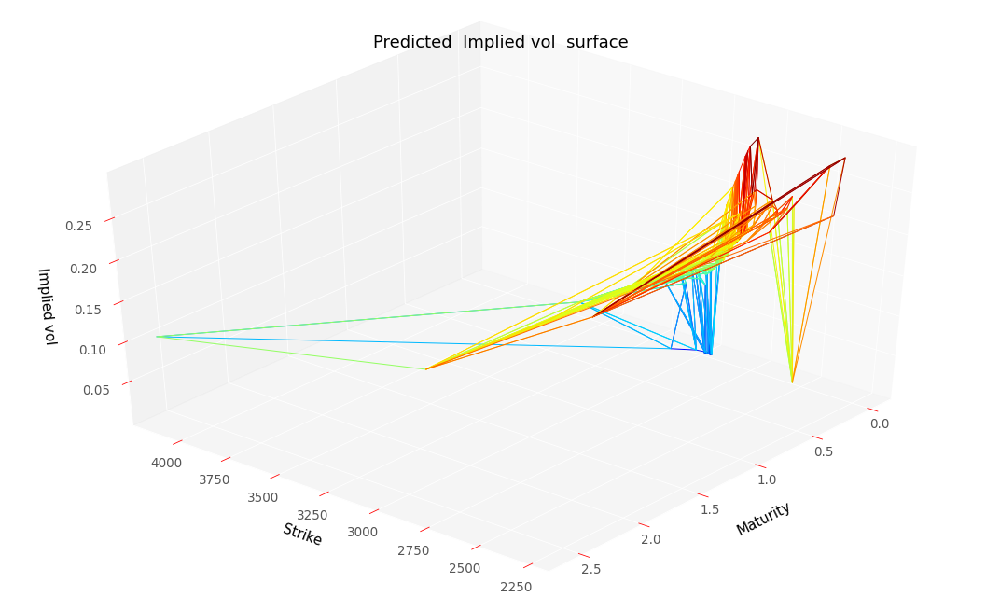

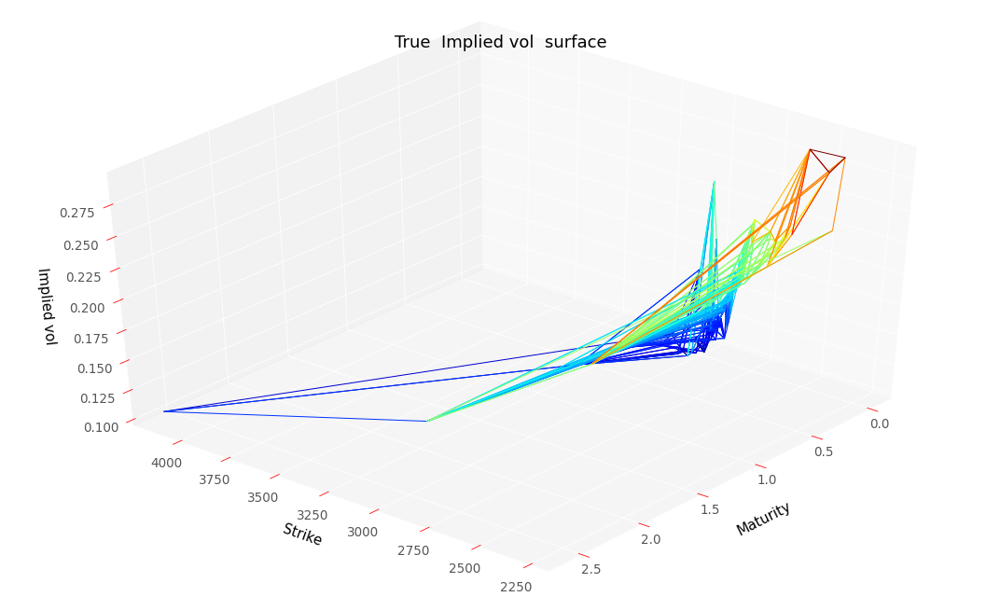

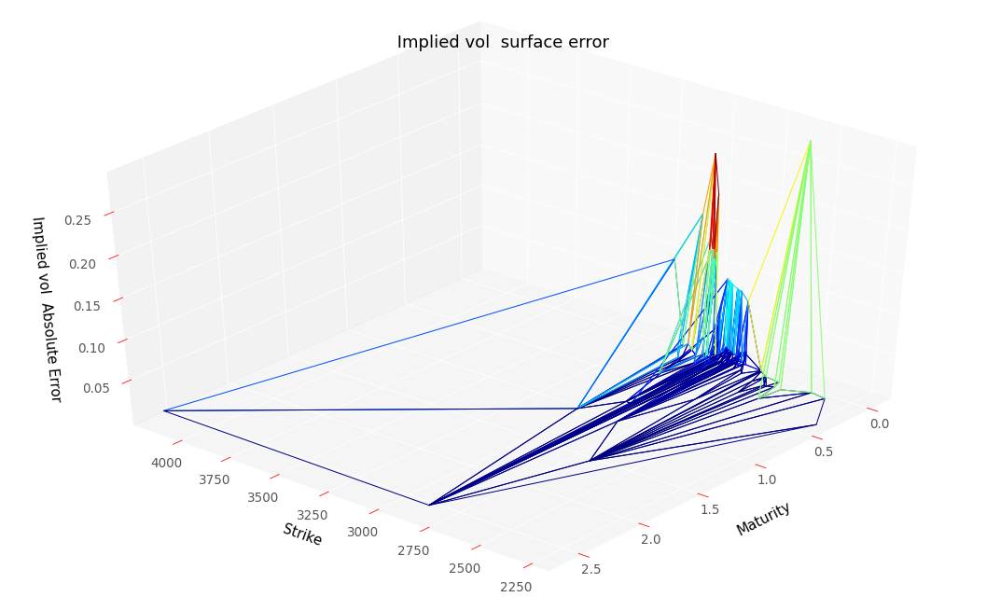

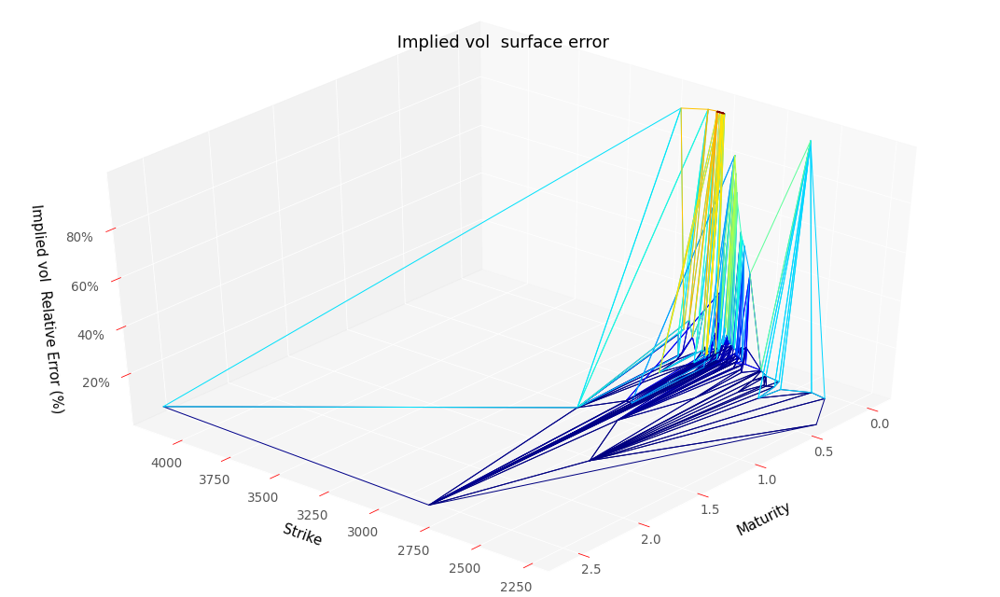

RMSE :  0.05683343936678656
RMSE Relative:  0.3518315802124112


In [62]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                      scaledDataSet,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "convexSoftVolModel")
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

plotTools.modelSummary(y_pred4,
                       volLocale4, 
                       dNN_T4, 
                       gNN_K4, 
                       dataSet,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralPriceTrain")

In [ ]:
volLocale4.loc[(midS0,slice(None))]

Strike  Maturity
2860.0  0.005       0.104423
        0.011       0.111483
        0.036       0.133972
        0.074       0.155001
        0.112       0.170493
        0.285       0.176236
Name: Dupire, dtype: float32

Best loss (hidden nodes: 100, iterations: 0): 0.32
Best Penalization :  [1.3616138, [0.0, 0.0, 0.020829355]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0150096845]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


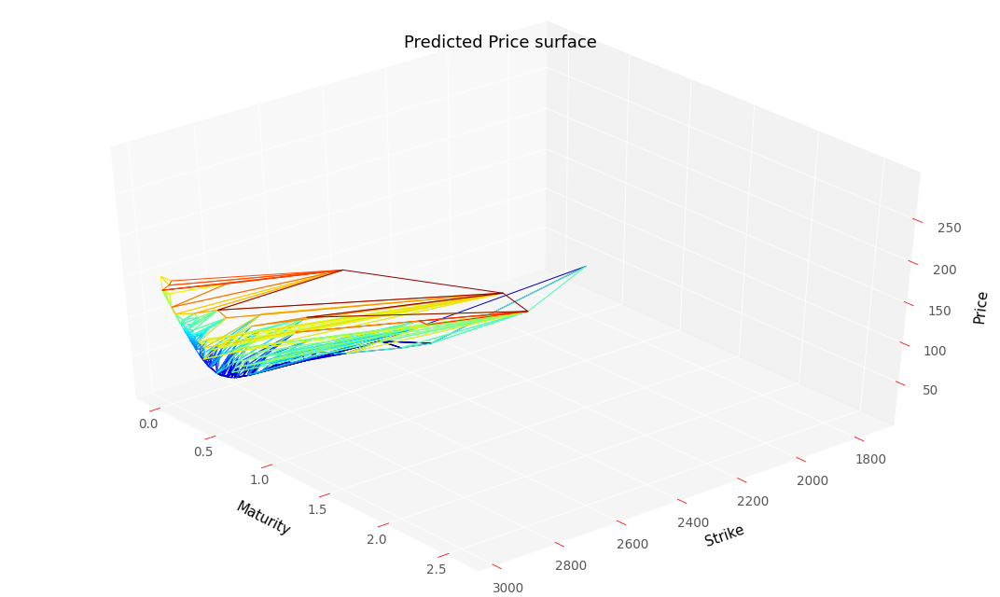

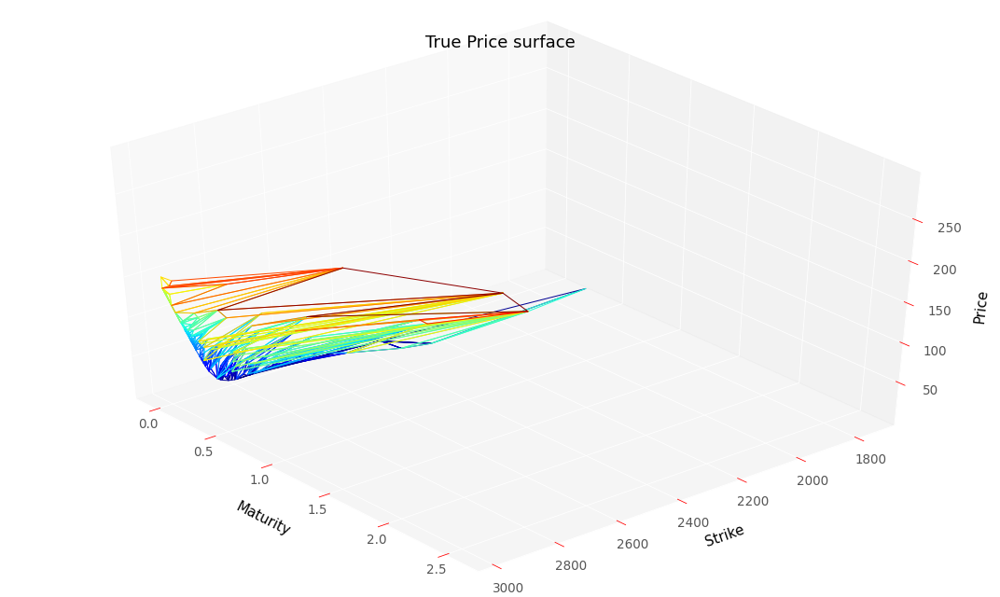

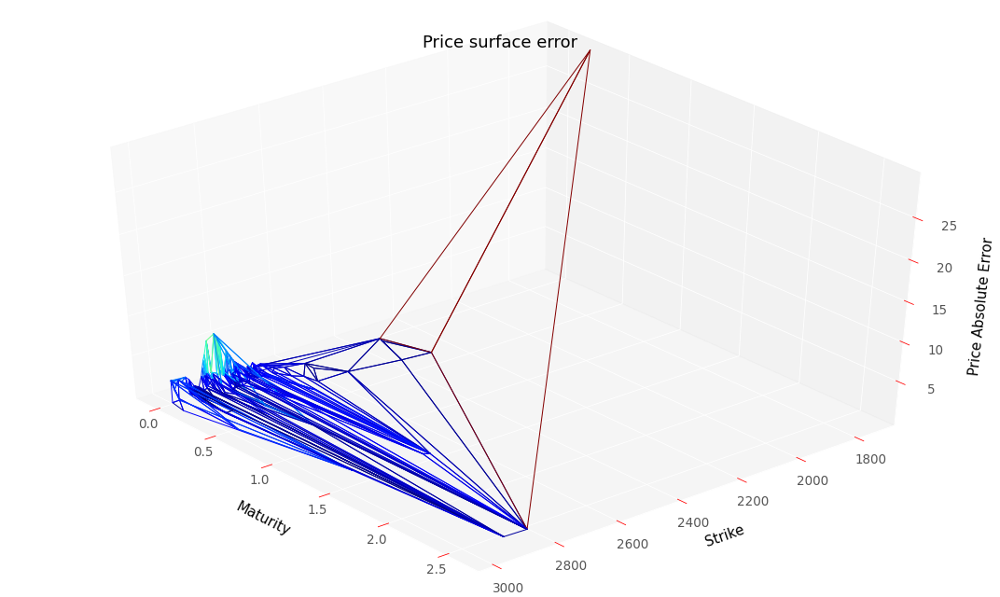

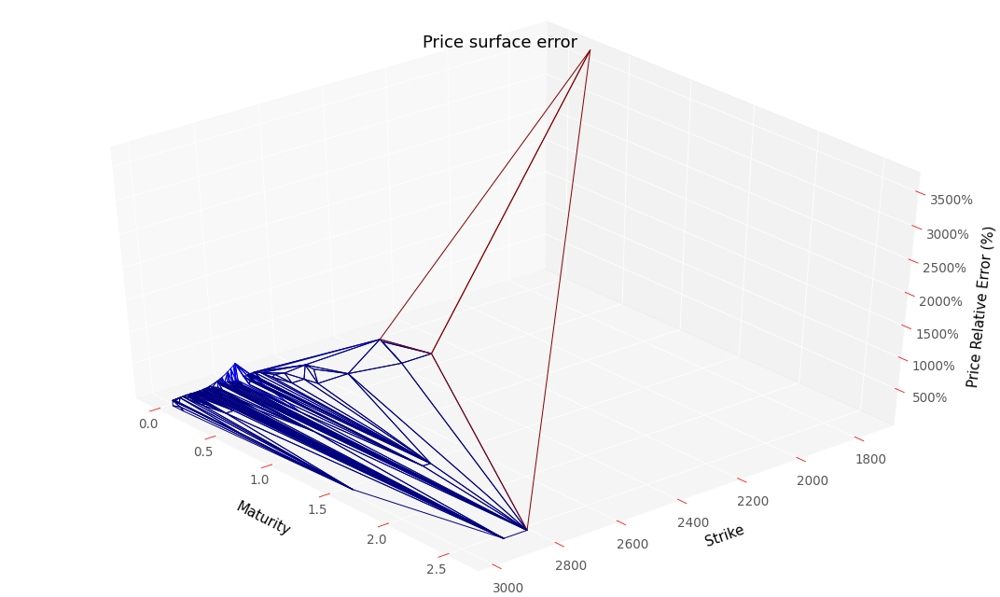

RMSE :  3.0186153885246454
RMSE Relative:  3.1124495378046175


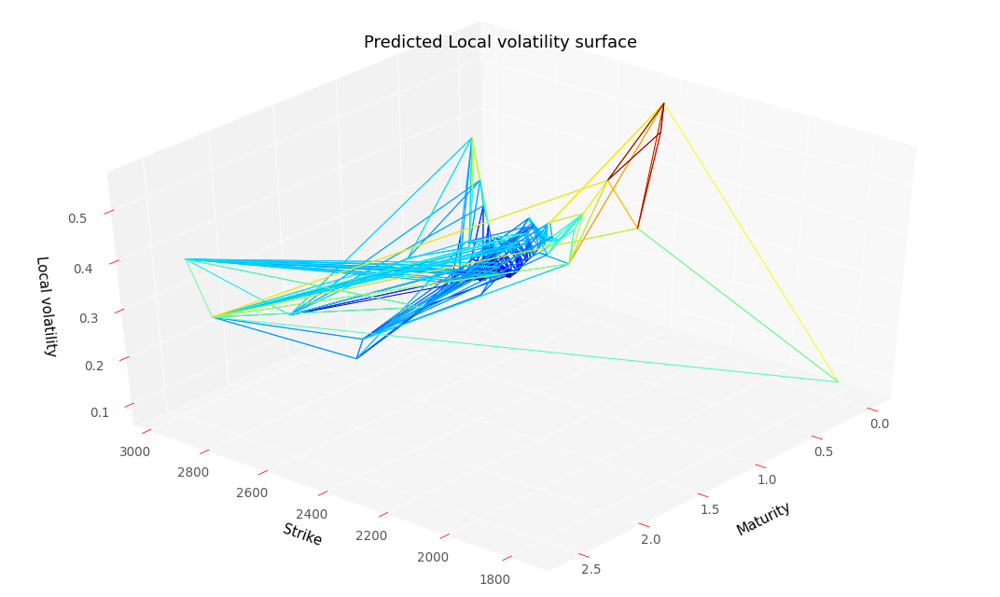

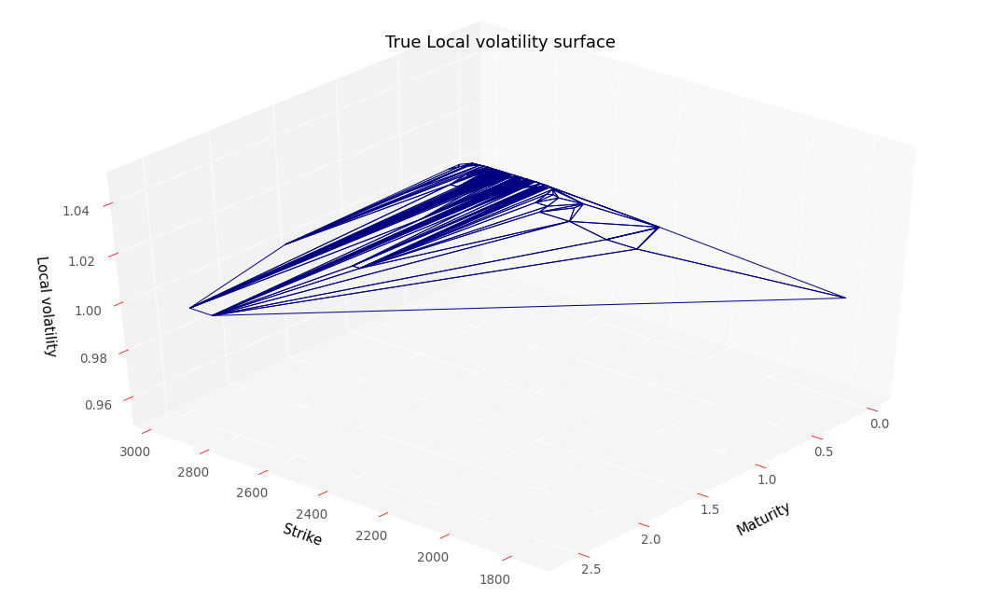

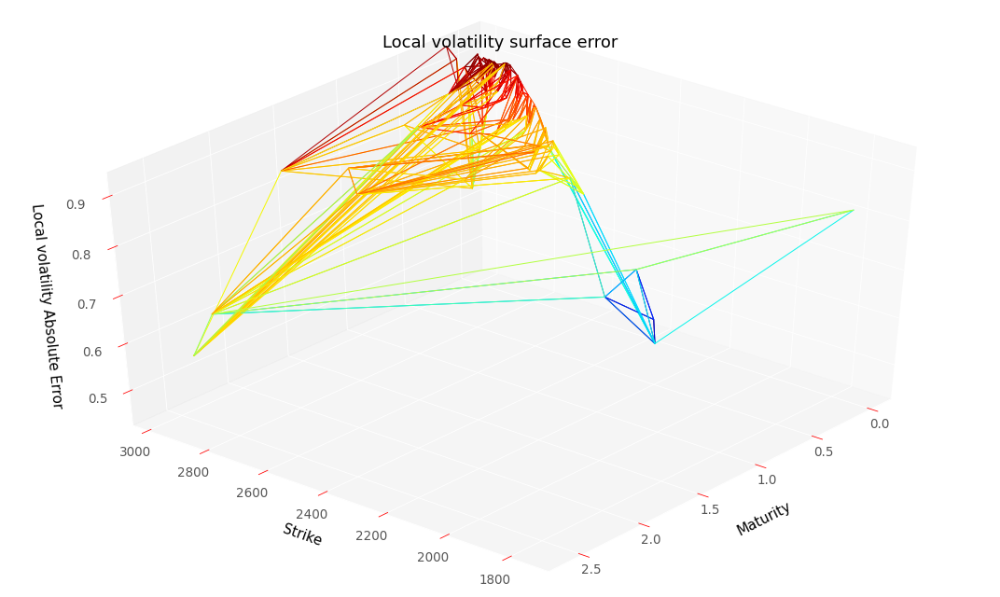

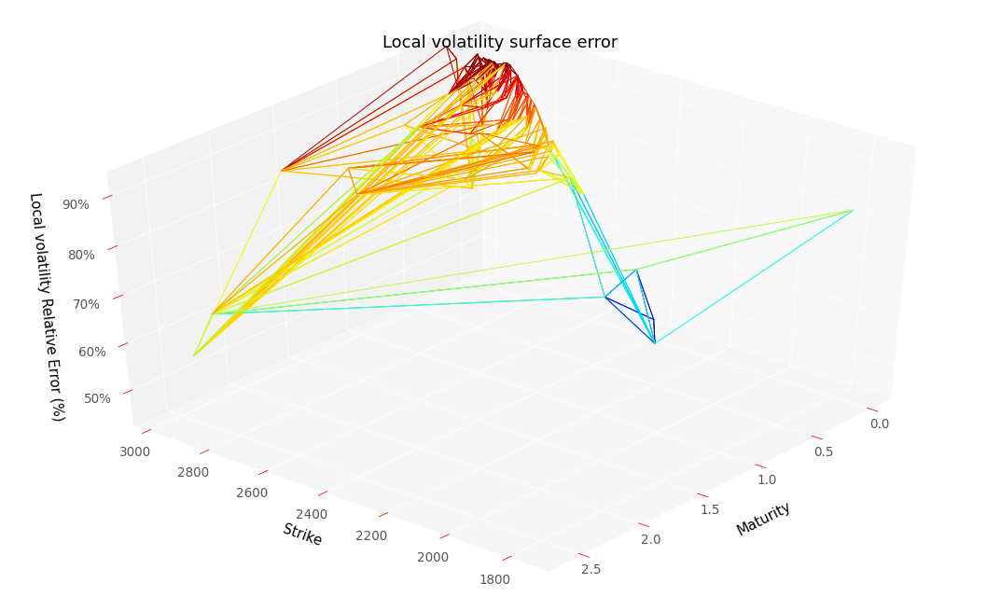

RMSE :  0.8370065986789647
RMSE Relative:  0.8370065986789647


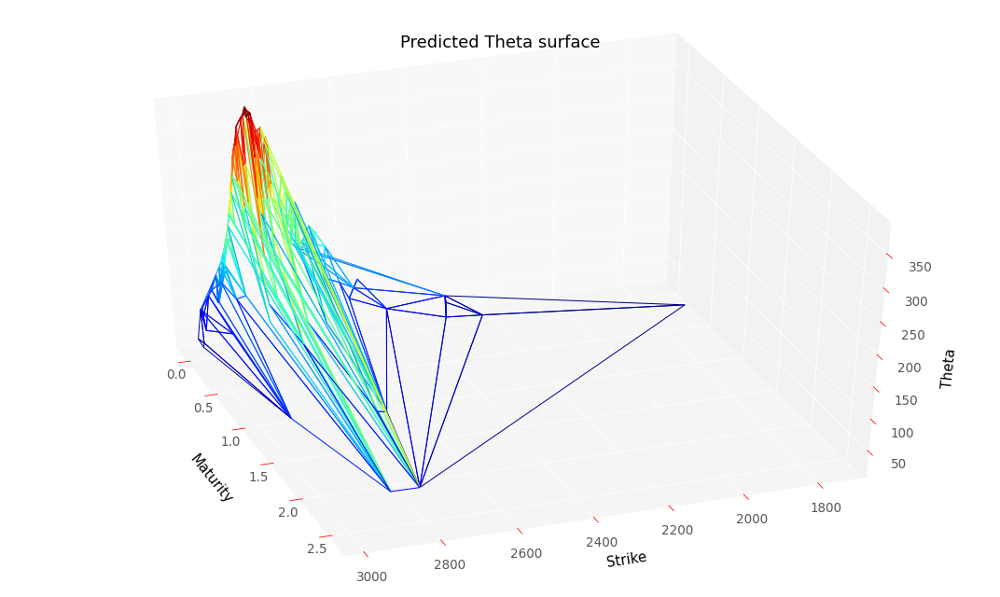

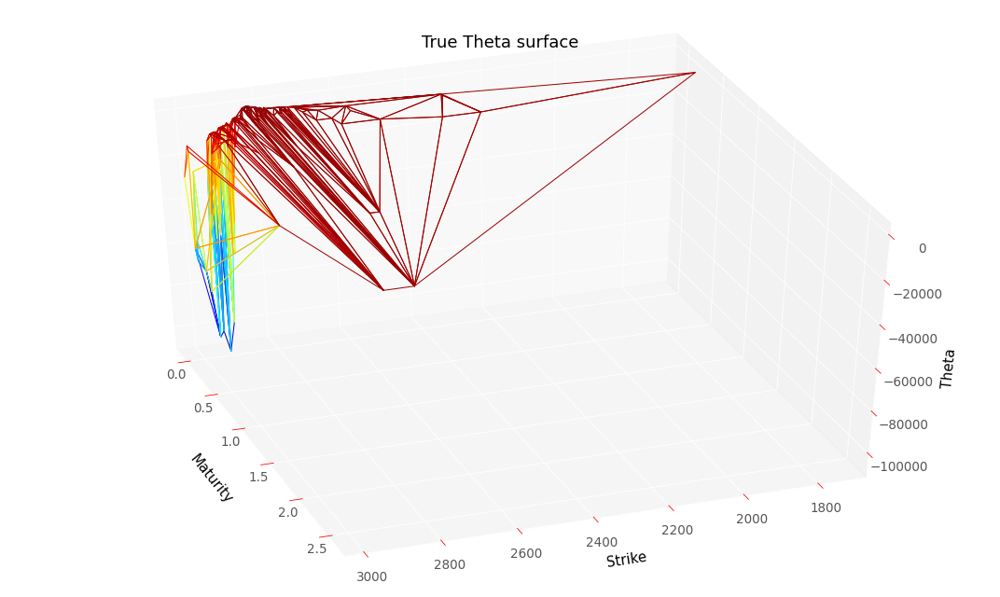

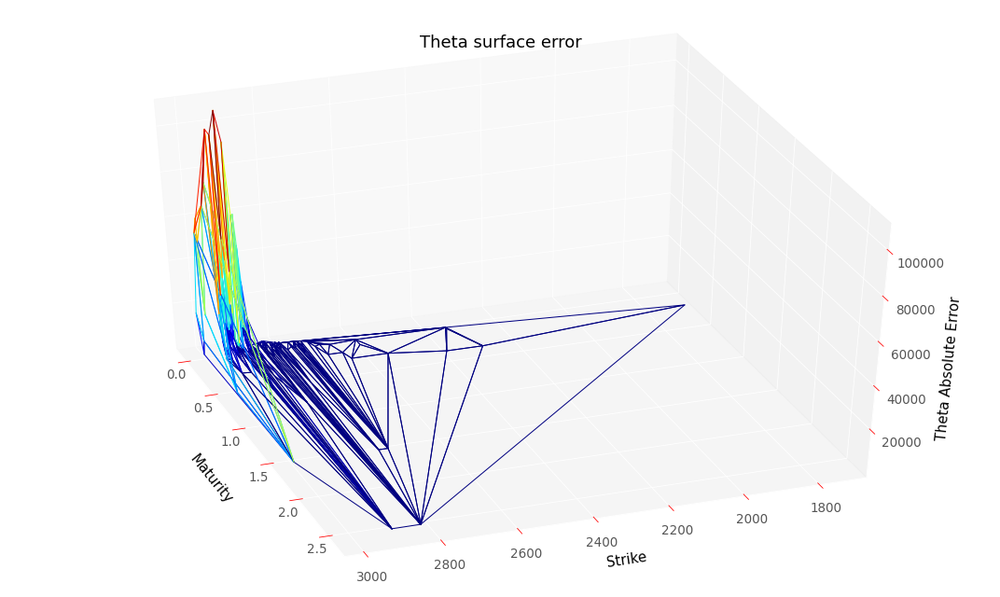

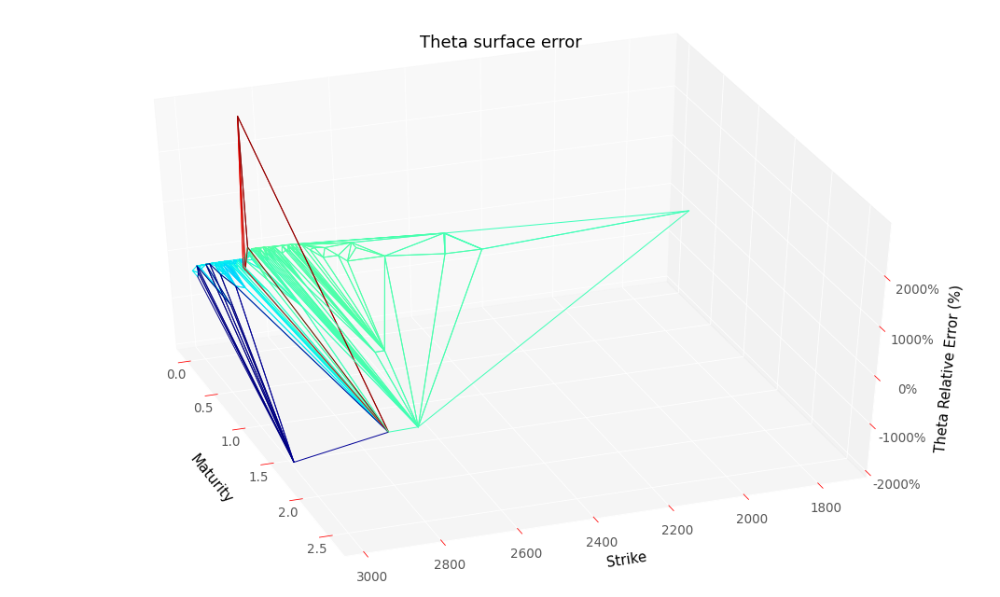

RMSE :  25095.768756147478
RMSE Relative:  3.1044773416762883


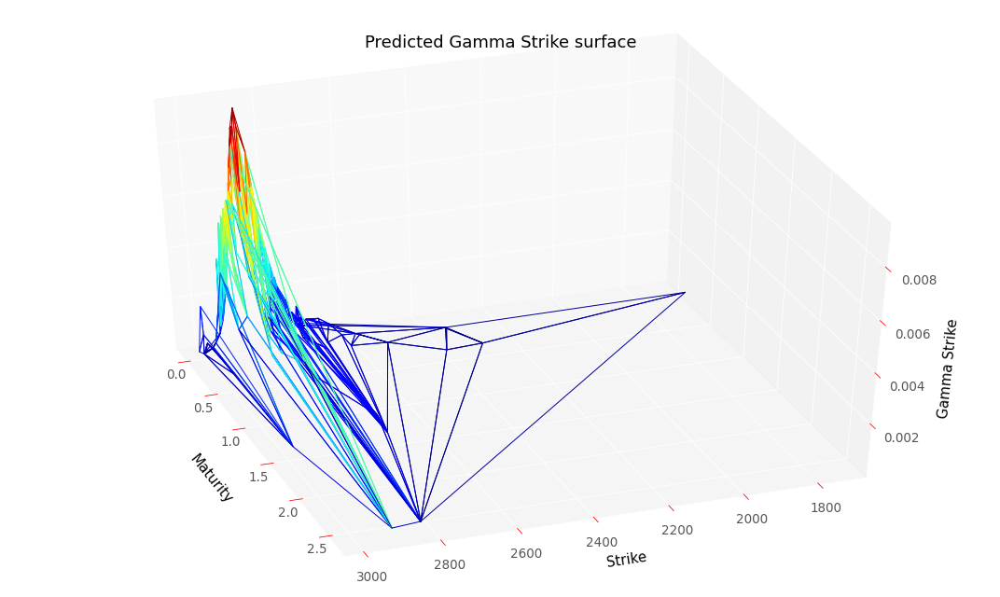

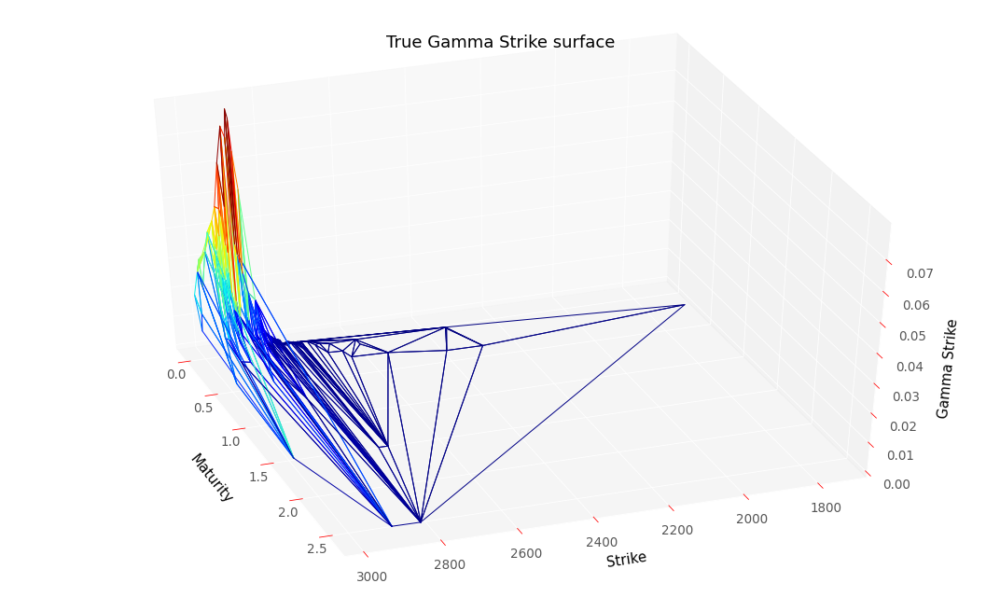

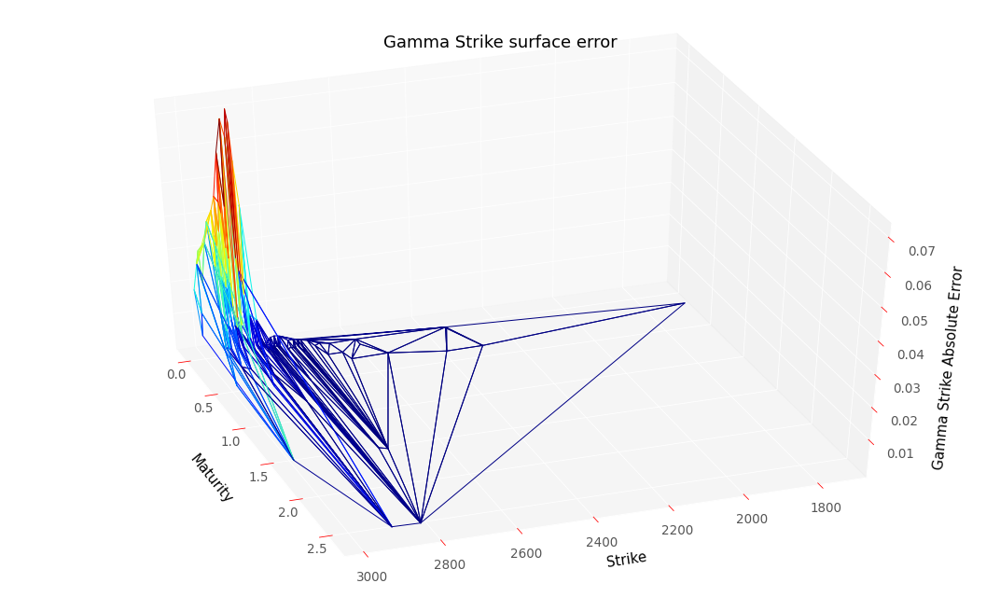

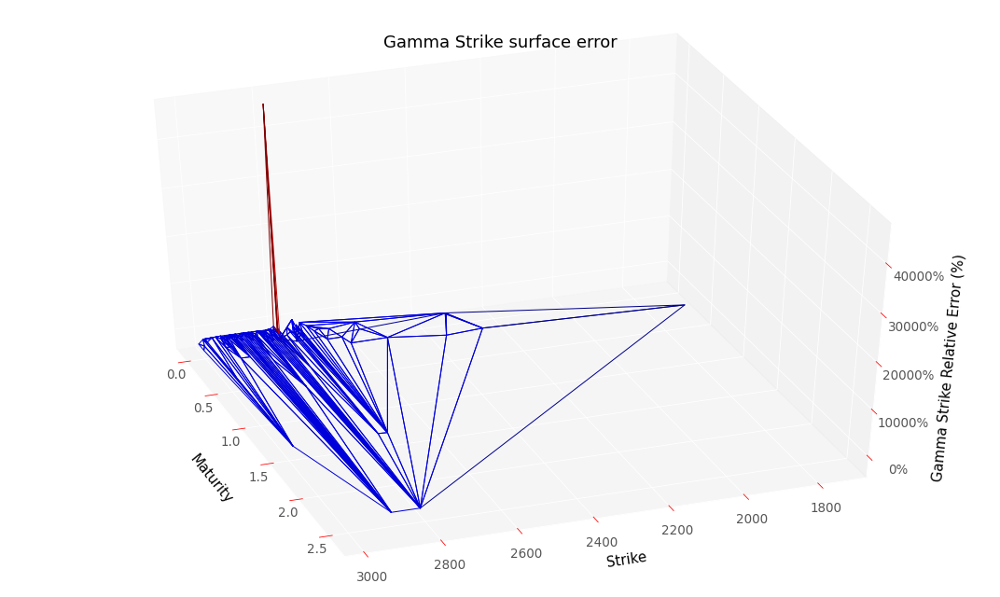

RMSE :  0.020523597954508407
RMSE Relative:  39.42141964677682


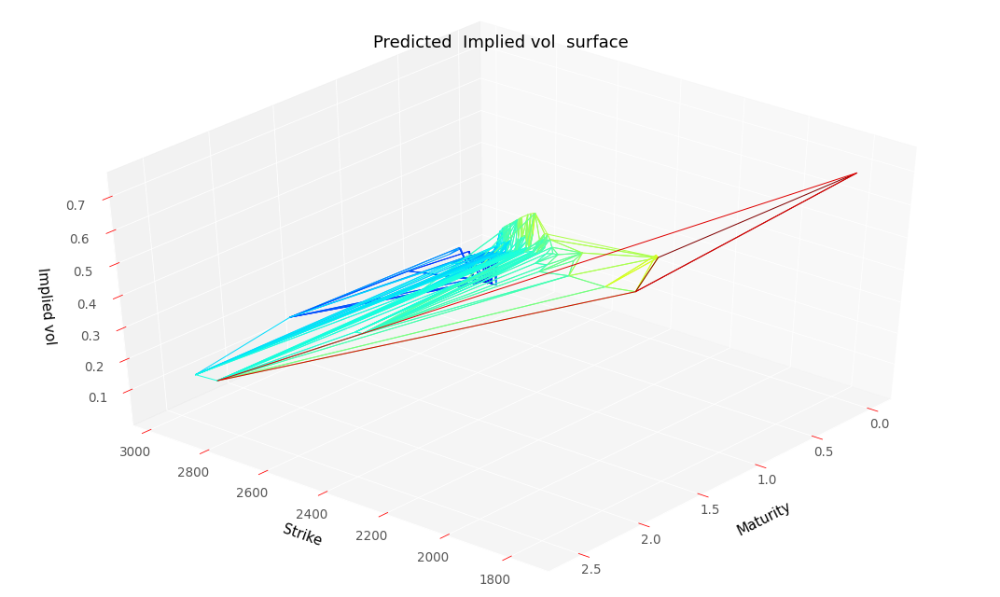

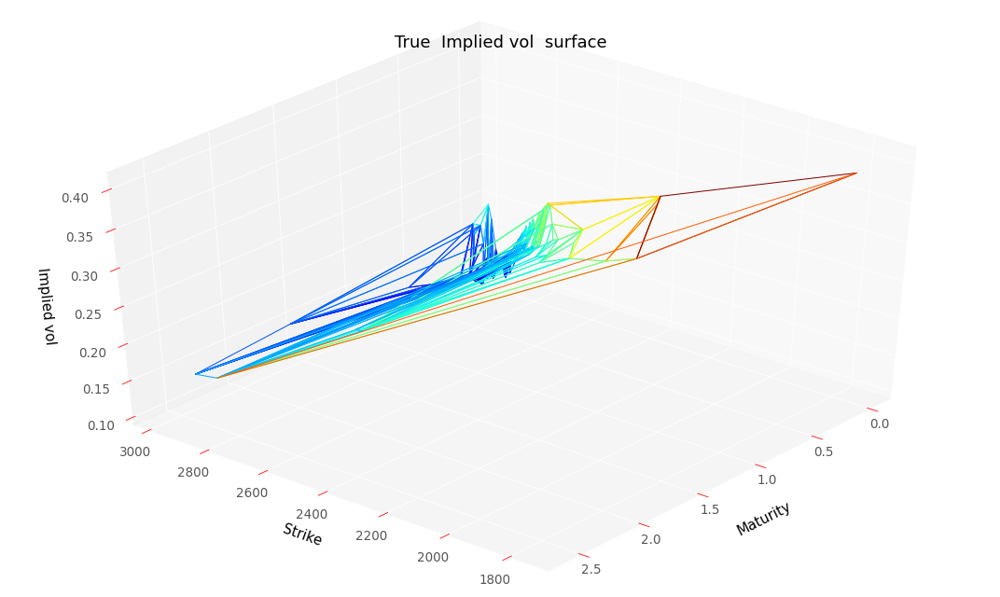

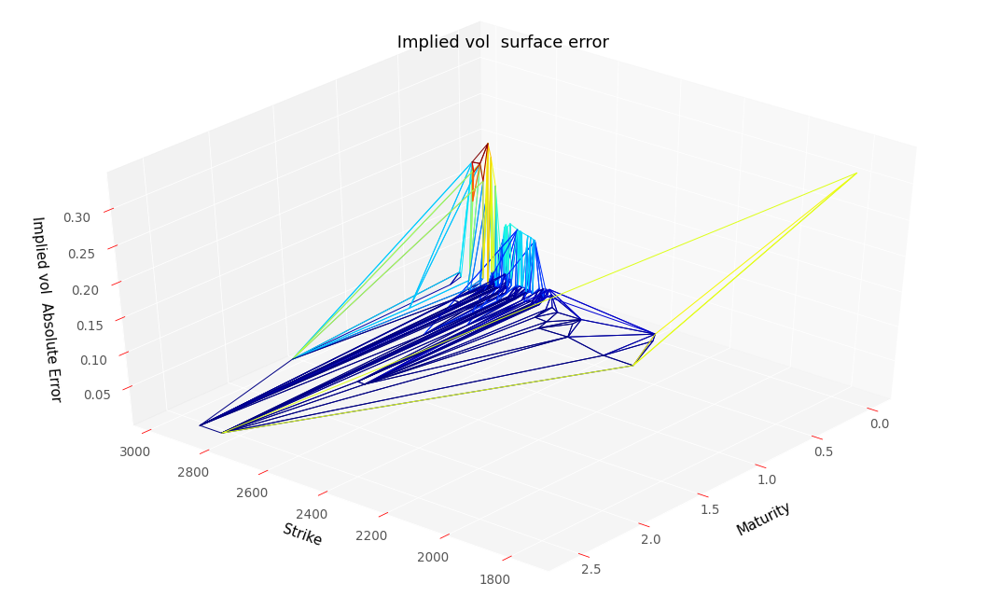

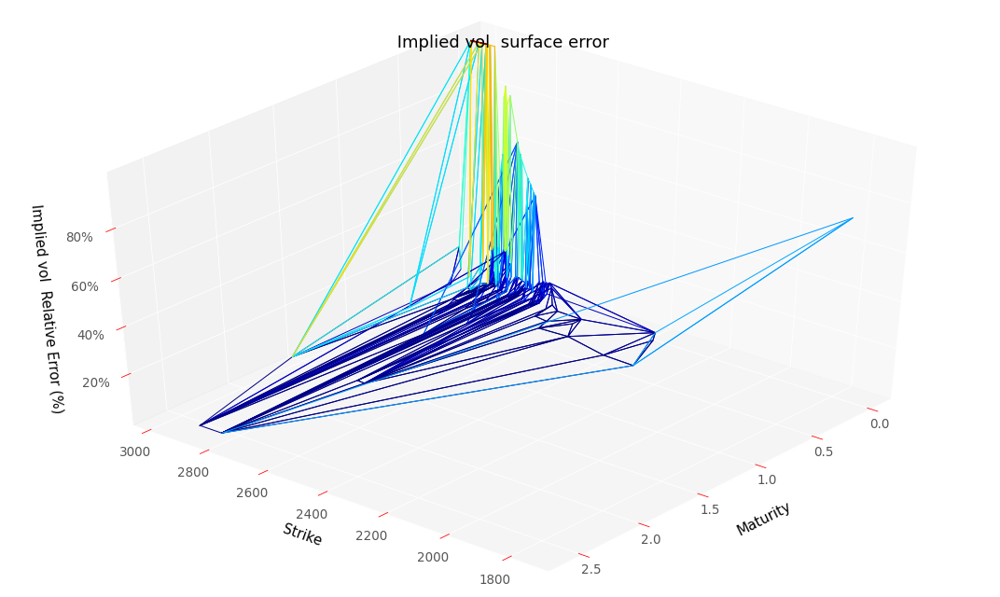

RMSE :  0.058301320419272294
RMSE Relative:  0.33973465003009745


In [63]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                      scaledDataSetTest,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "convexSoftVolModel")
y_pred4Test, volLocale4Test, dNN_T4Test, gNN_K4Test, lossSerie4TestG = res

plotTools.modelSummary(y_pred4Test,
                       volLocale4Test,
                       dNN_T4Test,
                       gNN_K4Test,
                       dataSetTest,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralPriceTest")

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [ ]:
S0

In [ ]:
# Function which evaluates neural local volatility when neural network is fitted on prices
def neuralVolLocalePrix(s,t):
    vLoc = neuralNetwork.evalVolLocale(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       s, t,
                                       dataSet,
                                       hyperparameters,
                                       scaler,
                                       bootstrap,
                                       S0,
                                       modelName = "convexSoftVolModel")
    return vLoc.dropna()

In [ ]:
importlib.reload(neuralNetwork)

In [ ]:
#Artificial grid with 10000 points which aims to limit the impact of linear interpolation
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)

In [ ]:
volLocalInterp = neuralVolLocalePrix(volLocaleGrid[0].flatten(),
                                     volLocaleGrid[1].flatten())
volLocalInterp.head()

In [ ]:
volLocalInterp2 = neuralVolLocalePrix(dataSetTest.index.get_level_values("Strike").values.flatten(),
                                      dataSetTest.index.get_level_values("Maturity").values.flatten())
volLocalInterp2.head()

In [ ]:
#Local volatility function for backtests
nnVolLocale = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp, x, y)

In [ ]:
#Local volatility function for backtests
nnVolLocale2 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp2, x, y)

In [ ]:
plotTools.plotSerie(volLocalInterp,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

In [ ]:
plotTools.plotSerie(volLocalInterp2,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the 10000 points grid.
mcResVolLocalePrix = backtest.MonteCarloPricerVectorized(S0,
                                                         dataSetTest,
                                                         bootstrap,
                                                         nbPaths,
                                                         nbTimeStep,
                                                         nnVolLocale)
mcResVolLocalePrix.head()

In [ ]:
plotTools.predictionDiagnosis(mcResVolLocalePrix["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocalePrix.to_csv("mcResVolLocalePrix.csv")

In [ ]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale, bootstrap)
pdeResVolLocale.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResVolLocale, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale.to_csv(workingFolder + "pdeResVolLocale.csv")

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the testing grid.
mcResVolLocalePrix2 = backtest.MonteCarloPricerVectorized(S0,
                                                          dataSetTest,
                                                          bootstrap,
                                                          nbPaths,
                                                          nbTimeStep,
                                                          nnVolLocale2)
mcResVolLocalePrix2.head()

In [ ]:
plotTools.predictionDiagnosis(mcResVolLocalePrix2["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocalePrix2.to_csv("mcResVolLocalePrix2.csv")

In [ ]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale2 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale2, bootstrap)
pdeResVolLocale2.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResVolLocale2, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale2.to_csv(workingFolder + "pdeResVolLocale2.csv")

# Hyperparameter selection

In [ ]:
#Random selection of several hyperparameters 
neuralNetwork.selectHyperparametersRandom(hyperparameters,
                                          ["lambdaLocVol","lambdaSoft","lambdaGamma"],
                                          neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                          "hyperParameters",
                                          True, 
                                          100,
                                          scaledDataSet,
                                          scaler,
                                          trainedOnPrice = False,
                                          logGrid = True)

In [ ]:
#hyperparameters["lambdaLocVol"] = 100
#hyperparameters["lambdaSoft"] = 100 
#hyperparameters["lambdaGamma"] = 10000
hyperparameters["lambdaLocVol"] = 0.01#0.01 #100
hyperparameters["lambdaSoft"] = 0.01#10#10 #100 
hyperparameters["lambdaGamma"] = 100#10 #10000

In [ ]:
#marginal selection of hypterparameters
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "DupireVarCap", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["lambdaLocVol"] = 100



In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["nbUnits"] = 40



In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "nbUnits", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = False)

In [ ]:
hyperparameters["nbUnits"] = 200


In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["nbUnits"] = 40

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "nbUnits", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = False)

In [ ]:
hyperparameters["nbUnits"] = 200

## SSVI Backtesting

In [118]:
importlib.reload(loadData)

<module 'loadData' from './code/loadData.py'>

#### Run SSVI Model

Implementation is inspired from Matlab code of Philipp Rindler : 
- Philipp Rindler (2020). Gatherals and Jacquier's Arbitrage-Free SVI Volatility Surfaces (https://www.mathworks.com/matlabcentral/fileexchange/49962-gatherals-and-jacquier-s-arbitrage-free-svi-volatility-surfaces), MATLAB Central File Exchange. Retrieved November 20, 2020.

In [21]:
np.seterr(all='warn')

{'divide': 'warn', 'over': 'warn', 'under': 'ignore', 'invalid': 'warn'}

In [22]:
importlib.reload(BS)

<module 'BS' from './code/BS.py'>

In [23]:
#parameters, theta, maturities, pSSVI = SSVI.train_svi_surface(dataSet, S0)
SSVIModel = SSVI.SSVIModel(S0, bootstrap)
SSVIModel.fit(dataSet)

Contrainte :  -0.7053266018149094
Parameters of SSVI model :  [-0.48289288  0.87307277  0.5       ]
time step 25  :  2.585
Contrainte :  0.20870100604518027
time step 24  :  1.588


./code/SSVI.py:617: RuntimeWarning: invalid value encountered in sqrt
  alpha = np.sign(beta) * np.sqrt(1 / beta ** 2 - 1)
./code/SSVI.py:619: RuntimeWarning: invalid value encountered in sqrt
  (b * (-rho + np.sign(alpha) * np.sqrt(1 + alpha ** 2) - alpha * np.sqrt(1 - rho ** 2))))
./code/SSVI.py:630: RuntimeWarning: invalid value encountered in sqrt
  a = vt * tau - b * sigma * np.sqrt(1 - rho ** 2)
./code/SSVI.py:324: RuntimeWarning: invalid value encountered in less
  if any(model_total_implied_variance < before_total_implied_variance) :
./code/SSVI.py:331: RuntimeWarning: invalid value encountered in greater
  if any(model_total_implied_variance > after_total_implied_variance) :


Contrainte :  0.21938730026256364
time step 23  :  1.09
Contrainte :  0.0381200551702906
time step 22  :  0.841
Contrainte :  0.22243909195283862
time step 21  :  0.591
Contrainte :  0.2218836147407982
time step 20  :  0.419
Contrainte :  0.22460316231891336
time step 19  :  0.342
Contrainte :  0.2123804327784234
time step 18  :  0.285
Contrainte :  0.2250437771965494
time step 17  :  0.24600000000000002
Contrainte :  0.22507852749189033
time step 16  :  0.203
Contrainte :  0.22384137207509708
time step 15  :  0.18899999999999997
Contrainte :  0.22529091996385886
time step 14  :  0.17
Contrainte :  0.22526910650958826
time step 13  :  0.151
Contrainte :  0.2233428634072273
time step 12  :  0.131
Contrainte :  0.2213463936852697
time step 11  :  0.11199999999999999
Contrainte :  0.2253609723983363
time step 10  :  0.09300000000000001
Contrainte :  0.20834454083286574
time step 9  :  0.07400000000000001
Contrainte :  0.16391143540492736
time step 8  :  0.063
Contrainte :  0.2209247515209

In [24]:
serie = SSVIModel.eval(dataSetTest)
serieTrain = SSVIModel.eval(dataSet)

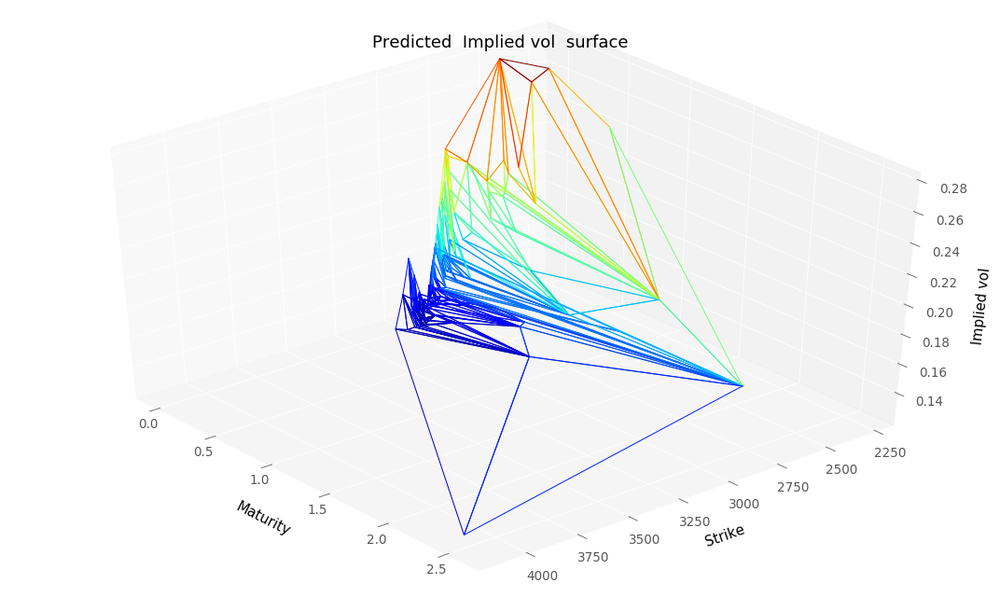

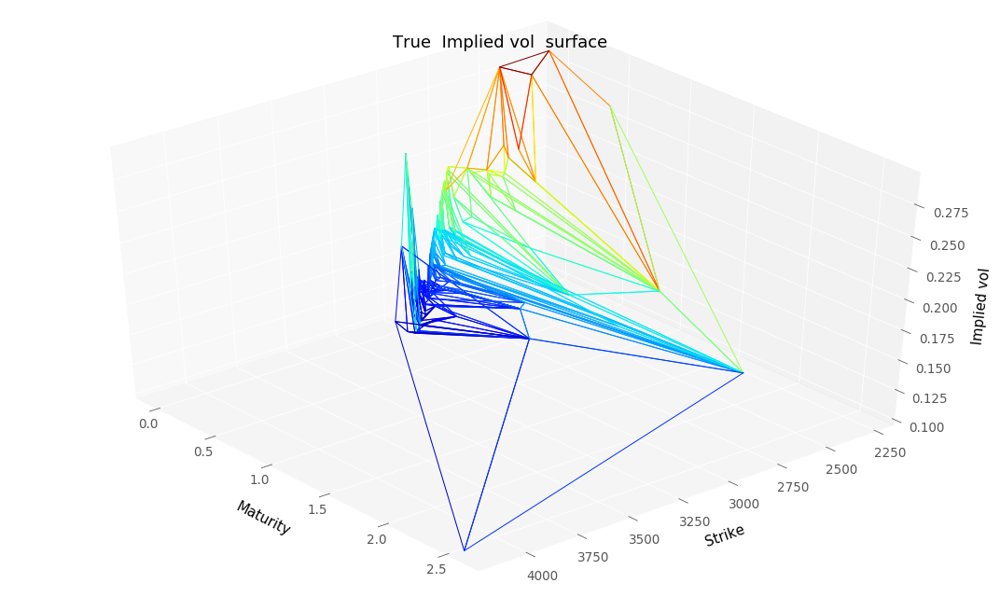

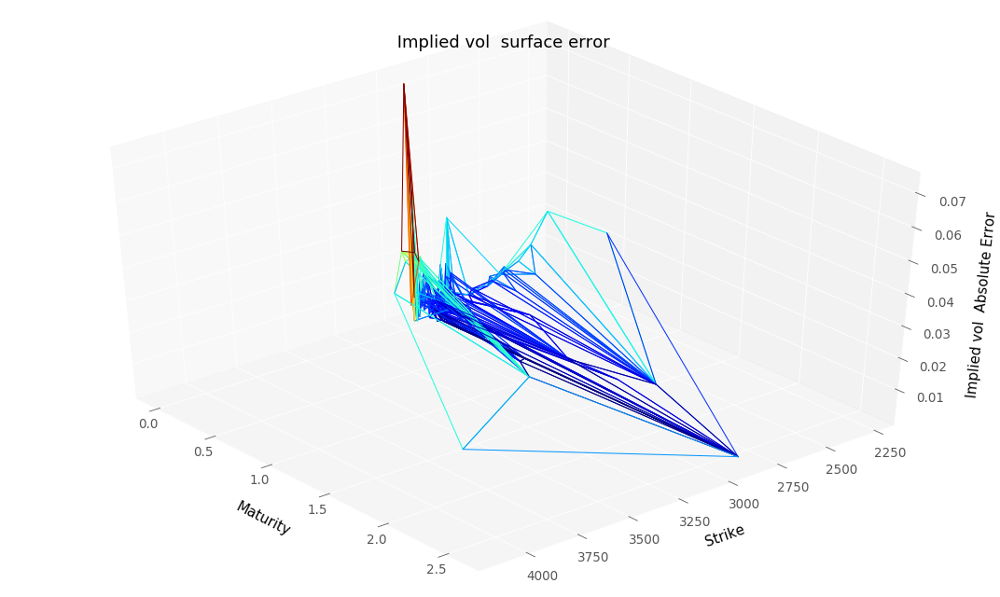

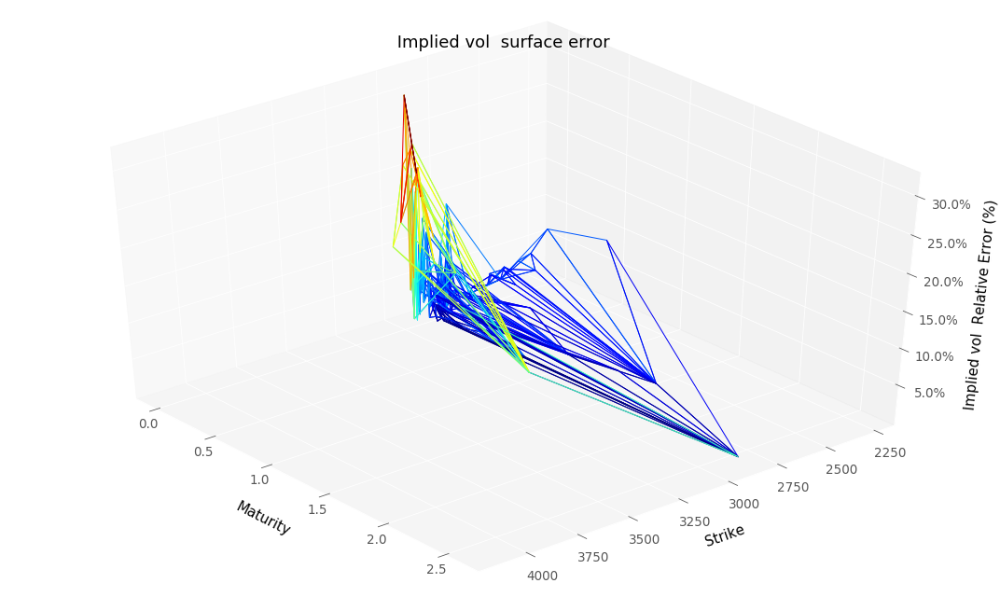

RMSE :  0.013212910846676869
RMSE Relative:  0.09226703832513344


In [25]:
keptPrices = dataSet["Price"][dataSet["Price"] >= 0.0].index
plotTools.predictionDiagnosis(plotTools.selectIndex(serieTrain, keptPrices) , 
                              plotTools.selectIndex(dataSet["ImpliedVol"], keptPrices) , 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

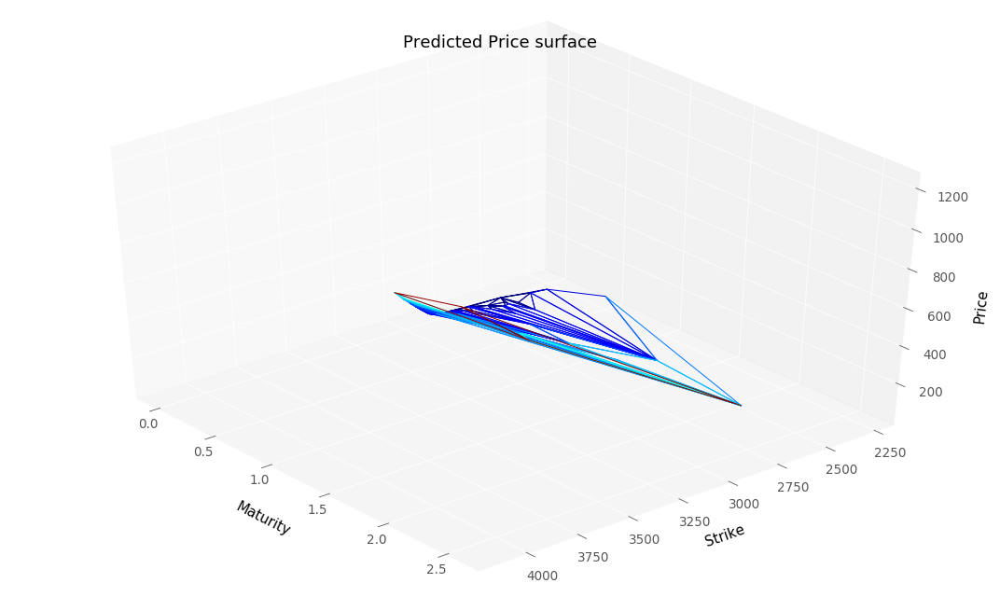

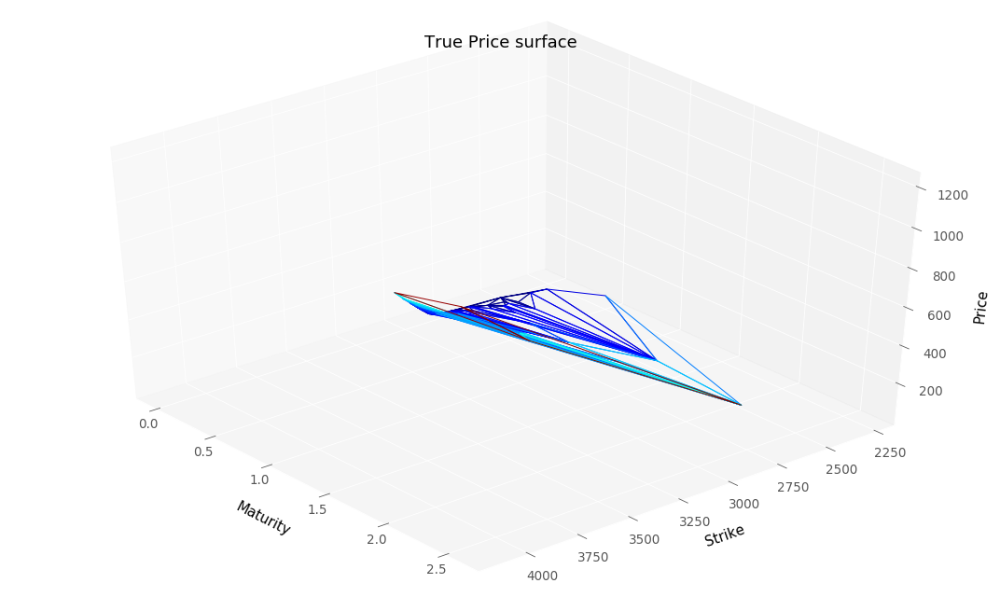

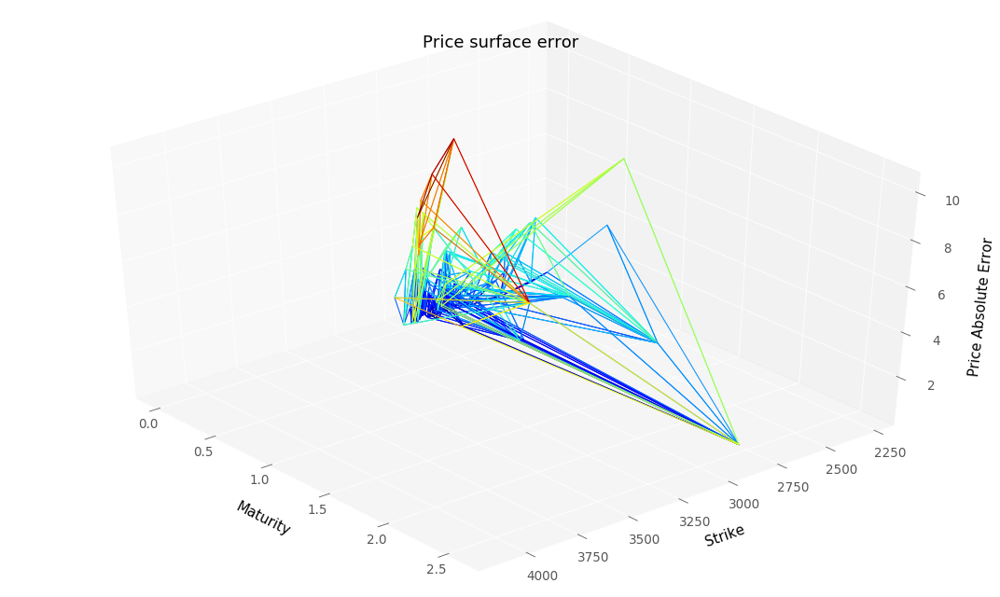

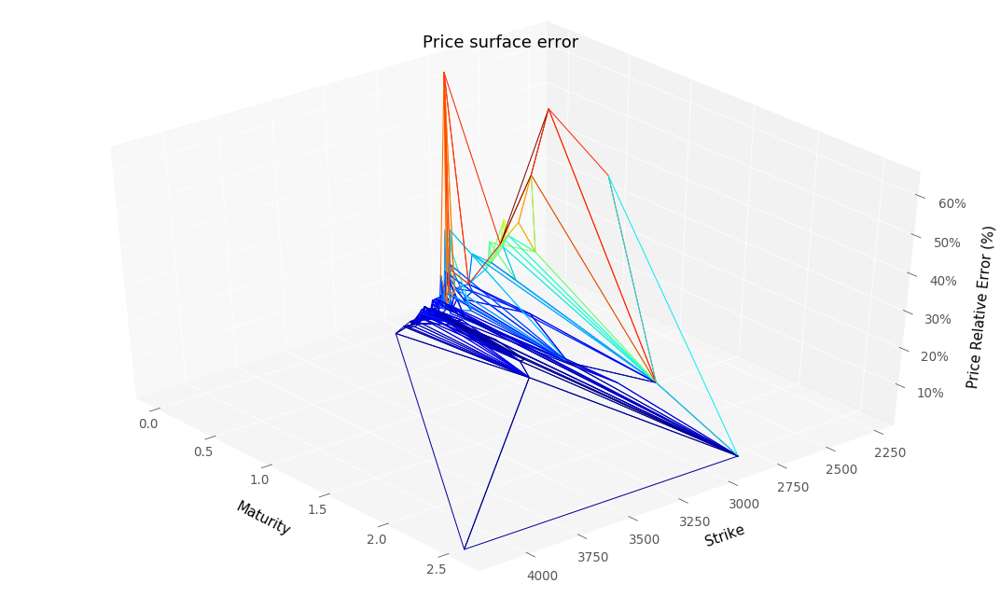

RMSE :  2.552037551262694
RMSE Relative:  0.10680990852402229


In [26]:
impPriceTraining = plotTools.plotImpliedVolPrices(np.square(serieTrain)*serieTrain.index.get_level_values("Maturity"),
                                                  bootstrap, 
                                                  S0, 
                                                  dataSet,
                                                  yMin = KMin,
                                                  yMax = KMax, 
                                                  thresholdPrice = None)

In [27]:
ImpVolPutTrainingSSVI = BS.vectorizedImpliedVolatilityCalibration(S0, bootstrap, 
                                                                 dataSet["Maturity"], 
                                                                 dataSet["Strike"], 
                                                                 dataSet["OptionType"], 
                                                                 impPriceTraining,
                                                                 removeNaN = False)
ImpVolPutTrainingSSVI = pd.Series(ImpVolPutTrainingSSVI, index = dataSet.index).sort_index()

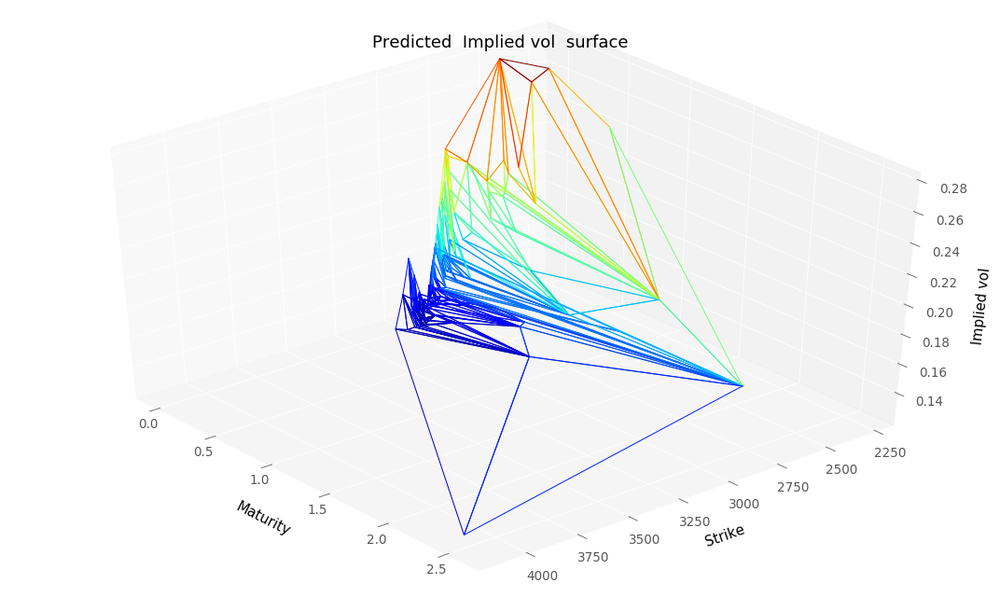

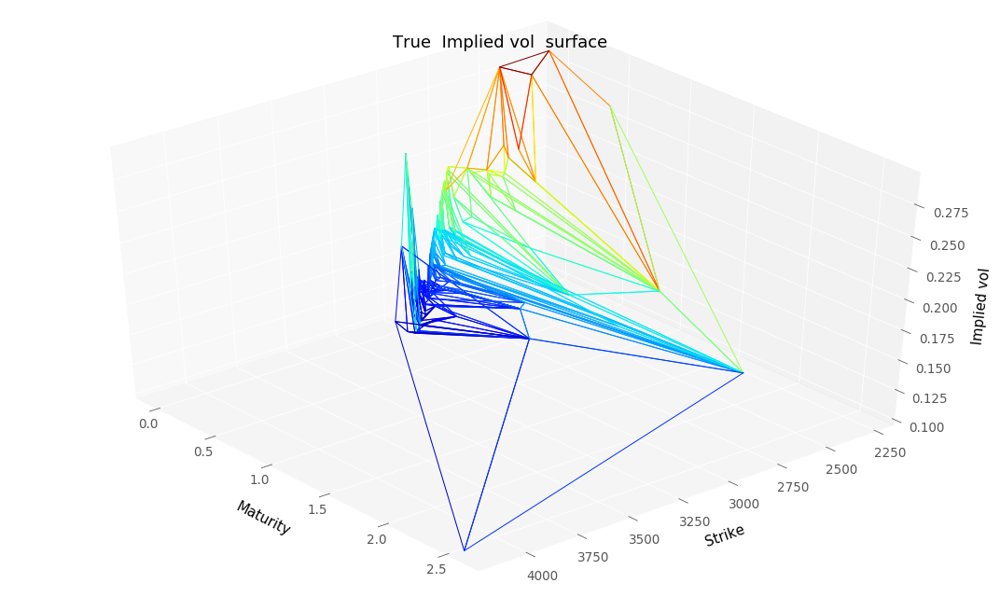

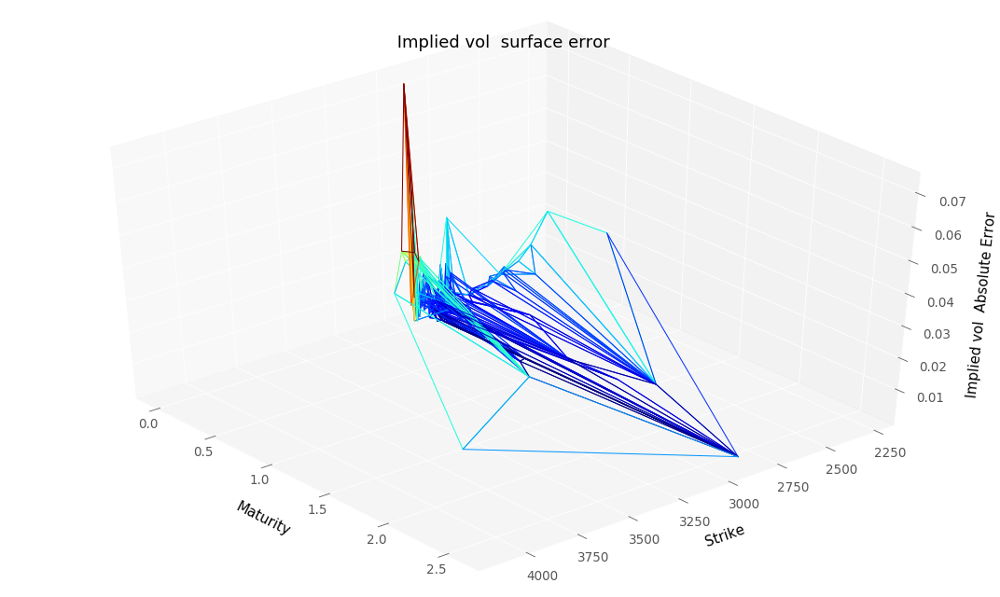

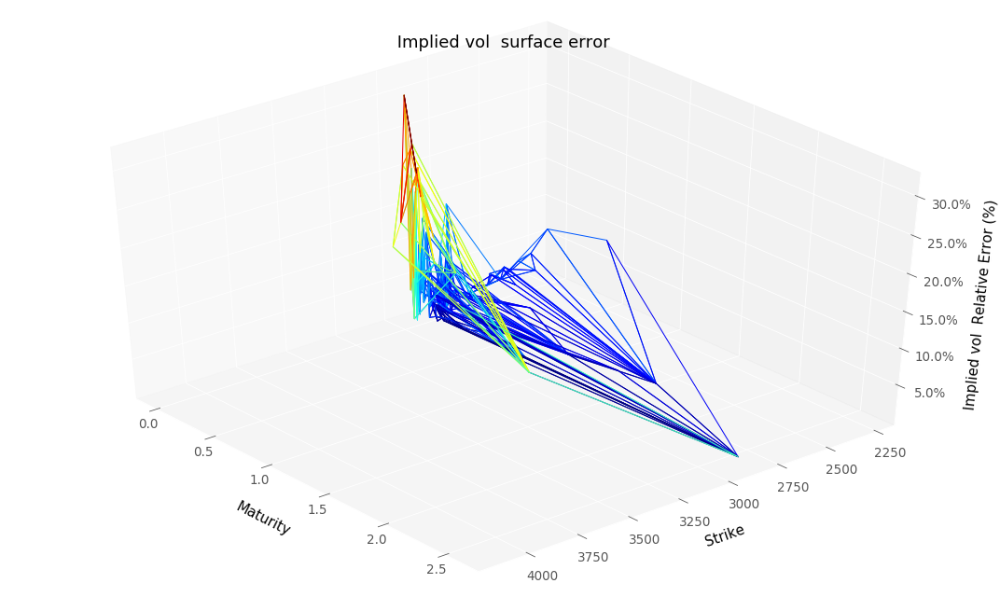

RMSE :  0.013212910803919248
RMSE Relative:  0.0922670382236173


In [28]:
keptPrices = dataSet["Price"][dataSet["Price"] >= 0.0].index
plotTools.predictionDiagnosis(plotTools.selectIndex(ImpVolPutTrainingSSVI, keptPrices) , 
                              plotTools.selectIndex(dataSet["ImpliedVol"], keptPrices) , 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

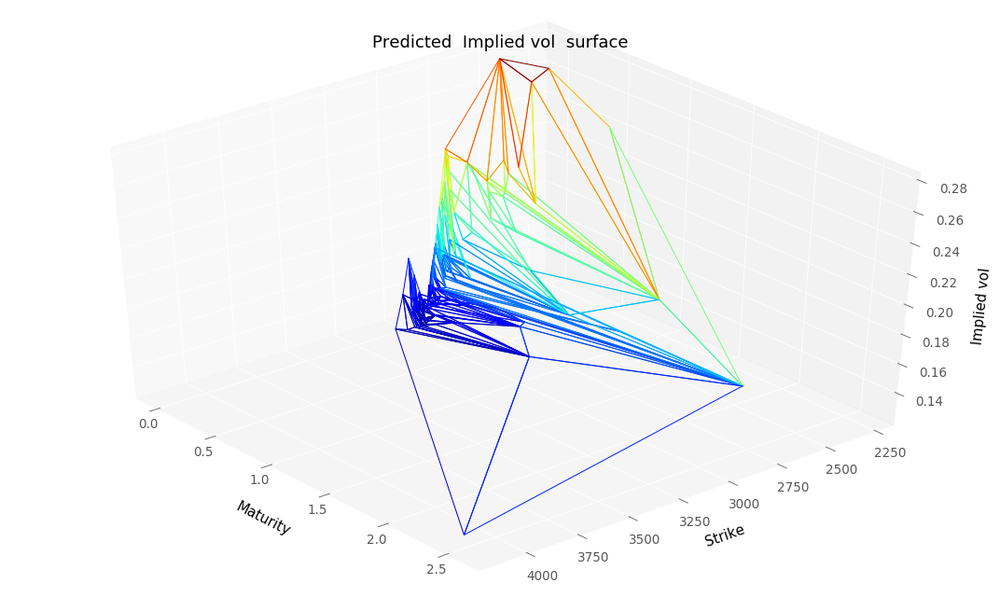

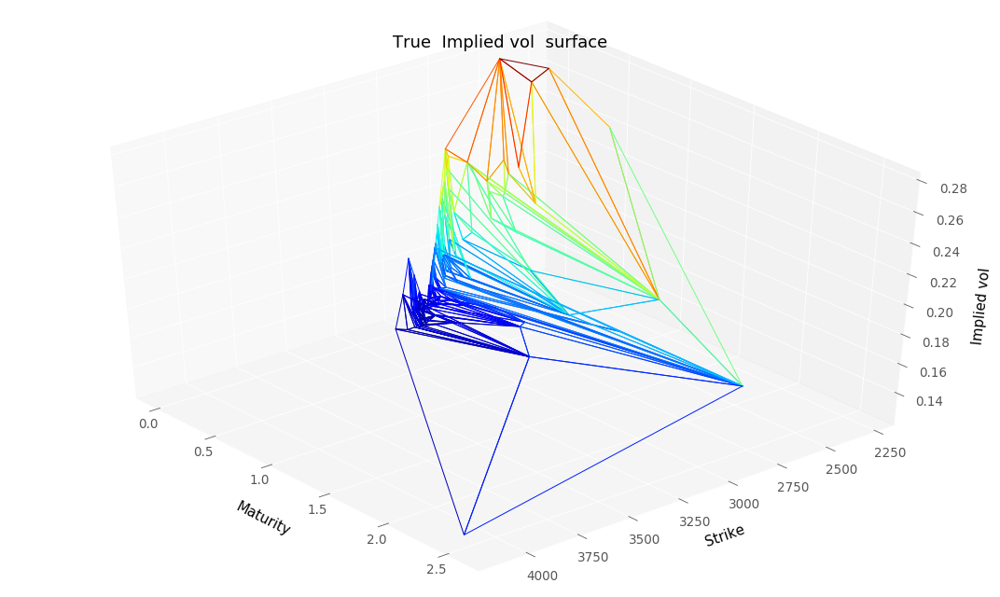

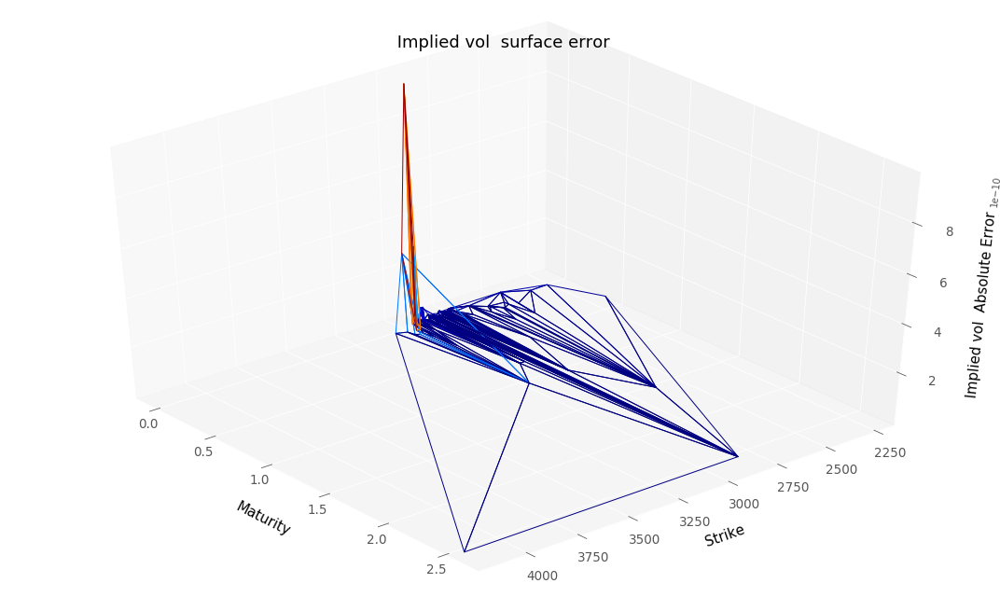

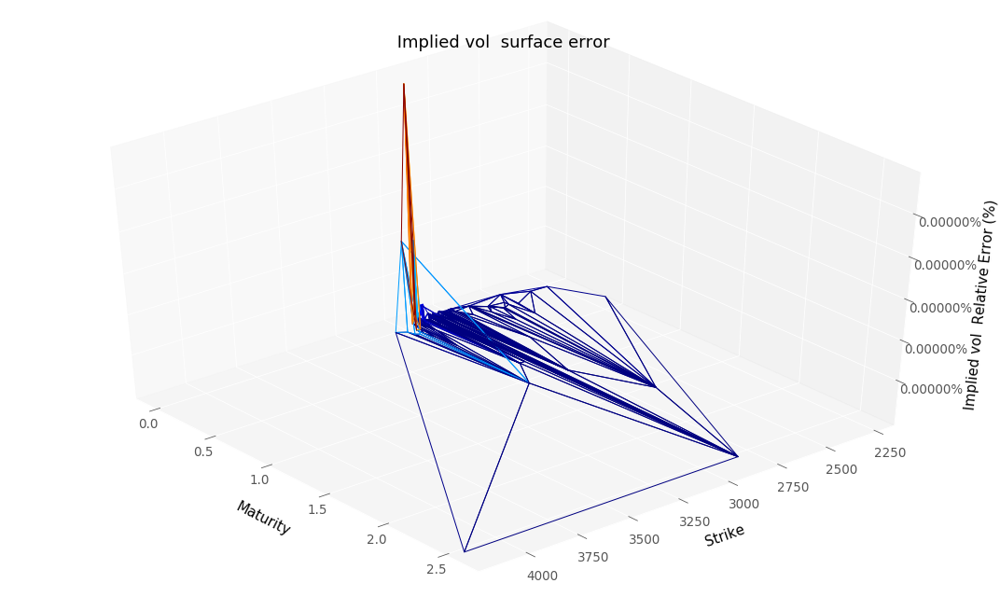

RMSE :  9.280227460361887e-11
RMSE Relative:  5.70544349706989e-10


In [29]:
keptPrices = dataSet["Price"][dataSet["Price"] >= 0.0].index
plotTools.predictionDiagnosis(plotTools.selectIndex(ImpVolPutTrainingSSVI, keptPrices), 
                              plotTools.selectIndex(serieTrain, keptPrices), 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

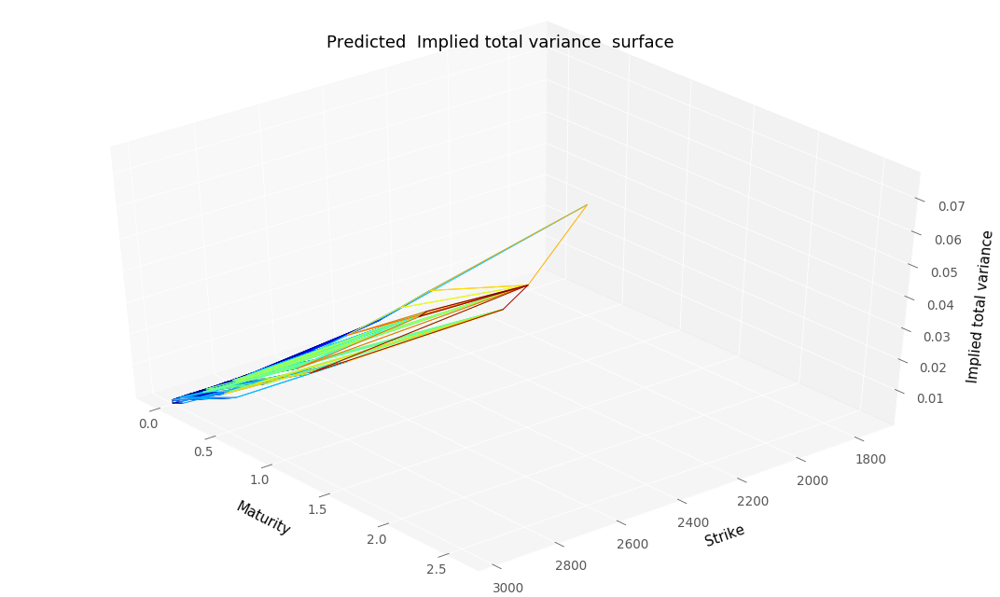

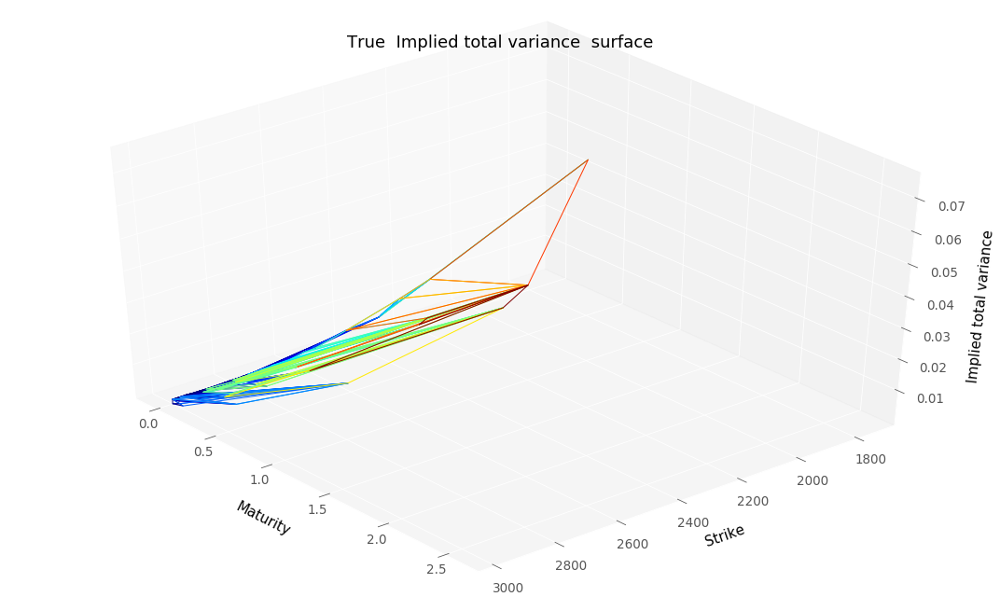

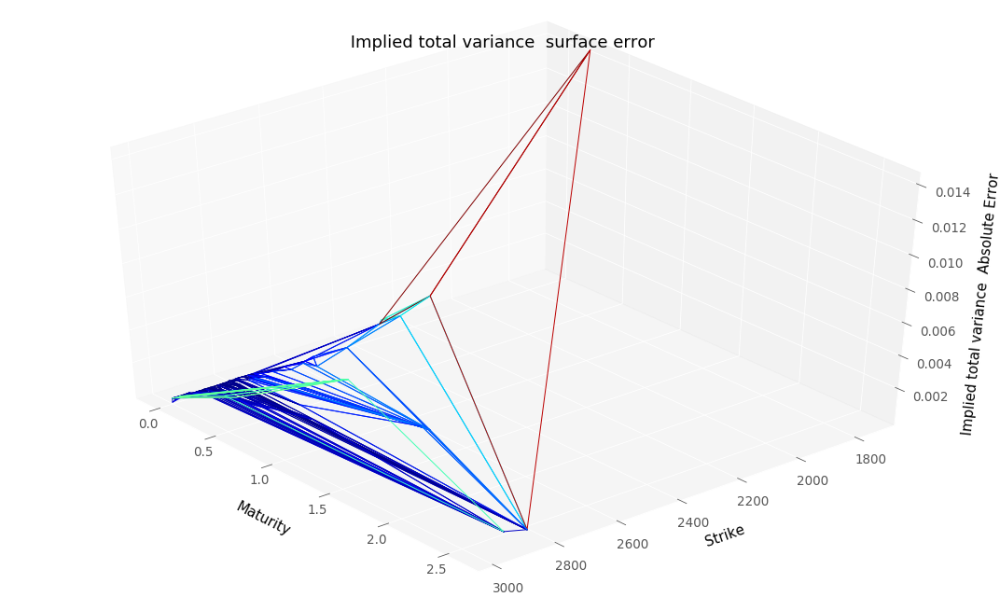

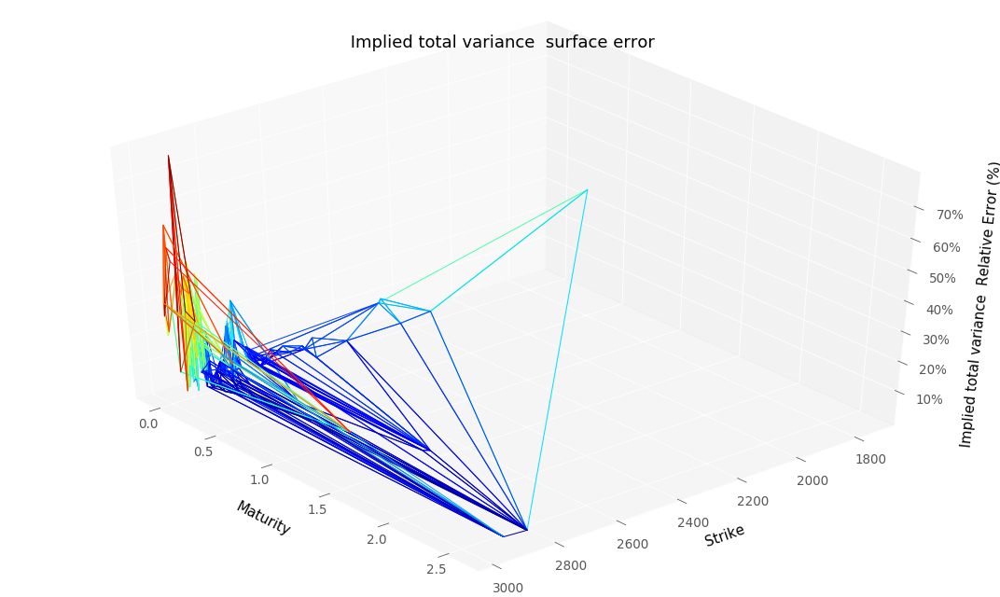

RMSE :  0.0014635842002266191
RMSE Relative:  0.1922169523022949


In [30]:
plotTools.predictionDiagnosis(SSVI.impliedVariance(serie), 
                              SSVI.impliedVariance(dataSetTest["ImpliedVol"]), 
                              " Implied total variance ", 
                              yMin=KMin, 
                              yMax=KMax)

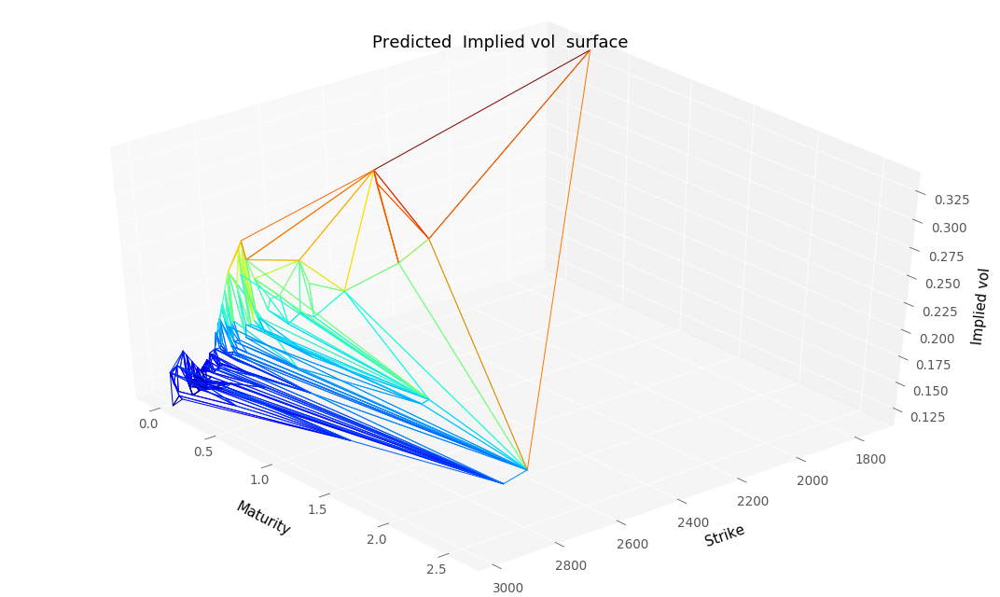

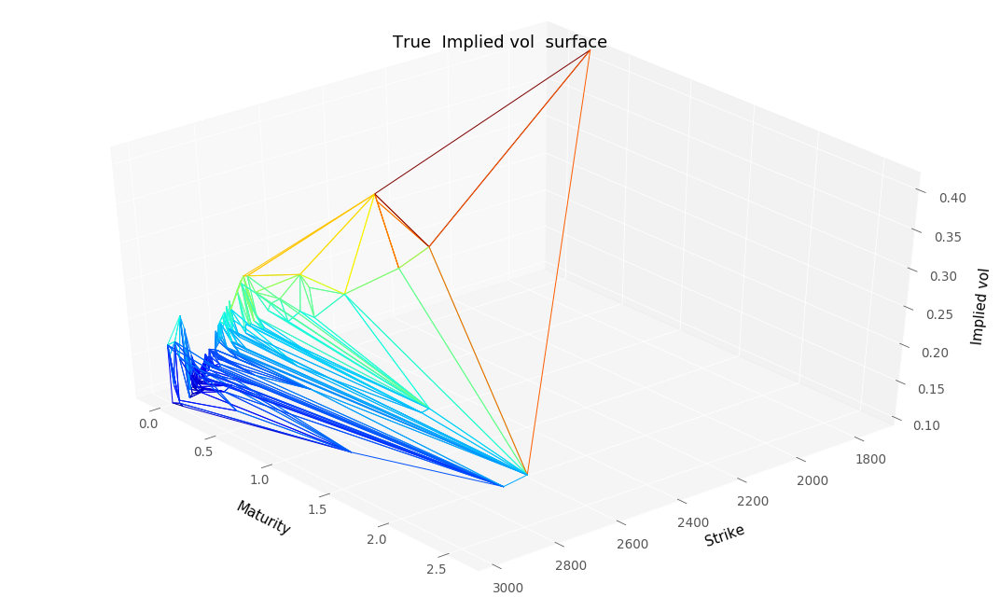

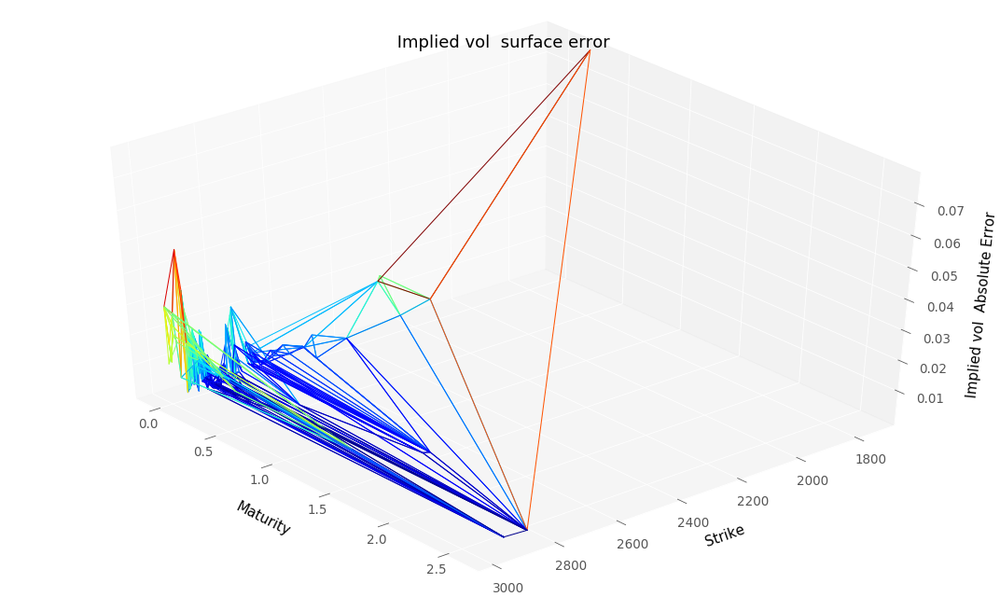

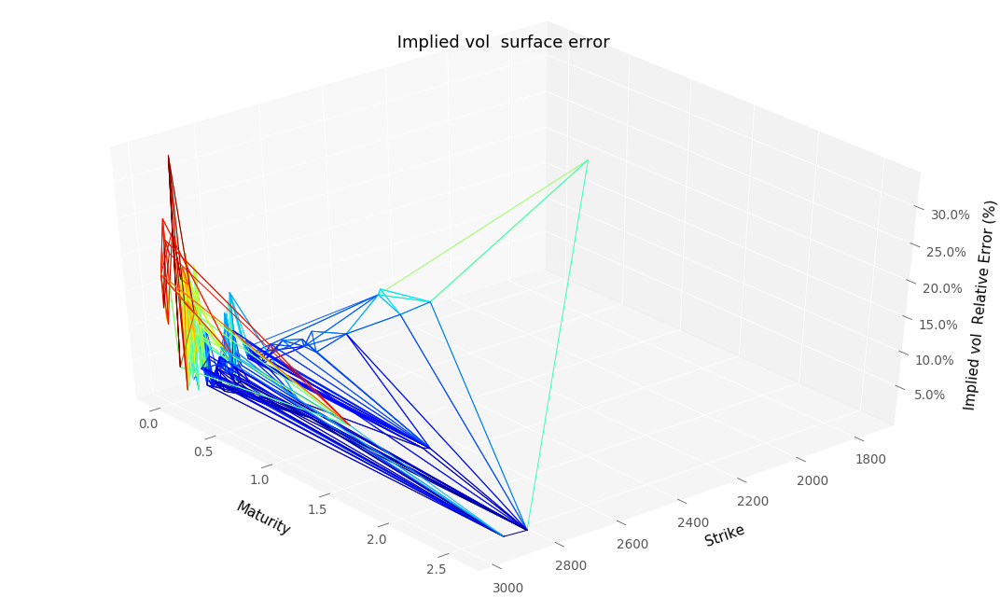

RMSE :  0.013998141592628709
RMSE Relative:  0.09156927886238117


In [31]:
keptPrices = dataSetTest["Price"][dataSetTest["Price"] >= 0.0].index
plotTools.predictionDiagnosis(plotTools.selectIndex(serie, keptPrices), 
                              plotTools.selectIndex(dataSetTest["ImpliedVol"], keptPrices), 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

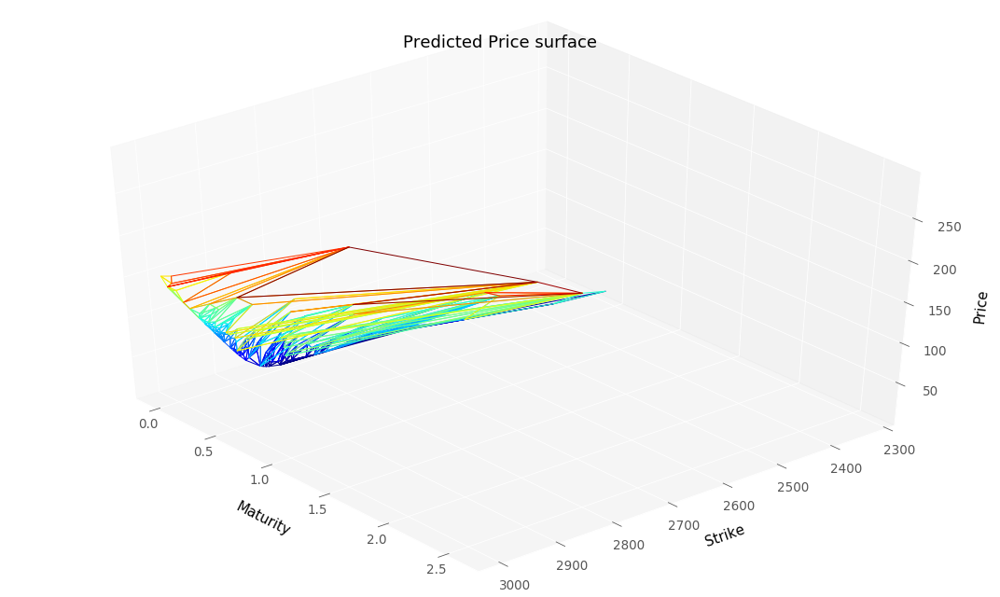

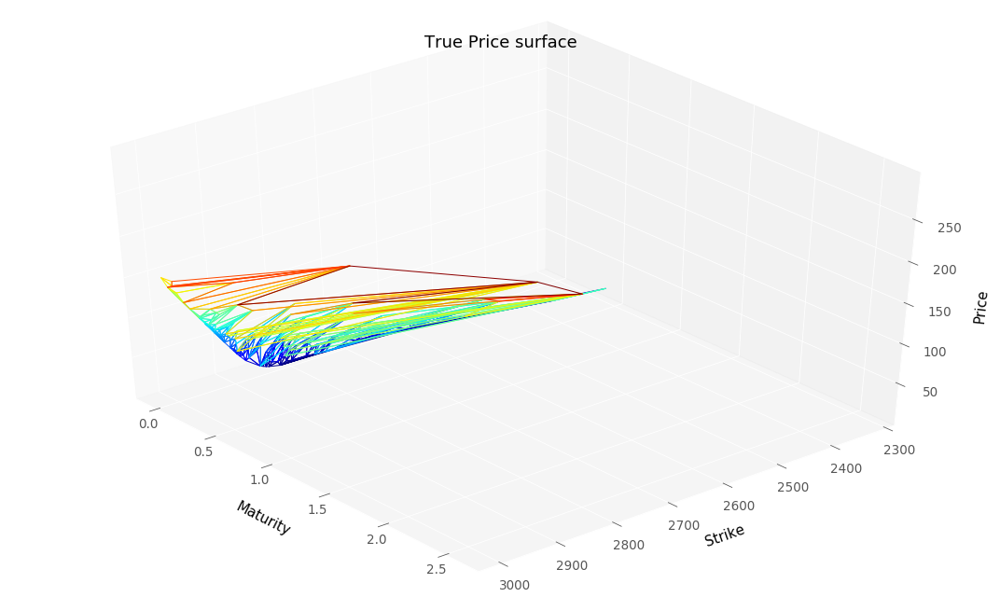

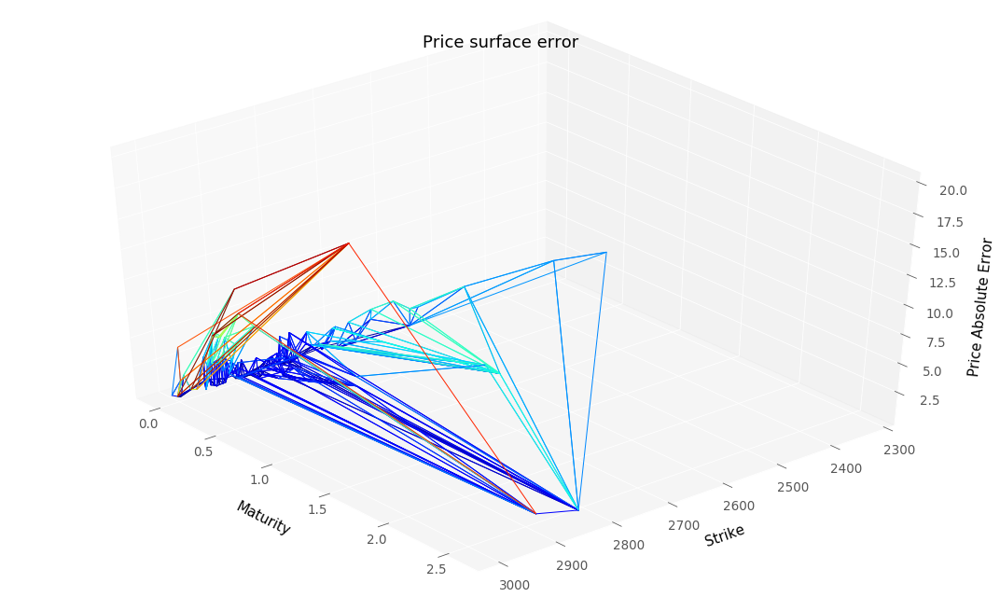

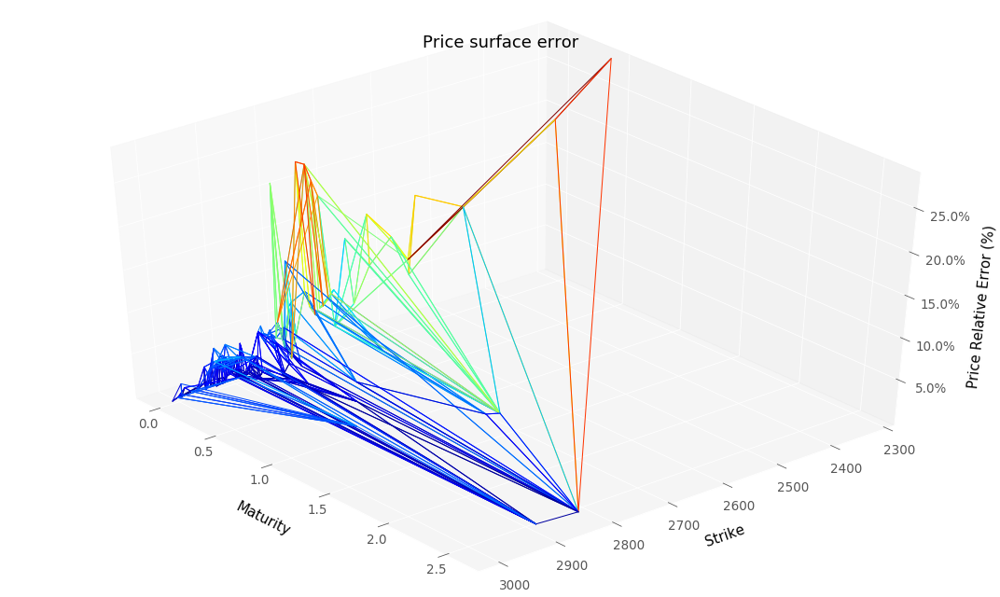

RMSE :  3.13786606037659
RMSE Relative:  0.07163142716810973


In [32]:
impPriceTesting = plotTools.plotImpliedVolPrices(np.square(serie)*serie.index.get_level_values("Maturity"), 
                                                 bootstrap, 
                                                 S0, 
                                                 dataSetTest,
                                                 yMin = KMin,
                                                 yMax = KMax, 
                                                 thresholdPrice = threshold)

In [33]:
ImpVolPutTestingSSVI = BS.vectorizedImpliedVolatilityCalibration(S0, bootstrap, 
                                                                 dataSetTest["Maturity"], 
                                                                 dataSetTest["Strike"], 
                                                                 dataSetTest["OptionType"], 
                                                                 impPriceTesting,
                                                                 removeNaN = False)
ImpVolPutTestingSSVI = pd.Series(ImpVolPutTestingSSVI, index = dataSetTest.index).sort_index()

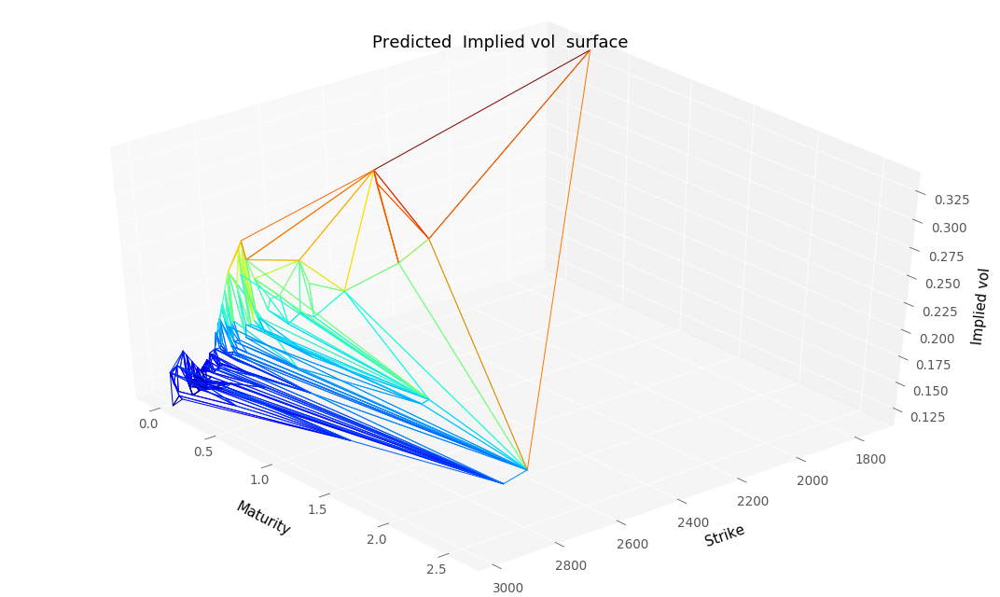

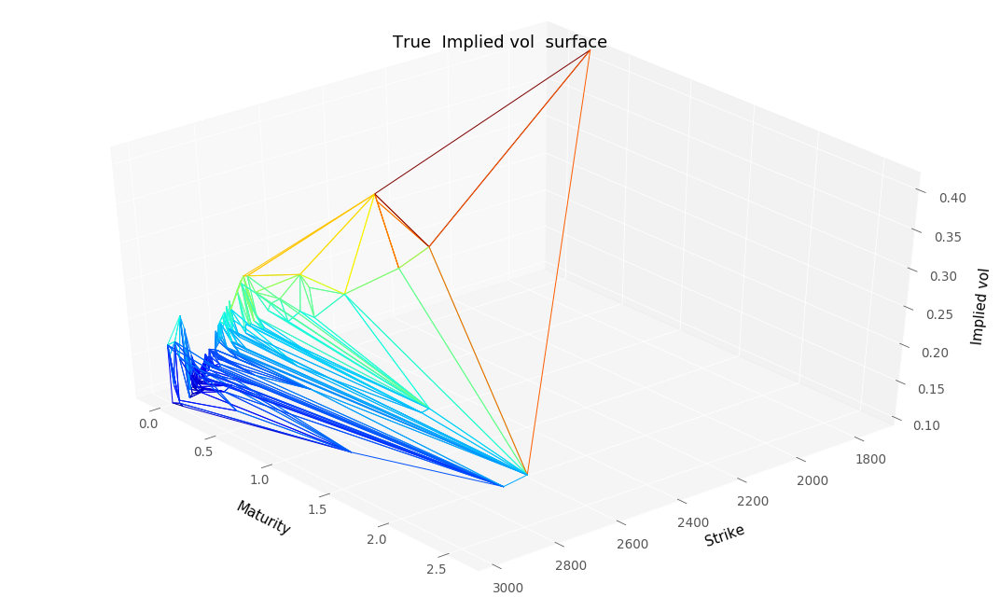

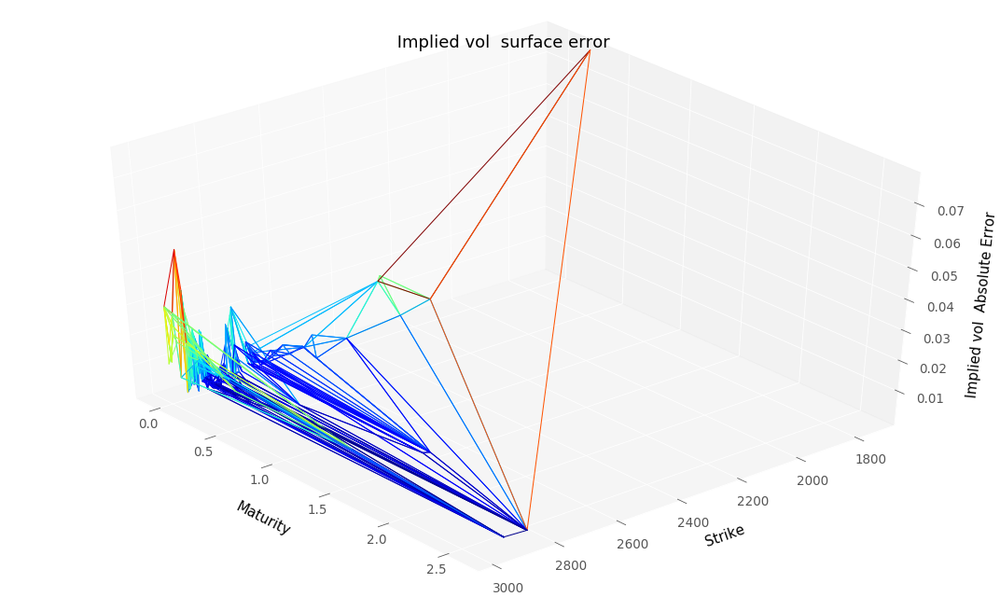

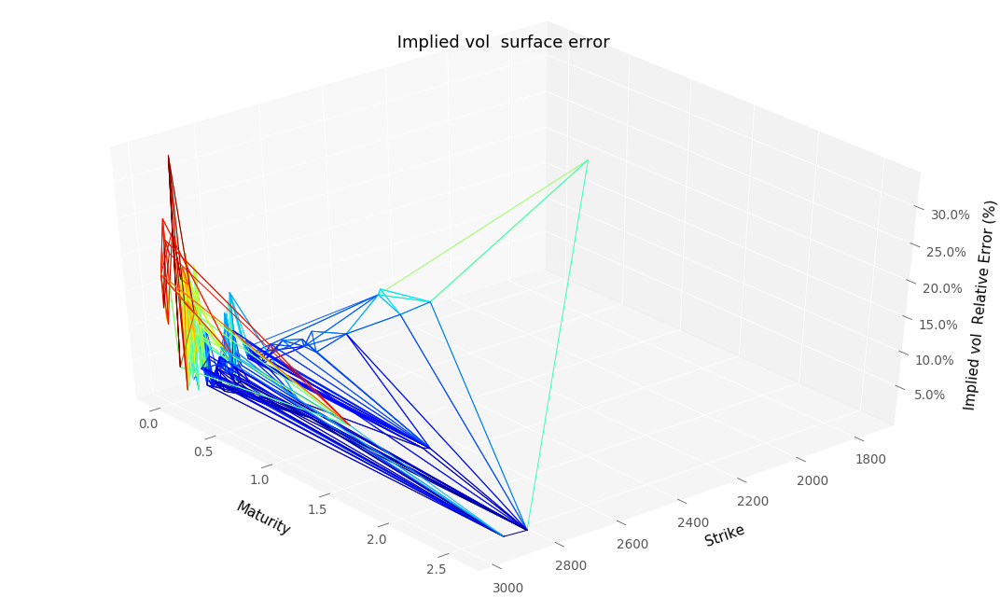

RMSE :  0.01399814159465743
RMSE Relative:  0.09156927887074597


In [34]:
keptPrices = dataSetTest["Price"][dataSetTest["Price"] >= 0.0].index
plotTools.predictionDiagnosis(plotTools.selectIndex(ImpVolPutTestingSSVI, keptPrices), 
                              plotTools.selectIndex(dataSetTest["ImpliedVol"], keptPrices), 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

#### Estimate Local Volaitlity from SSVI

In [35]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dTTrain, hkTrain, dKTrain, locVolSSVITrain, densityTrain = SSVI.finiteDifferenceSVI(dataSet, SSVIModel.eval)

Number of arbitrage violations :  0
Arbitrable volatility :  Series([], Name: ImpliedVol, dtype: float64)
Interpolated Arbitrable volatility :  Series([], dtype: float64)


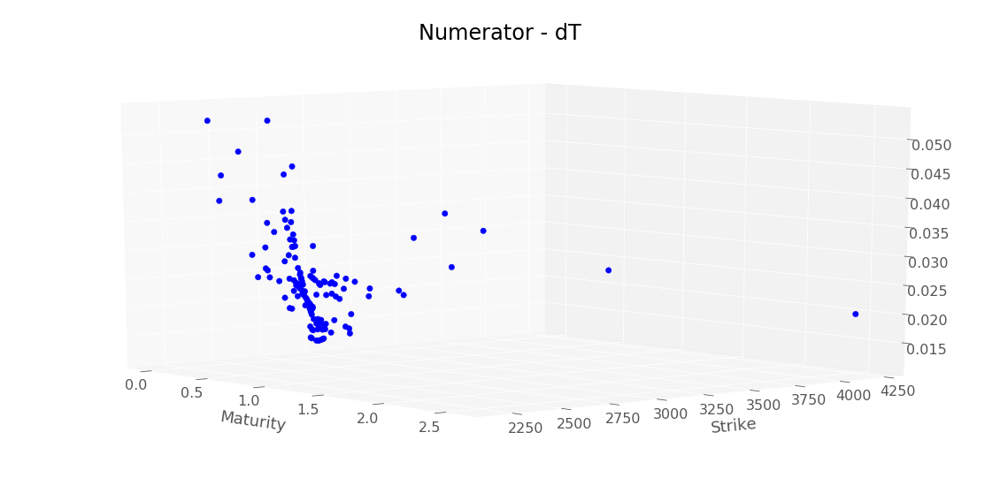

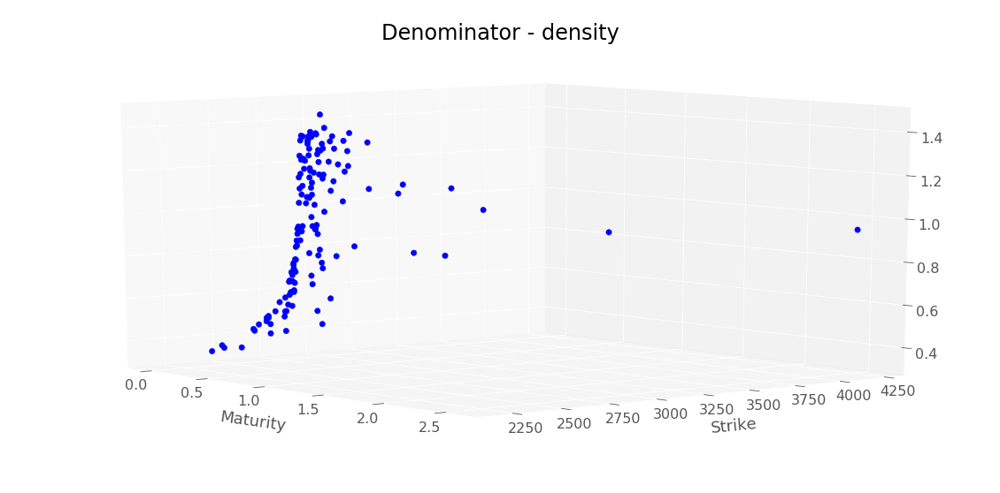

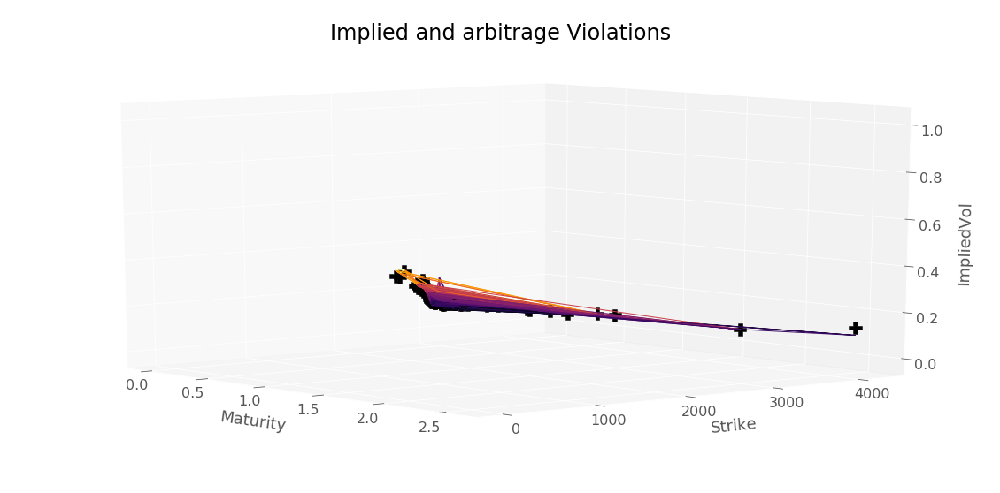

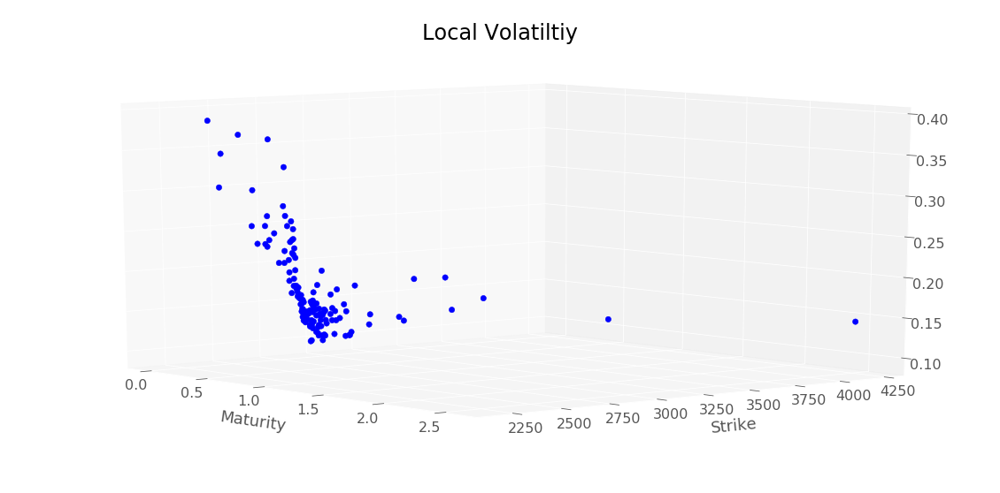

In [36]:
plotTools.diagnoseLocalVol(dTTrain,
                           locVolSSVITrain,
                           densityTrain,
                           SSVIModel.eval(dataSet),
                           dataSet,
                           az=320,
                           yMin=KMin,
                           yMax=KMax)

In [37]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dT, hk, dK, locVolSSVI, density = SSVI.finiteDifferenceSVI(dataSetTest, SSVIModel.eval)

Number of arbitrage violations :  0
Arbitrable volatility :  Series([], Name: ImpliedVol, dtype: float64)
Interpolated Arbitrable volatility :  Series([], dtype: float64)


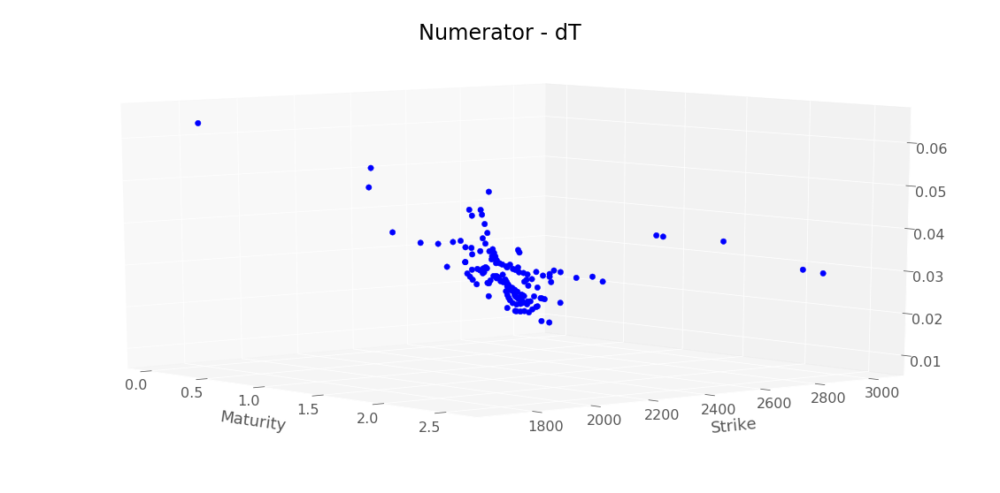

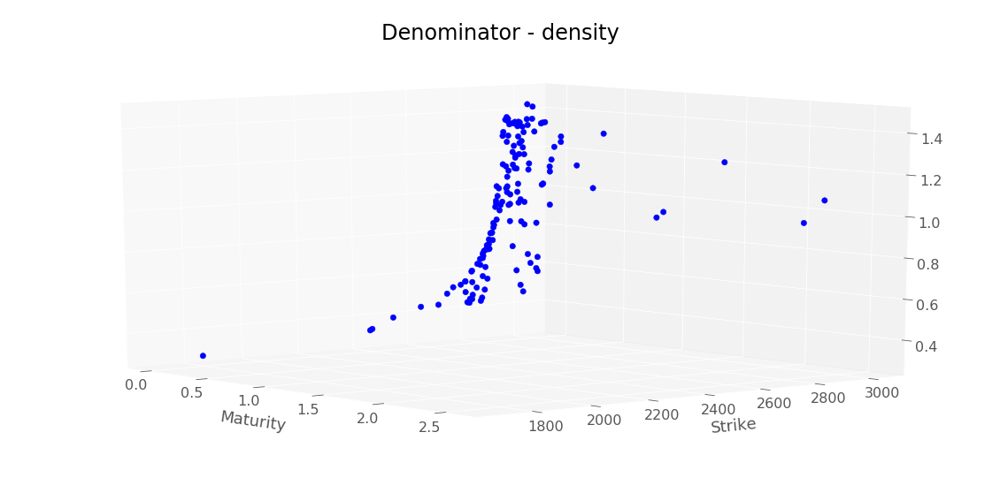

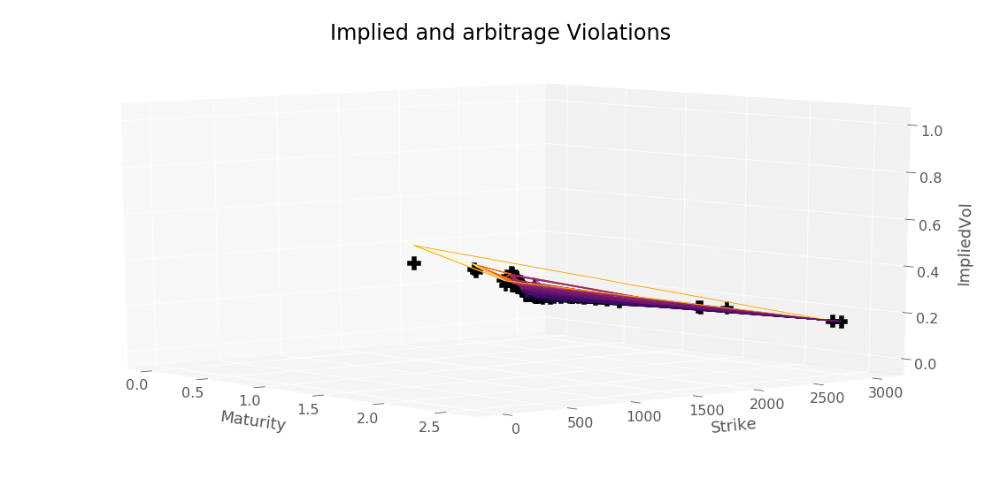

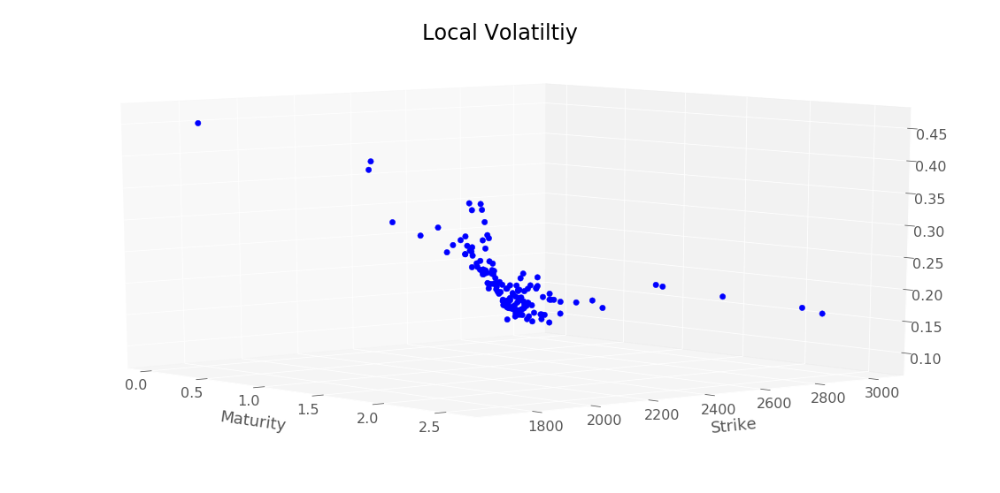

In [38]:
plotTools.diagnoseLocalVol(dT,
                           locVolSSVI,
                           density,
                           SSVIModel.eval(dataSetTest),
                           dataSetTest,
                           az=320,
                           yMin=KMin,
                           yMax=KMax)

In [39]:
plotTools.saveDataModel(plotTools.removeDuplicateIndex(impPriceTraining), 
                        plotTools.removeDuplicateIndex(locVolSSVITrain), 
                        plotTools.removeDuplicateIndex(serieTrain) , 
                        "./Results/SSVITraining") 

In [40]:
plotTools.saveDataModel(plotTools.removeDuplicateIndex(impPriceTesting), 
                        plotTools.removeDuplicateIndex(locVolSSVI), 
                        plotTools.removeDuplicateIndex(serie) , 
                        "./Results/SSVITesting") 

In [41]:
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)
volLocaleGridDf = pd.DataFrame(np.vstack((np.ravel(volLocaleGrid[0]), np.ravel(volLocaleGrid[1]))).T, 
                               columns = ["Strike", "Maturity"]).set_index(["Strike","Maturity"],drop=False)
volLocaleGridDf["ChangedStrike"] = bootstrap.changeOfVariable(volLocaleGridDf["Strike"], volLocaleGridDf["Maturity"])[0]
volLocaleGridDf["logMoneyness"] = np.log(volLocaleGridDf["ChangedStrike"] / S0)
volLocaleGridDf["OptionType"] = np.ones_like(volLocaleGridDf["logMoneyness"])

In [42]:
dT, hk, dK, locVolSSVI, density = SSVI.finiteDifferenceSVI(volLocaleGridDf, SSVIModel.eval)

./code/SSVI.py:1105: RuntimeWarning: invalid value encountered in sqrt
  locVolGatheral = np.sqrt(dT / numerator)


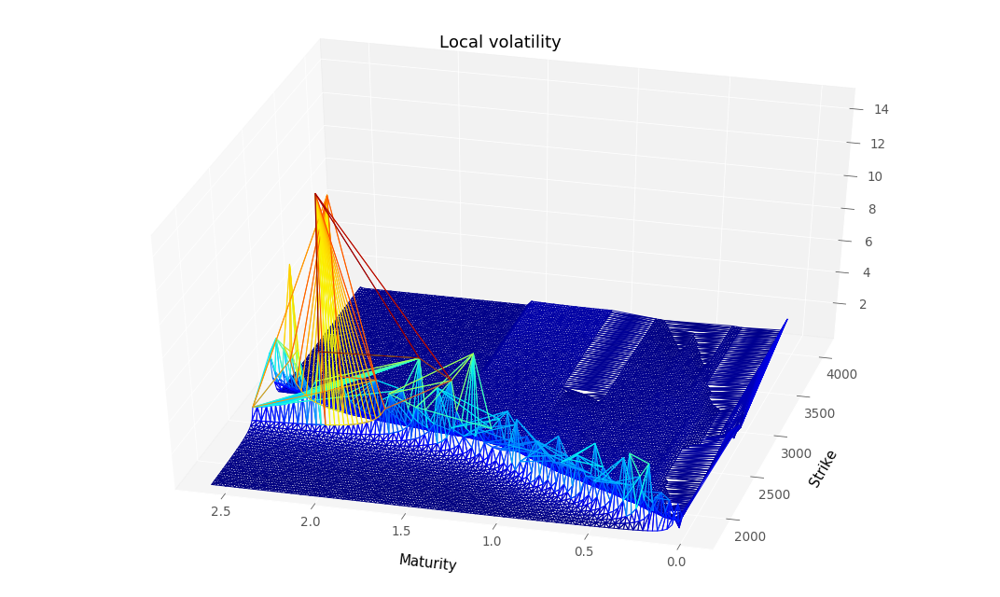

In [43]:
plotTools.plotSerie(locVolSSVI.dropna(),
                    yMin=KMin,
                    yMax=KMax, 
                    az=105,
                    Title = 'Local volatility')

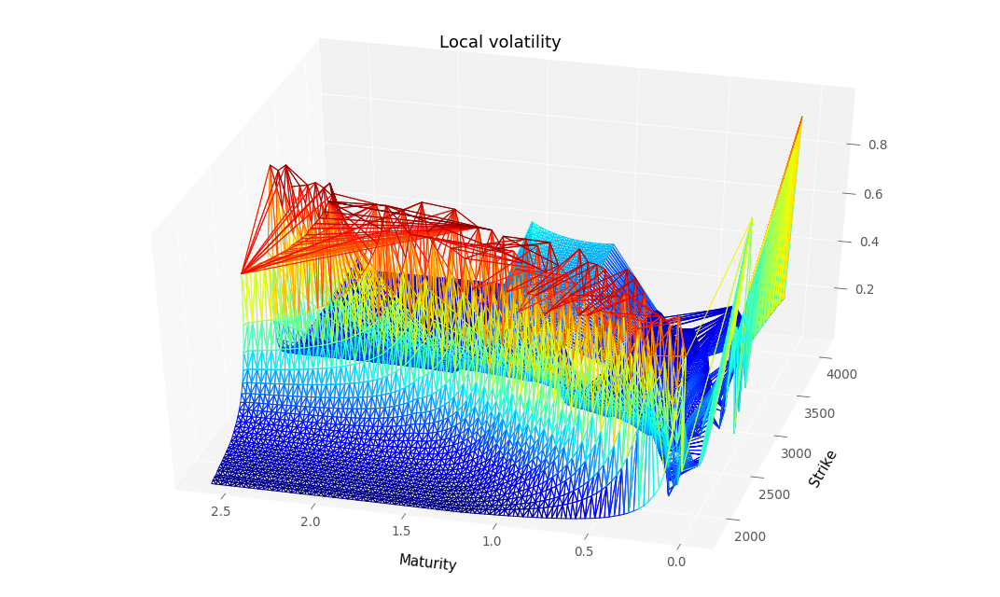

In [44]:
plotTools.plotSerie(locVolSSVI.dropna()[locVolSSVI.dropna() <= 1.0],
                    yMin=KMin,
                    yMax=KMax, 
                    az=105,
                    Title = 'Local volatility')

#### Backtest Local volatility SSVI 

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

In [45]:
nbTimeStep = 100
nbPaths = 100

In [46]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dT, hk, dK, locVolSSVI, density = SSVI.finiteDifferenceSVI(dataSetTest, SSVIModel.eval)
nnSSVI = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolSSVI, x, y)

In [47]:
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)
volLocaleGridDf = pd.DataFrame(np.vstack((np.ravel(volLocaleGrid[0]), np.ravel(volLocaleGrid[1]))).T, 
                               columns = ["Strike", "Maturity"]).set_index(["Strike","Maturity"],drop=False)
volLocaleGridDf["ChangedStrike"] = bootstrap.changeOfVariable(volLocaleGridDf["Strike"], volLocaleGridDf["Maturity"])[0]
volLocaleGridDf["logMoneyness"] = np.log(volLocaleGridDf["ChangedStrike"] / S0)
volLocaleGridDf["OptionType"] = np.ones_like(volLocaleGridDf["logMoneyness"])

In [48]:
volLocaleGridDf.head()

,,Strike,Maturity,ChangedStrike,logMoneyness,OptionType
Strike,Maturity,,,,,
1700.000000,0.005,1700.000000,0.005,1698.937070,-0.520654,1.0
1725.252525,0.005,1725.252525,0.005,1724.173806,-0.505909,1.0
1750.505051,0.005,1750.505051,0.005,1749.410542,-0.491378,1.0
1775.757576,0.005,1775.757576,0.005,1774.647278,-0.477056,1.0
1801.010101,0.005,1801.010101,0.005,1799.884015,-0.462935,1.0


In [49]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dT2, hk2, dK2, locVolSSVI2, density2 = SSVI.finiteDifferenceSVI(volLocaleGridDf, SSVIModel.eval)
cleanValue = ~(dT2.isna() | density2.isna() | (dT2 < 0) | (density2 < 0) )
dT2 = dT2[cleanValue.values]
density2 = density2[cleanValue.values]
hk2 = hk2[cleanValue.values]
locVolSSVI2 = locVolSSVI2[cleanValue.values]
dK2 = dK2[cleanValue.values]

nnSSVI2 = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolSSVI2, x, y)

In [50]:
mcResSSVITest = backtest.MonteCarloPricerVectorized(S0,
                                                    dataSetTest,
                                                    bootstrap,
                                                    nbPaths,
                                                    nbTimeStep,
                                                    nnSSVI)
mcResSSVITest.head()

Price    stdPrice
Strike Maturity                       
1700.0 0.246      0.000000    0.000000
2300.0 0.419     20.429639   76.521153
2350.0 0.093      0.000000    0.000000
       0.112      1.291824   12.889273
2400.0 0.419     38.752842  149.903377

In [51]:
mcResSSVITest.to_csv(workingFolder + "mcResSSVITest.csv")

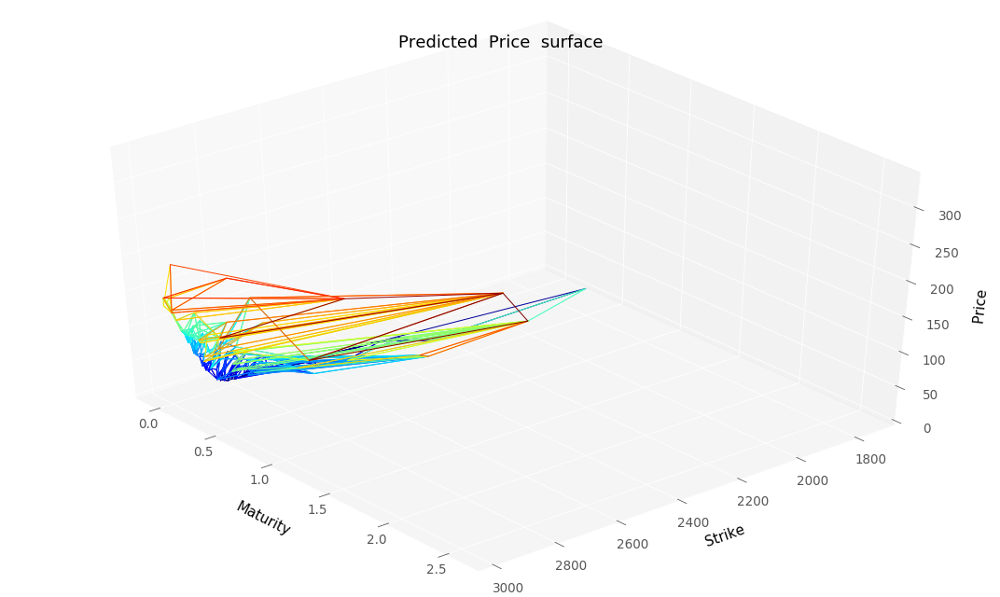

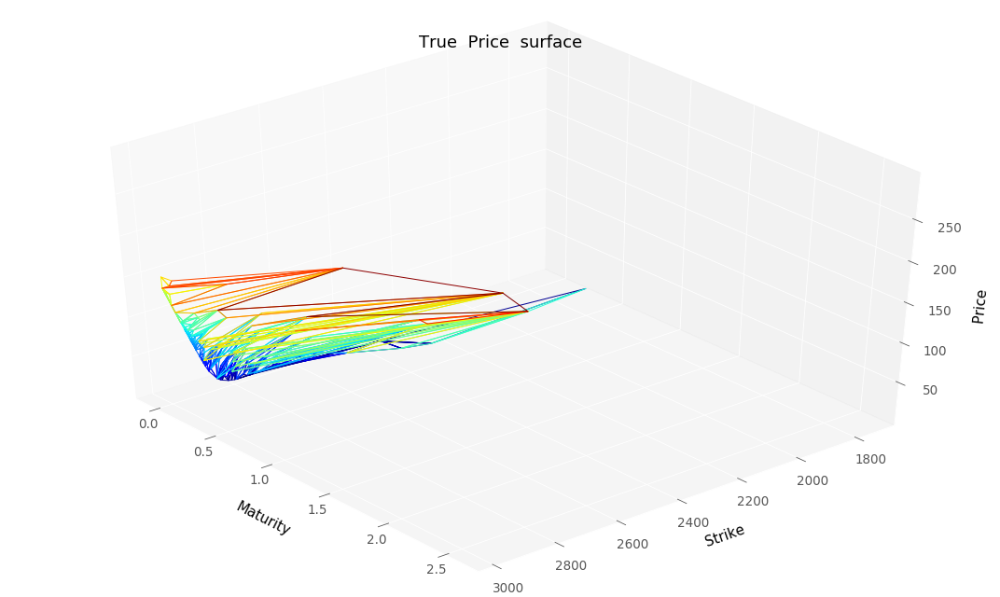

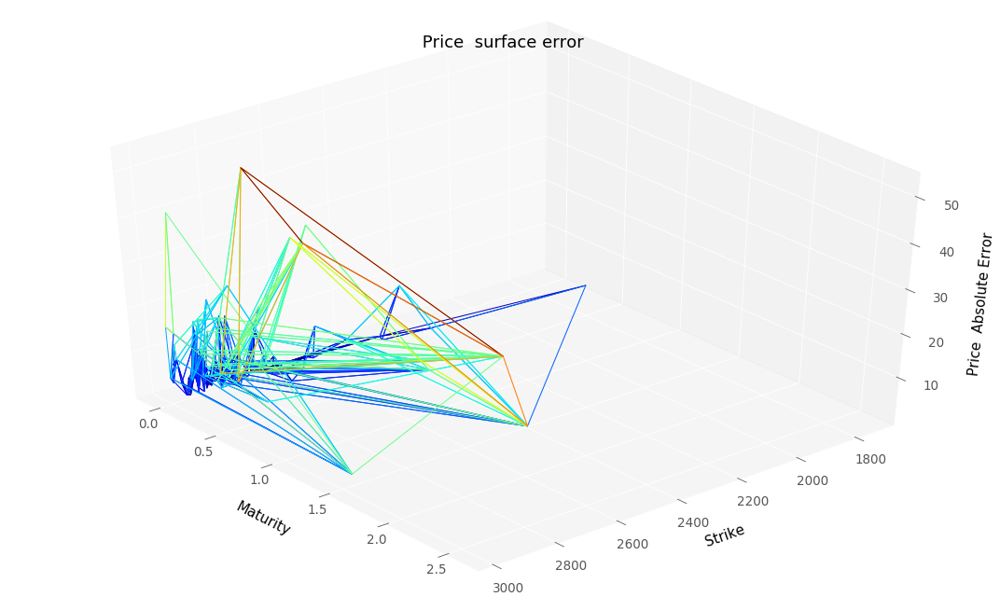

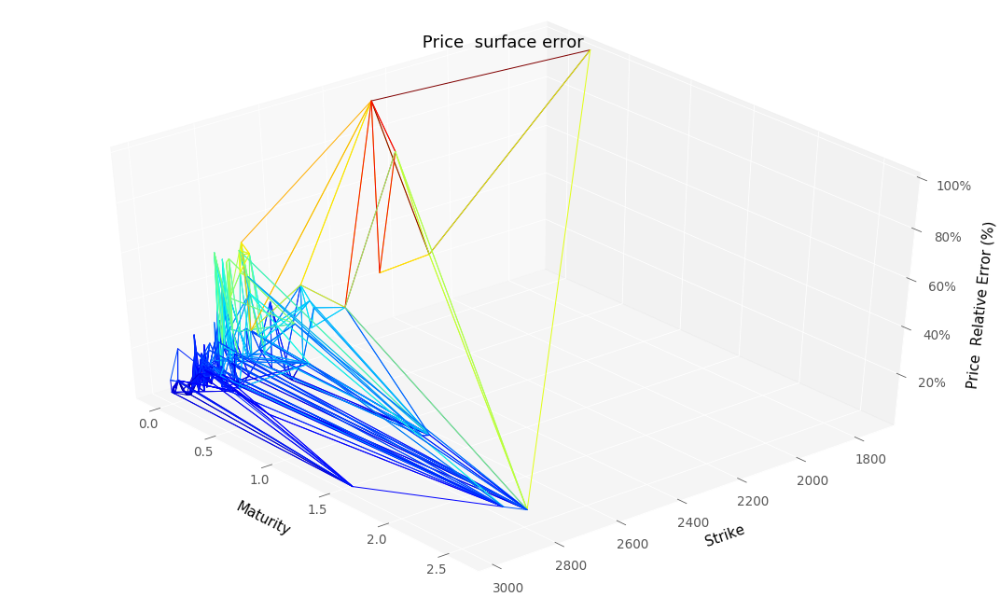

RMSE :  12.511250861913128
RMSE Relative:  0.25759777787761184


In [52]:
plotTools.predictionDiagnosis(mcResSSVITest["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [53]:
mcResSSVITest2 = backtest.MonteCarloPricerVectorized(S0,
                                                     dataSetTest,
                                                     bootstrap,
                                                     nbPaths,
                                                     nbTimeStep,
                                                     nnSSVI2)
mcResSSVITest2.head()

KeyboardInterrupt: 

In [ ]:
plotTools.predictionDiagnosis(mcResSSVITest2["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
mcResSSVITest2.to_csv(workingFolder + "mcResSSVITest2.csv")

plotTools.plotSerie(testingDataSetSSVI[testingDataSetSSVI.index.get_level_values("Maturity") > 0.01],
                    Title = 'SSVI Local Volatility Surface',
                    az=30,
                    yMin=0.0*S0,
                    yMax=2.0*S0, 
                    zAsPercent=True)

In [ ]:
pdeResSigmaSSVITest = backtest.PDEPricerVectorized(dataSetTest, S0, nnSSVI, bootstrap)
pdeResSigmaSSVITest.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResSigmaSSVITest, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResSigmaSSVITest.to_csv(workingFolder + "pdeResSigmaSSVITest.csv")

In [ ]:
pdeResSigmaSSVITest2 = backtest.PDEPricerVectorized(dataSetTest, S0, nnSSVI2, bootstrap)
pdeResSigmaSSVITest2.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResSigmaSSVITest2, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResSigmaSSVITest2.to_csv(workingFolder + "pdeResSigmaSSVITest2.csv")

## Trinomial Tree (Tikhonov)

### MC backtest 

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

For the tikhonov case we only use one grid which contains the node of the trinomial tree used for the calibration algorithm. See CREPEY, Stéphane. Calibration of the local volatility in a trinomial tree using Tikhonov regularization. Inverse Problems, 2002, vol. 19, no 1, p. 91.

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

#### Tikhonov calibration

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [122]:
nnVolLocaleTykhonov = lambda x,y : backtest.interpolatedMCLocalVolatility(localVolatility["LocalVolatility"], x, y)


In [123]:
s = testingDataSetAresky.index.get_level_values("Strike").values
t = testingDataSetAresky.index.get_level_values("Maturity").values

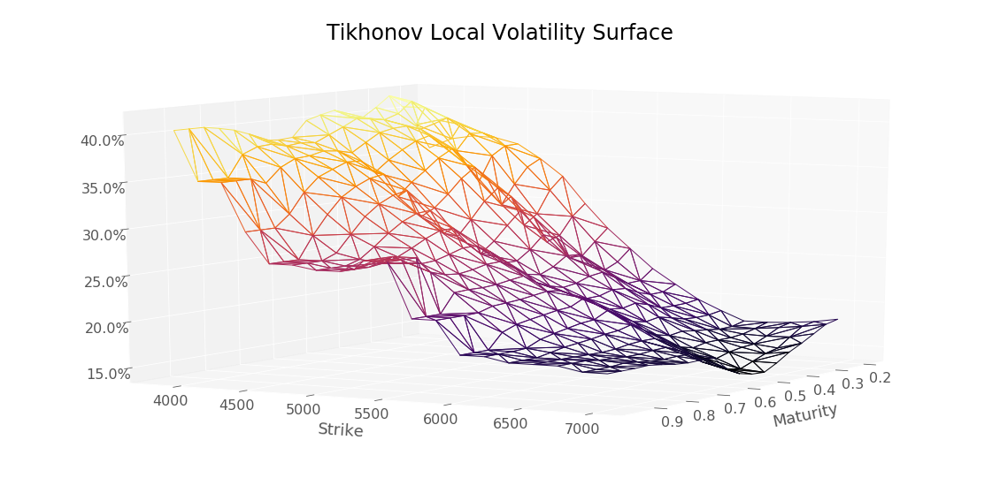

In [124]:
tikhonovLocVol = nnVolLocaleTykhonov(s, t)
plotTools.plotSerie(tikhonovLocVol[tikhonovLocVol.index.get_level_values("Maturity") > 0.01],
                    Title = 'Tikhonov Local Volatility Surface',
                    az=30,
                    yMin=0.0*S0,
                    yMax=2.0*S0, 
                    zAsPercent=True)

In [125]:
mcResTikhonovTest = backtest.MonteCarloPricerVectorized(S0,
                                                        dataSetTest,
                                                        bootstrap,
                                                        nbPaths,
                                                        nbTimeStep,
                                                        nnVolLocaleTykhonov)
mcResTikhonovTest.head()

Strike  Maturity
3858.6  0.200        0.568095
        0.242        8.990208
        0.284       10.218066
        0.326        9.116409
        0.368       15.431192
dtype: float64

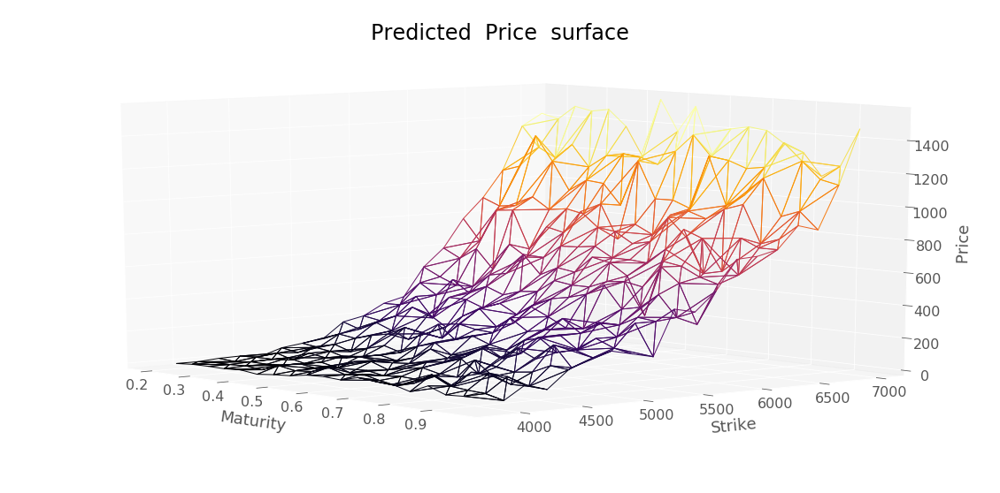

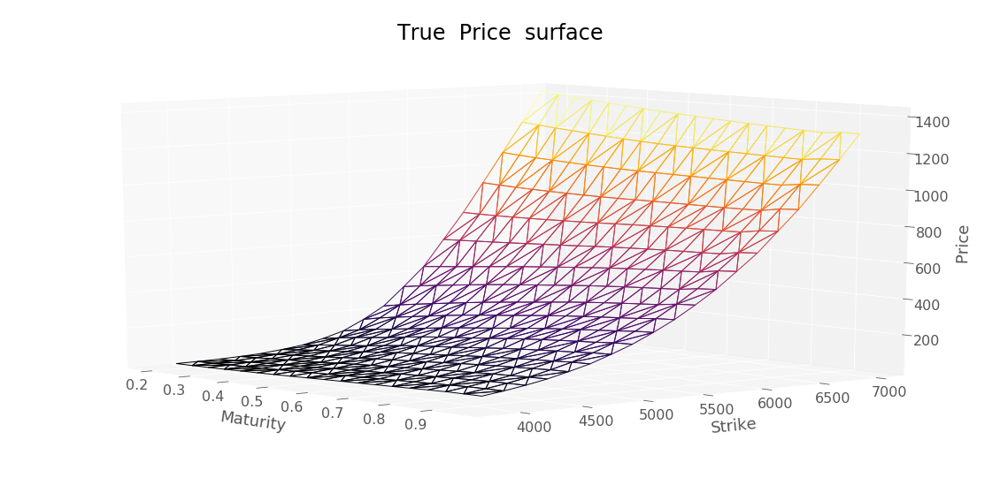

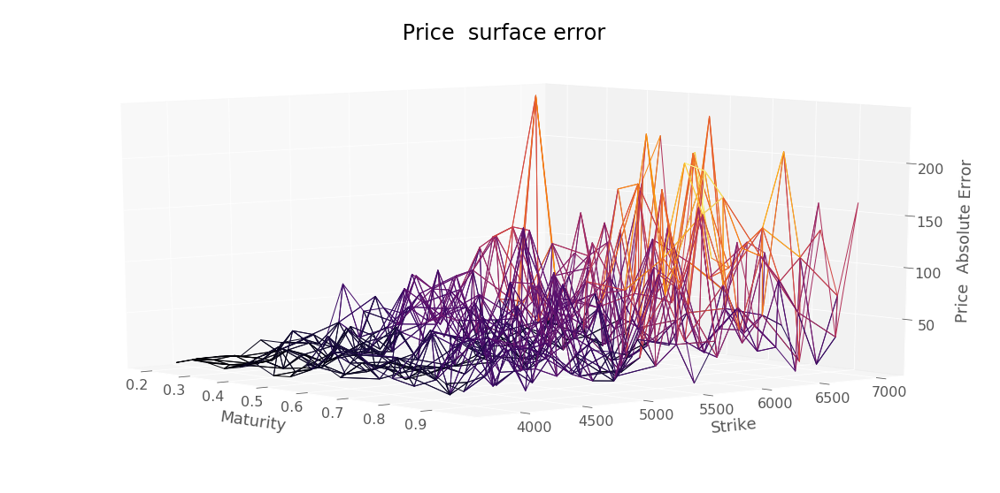

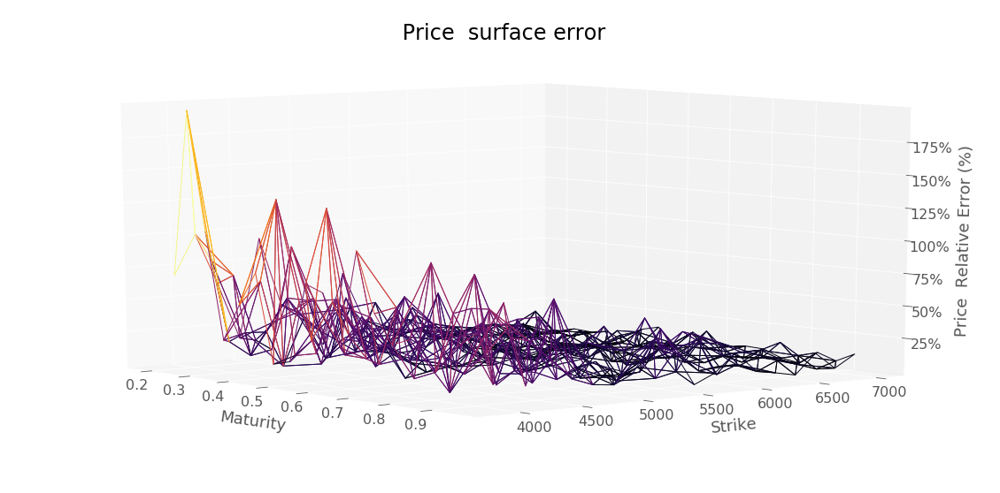

RMSE :  65.35494311648065


In [126]:
plotTools.predictionDiagnosis(mcResTikhonovTest, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [127]:
mcResTikhonovTest.to_csv(workingFolder + "mcResTikhonovTest.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


In [128]:
mcResTikhonovTrain = backtest.MonteCarloPricerVectorized(S0,
                                                         dataSet,
                                                         bootstrap,
                                                         nbPaths,
                                                         nbTimeStep,
                                                         nnVolLocaleTykhonov)
mcResTikhonovTrain.head()

Strike  Maturity
3600    0.118        0.000000
        0.367        0.000000
        0.597       21.634106
        0.866       44.849111
3800    0.118        0.000000
dtype: float64

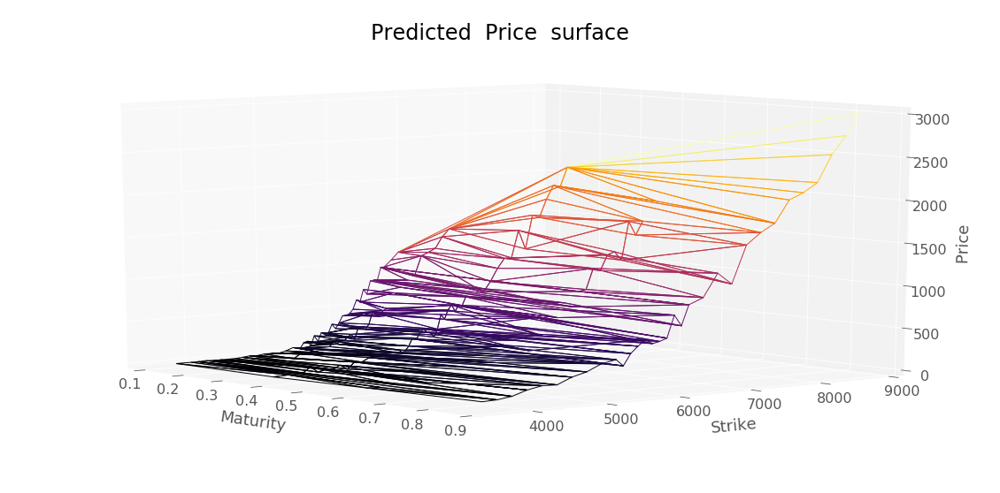

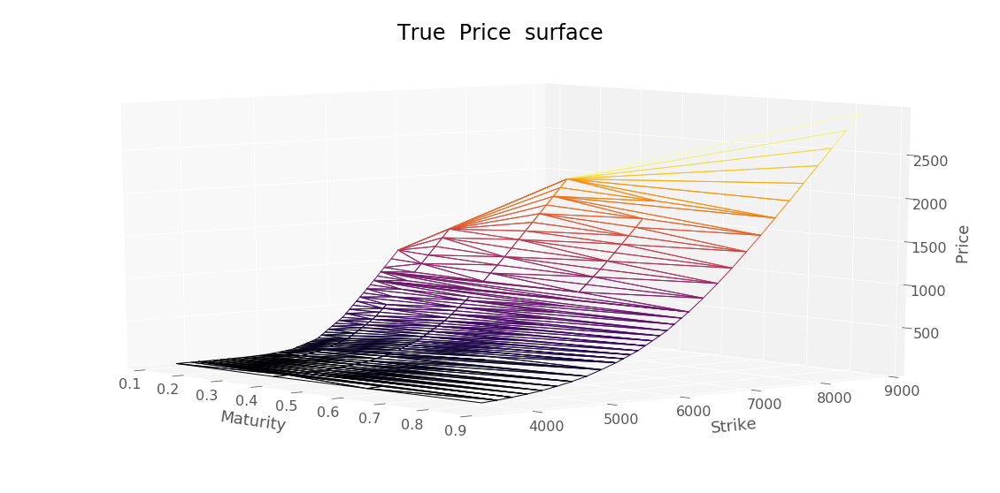

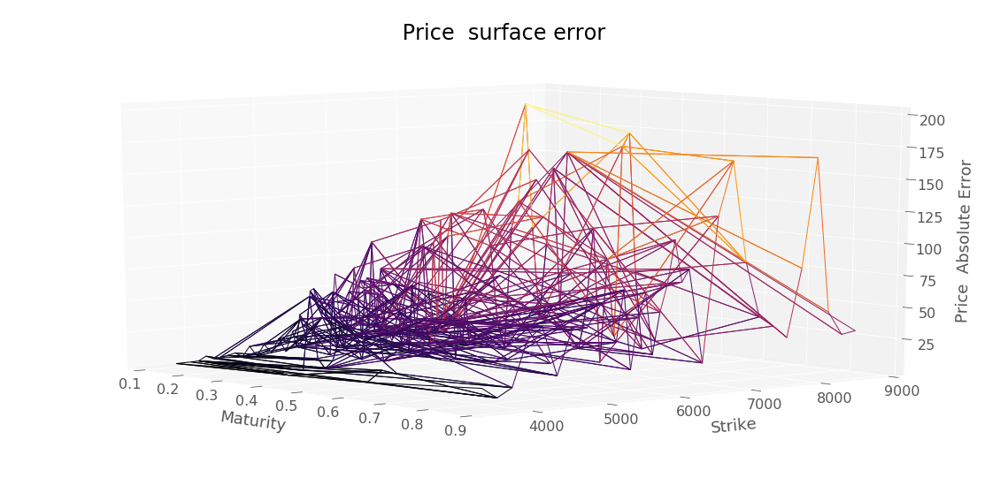

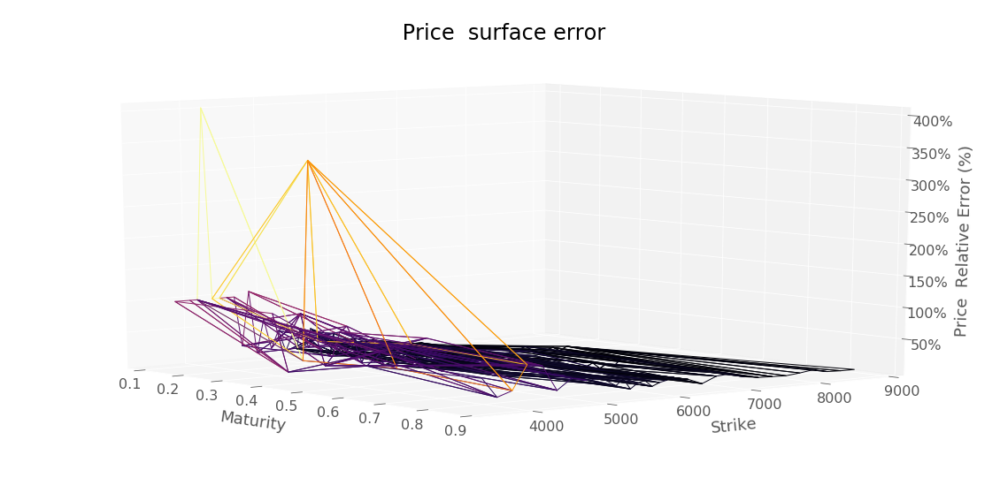

RMSE :  60.993962608159954


In [129]:
plotTools.predictionDiagnosis(mcResTikhonovTrain, 
                              dataSet["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [130]:
mcResTikhonovTrain.to_csv(workingFolder + "mcResTikhonovTrain.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


In [131]:
pdeResSigmaTikhonovTrain = backtest.PDEPricerVectorized(dataSet, S0, nnVolLocaleTykhonov, bootstrap)
pdeResSigmaTikhonovTrain.head()

KeyboardInterrupt: 

In [ ]:
plotTools.predictionDiagnosis(pdeResSigmaTikhonovTrain, 
                              dataSet["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResSigmaTikhonovTrain.to_csv(workingFolder + "pdeResSigmaTikhonovTrain.csv")

In [ ]:
pdeResSigmaTikhonovTest = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocaleTykhonov, bootstrap)
pdeResSigmaTikhonovTest.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResSigmaTikhonovTest, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResSigmaTikhonovTest.to_csv(workingFolder + "pdeResSigmaTikhonovTest.csv")

# Backtest Result Comparisons

In [28]:
importlib.reload(backtest)

<module 'backtest' from './code/backtest.py'>

In [34]:
mcResGPTest = backtest.loadMCPrices("./Results/mcResGPTest.csv", 
                                    parseHeader=0)
mcResGPTest.head()

Price    stdPrice
Strike Maturity                       
1700.0 0.246      0.833726   18.403973
2300.0 0.419     13.380419   92.245855
2350.0 0.093      0.384814   10.245258
       0.112      0.994517   18.210803
2400.0 0.419     20.646870  110.514794

In [35]:
mcResSSVITest = backtest.loadMCPrices("./Results/mcResSSVITest.csv", 
                                      parseHeader=0)
mcResSSVITest.head()

Price   stdPrice
Strike Maturity                      
1700.0 0.246      0.122353   5.334149
2300.0 0.419     13.060788  78.424282
2350.0 0.093      0.566051   9.872014
       0.112      1.066521  15.021875
2400.0 0.419     19.244920  94.333650

In [ ]:
backtest.rmse(mcResGPTest["Price"], mcResSSVITest["Price"])

In [39]:
pdeResSigmaGPTest = backtest.loadMCPrices("./Results/pdeResSigmaGPTest.csv")
pdeResSigmaGPTest.head()

2
Strike Maturity           
1700.0 0.246      0.594552
2300.0 0.419     10.923903
2350.0 0.093      0.756563
       0.112      1.130061
2400.0 0.419     19.264846

# Compare Implied Volatility and ignore miscalibrated implied volatilities

This section removes nodes where implied volatility estimation is impossible for some models (GP, NN Price).
This allow a fair comparison of implied volatility for model.

In [40]:
#Detecting options which lead to implied volatilities miscalibration
gpImpVolTraining = pd.Series(pd.read_csv("./Results" + "/GPTraining.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                             index = plotTools.removeDuplicateIndex(dataSet).index)
gpImpVolTesting = pd.Series(pd.read_csv("./Results" + "/GPTesting.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                            index = plotTools.removeDuplicateIndex(dataSetTest).index)
nnImpVolTraining = pd.Series(pd.read_csv("./Results" + "/NeuralPriceTrain.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                             index = plotTools.removeDuplicateIndex(dataSet).index)
nnImpVolTesting = pd.Series(pd.read_csv("./Results" + "/NeuralPriceTest.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                            index = plotTools.removeDuplicateIndex(dataSetTest).index)

In [41]:
gpImpVolTrainingError = gpImpVolTraining[gpImpVolTraining <= 1e-9].append(gpImpVolTraining[gpImpVolTraining >= 2])
nnImpVolTrainingError = nnImpVolTraining[nnImpVolTraining <= 1e-9].append(nnImpVolTraining[nnImpVolTraining >= 2])
trainingFilterImpVol = gpImpVolTrainingError.append(nnImpVolTrainingError).index.unique()

In [42]:
gpImpVolTestingError = gpImpVolTesting[gpImpVolTesting <= 1e-9].append(gpImpVolTesting[gpImpVolTesting >= 2])
nnImpVolTestingError = nnImpVolTesting[nnImpVolTesting <= 1e-9].append(nnImpVolTesting[nnImpVolTesting >= 2])
testingFilterImpVol = gpImpVolTestingError.append(nnImpVolTestingError).index.unique()

In [43]:
#Load results from another model
dfModelTraining = pd.read_csv("./Results" + "/NeuralImpliedVolTrain.csv").set_index(["Strike","Maturity"])
dfModelTraining = pd.DataFrame(dfModelTraining.values, 
                               index = plotTools.removeDuplicateIndex(dataSet).index,
                               columns = dfModelTraining.columns)

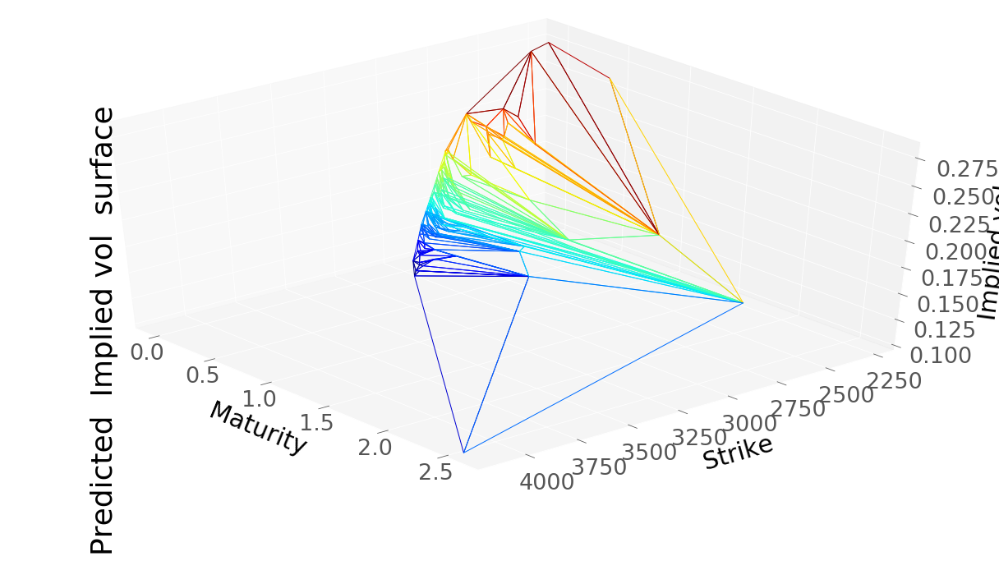

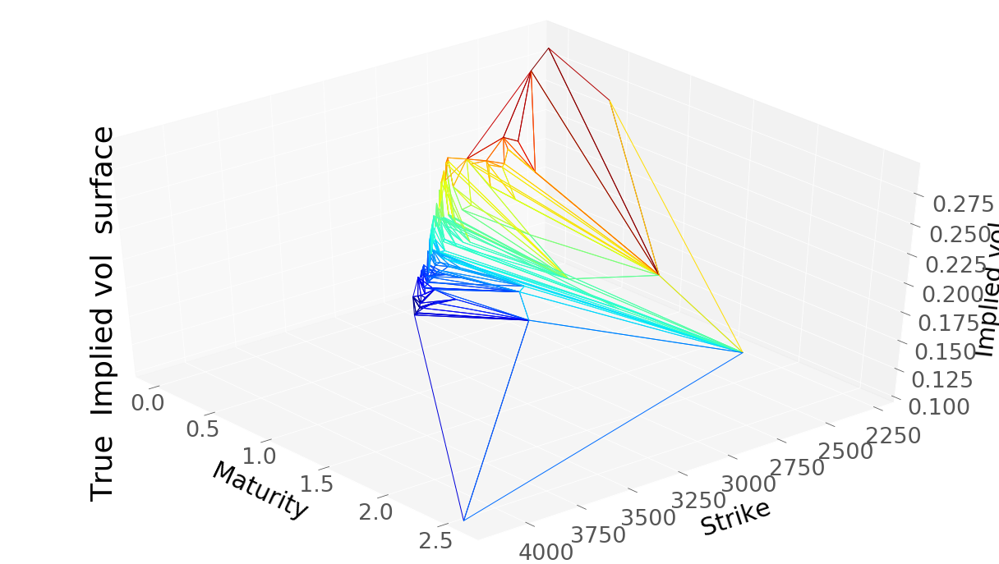

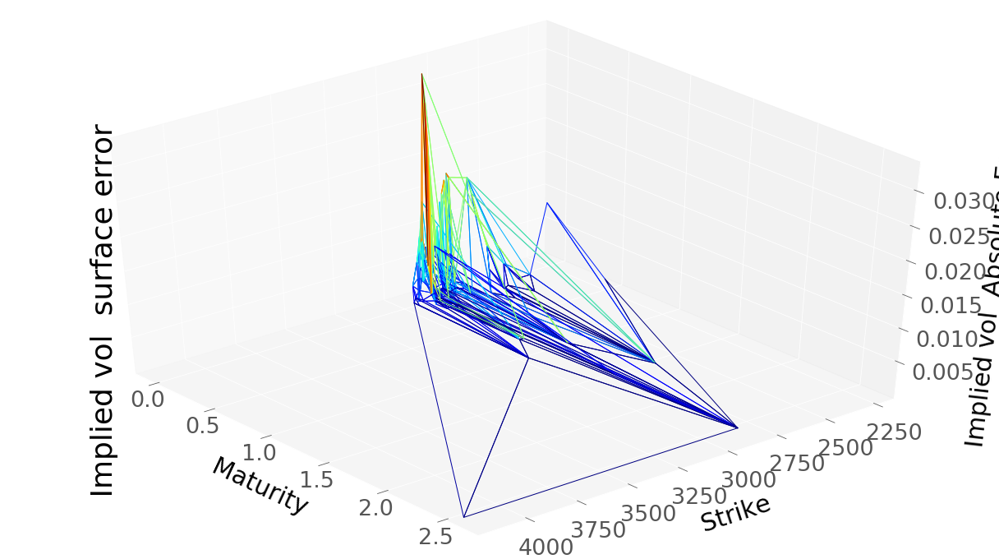

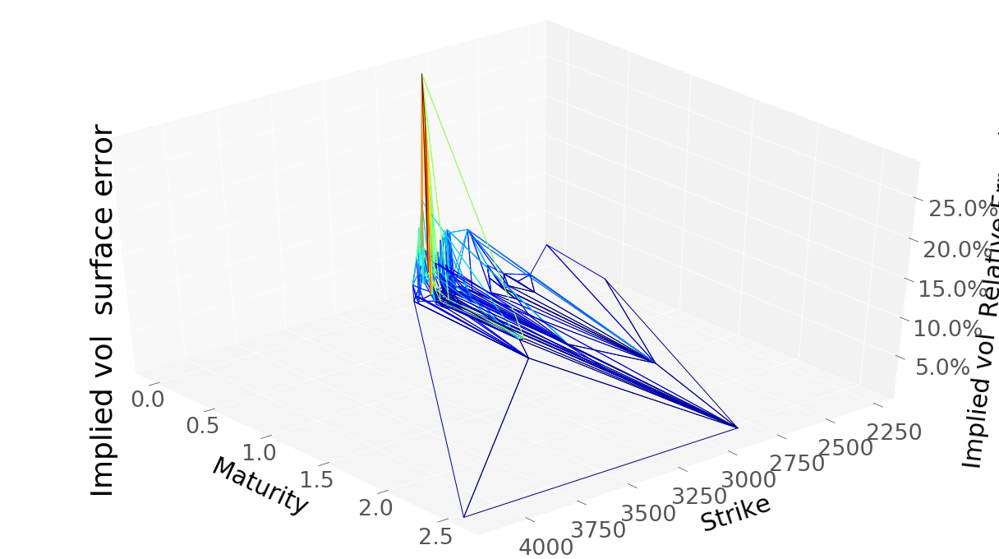

RMSE :  0.008308735683189806
RMSE Relative:  0.05839955179062345


In [44]:
keptVols = dataSet["ImpliedVol"].drop(trainingFilterImpVol).index
plotTools.predictionDiagnosis(plotTools.selectIndex(dfModelTraining["ImpliedVol"], keptVols) , 
                              plotTools.selectIndex(dataSet["ImpliedVol"], keptVols) , 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

In [45]:
dfModelTesting = pd.read_csv("./Results" + "/NeuralImpliedVolTest.csv").set_index(["Strike","Maturity"])
dfModelTesting = pd.DataFrame(dfModelTesting.values, 
                              index = plotTools.removeDuplicateIndex(dataSetTest).index,
                              columns = dfModelTesting.columns)

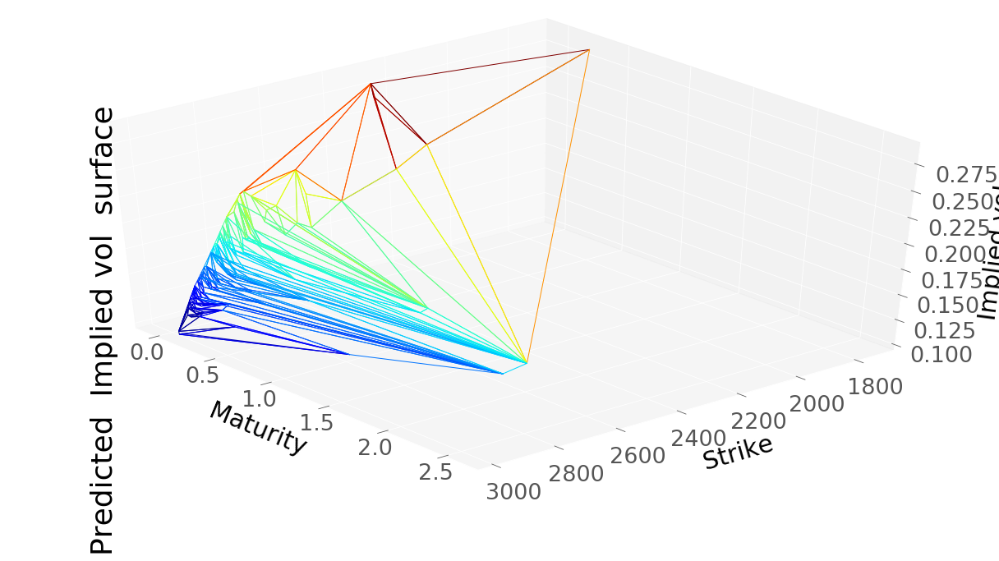

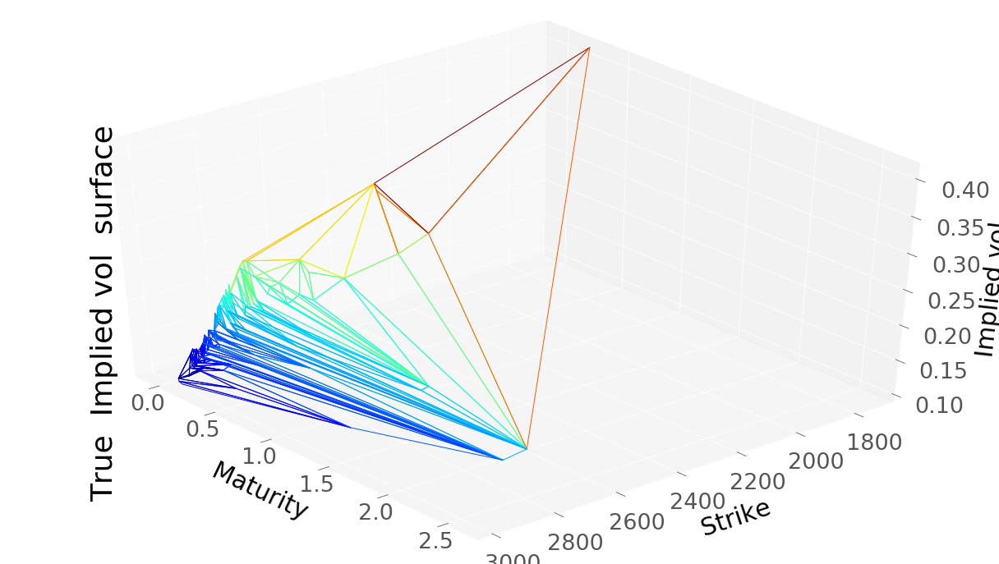

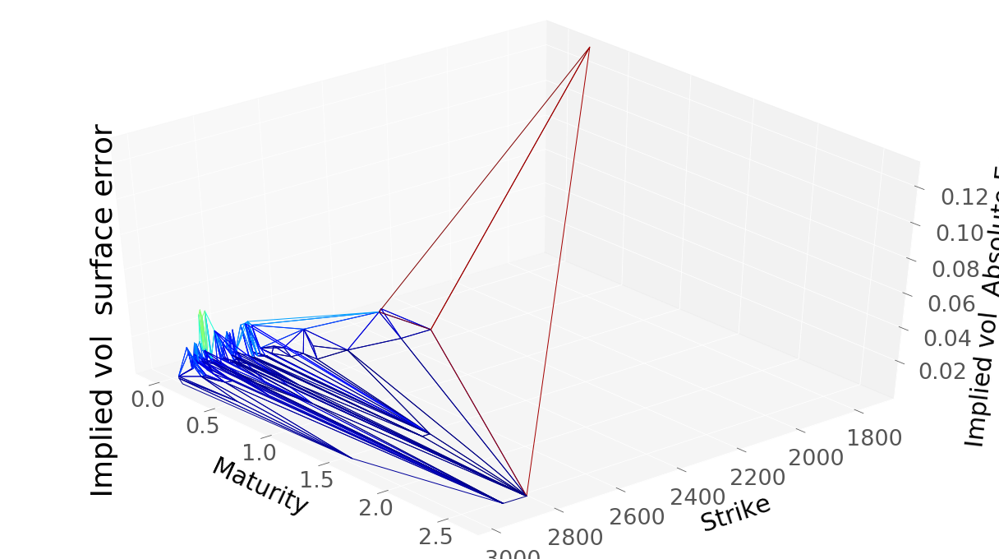

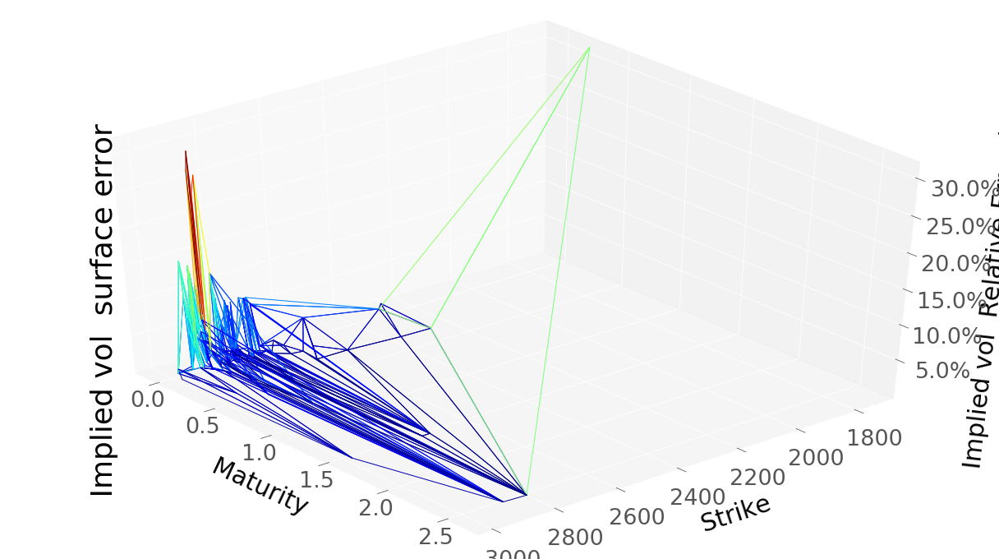

RMSE :  0.014479932896062826
RMSE Relative:  0.07272674714144238


In [46]:
keptVols = dataSetTest["ImpliedVol"].drop(testingFilterImpVol).index
plotTools.predictionDiagnosis(plotTools.selectIndex(dfModelTesting["ImpliedVol"], keptVols) , 
                              plotTools.selectIndex(dataSetTest["ImpliedVol"], keptVols) , 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)